In [2]:
#getting and working with data
import pandas as pd
import numpy as np
import re
import os
import datetime as dt
import string
from scipy import stats

#visualizing results
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
sns.set_context("poster")
sns.set_style("ticks")
#import yellowbrick as yb

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 15000)
pd.set_option('display.max_colwidth', -1)

import warnings; warnings.simplefilter('ignore')
np.set_printoptions(suppress=True)

from sksurv.nonparametric import kaplan_meier_estimator
from sksurv.compare import compare_survival
from sksurv.linear_model import CoxPHSurvivalAnalysis
from sksurv.preprocessing import OneHotEncoder
from sksurv.util import Surv
from sksurv.metrics import (concordance_index_censored,
                            concordance_index_ipcw,
                            cumulative_dynamic_auc)

from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn import metrics
from sklearn.manifold import TSNE

from sklearn.cluster import KMeans

import scipy.cluster.hierarchy as shc

/Users/abbieschindler/opt/anaconda3/envs/analysis/lib/python3.6/site-packages/ipykernel_launcher.py:21: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.


## get meta and sleep data 

In [3]:
path_demogs = '/Users/abbieschindler/Documents/Schindler_Lab/Data/Clinical projects/SLS/Cognitive Spreadsheet with CESD.xlsx'

demogs = pd.read_excel(path_demogs)

print(demogs.shape)
print(len(demogs['SLS #'].unique()))
demogs.sort_values('SLS #').head()

(1104, 14)
1104


,SLS #,BIRTHYR,COHORT,DEATHYR,Age at first test condition,Year of Last Test,Age at Last testing Condition,Ethnicity,GENDER (m=1),APOE Status,Education,HBQ Median Sleep Duration,Average Sleep,Median Sleep
949,101530,1915,5,2006,62,2004,89,.,1,3/3,12,long_sleeper,7.333333,8.0
860,101910,1919,5,2008,58,2005,86,1,1,3/3,14,long_sleeper,9.000000,9.0
1056,111101,1911,4,2009,66,2005,94,1,1,2/3,8,medium_sleeper,6.666667,7.0
998,111401,1914,5,2005,63,2004,90,1,1,3/4,14,short_sleeper,6.500000,6.5
529,111702,1917,5,2010,60,1993,76,6,1,3/3,12,long_sleeper,8.000000,8.0


In [4]:
path_sleep = '/Users/abbieschindler/Documents/Schindler_Lab/Data/Clinical projects/SLS/sleep.xlsx'

sleep = pd.read_excel(path_sleep)

#replace '.' with np.nan
sleep = sleep.replace({'.':np.nan, ' .':np.nan})

print(sleep.shape)
print(len(sleep['SLS_ID'].unique()))
sleep.sort_values('SLS_ID').head()

(1104, 10)
1104


,SLS_ID,dementia,sleep_pre,1993_sleep,1998_sleep,2005_sleep,2008_sleep,2012_sleep,sleep_ave,sleep_med
665,101530,No,NaN,8.0,8.0,6.0,NaN,NaN,7.333333,8.0
666,101910,Yes,NaN,9.0,9.0,NaN,NaN,NaN,9.000000,9.0
318,111101,Yes,NaN,7.0,6.0,7.0,NaN,NaN,6.666667,7.0
1005,111401,Yes,NaN,6.0,7.0,NaN,NaN,NaN,6.500000,6.5
1006,111702,Yes,NaN,8.0,NaN,NaN,NaN,NaN,8.000000,8.0


## get cognitive testing data


In [181]:
path_data = '/Users/abbieschindler/Documents/Schindler_Lab/Data/Clinical projects/SLS/cog_tc.xlsx'

data = pd.read_excel(path_data)

#replace '.' with np.nan
data = data.replace({'.':np.nan, ' .':np.nan})

print(len(data.dropna(subset=['OCCSN'], axis=0)['IDNUM'].unique()))

print(data.shape)
data.head()

1104
(7728, 18)


,IDNUM,OCCSN,OCCSNDT,MMSE TOTAL,MATTIS TOTAL,TRAIL B,WAASV - Vocabulary Age-Scaled Score,WAASC - Comprehension Age-Scaled Score,WAASBD - Block Design Age-Scaled Score,WAASSY Digit-Symbol Age-Scaled Score,Any score ≤ 8 / Lowest Score,Dementia Criteria MMSE ≤ 27,Dementia Criteria MATTIS ≤ 130,Dementia Criteria Trail B ≥ 180,Dementia Criteria WAIS ≤ 8,Dementia Criteria Met,CESD-11 Restlessness,CESD Total Score
0,111702,1,1997.0,25.0,117.0,121.0,4.0,7.0,10.0,12.0,4.0,1.0,1.0,0.0,1.0,3.0,2.0,17.0
1,130596,1,1997.0,29.0,141.0,122.0,11.0,12.0,11.0,9.0,9.0,0.0,0.0,0.0,0.0,0.0,3.0,20.0
2,134010,1,1997.0,28.0,137.0,104.0,12.0,12.0,10.0,12.0,10.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0
3,134016,1,1997.0,28.0,129.0,667.0,10.0,12.0,8.0,6.0,6.0,0.0,1.0,1.0,1.0,3.0,1.0,8.0
4,135003,1,1997.0,30.0,137.0,87.0,17.0,14.0,14.0,15.0,14.0,0.0,0.0,0.0,0.0,0.0,0.0,7.0


## explore potential issues


In [6]:
data_final = data.dropna(subset=['OCCSNDT'], axis=0)
set(demogs['SLS #']) - set(data_final['IDNUM'])

set()

111702


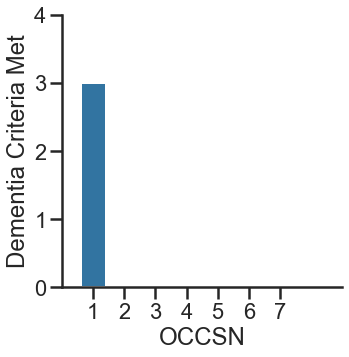

130596


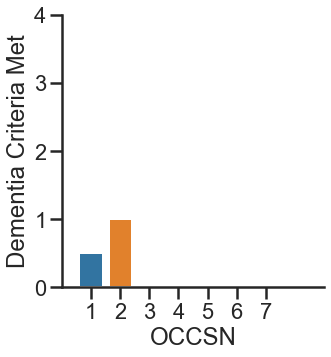

134010


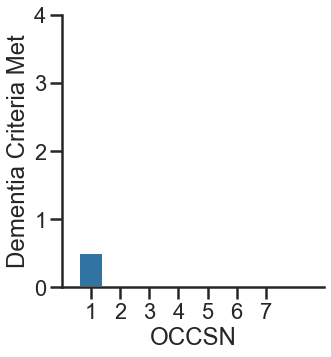

134016


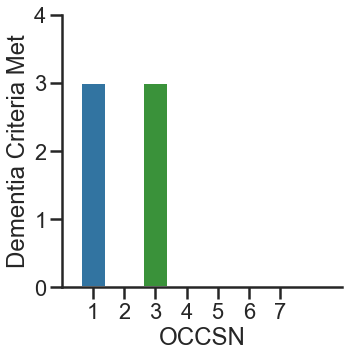

135003


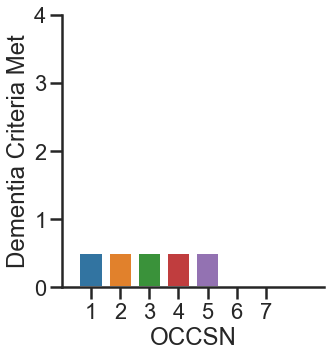

135521


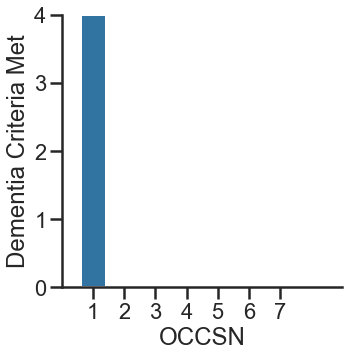

135522


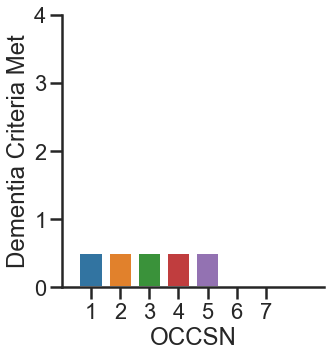

136015


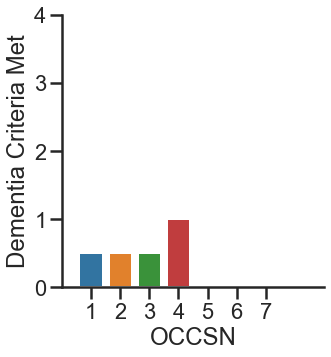

201010


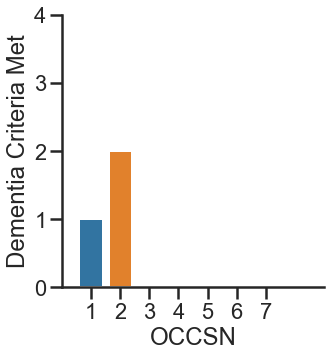

211401


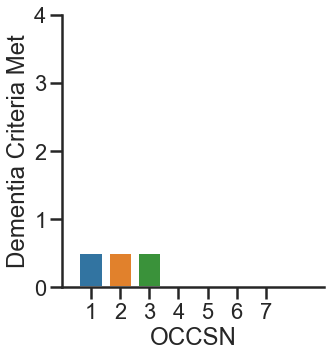

212203


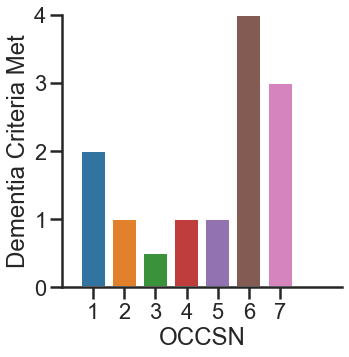

212204


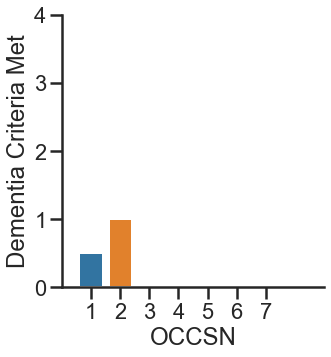

224548


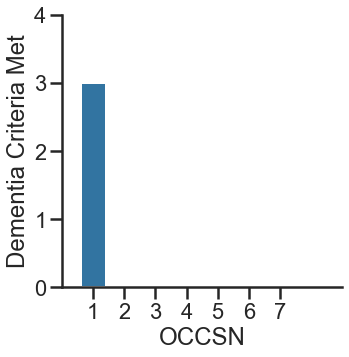

227034


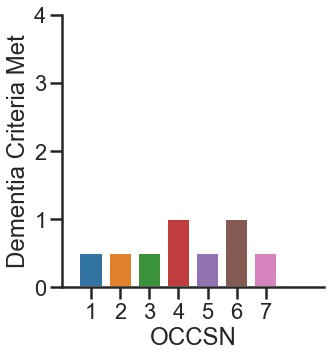

227547


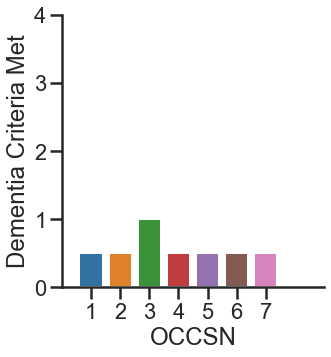

231602


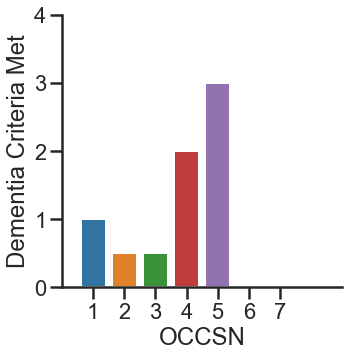

231703


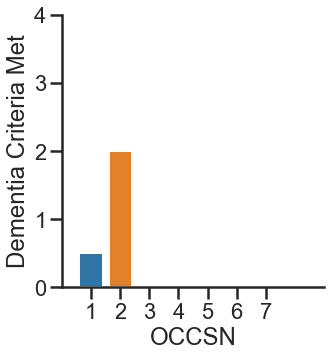

234035


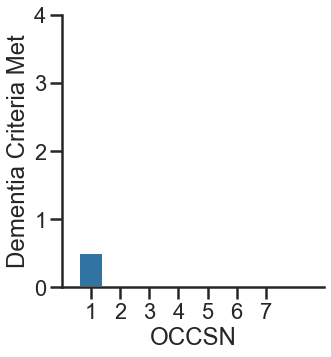

234540


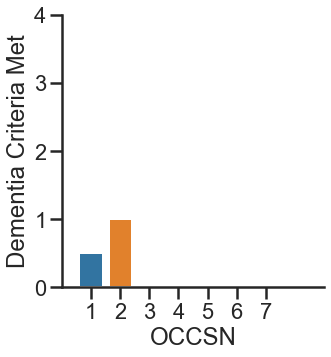

234543


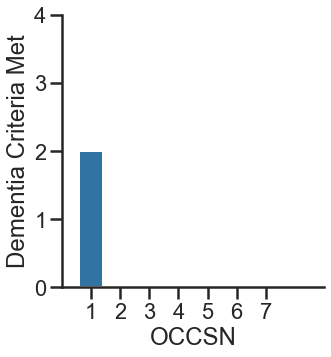

235563


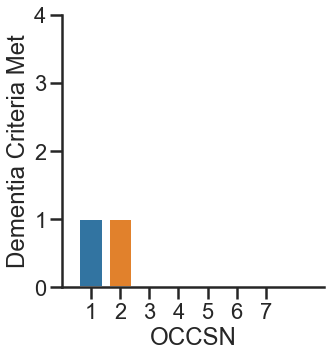

236067


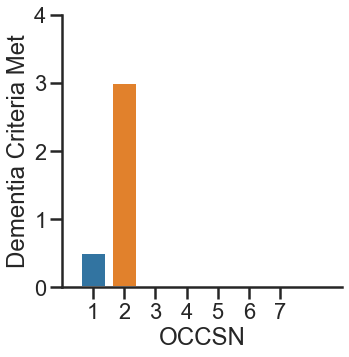

236522


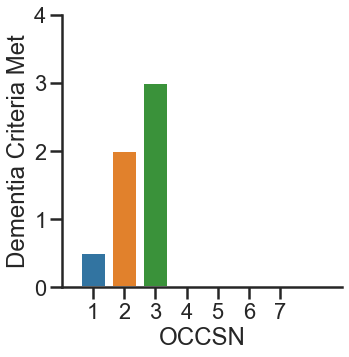

236526


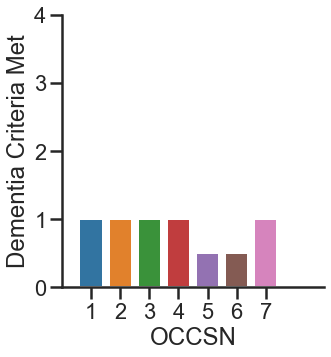

237035


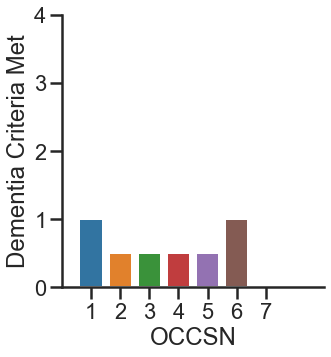

237562


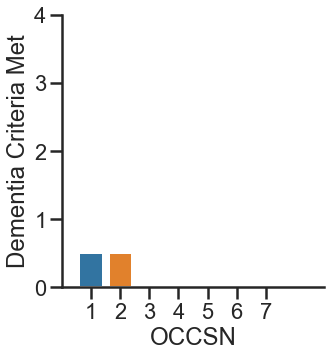

238030


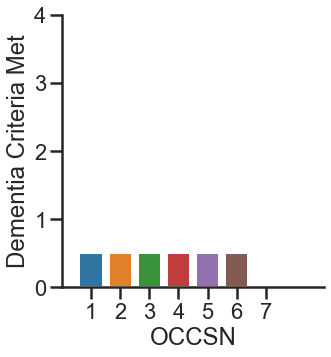

251910


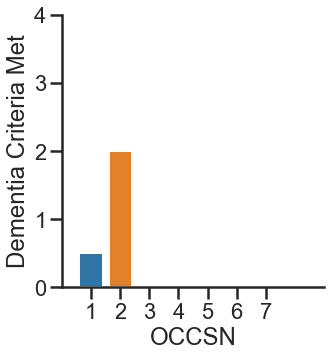

335516


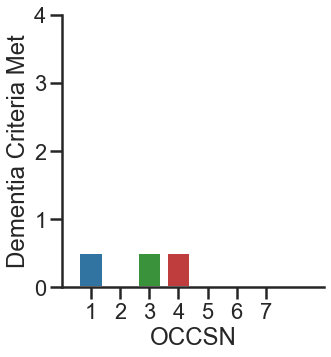

336014


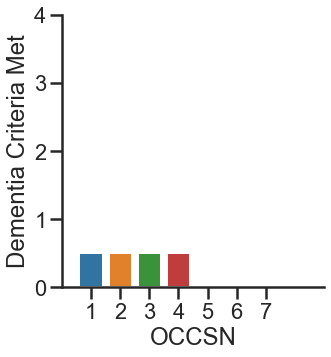

336515


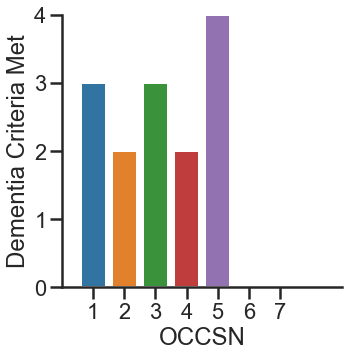

336523


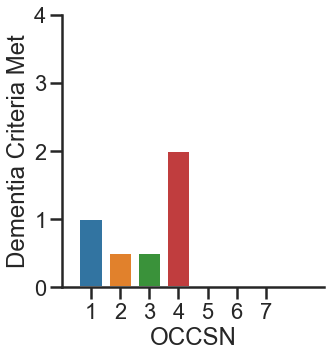

336530


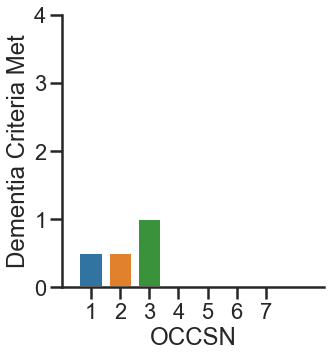

337003


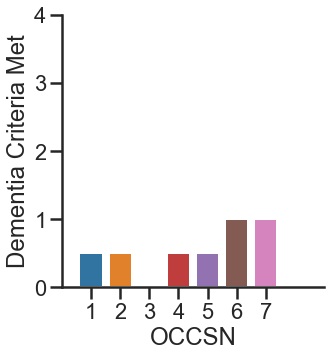

337006


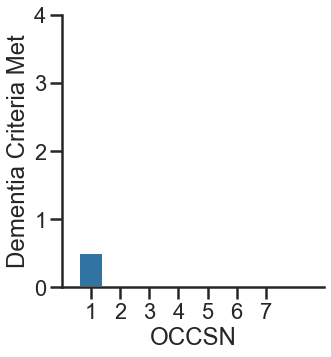

337008


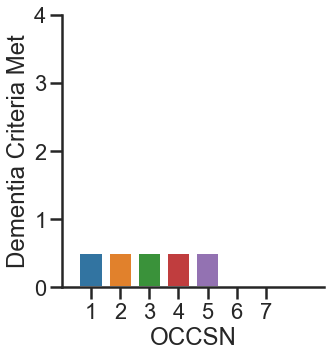

337030


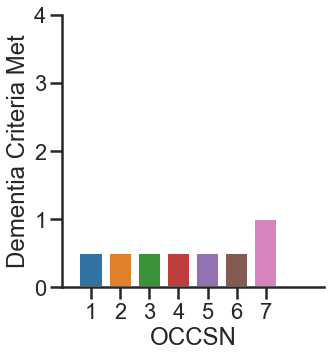

337527


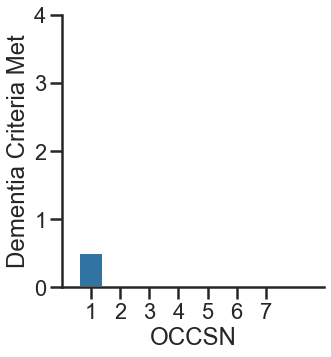

337530


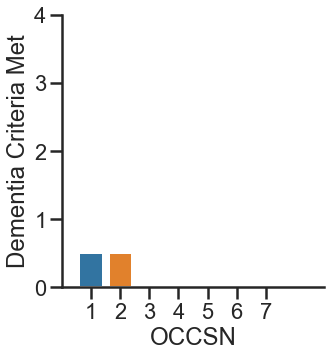

338520


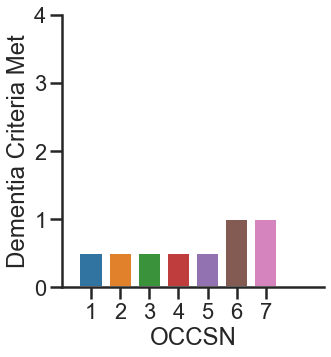

440701


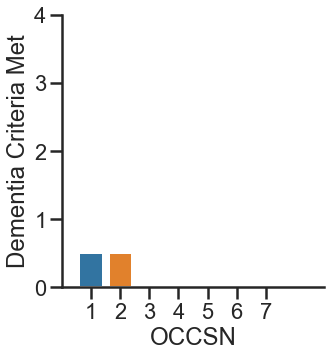

440801


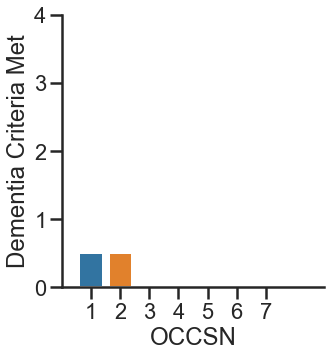

441352


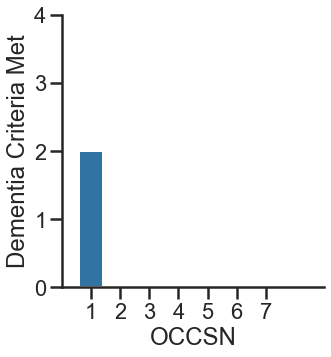

441853


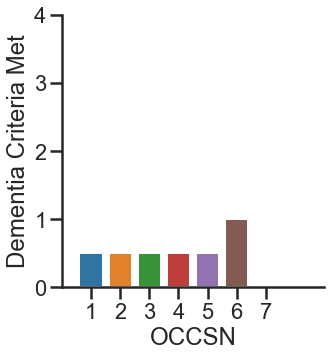

441854


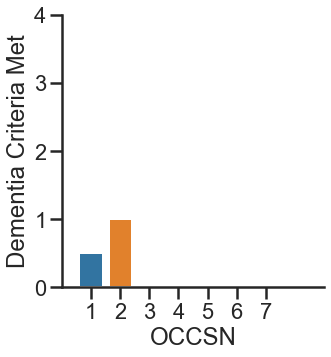

441905


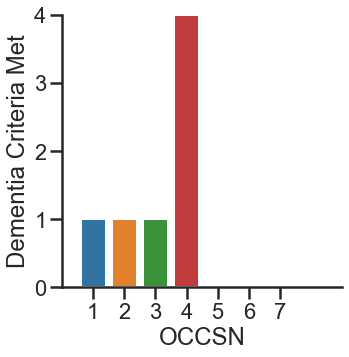

441906


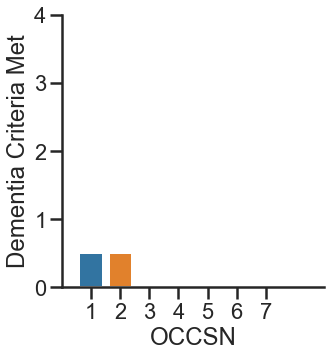

442054


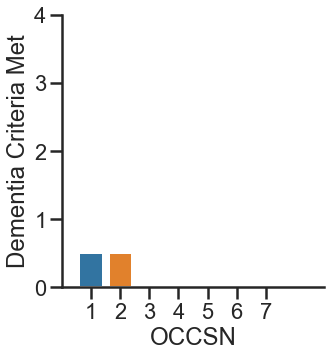

442254


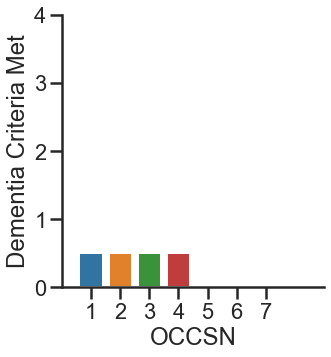

442354


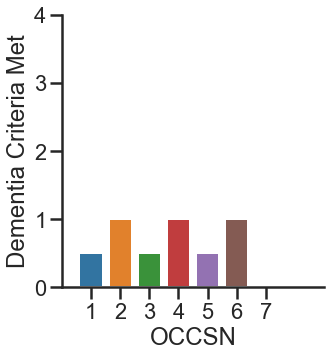

442551


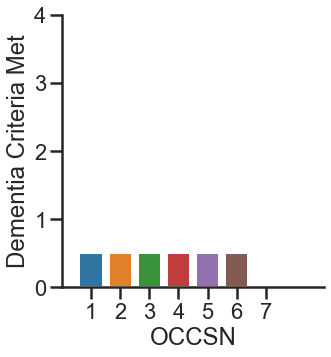

442705


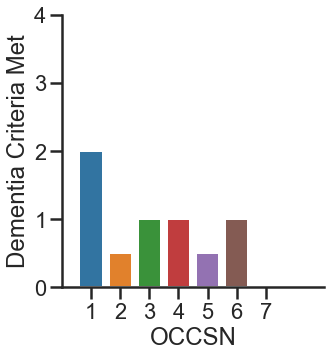

442852


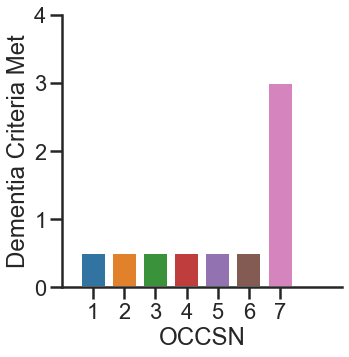

442901


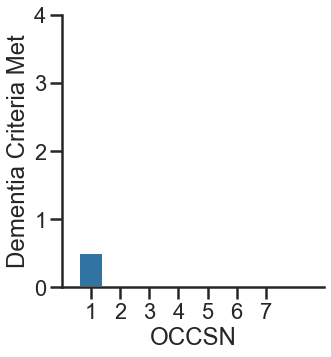

443703


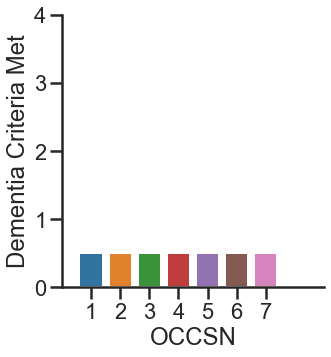

443753


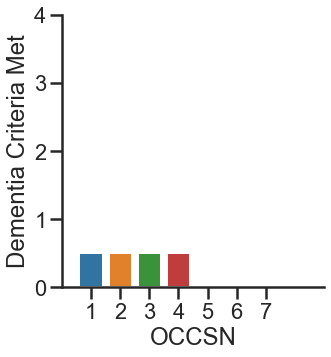

550852


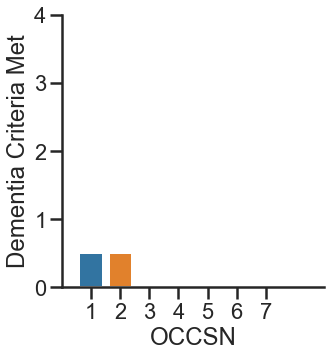

551253


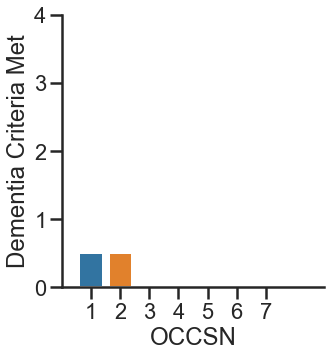

551604


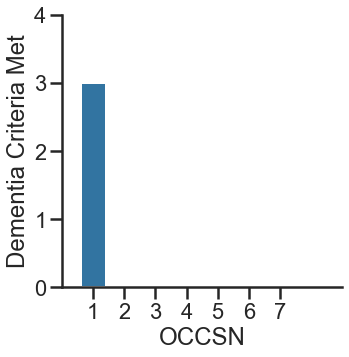

551804


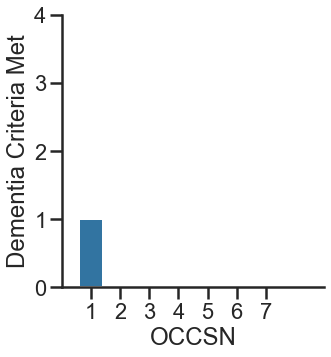

552001


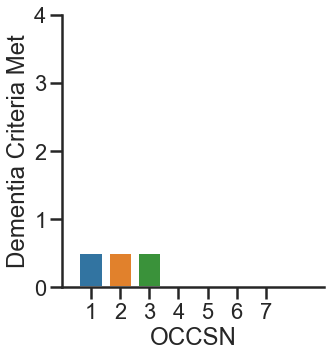

552103


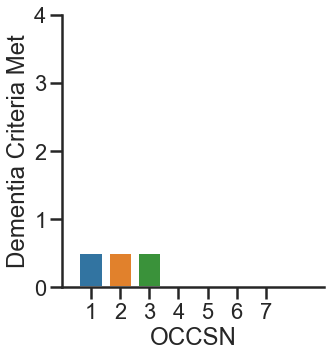

552306


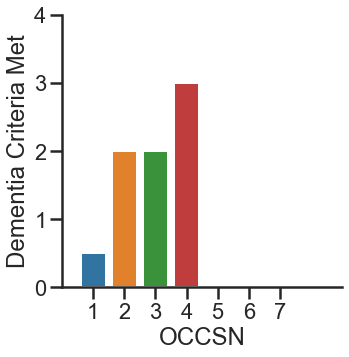

552308


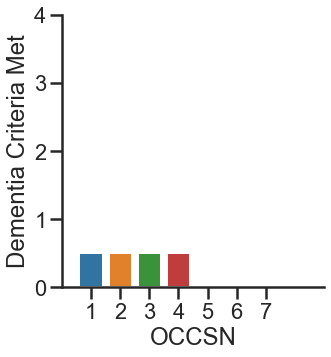

552452


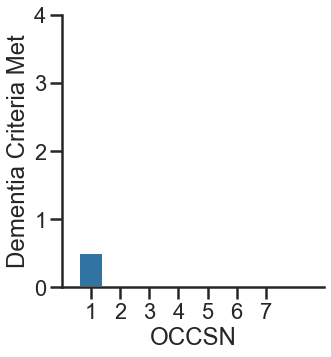

552453


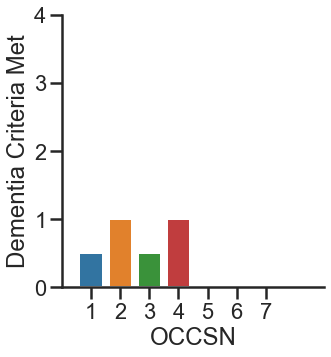

552459


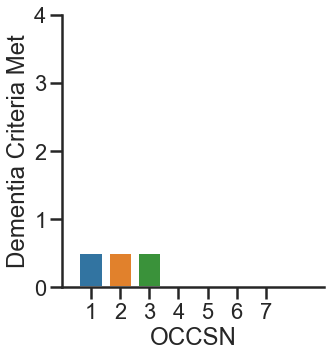

552651


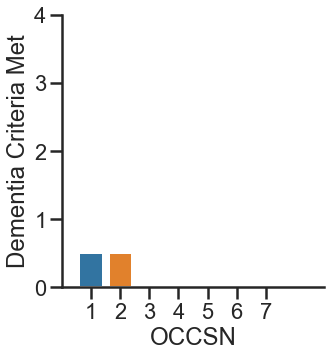

552702


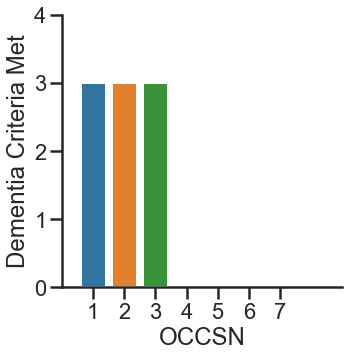

552851


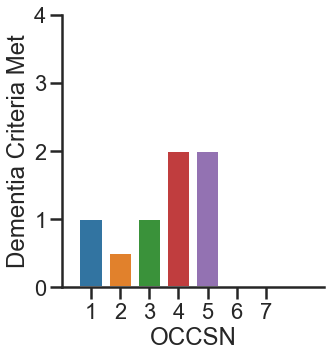

552902


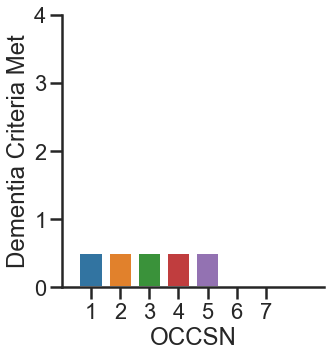

552903


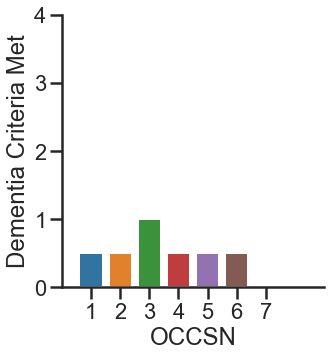

553051


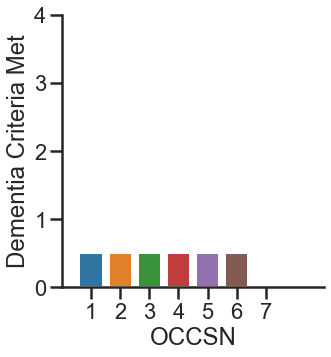

553155


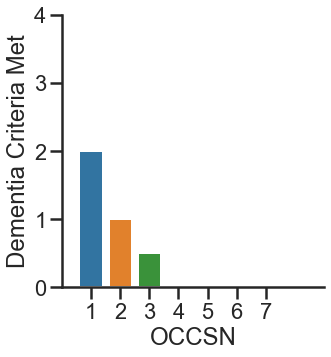

553203


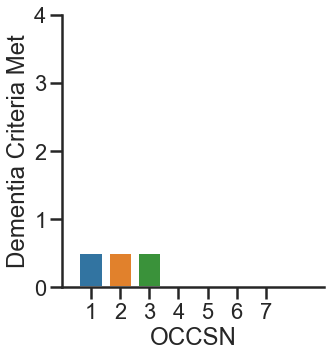

553351


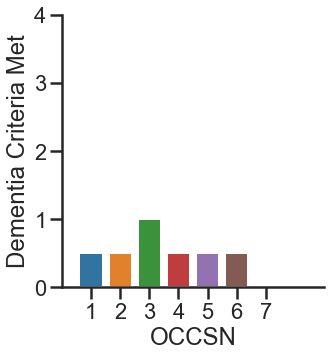

553508


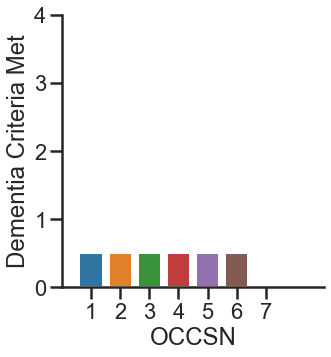

553551


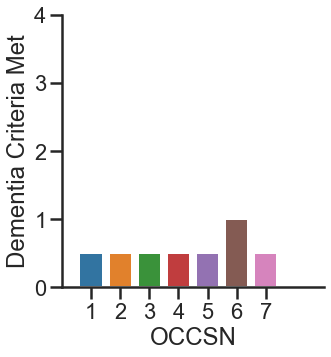

553601


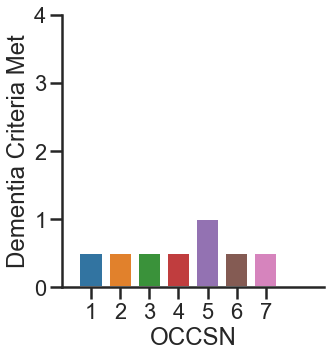

553701


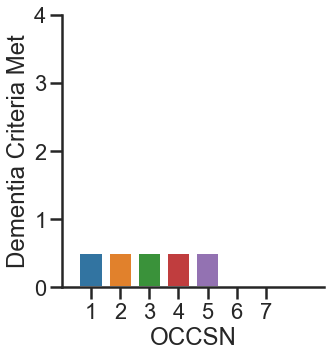

553754


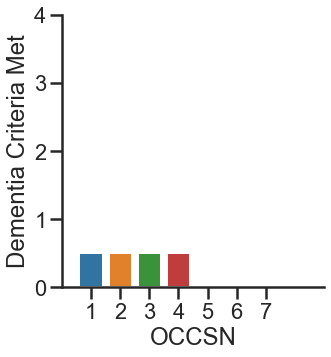

553755


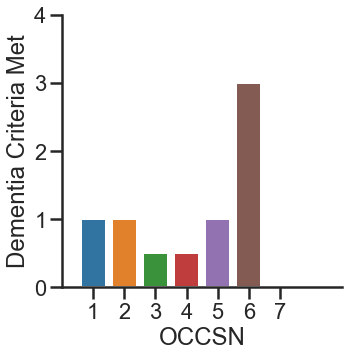

661006


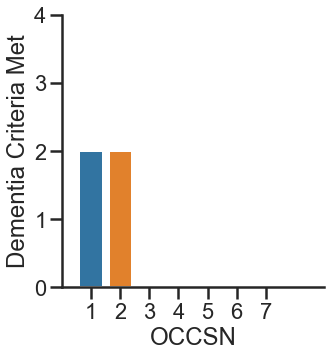

661051


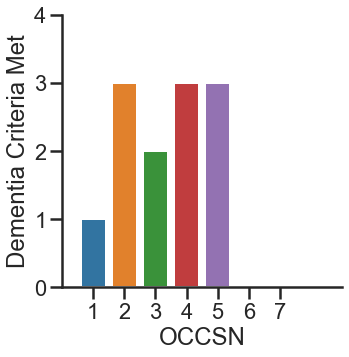

661558


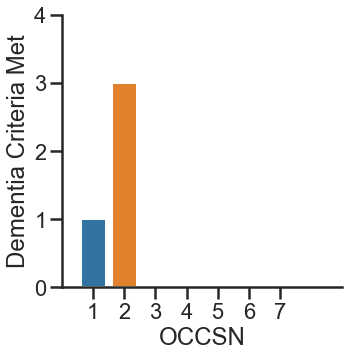

662157


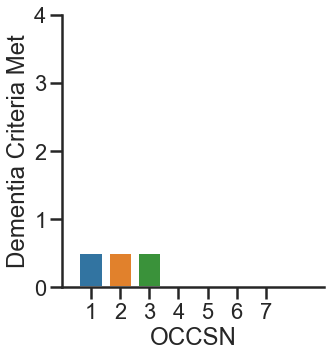

662355


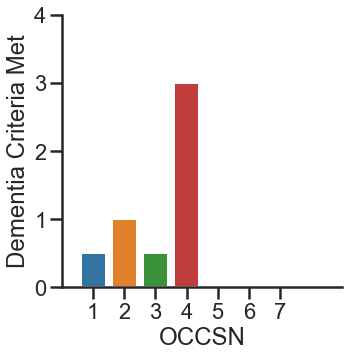

662451


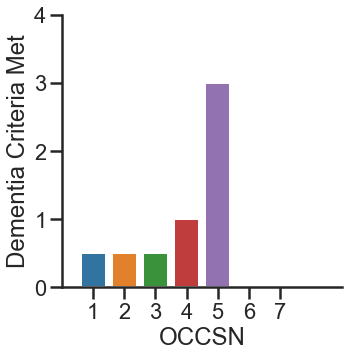

662559


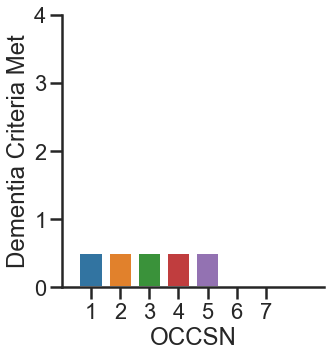

662564


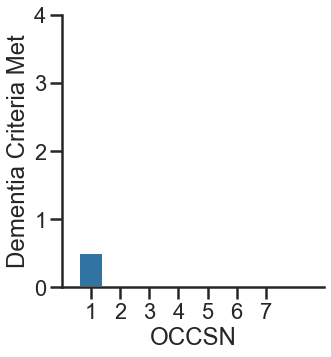

662754


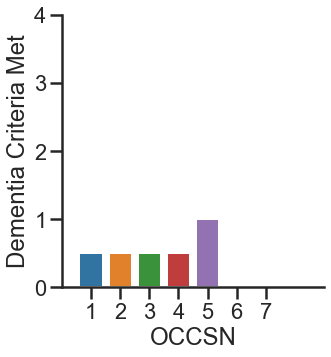

662756


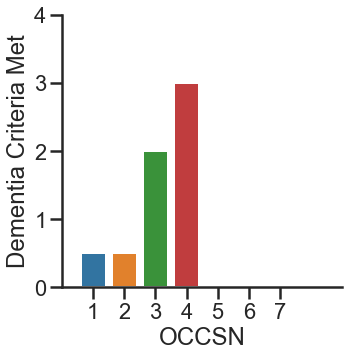

662804


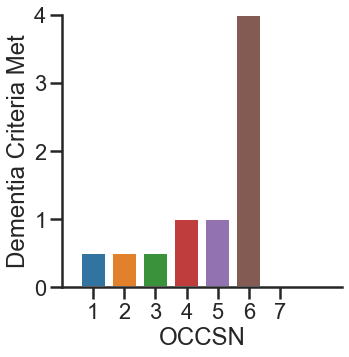

663404


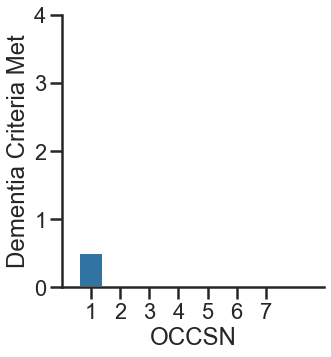

663509


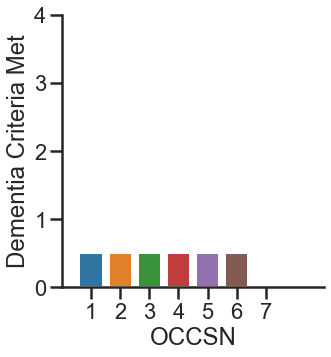

663511


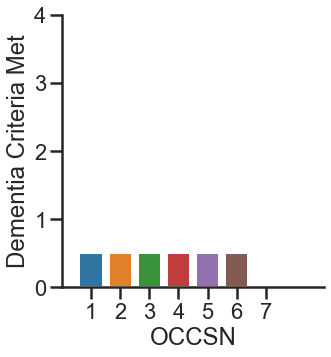

663551


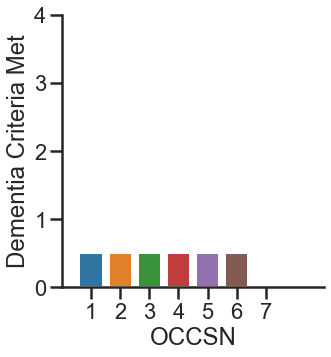

663606


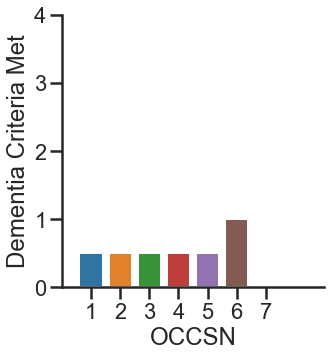

101530


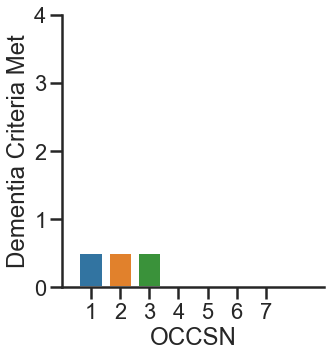

111401


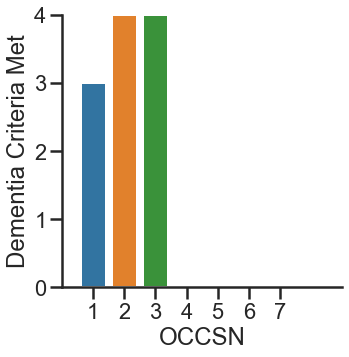

112104


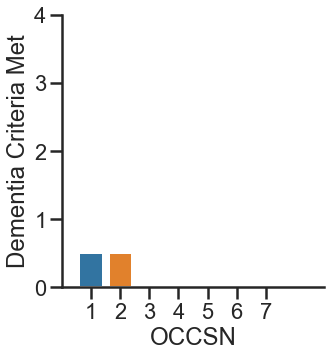

113303


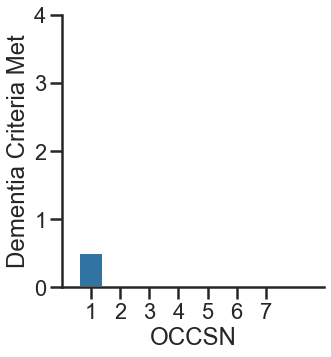

135001


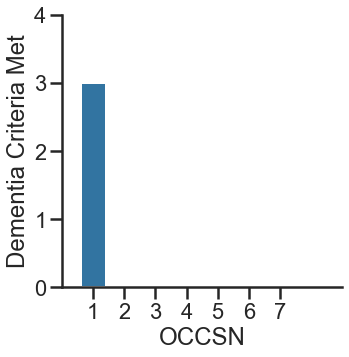

135502


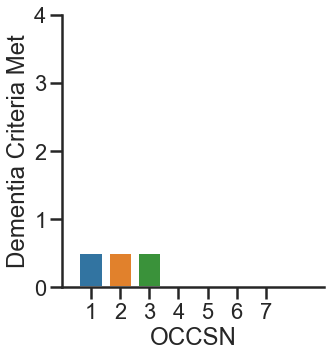

136514


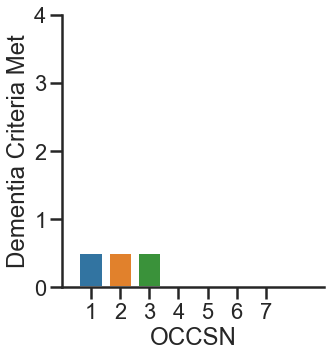

136524


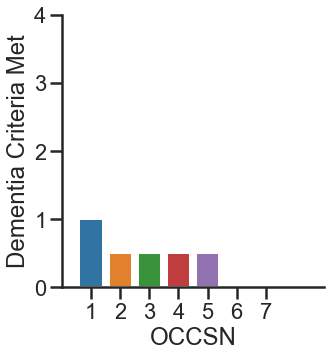

137510


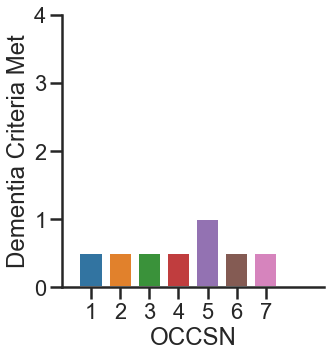

137520


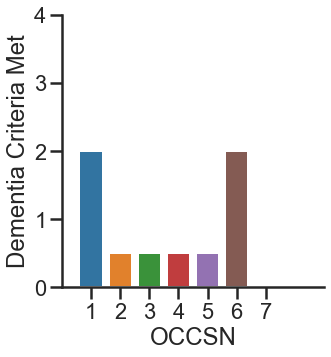

225079


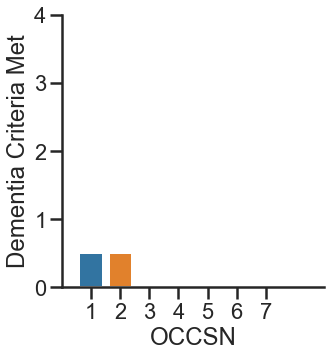

226014


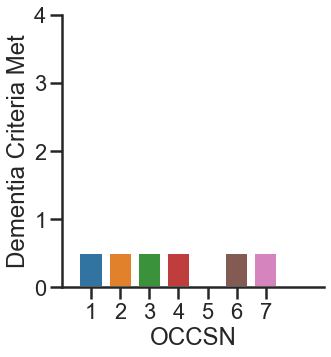

227003


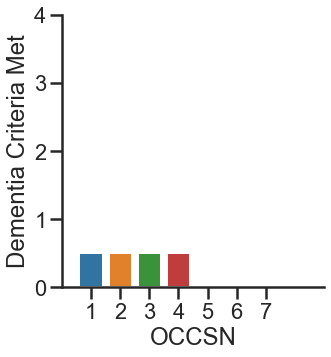

231603


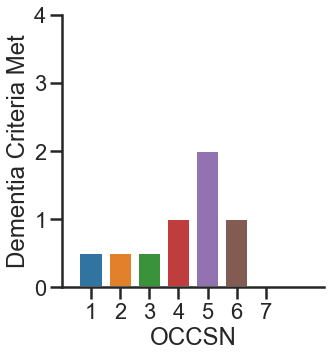

231802


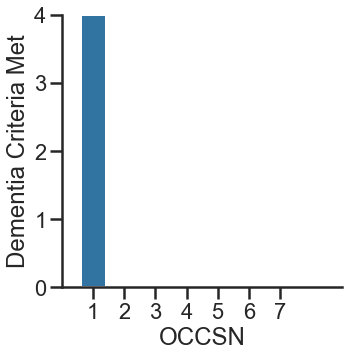

232201


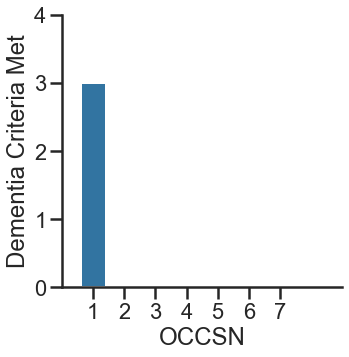

232604


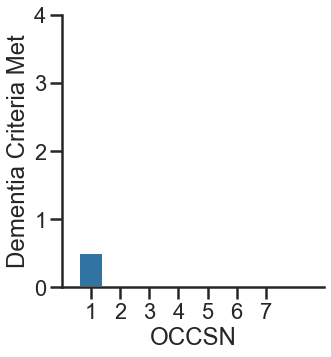

235016


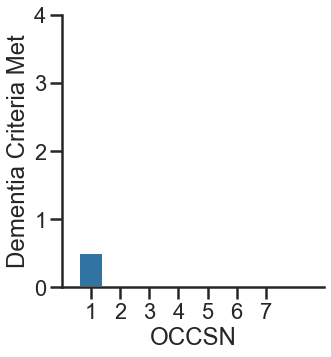

235036


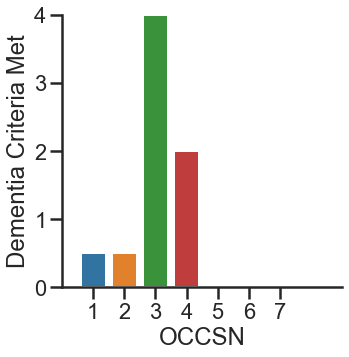

235526


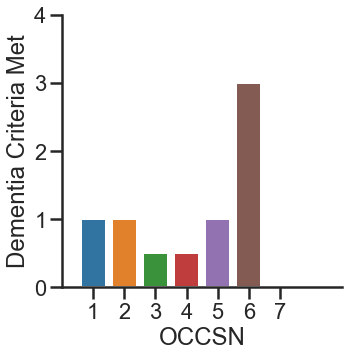

235528


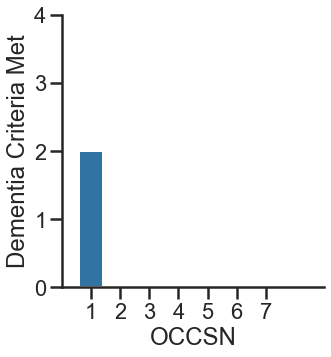

235534


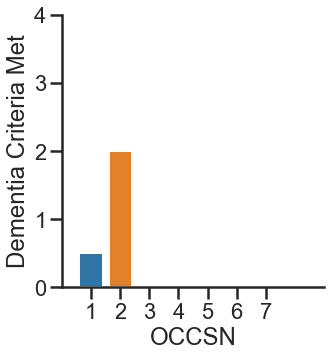

235537


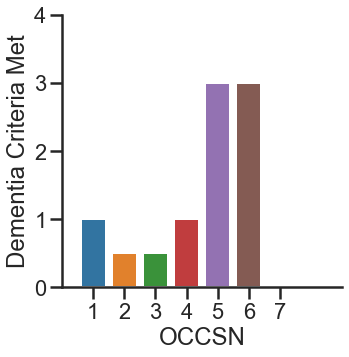

235558


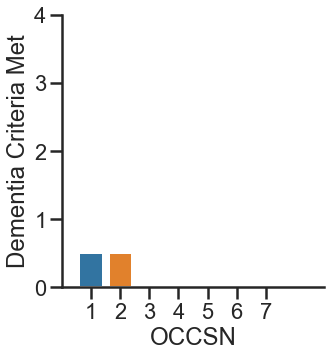

235568


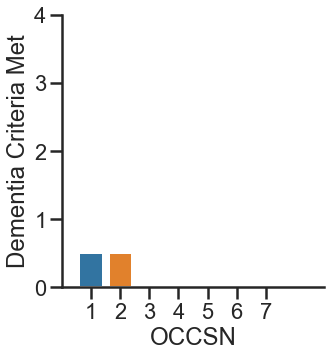

236516


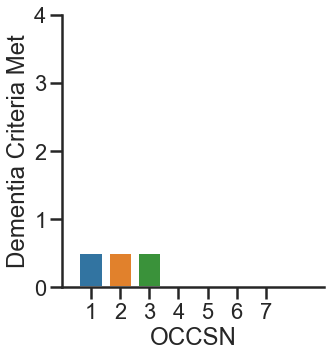

237014


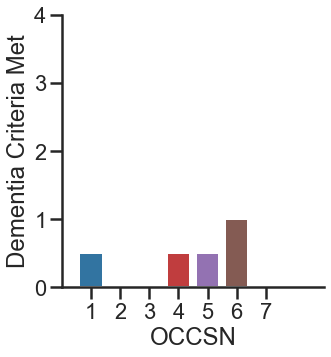

237503


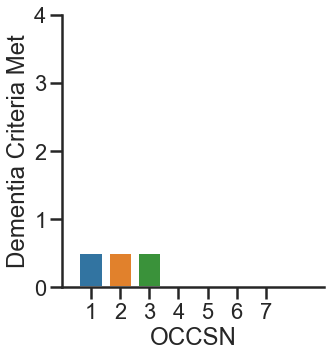

237551


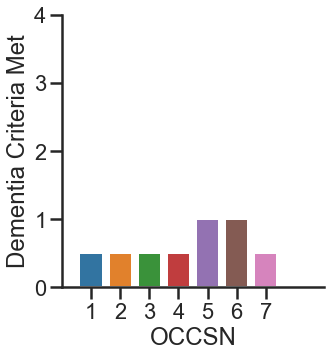

237564


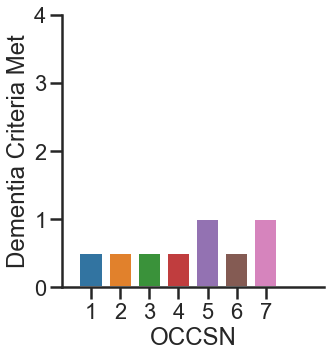

238509


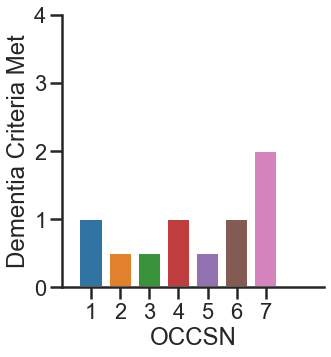

238541


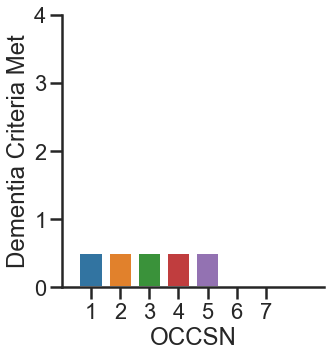

335003


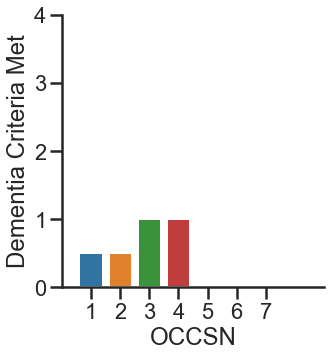

335007


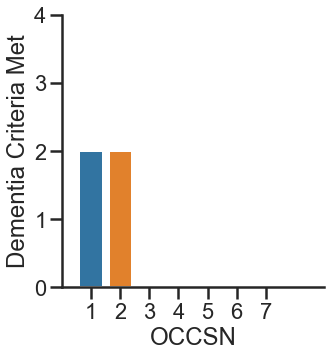

335009


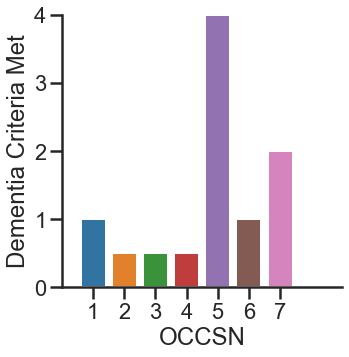

335013


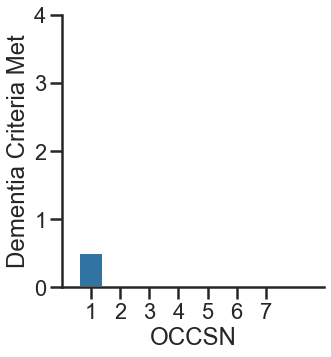

335029


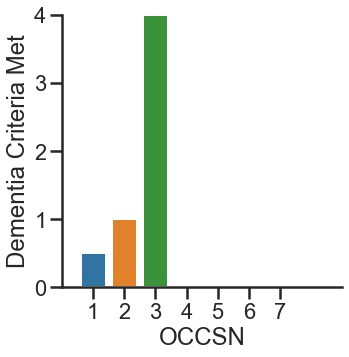

335501


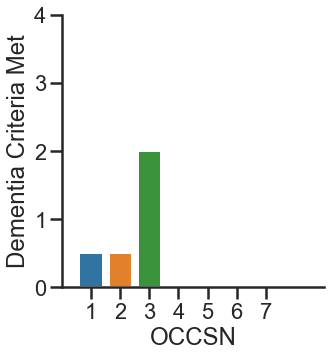

335505


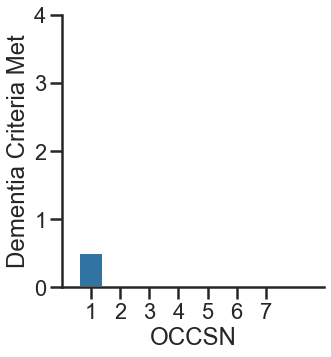

335518


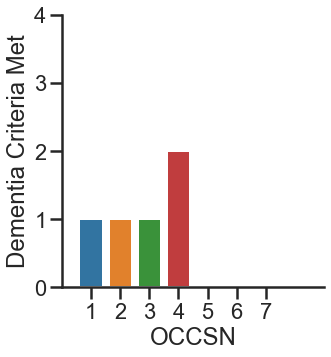

335544


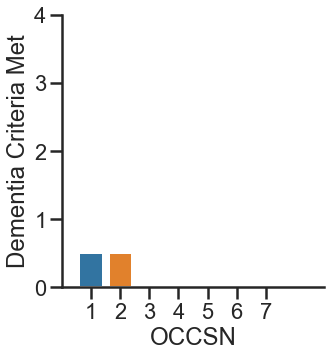

335546


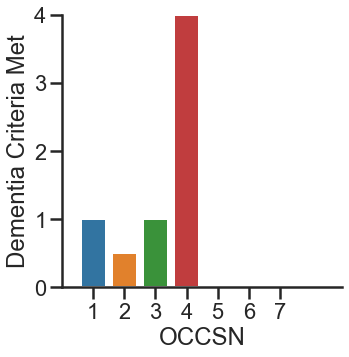

335549


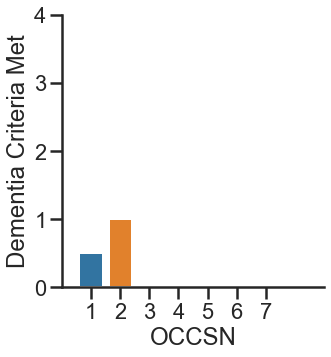

336007


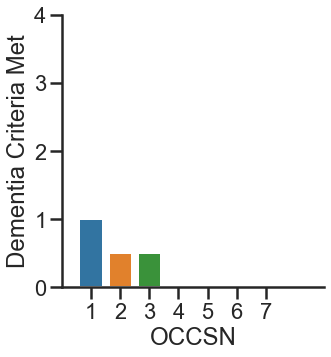

336009


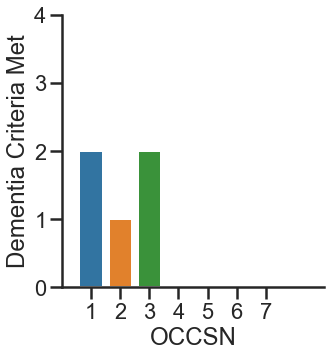

336022


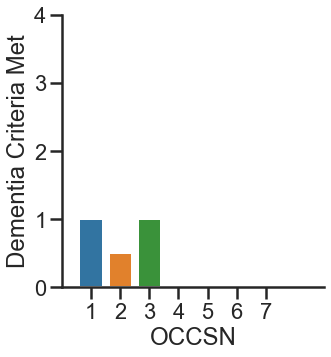

336028


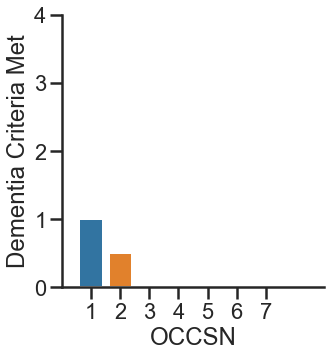

336506


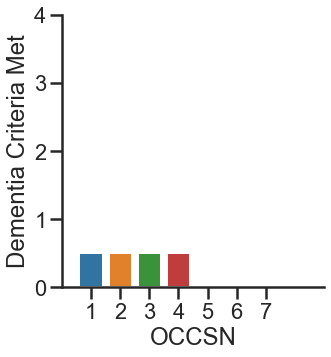

336516


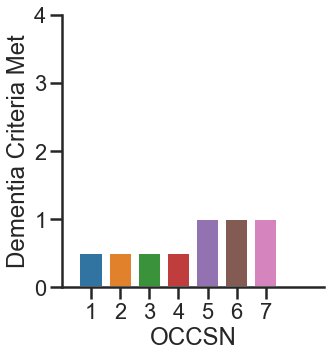

336539


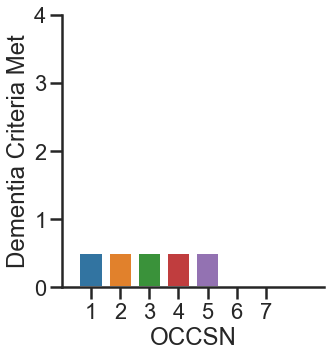

336540


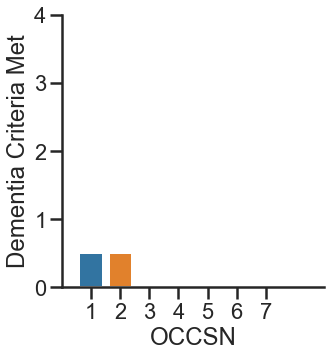

336545


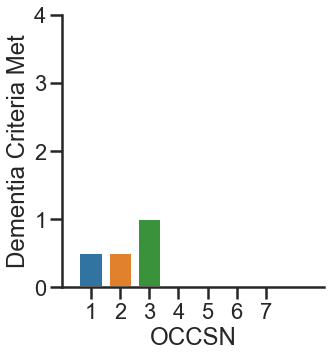

337027


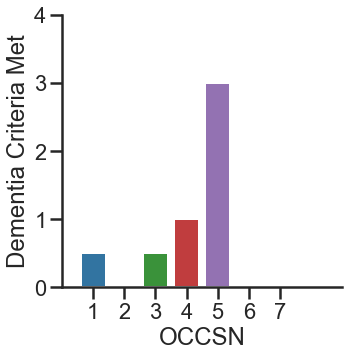

337032


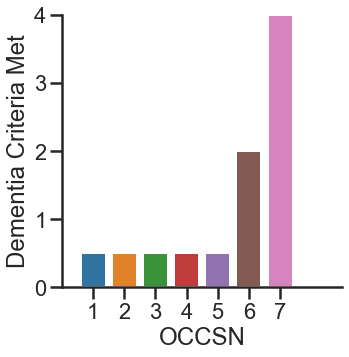

337509


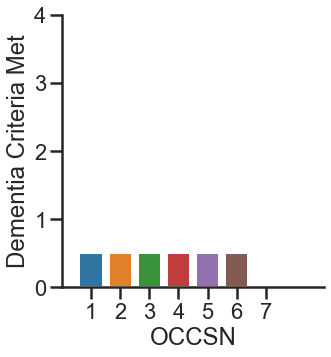

337515


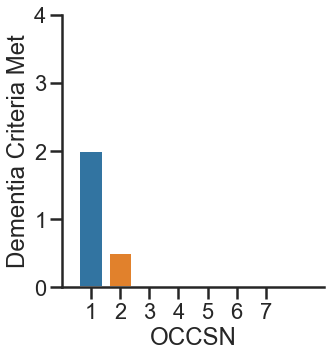

337540


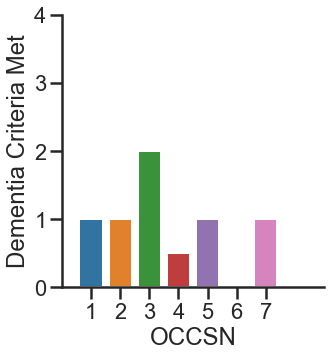

337545


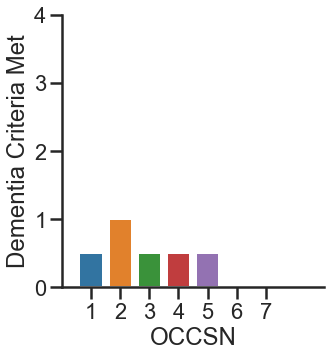

338508


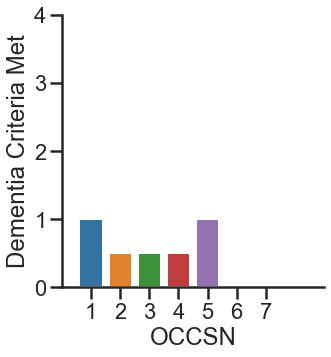

441353


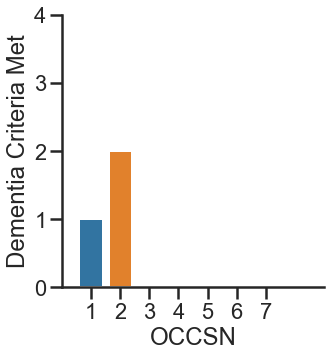

441405


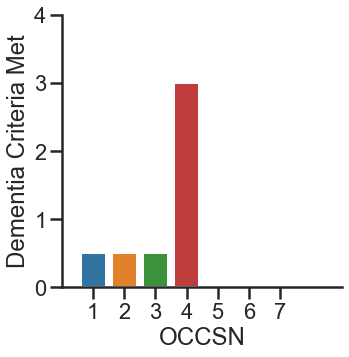

442002


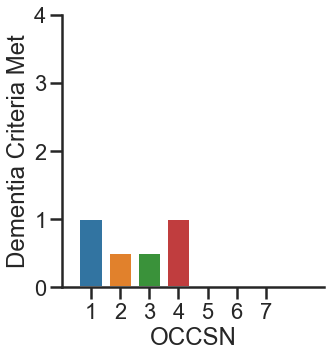

442151


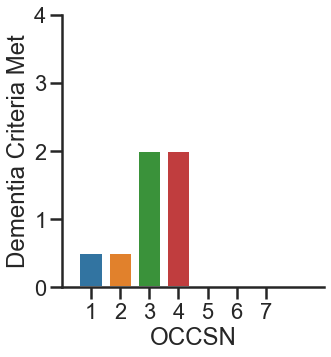

442154


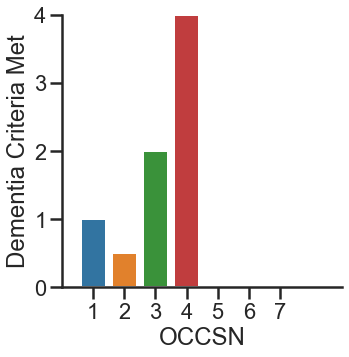

442202


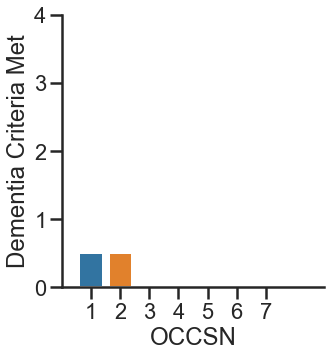

442505


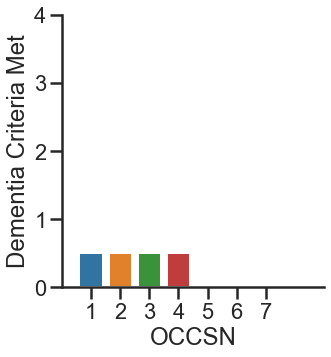

442553


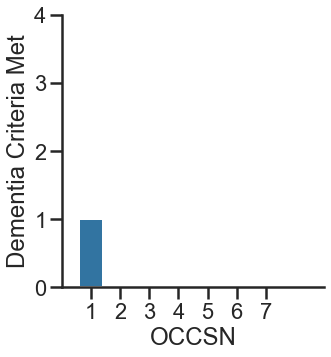

442804


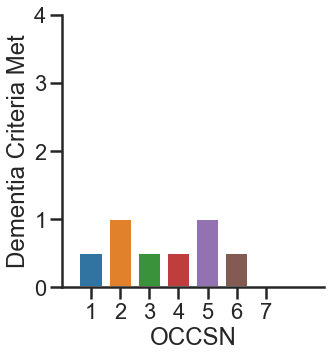

443202


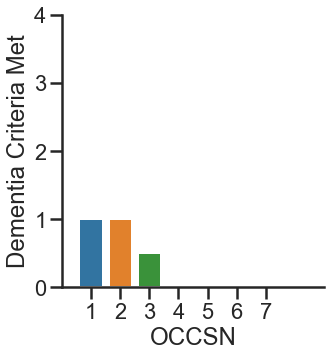

443354


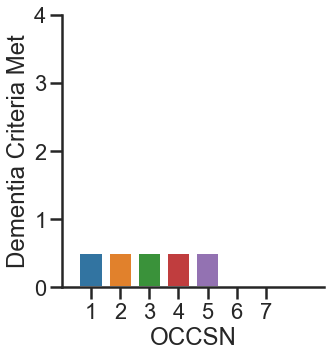

443606


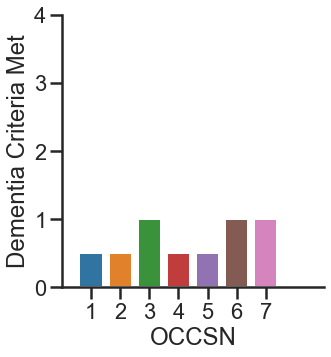

551055


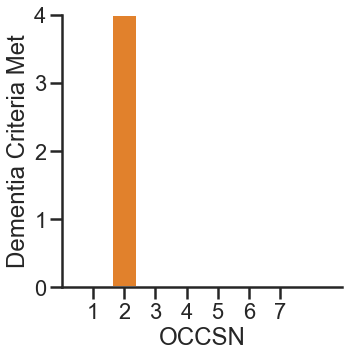

551104


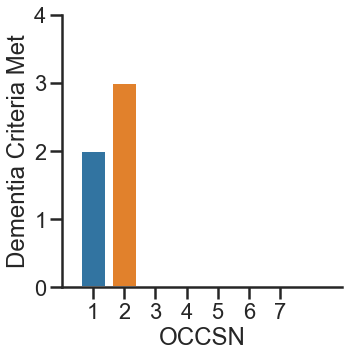

551505


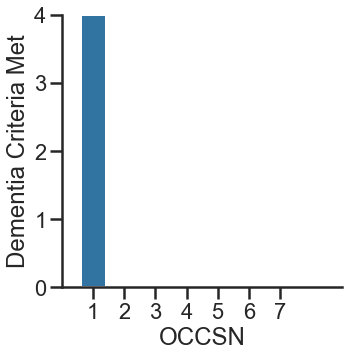

551702


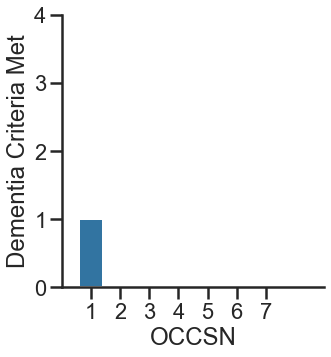

551904


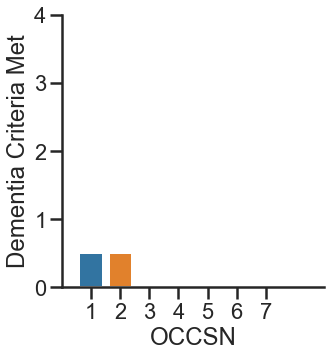

551957


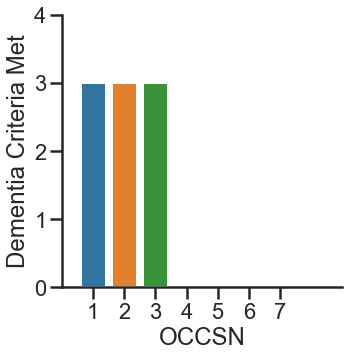

551958


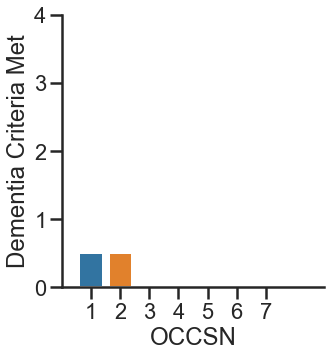

552052


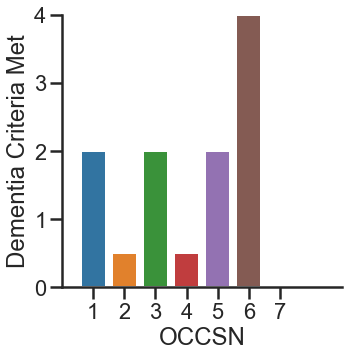

552053


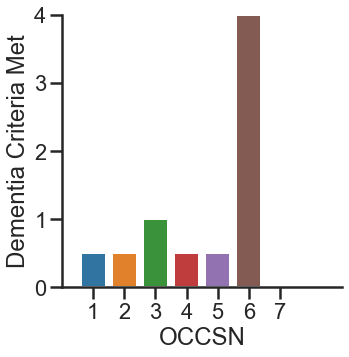

552055


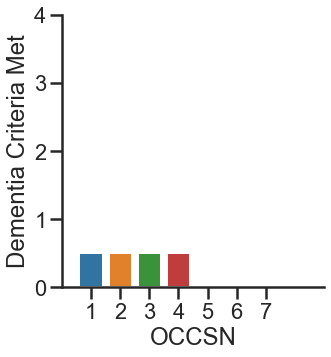

552252


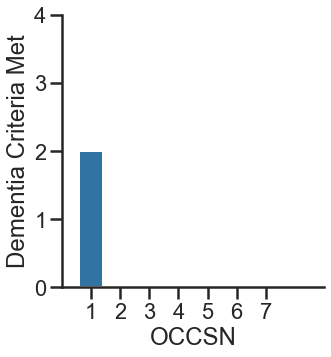

552455


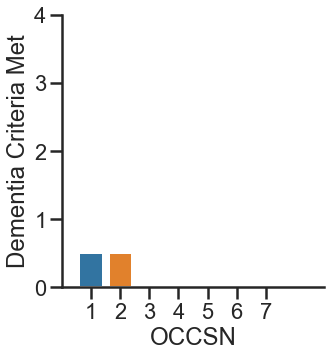

552501


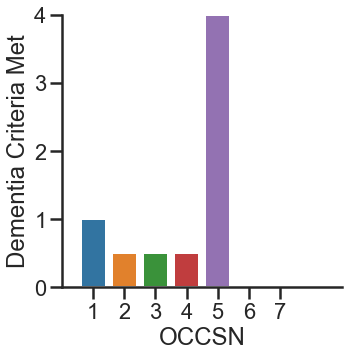

552503


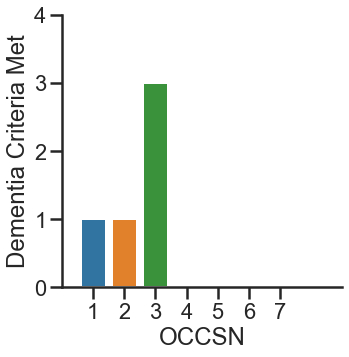

552654


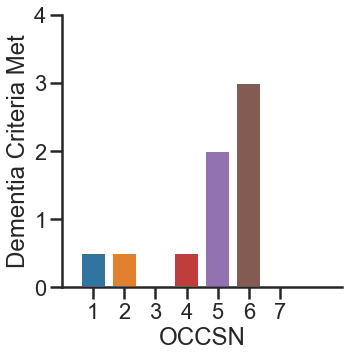

552951


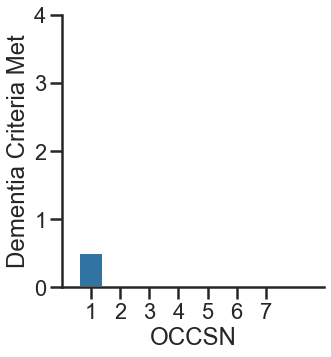

553005


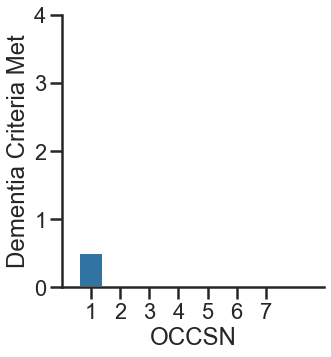

553252


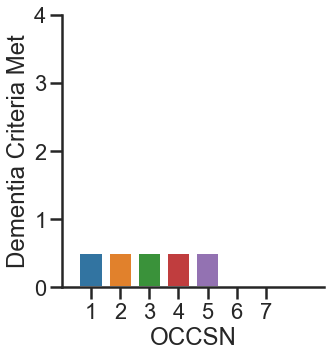

553504


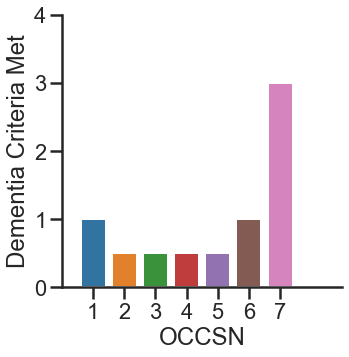

553658


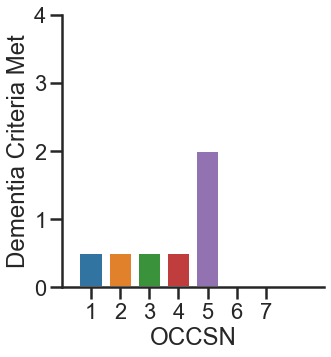

660809


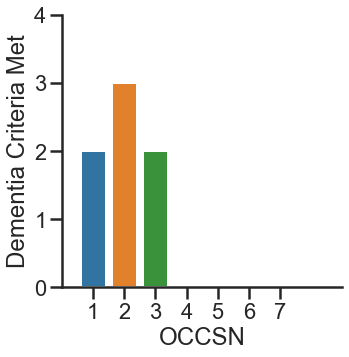

661107


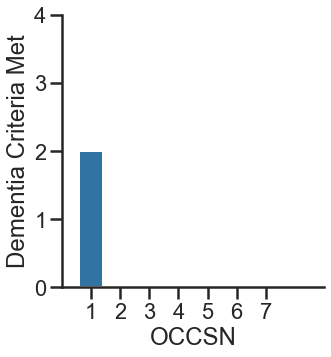

661457


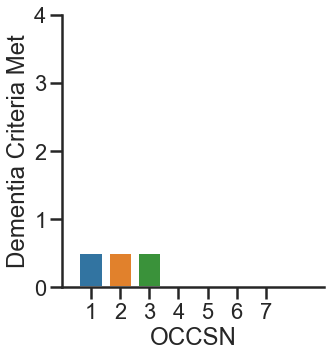

661807


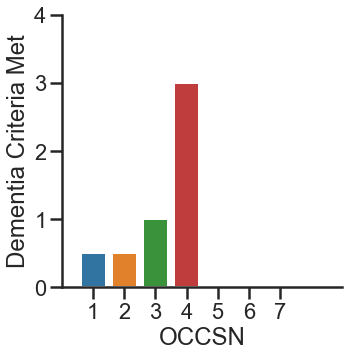

661857


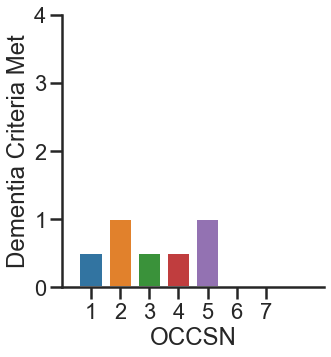

661954


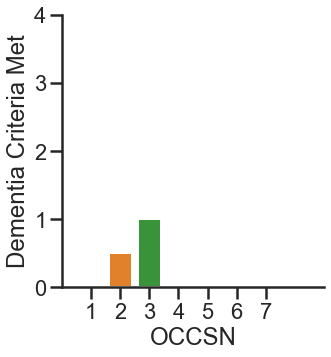

662010


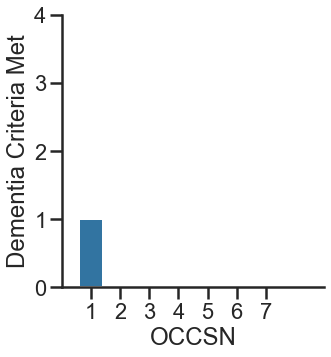

662012


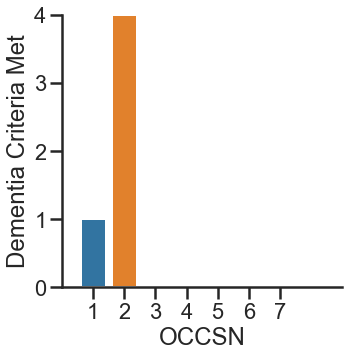

662013


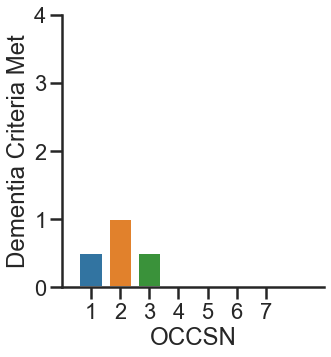

662106


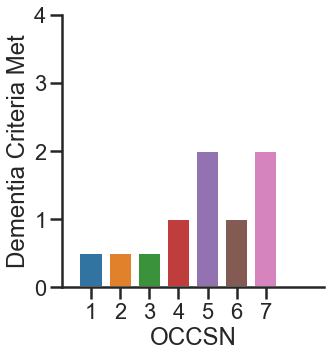

662154


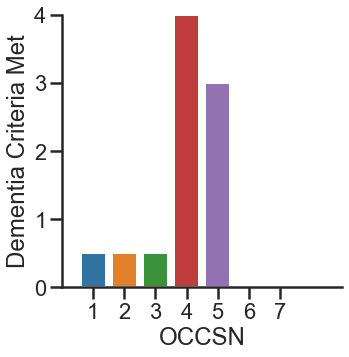

662257


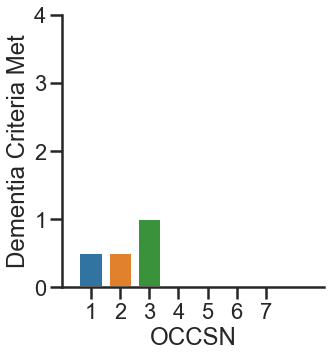

662303


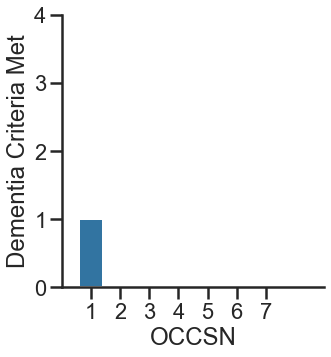

662311


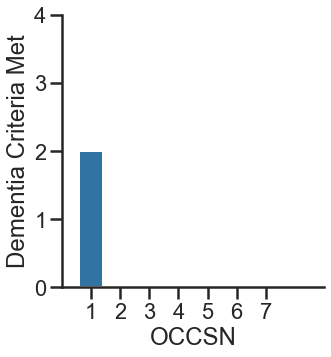

662359


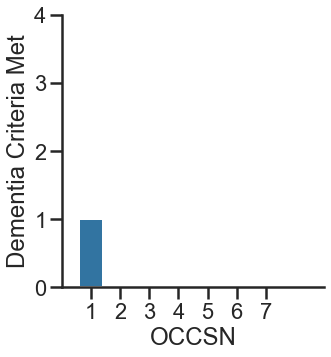

662402


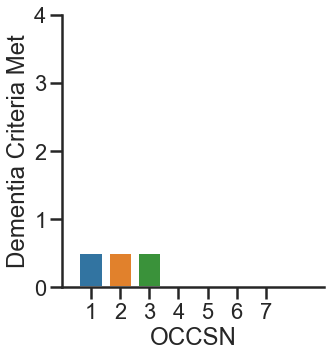

662561


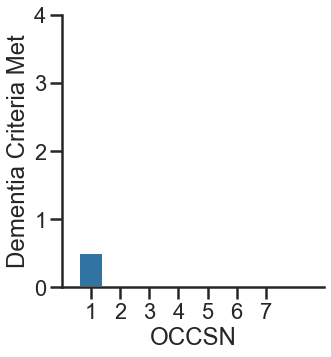

662854


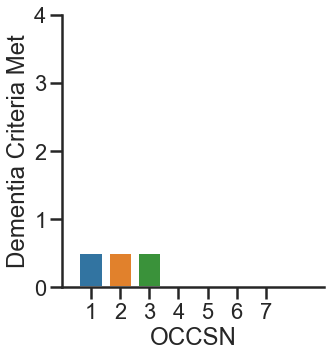

662860


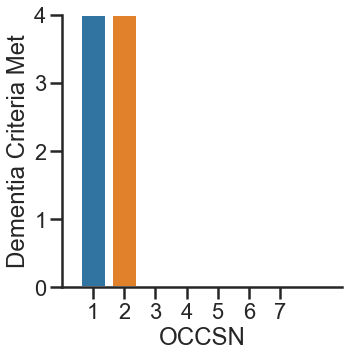

662954


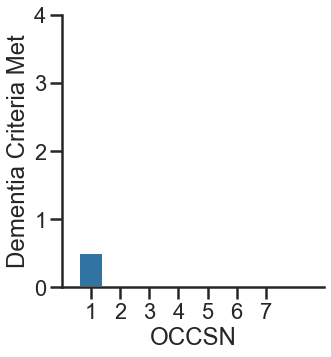

663051


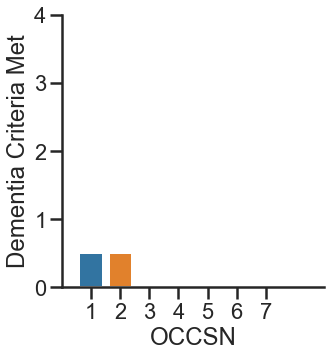

663156


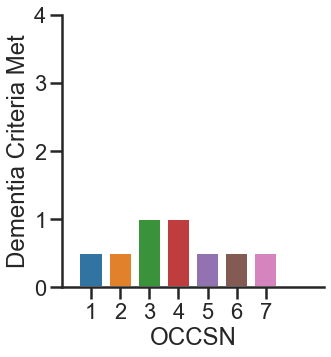

663160


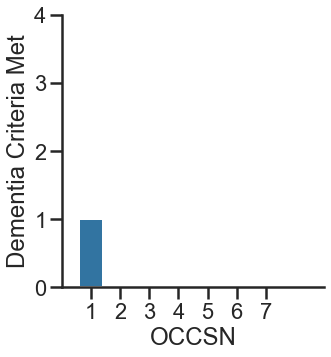

663259


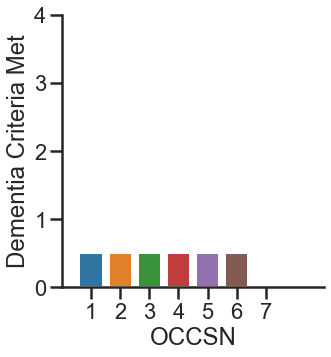

663458


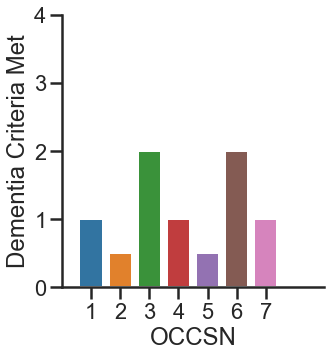

663555


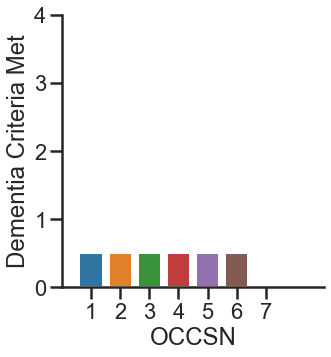

116537


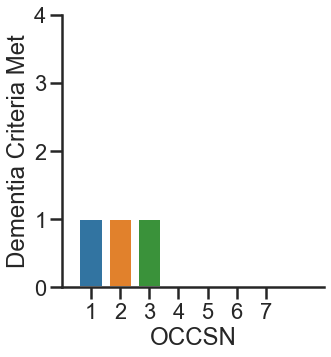

132093


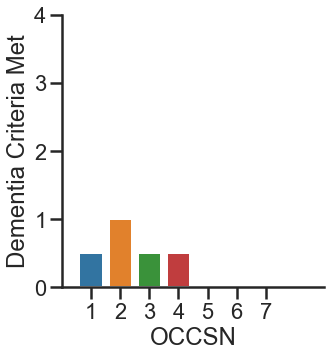

133521


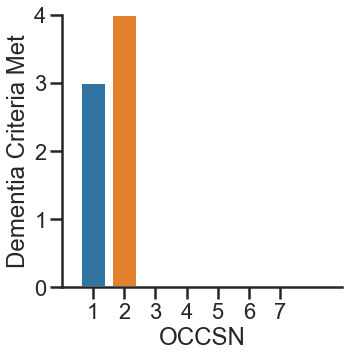

134514


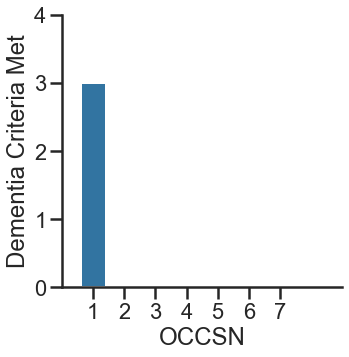

135519


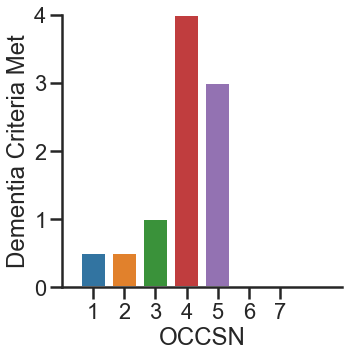

136010


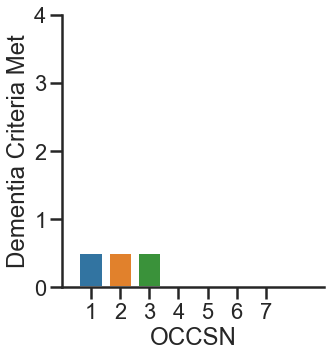

137002


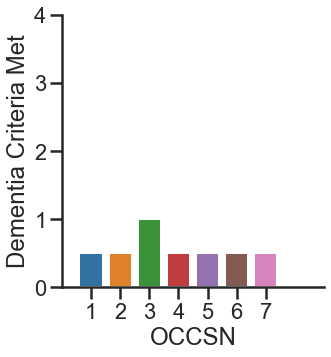

137517


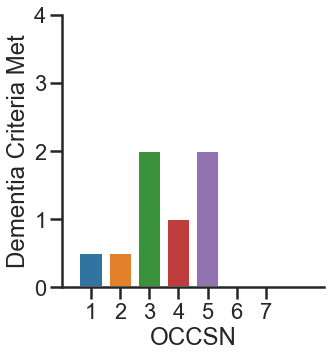

213593


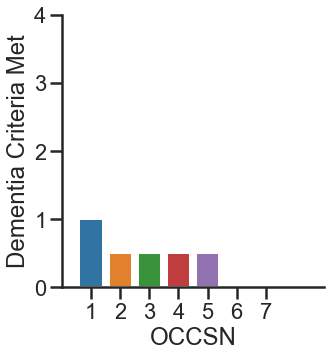

227523


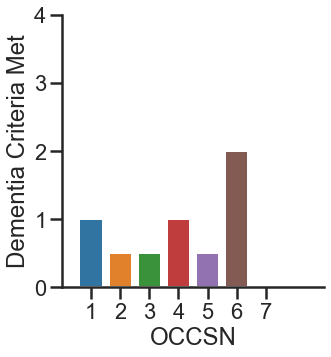

227535


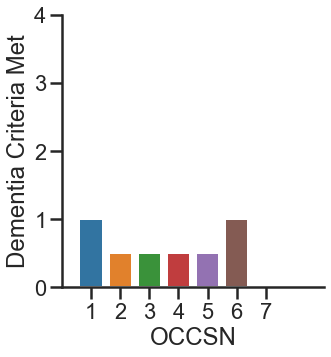

232103


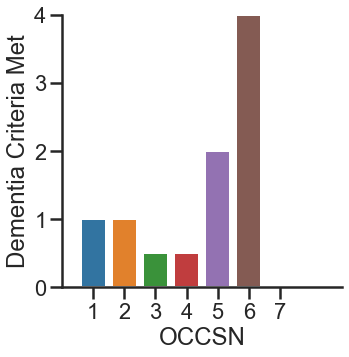

235554


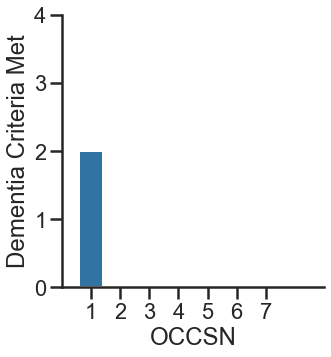

236005


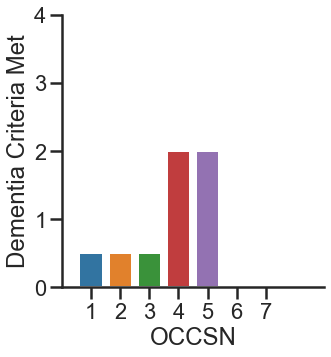

236033


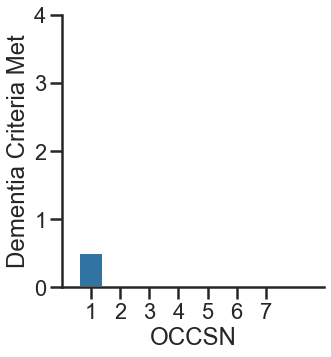

236048


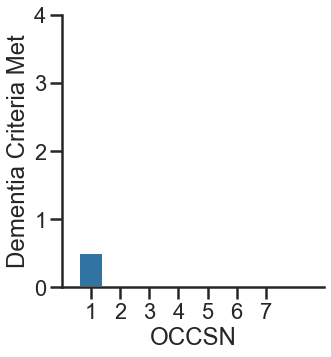

236507


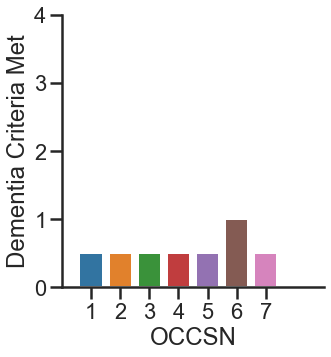

237032


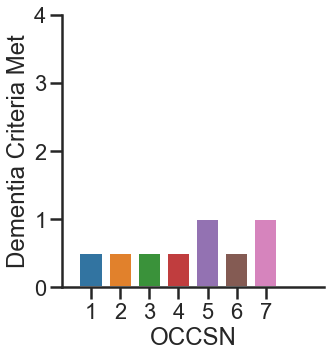

237530


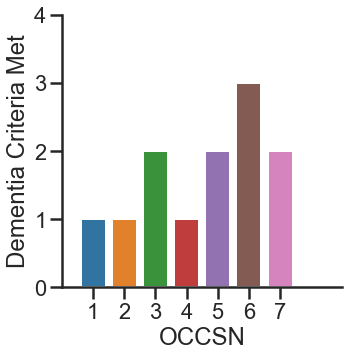

237552


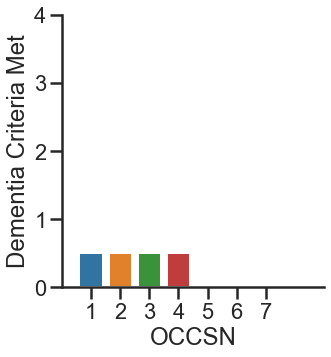

237558


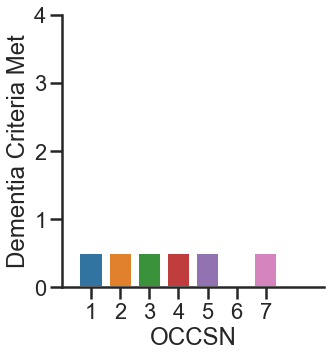

238008


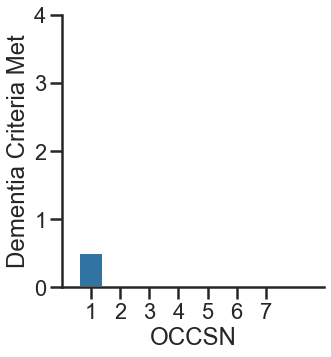

238021


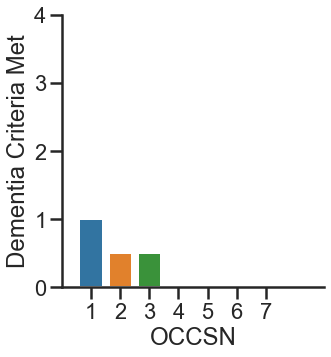

238514


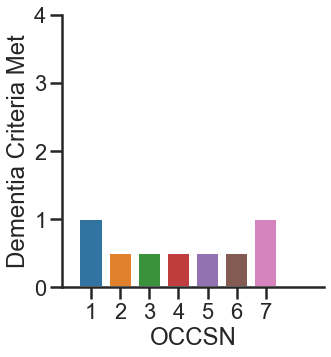

238528


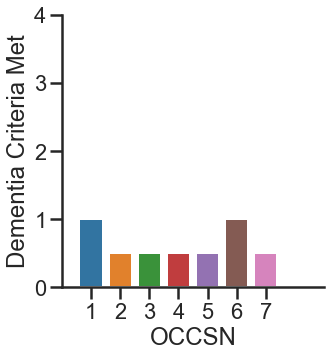

238538


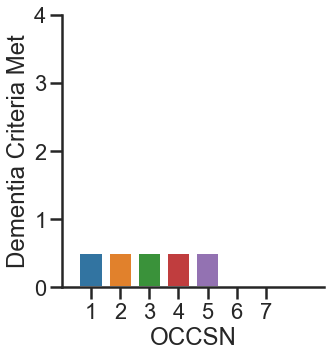

238540


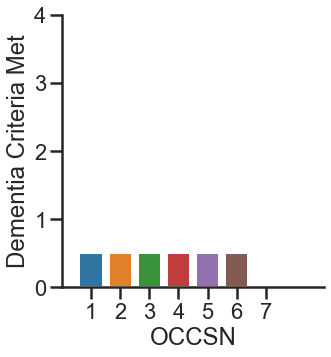

238549


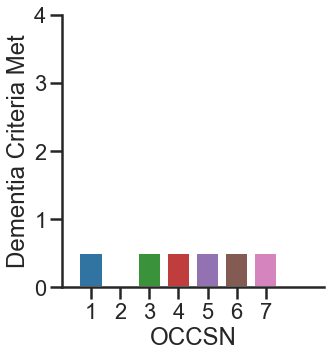

334540


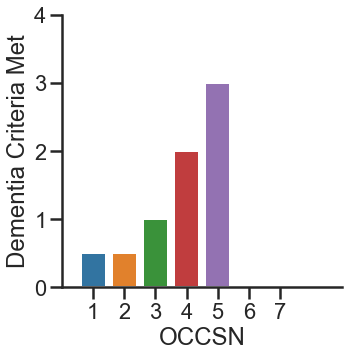

335024


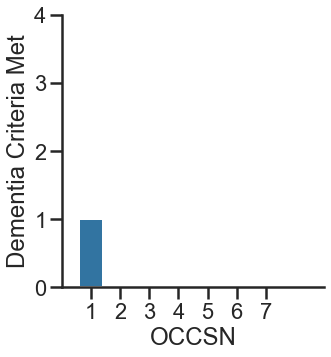

335502


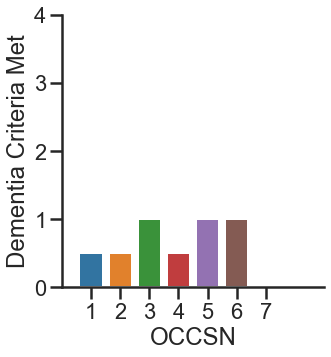

335513


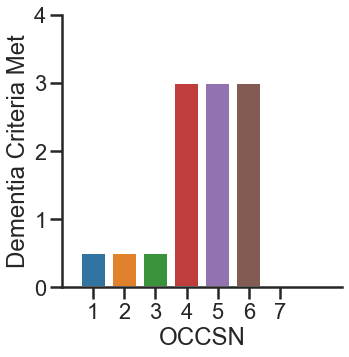

335522


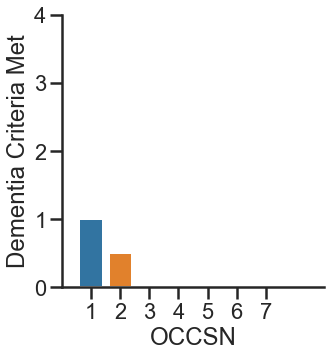

336003


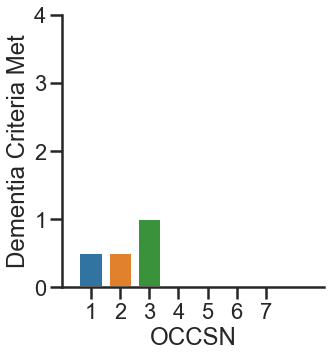

336006


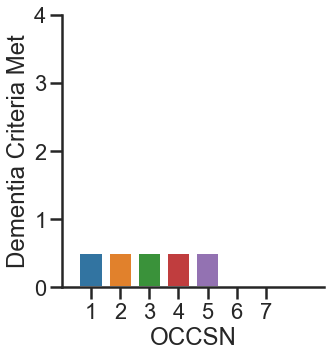

336044


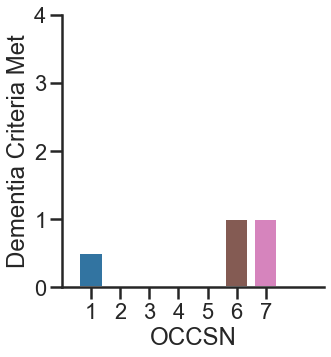

336501


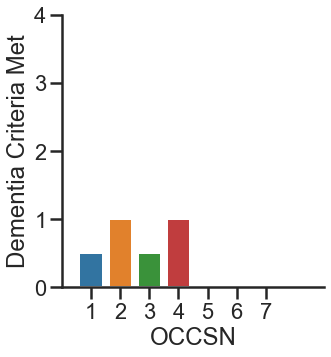

336508


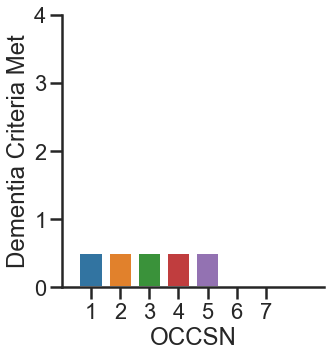

336509


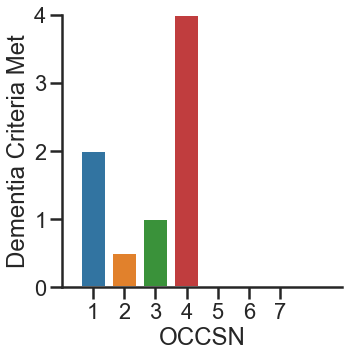

337018


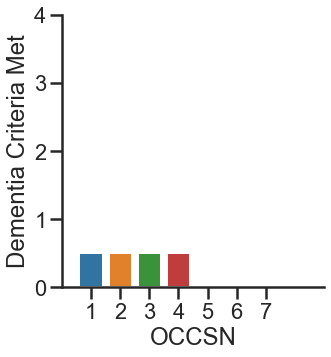

337020


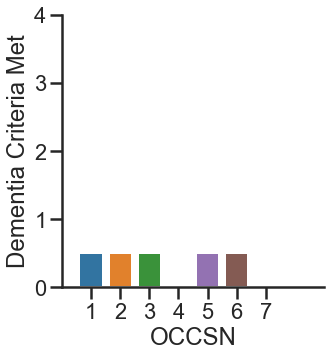

337504


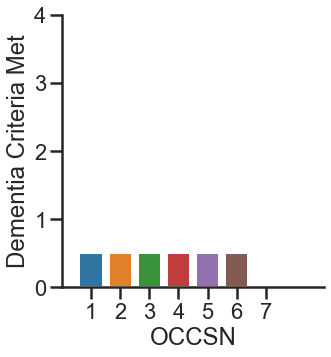

337537


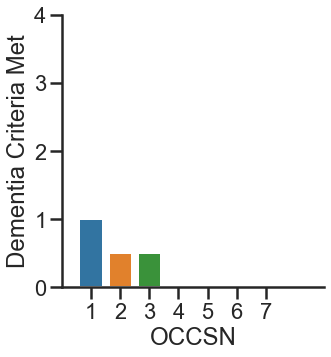

337546


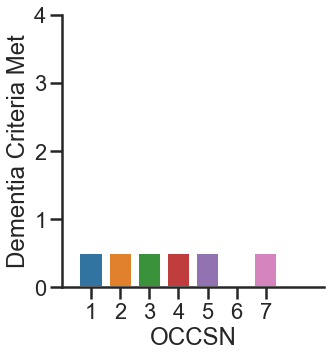

337550


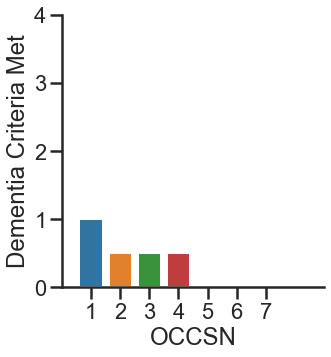

338010


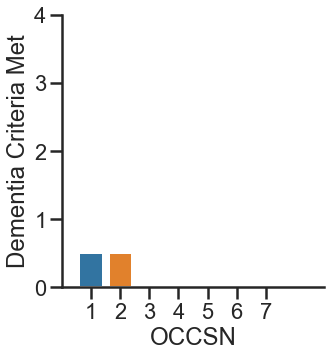

338021


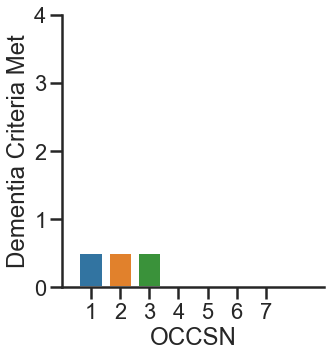

338024


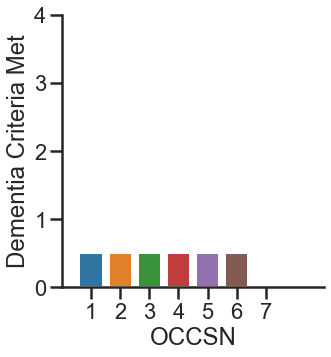

338509


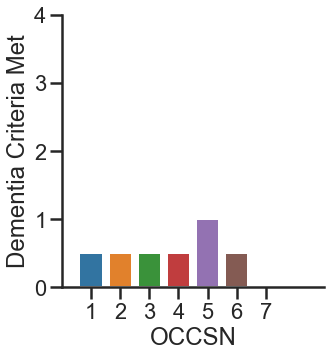

441305


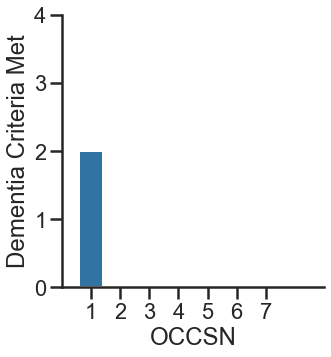

441558


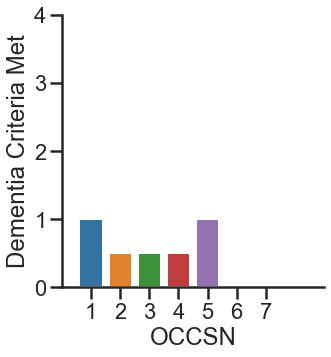

441803


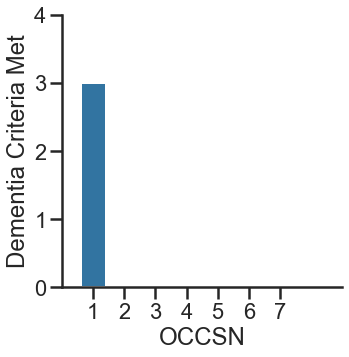

441951


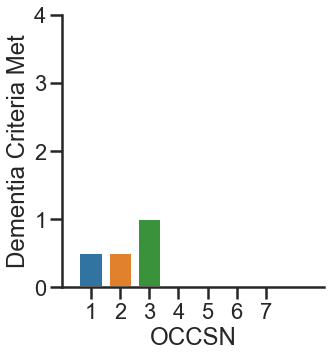

442103


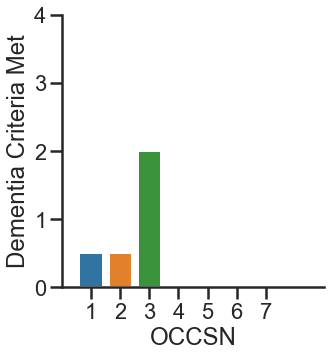

442401


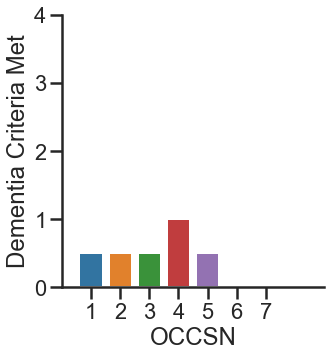

442507


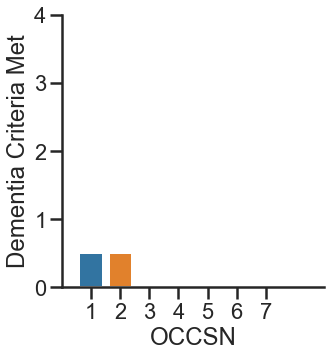

442854


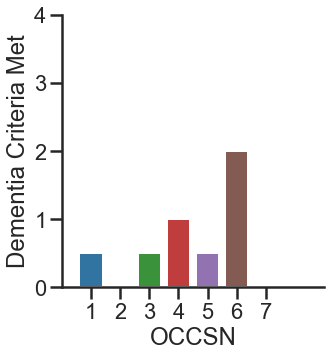

443501


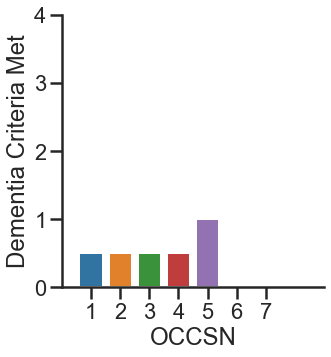

443603


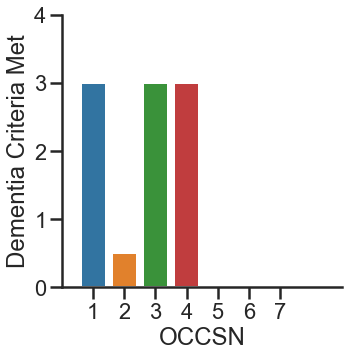

443651


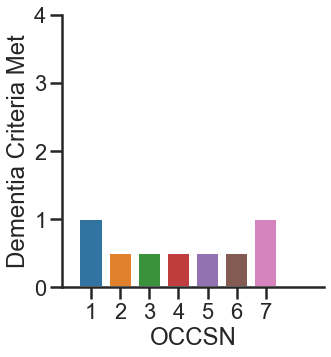

443701


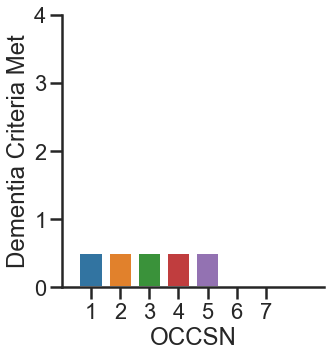

443801


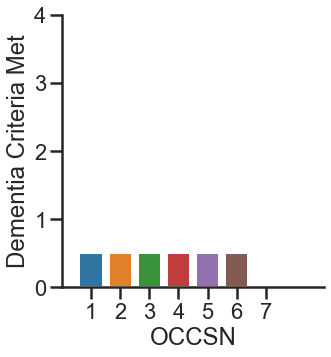

443805


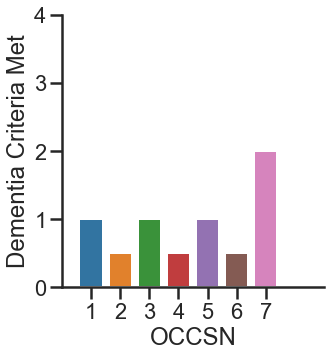

443853


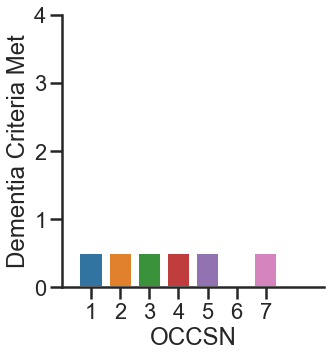

443855


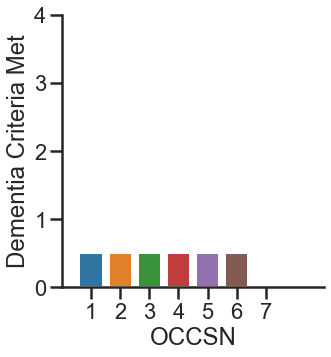

443952


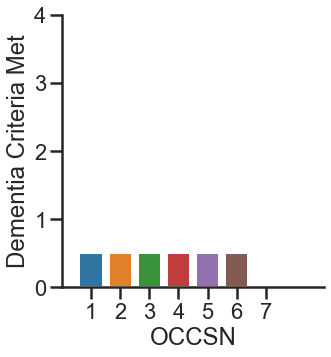

444052


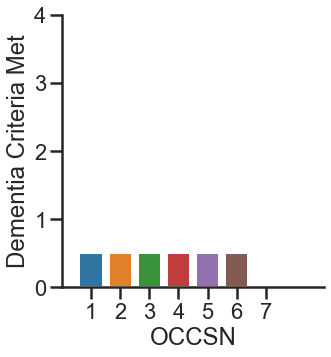

550403


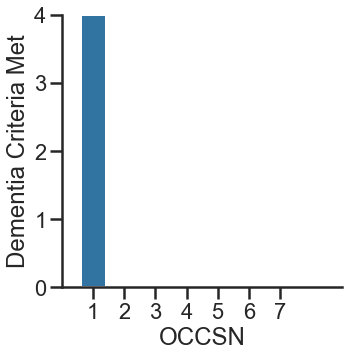

551051


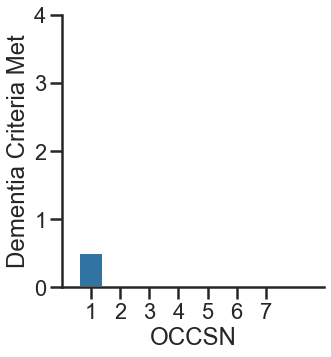

551555


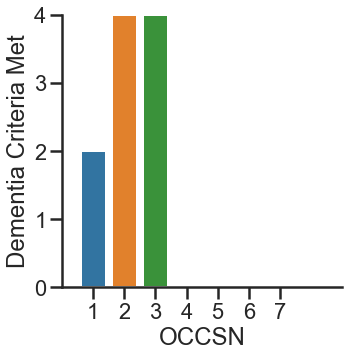

551705


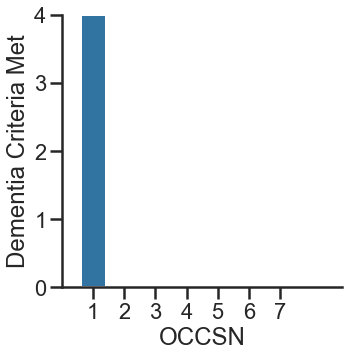

551706


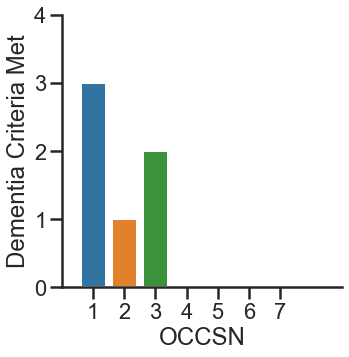

552105


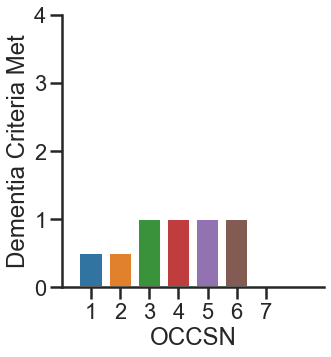

552202


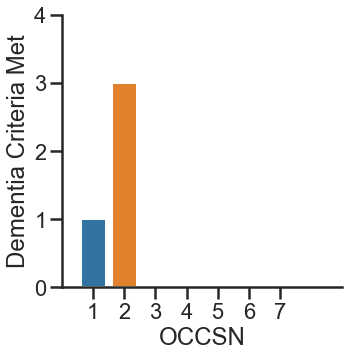

552204


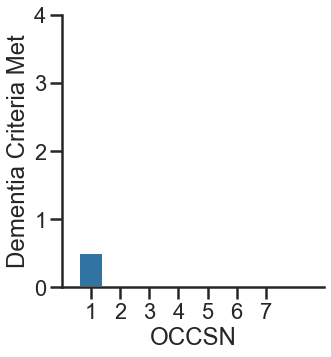

552205


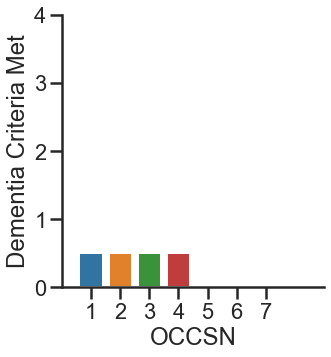

552355


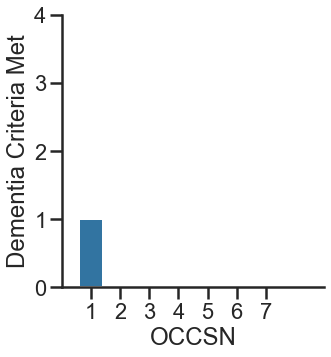

552356


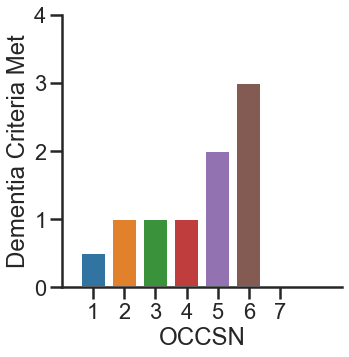

552604


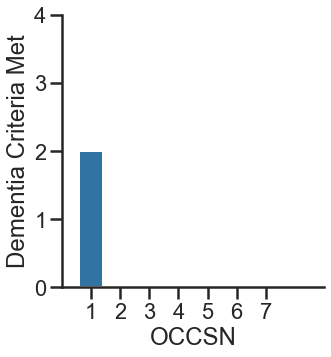

552701


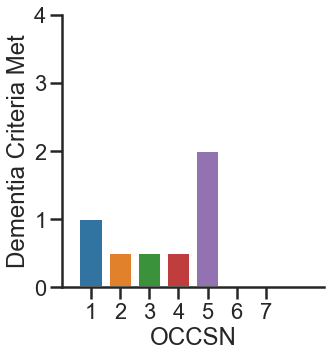

552753


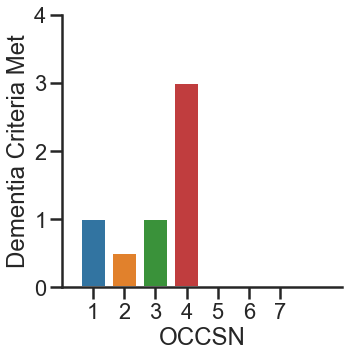

552754


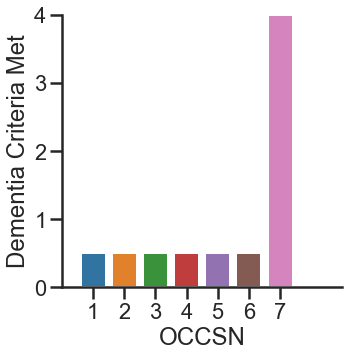

552755


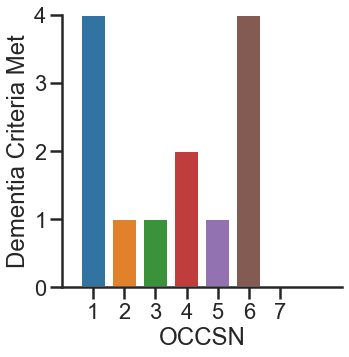

552756


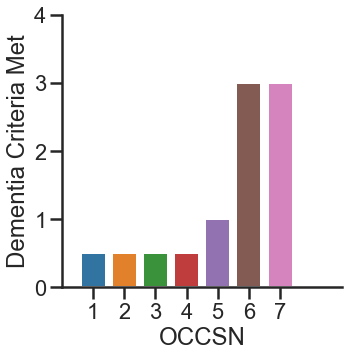

552955


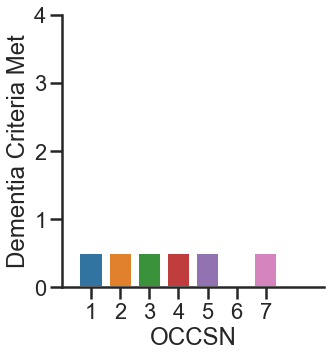

553002


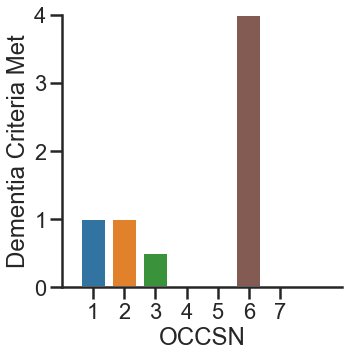

553055


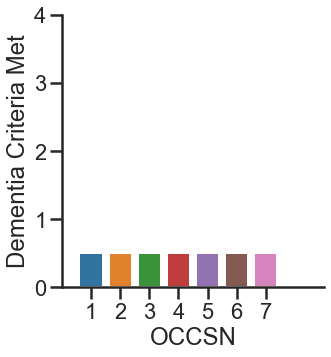

553301


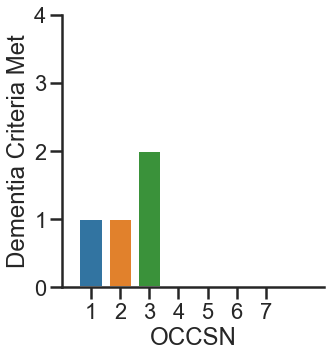

553451


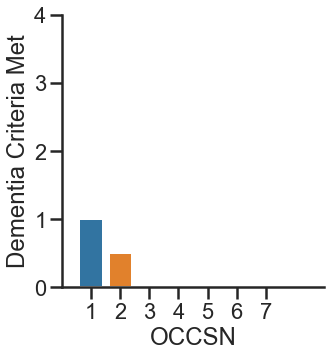

553555


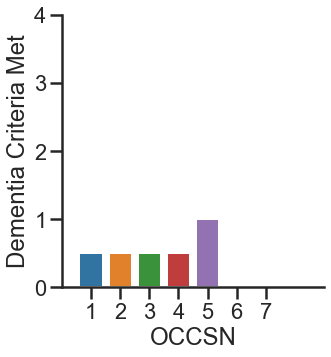

553651


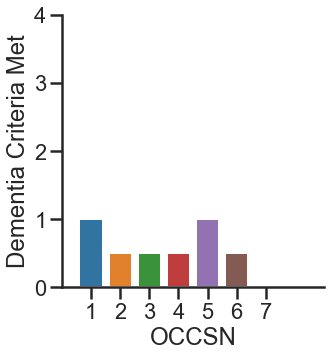

553654


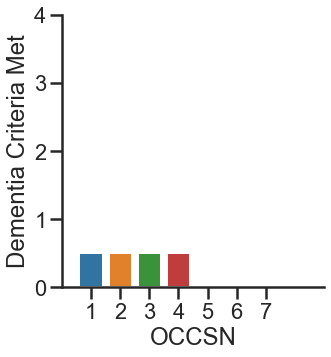

553655


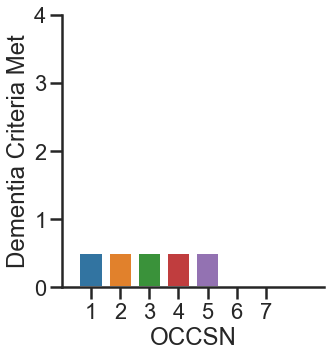

553703


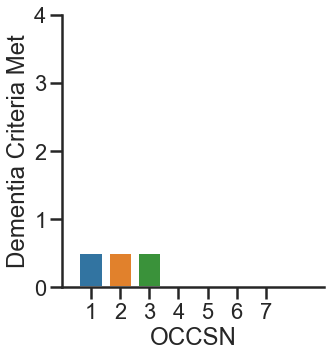

553756


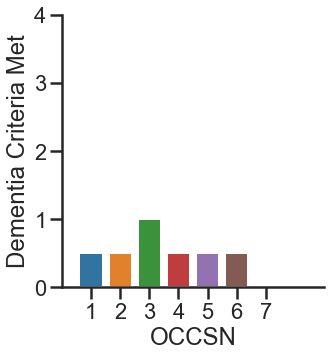

553801


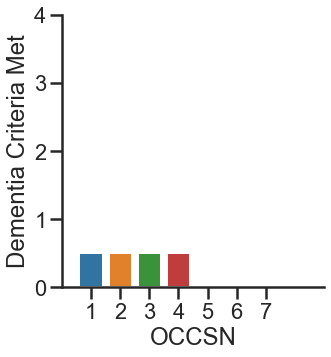

553852


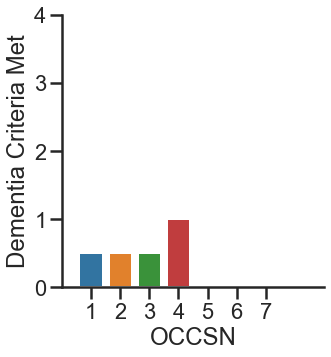

553854


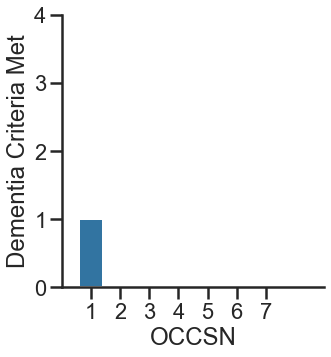

553902


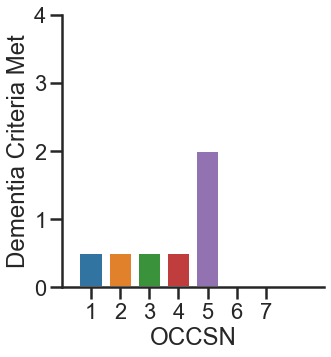

553954


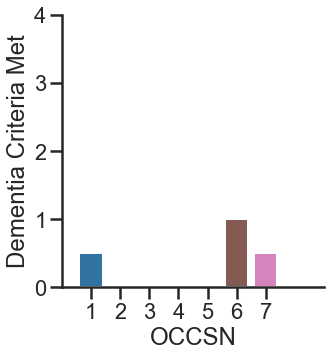

553955


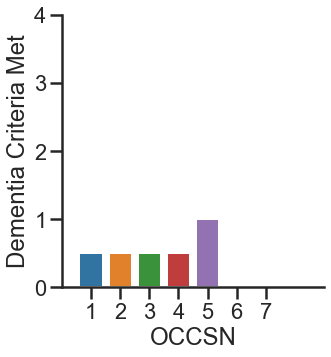

661308


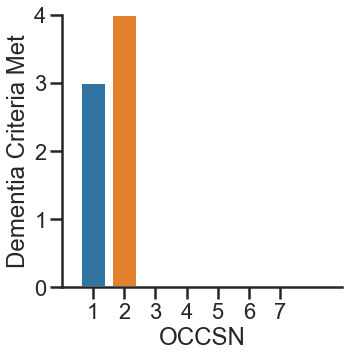

661356


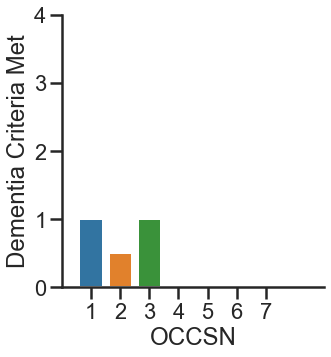

661404


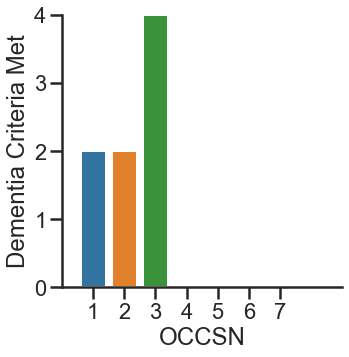

661461


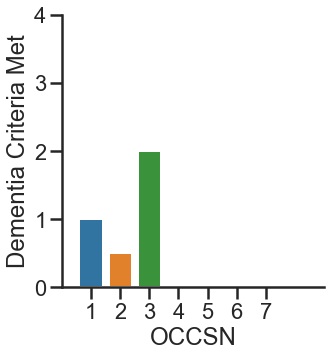

661652


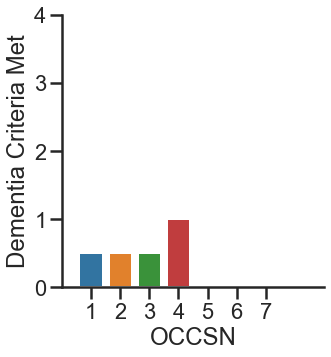

661654


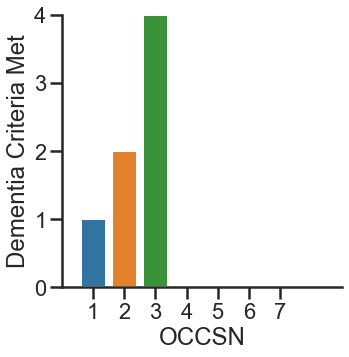

661754


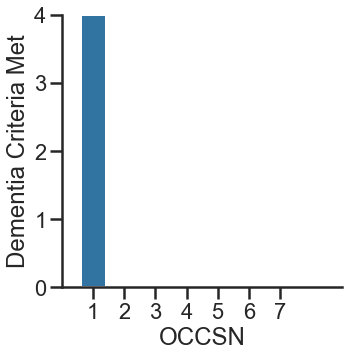

661758


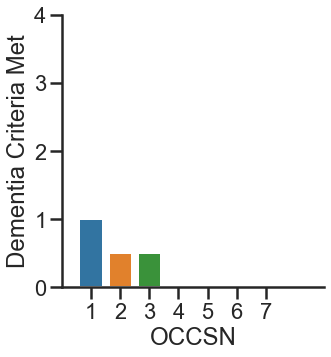

661803


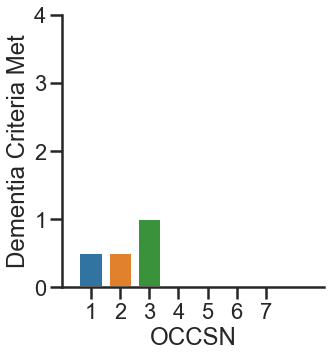

661808


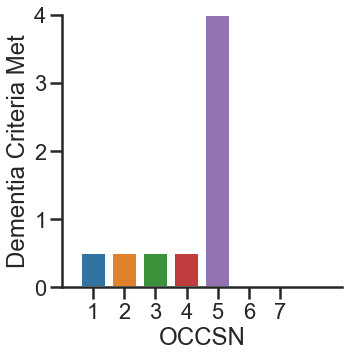

661856


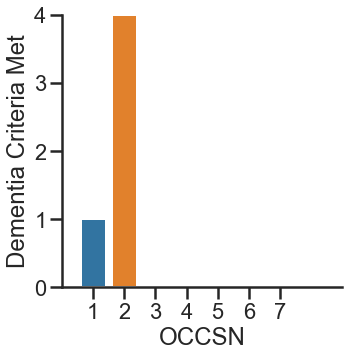

661905


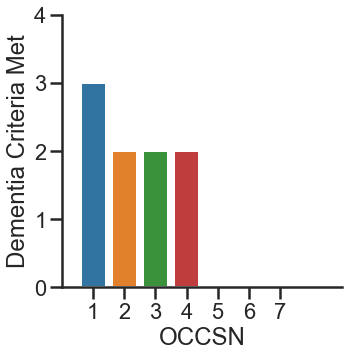

662002


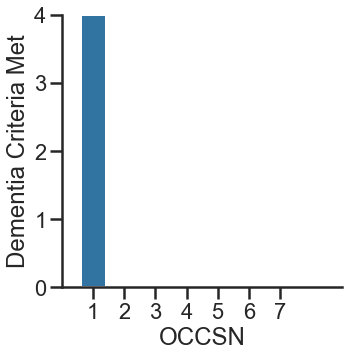

662008


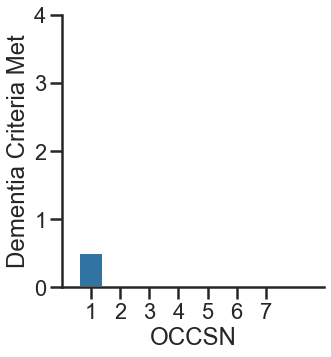

662011


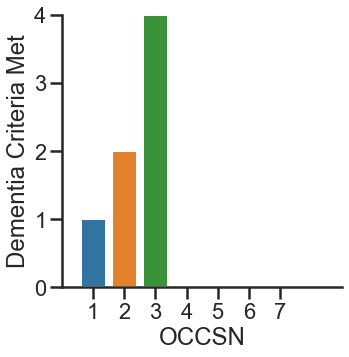

662055


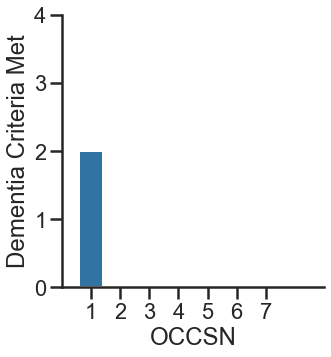

662205


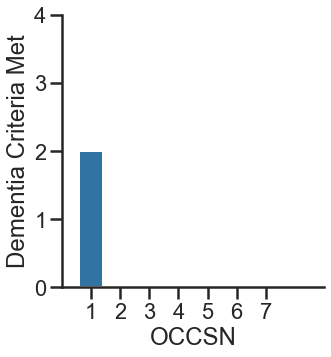

662258


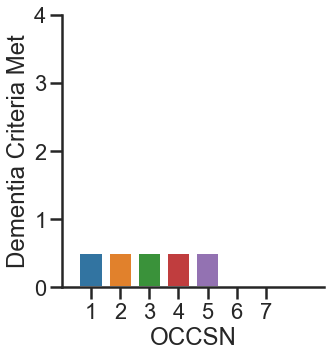

662357


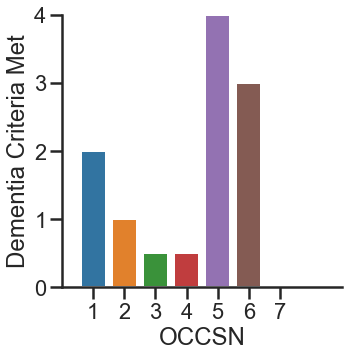

662360


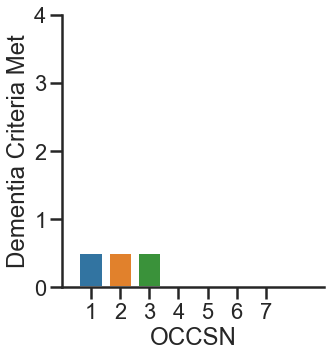

662502


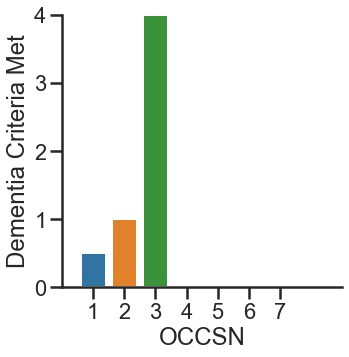

662504


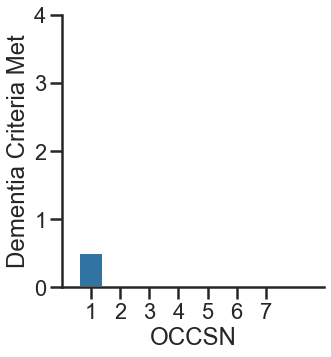

662552


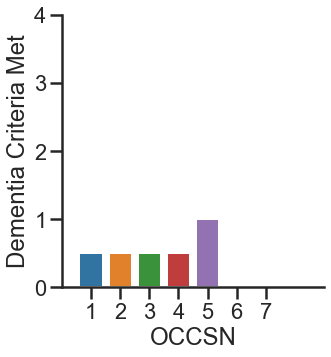

662555


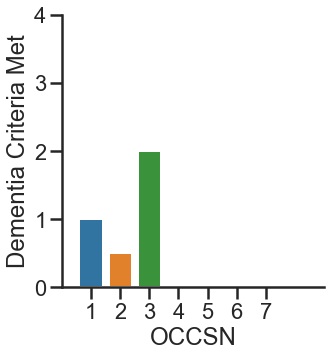

662601


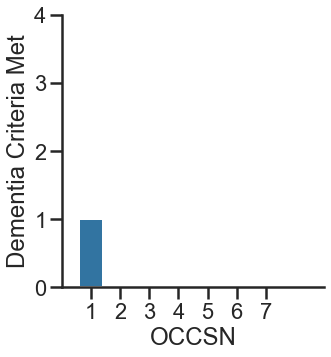

662663


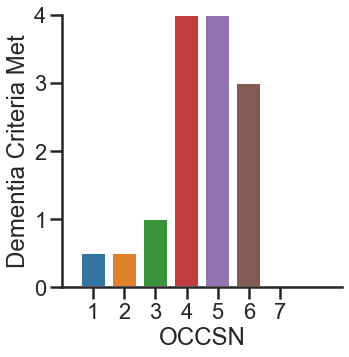

662707


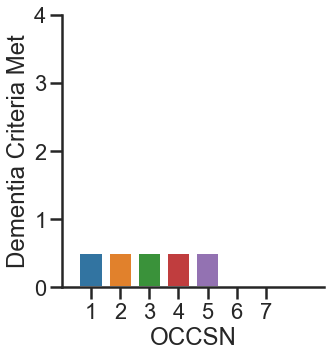

662853


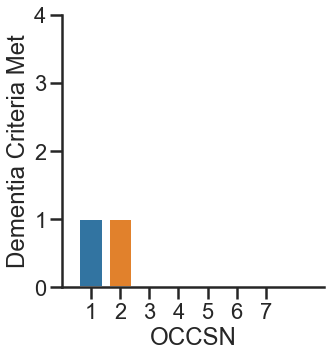

662858


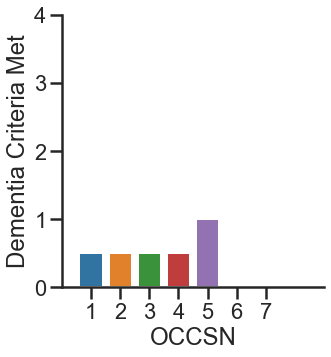

662859


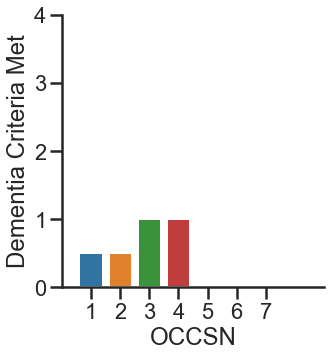

662863


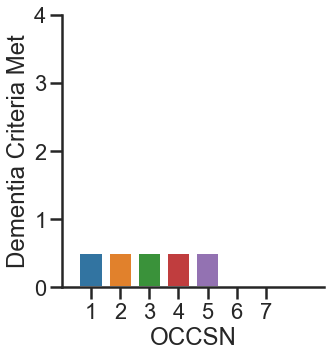

662901


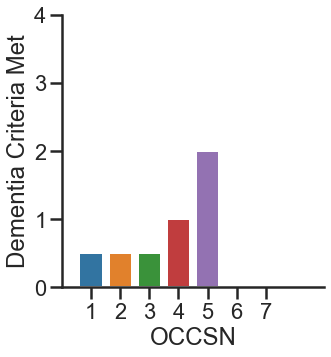

662903


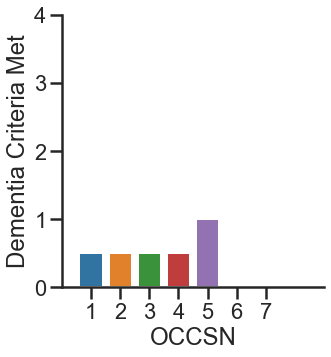

662905


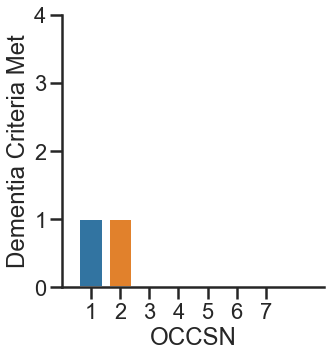

662907


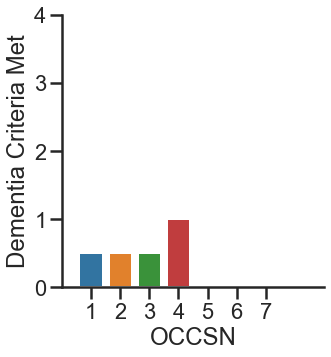

662956


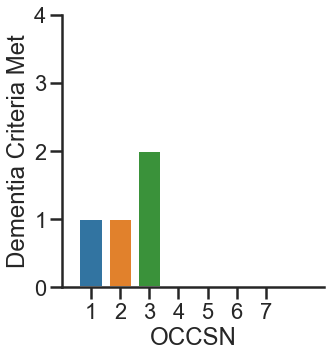

662958


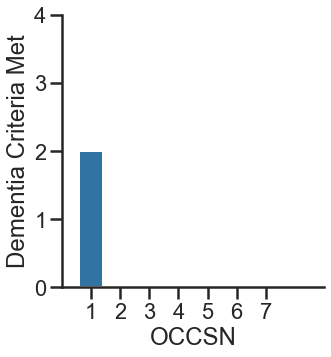

663058


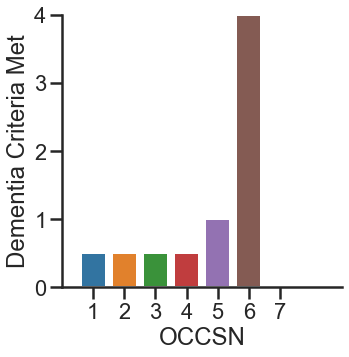

663104


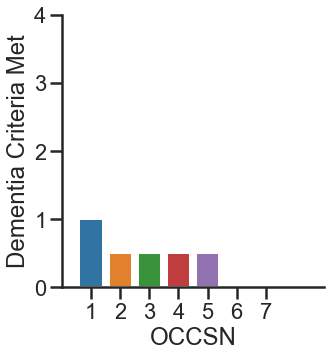

663106


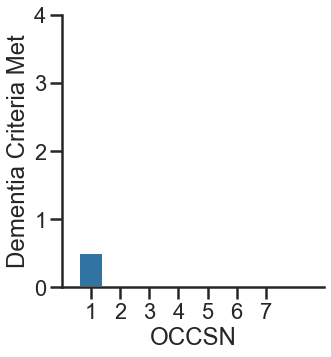

663107


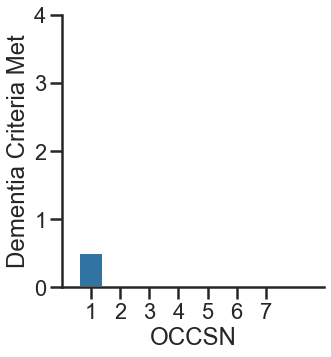

663153


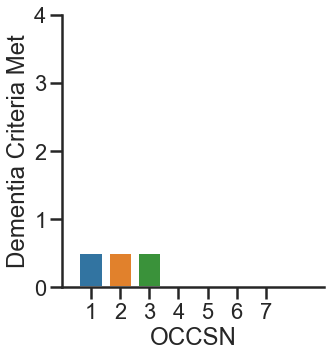

663203


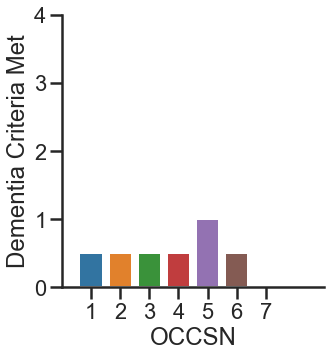

663254


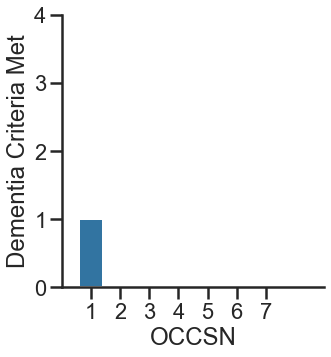

663257


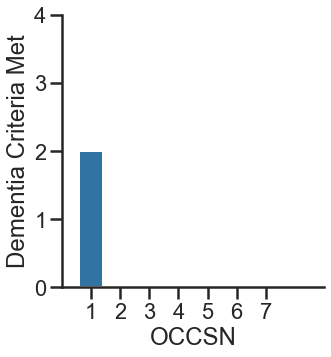

663356


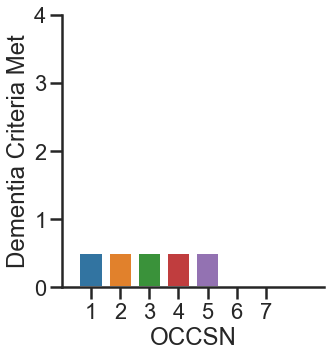

663403


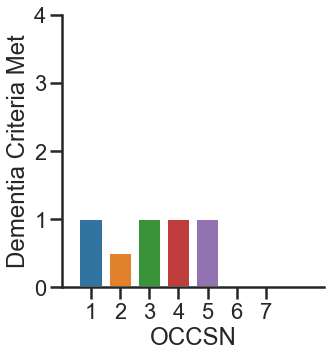

663452


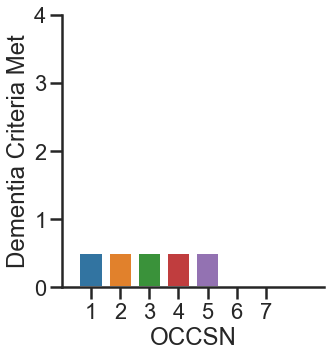

663453


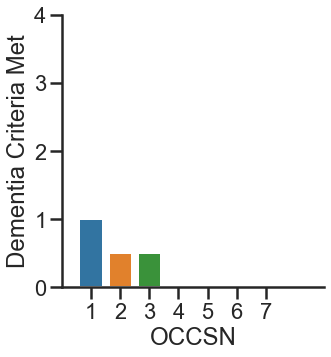

663552


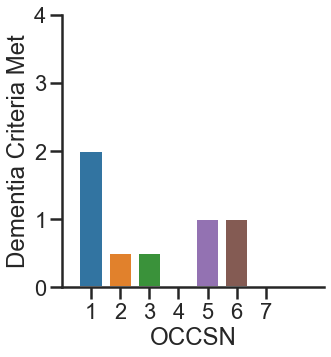

663605


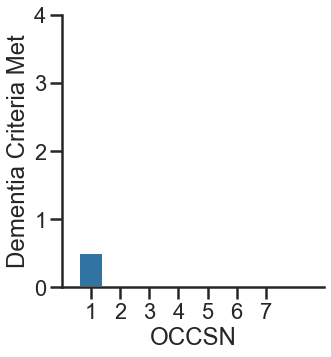

663654


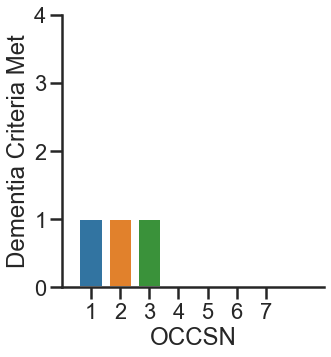

663855


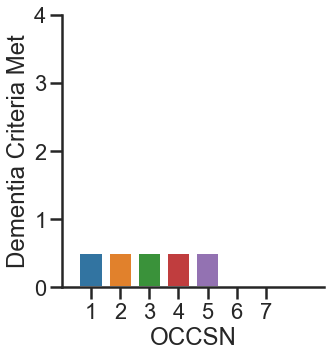

663906


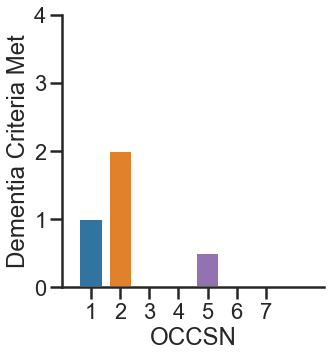

663954


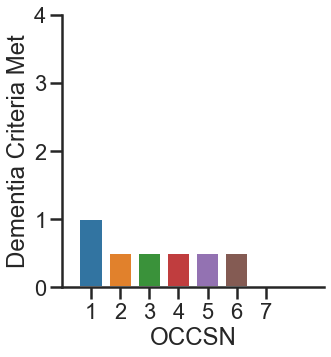

663956


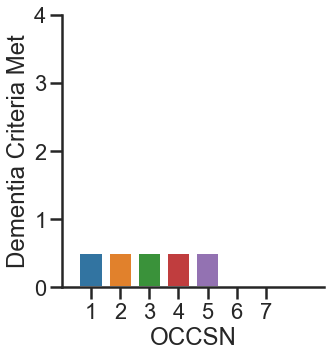

135023


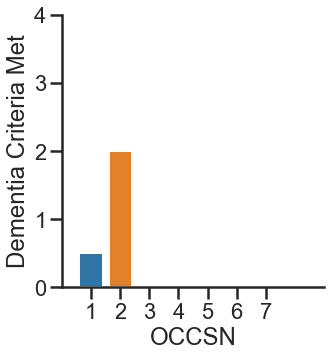

136515


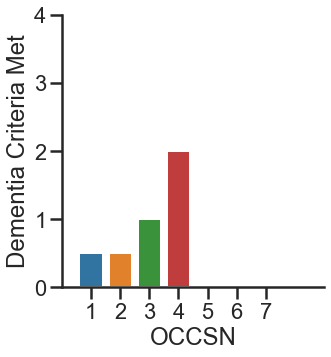

137012


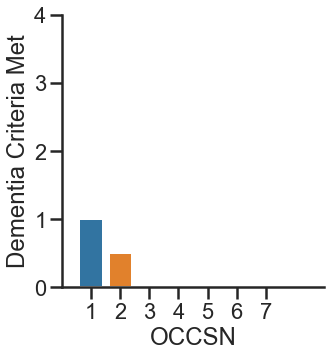

137503


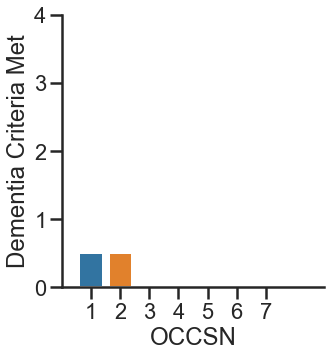

151320


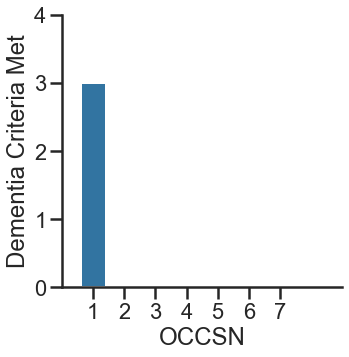

224530


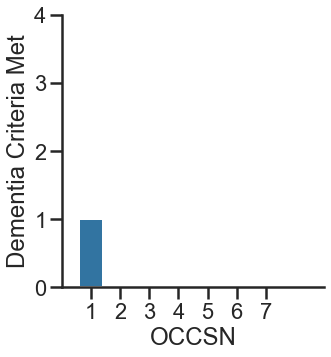

225556


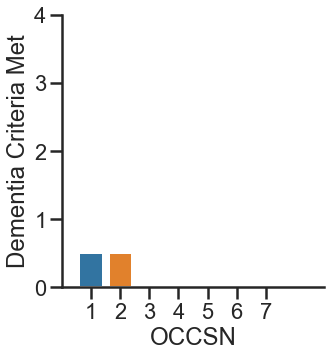

226059


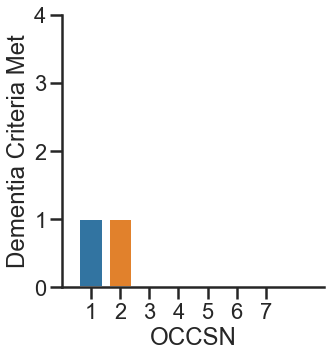

226578


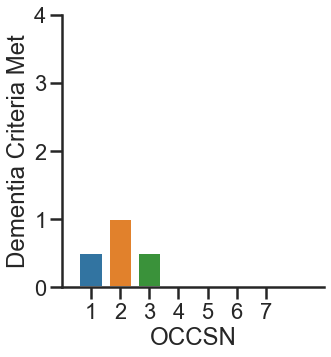

231101


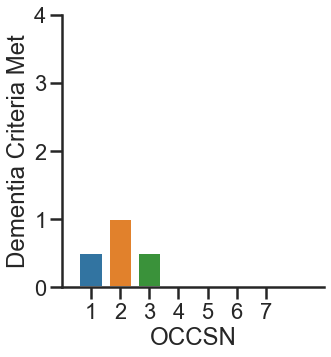

235017


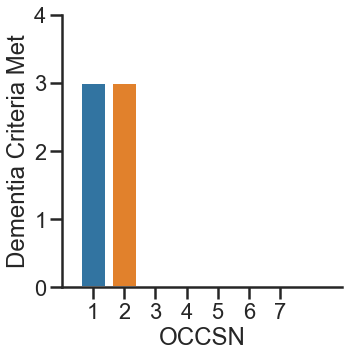

235555


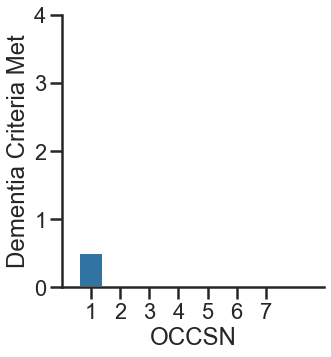

235560


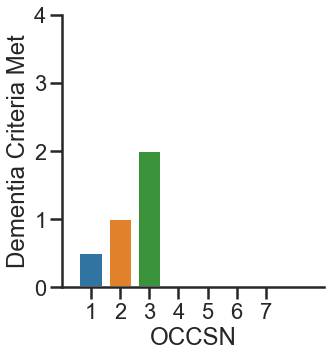

235573


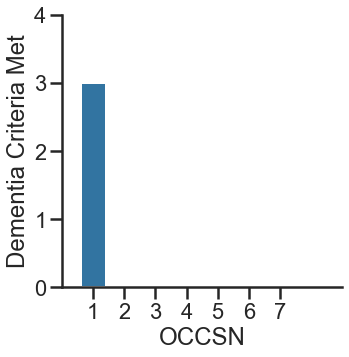

236011


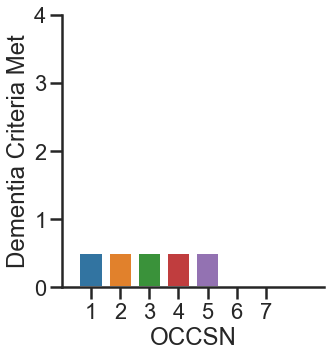

236013


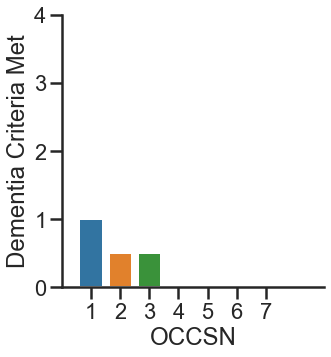

236022


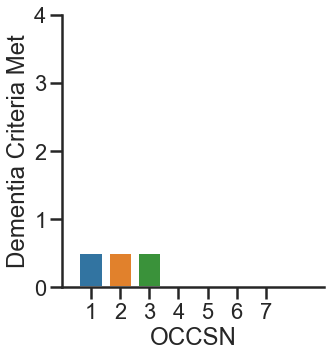

236025


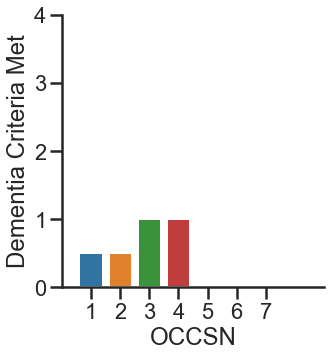

236568


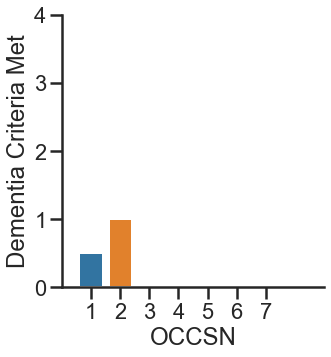

237033


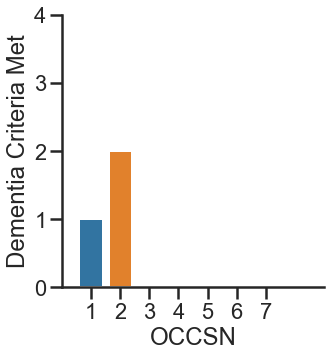

237517


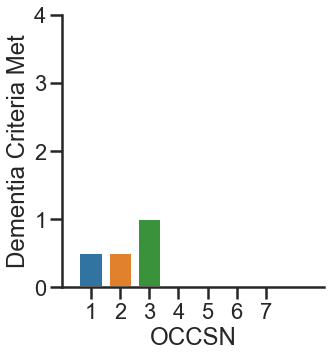

237550


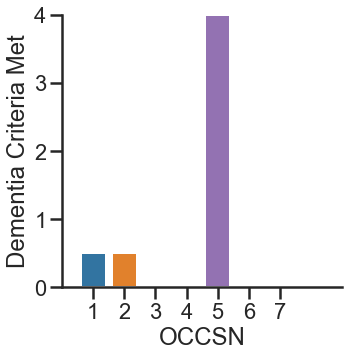

237554


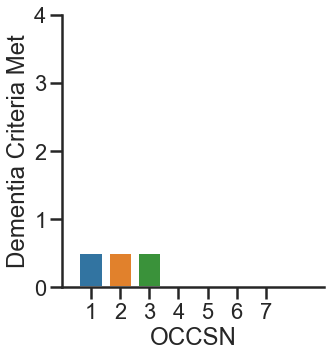

334518


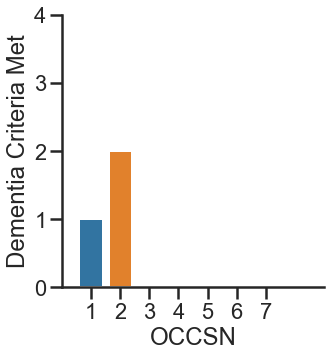

335038


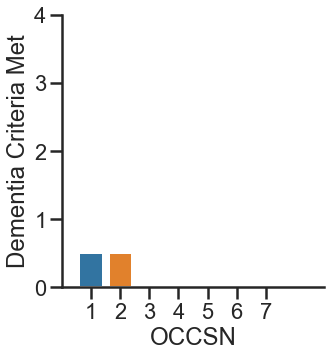

336027


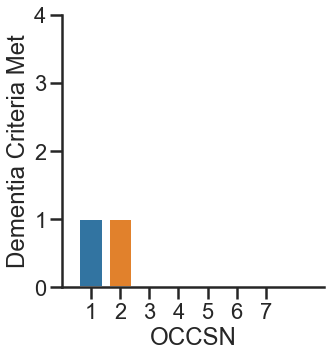

336033


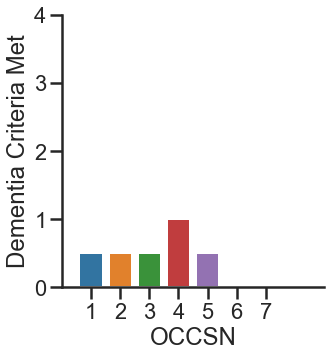

337011


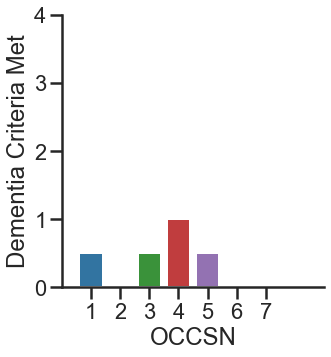

337538


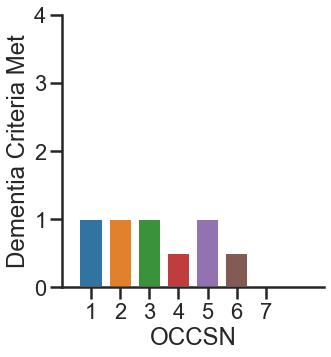

338009


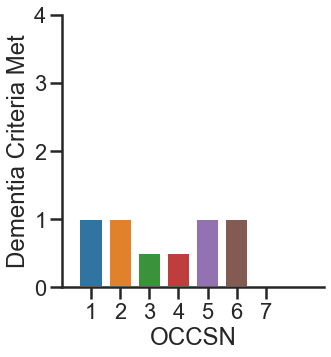

338512


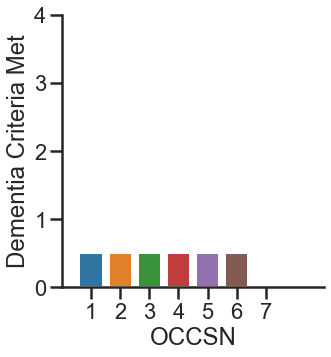

441105


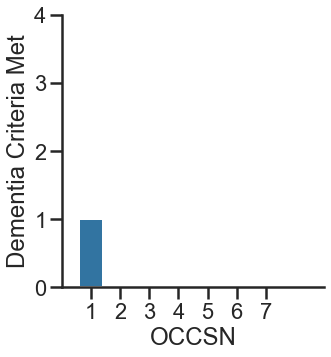

441701


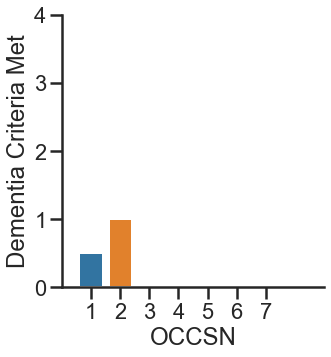

442205


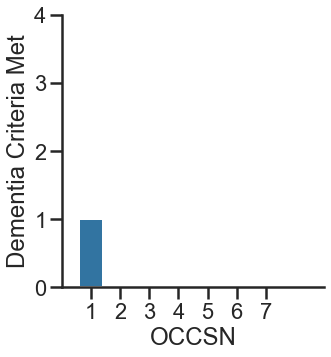

442305


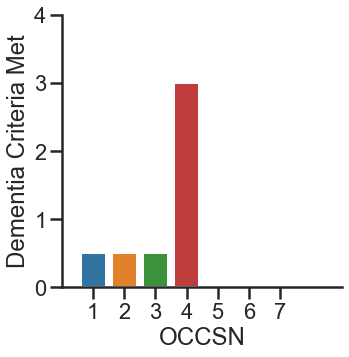

443406


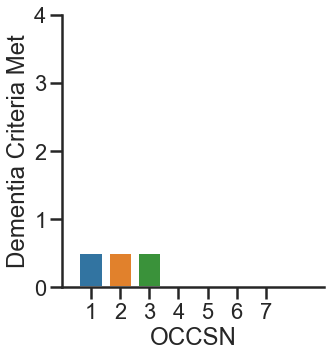

443452


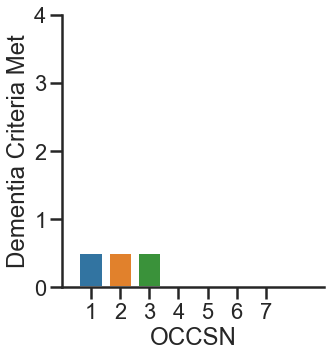

443453


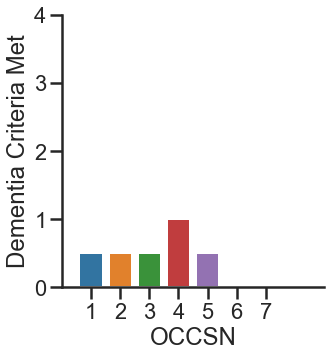

443454


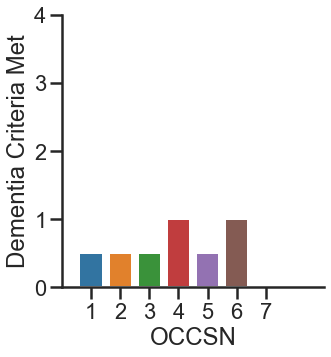

443601


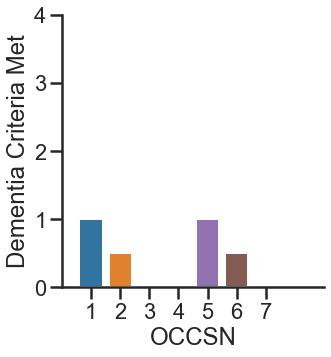

550904


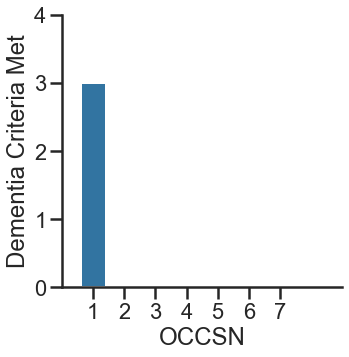

551252


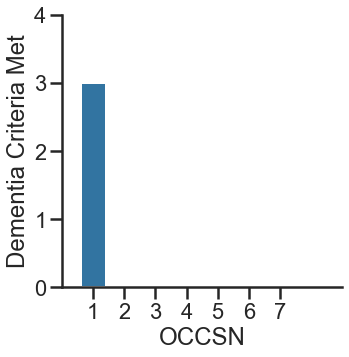

551403


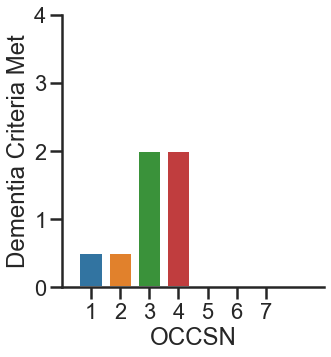

551552


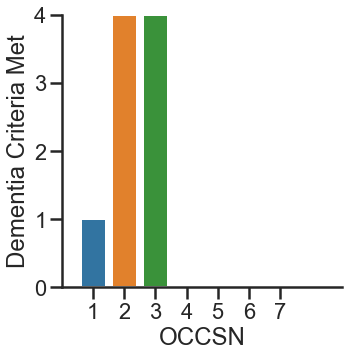

551851


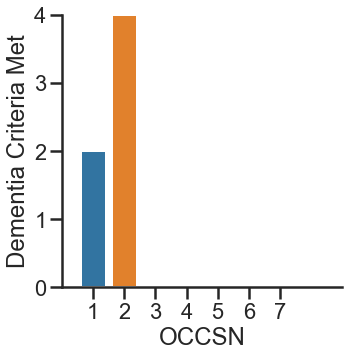

551954


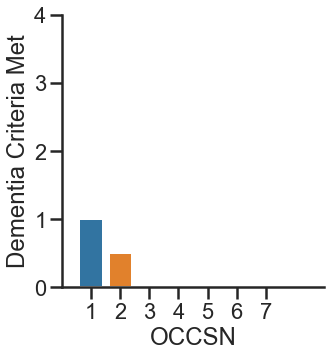

552751


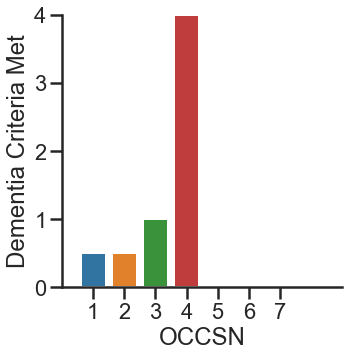

552752


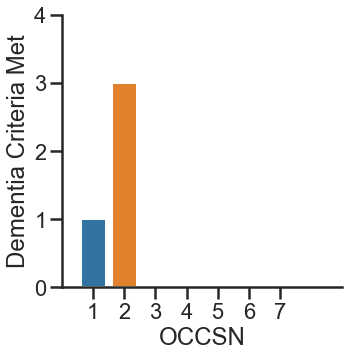

552901


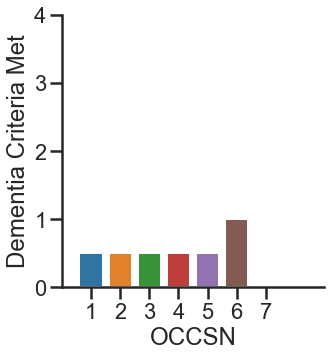

553401


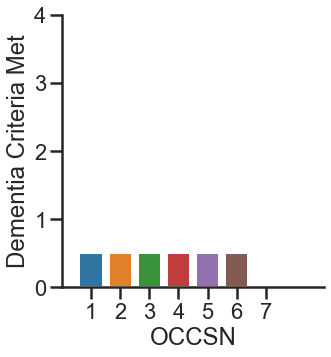

553453


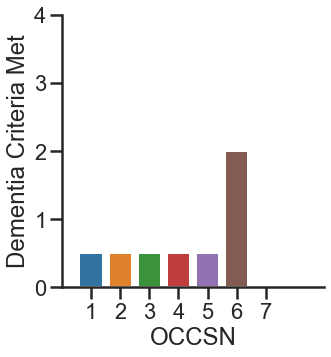

553505


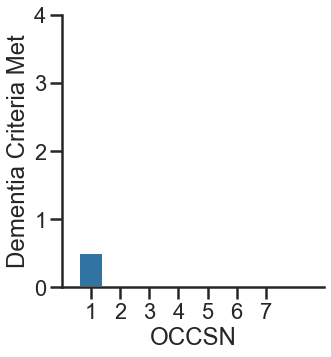

553552


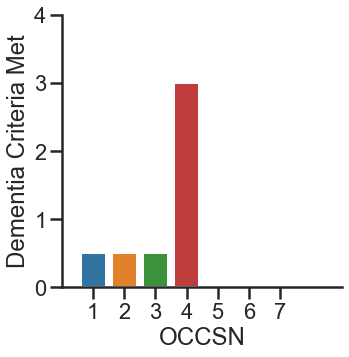

553851


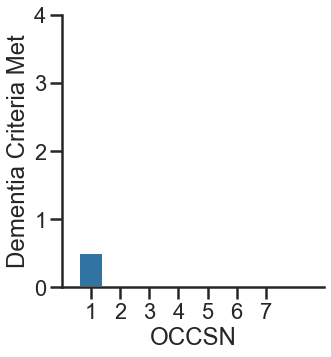

661311


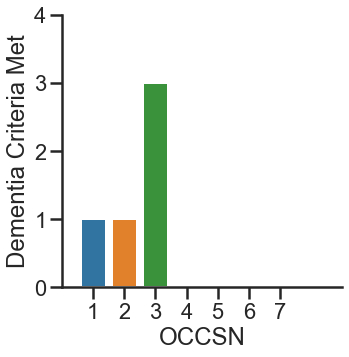

661359


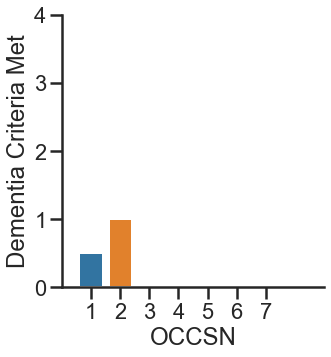

661401


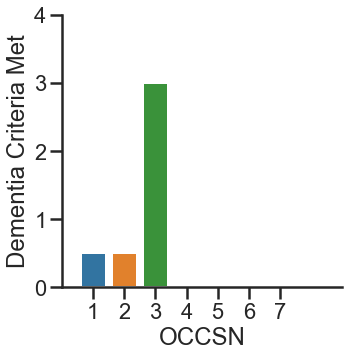

662003


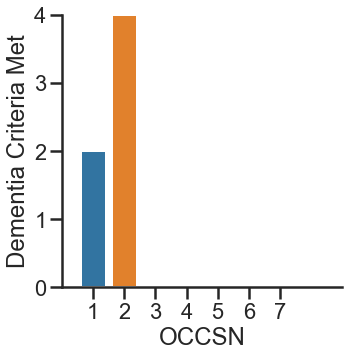

662053


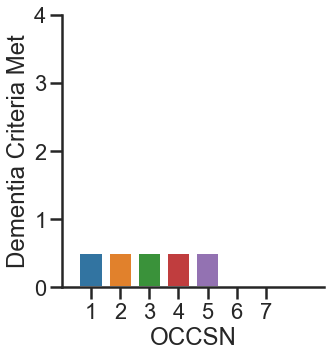

662104


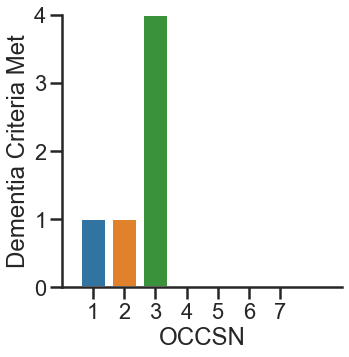

662151


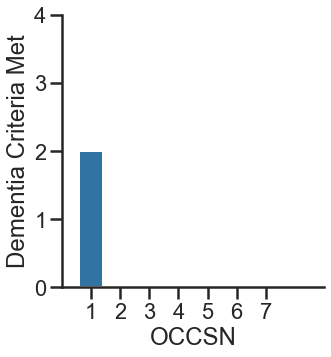

662252


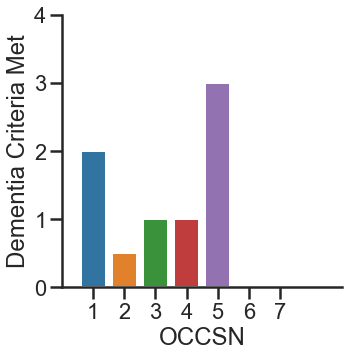

662262


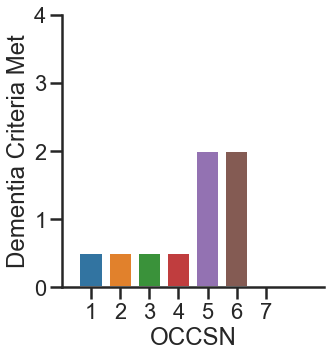

662352


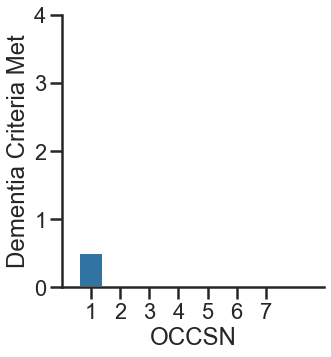

662459


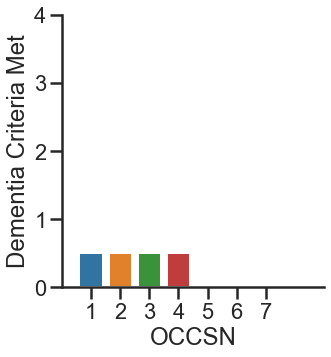

662553


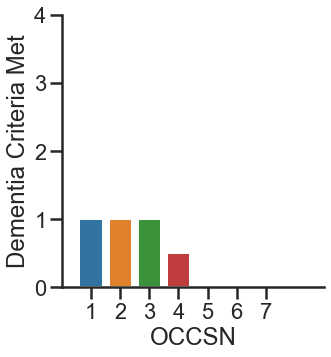

662656


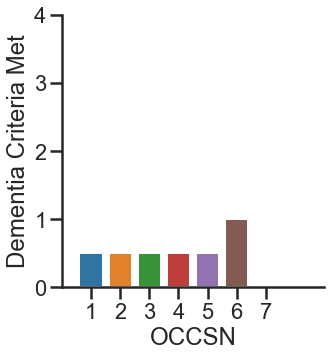

662753


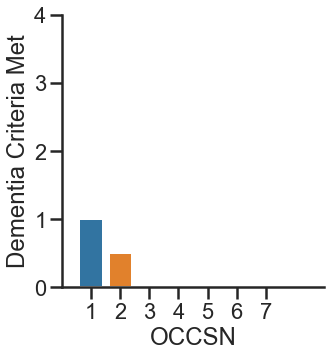

663256


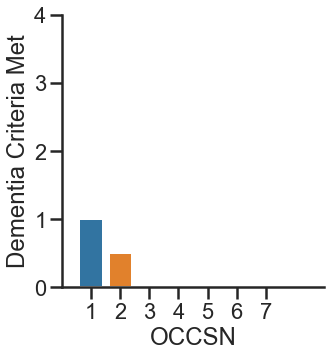

663260


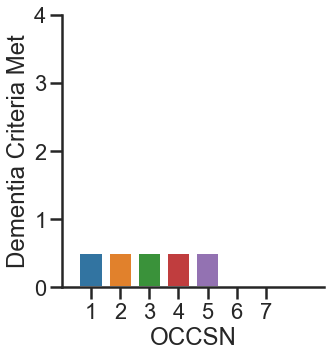

663262


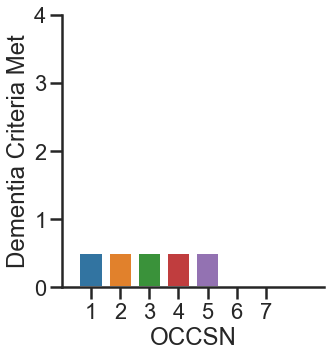

663502


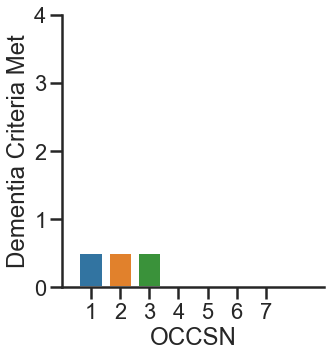

663507


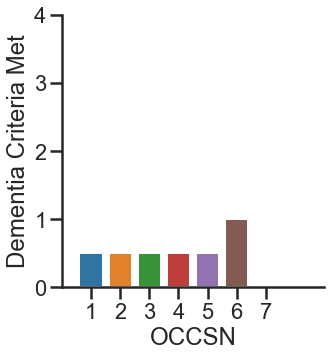

663656


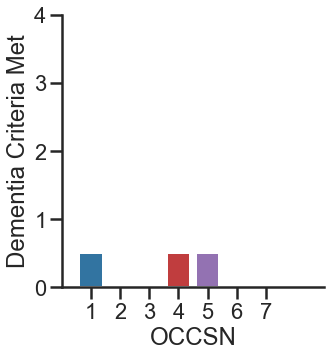

663706


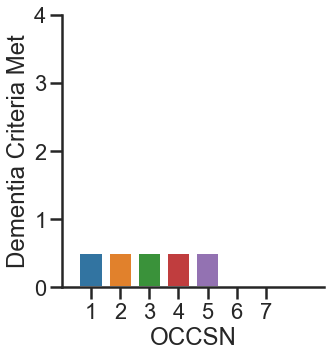

663707


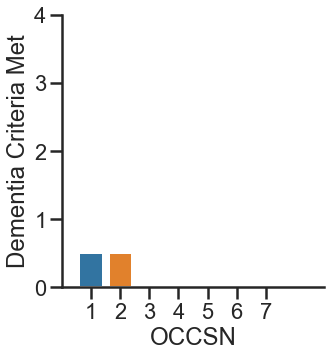

101910


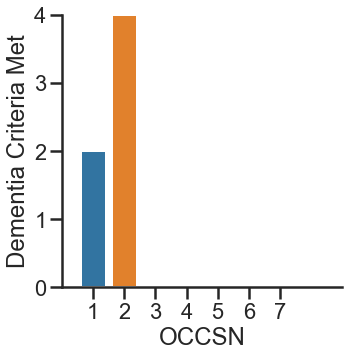

126007


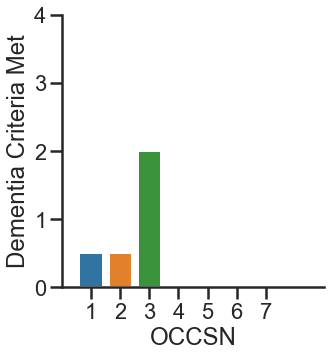

127504


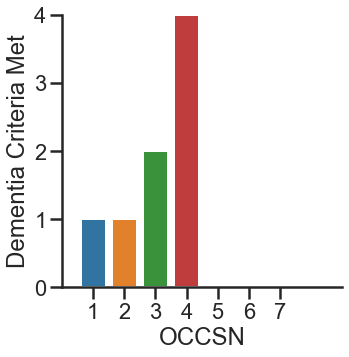

131902


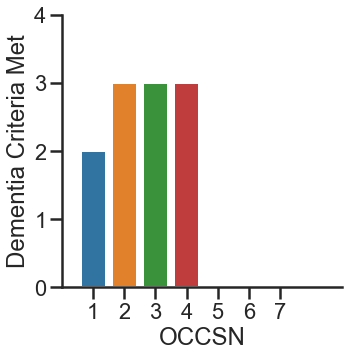

134508


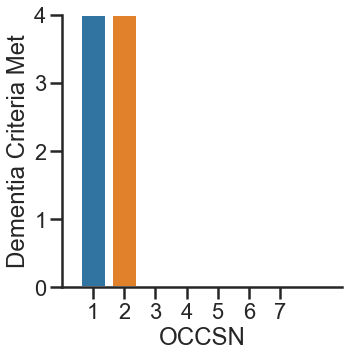

134513


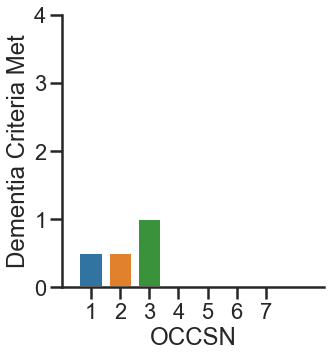

135503


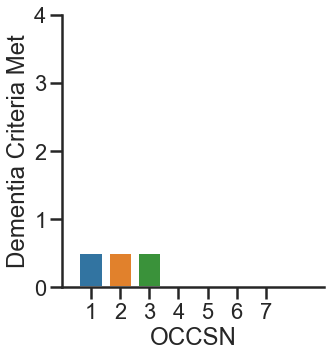

137005


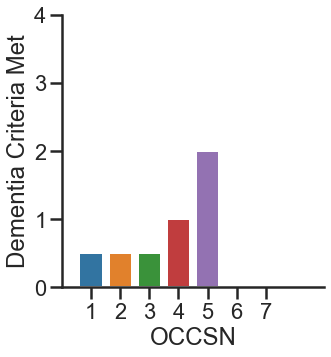

137512


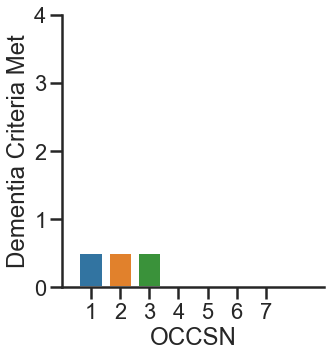

151910


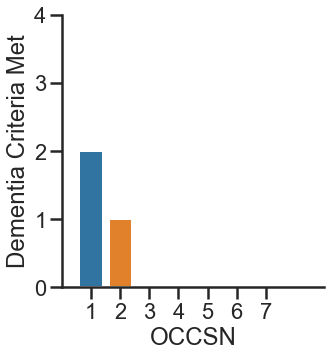

201710


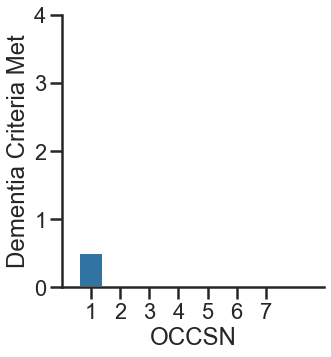

225505


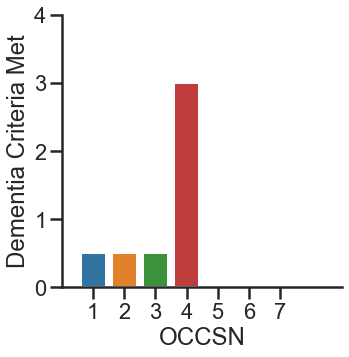

226035


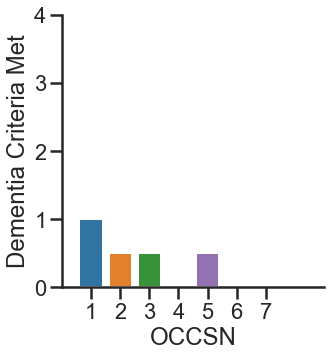

226565


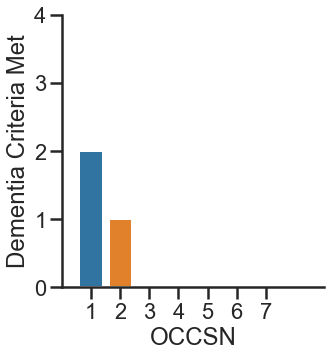

227001


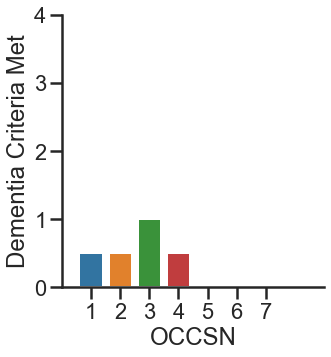

230601


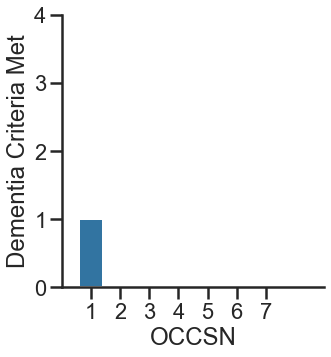

230801


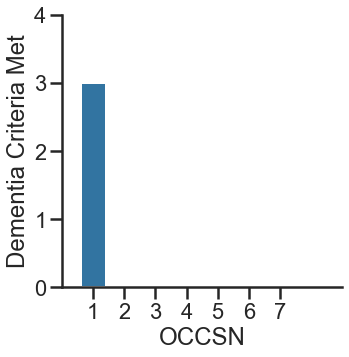

231902


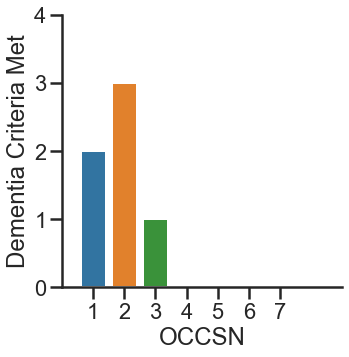

234520


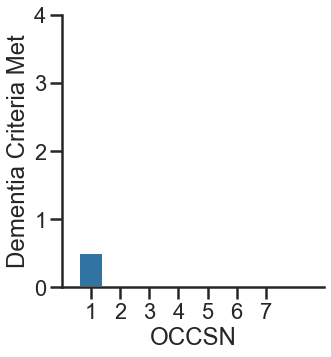

234521


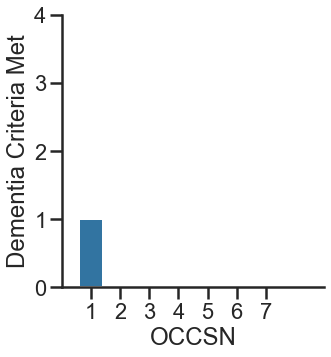

234562


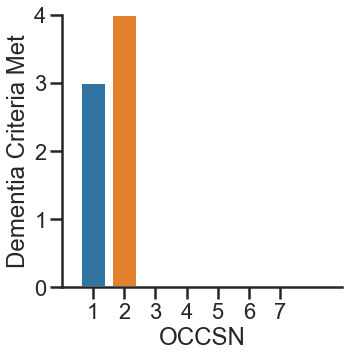

235004


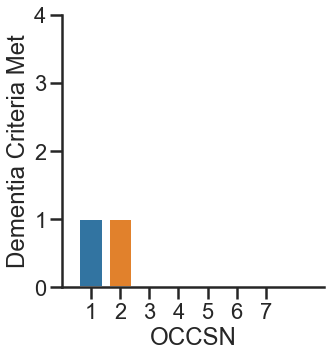

235071


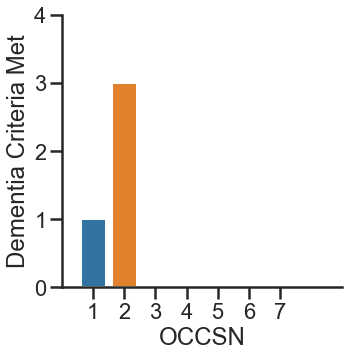

235072


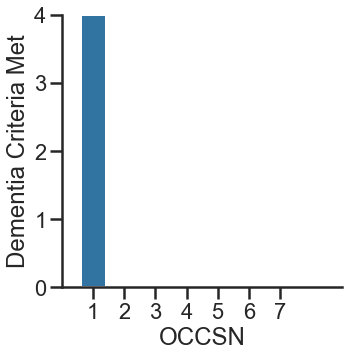

235502


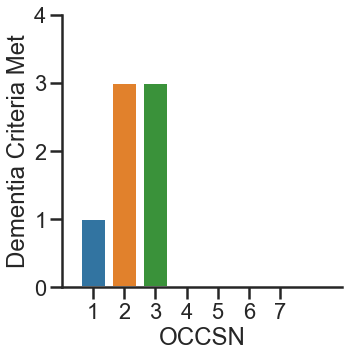

235549


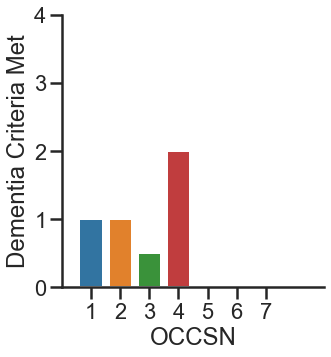

236002


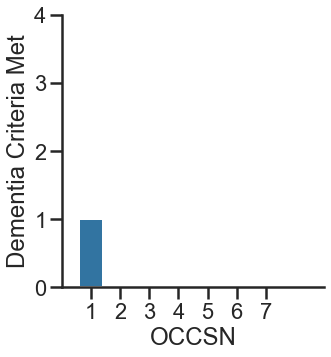

236032


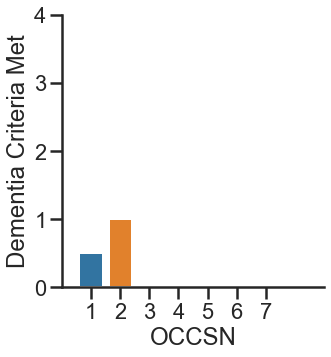

236510


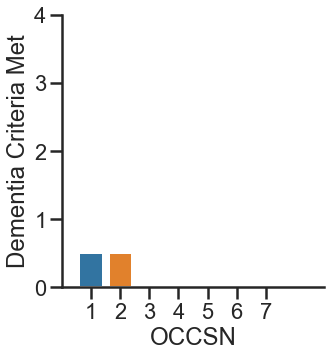

236542


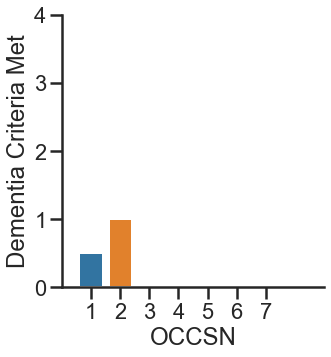

236566


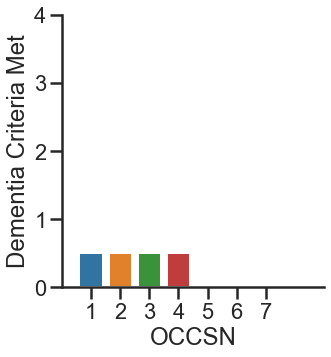

236570


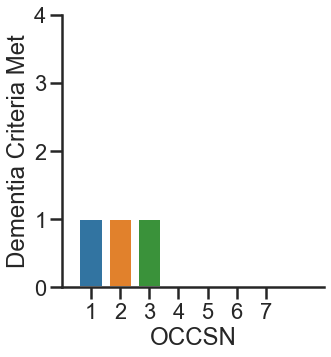

236575


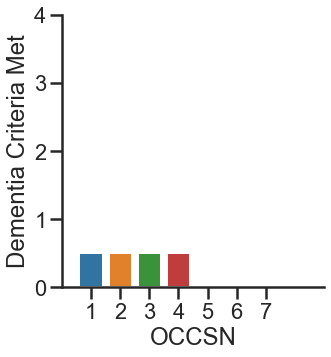

237012


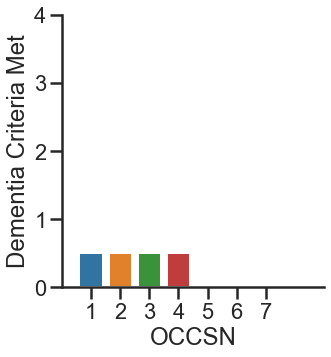

237025


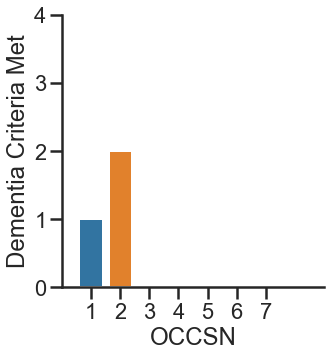

237045


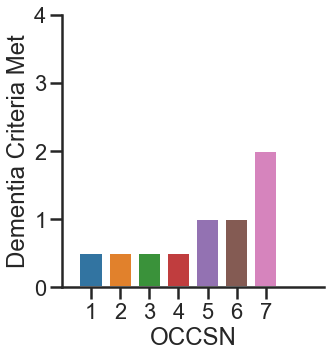

237047


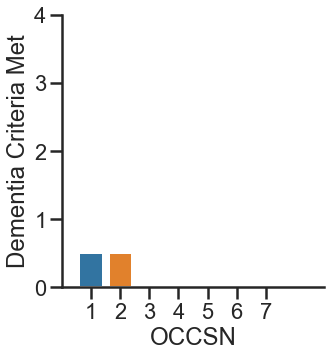

237514


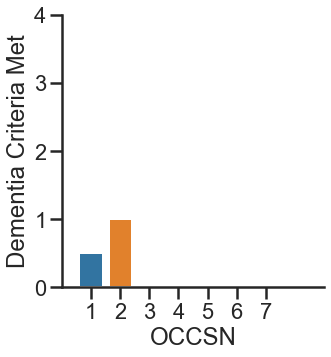

237518


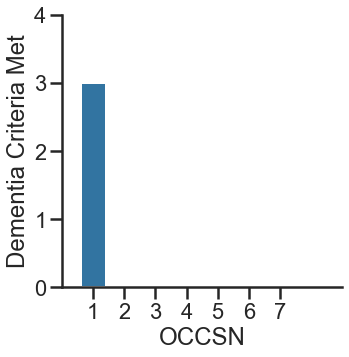

237529


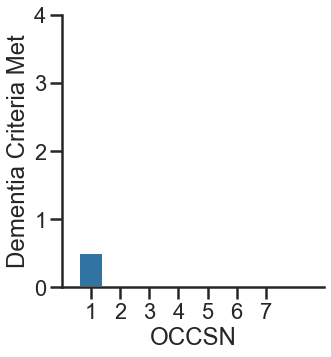

237532


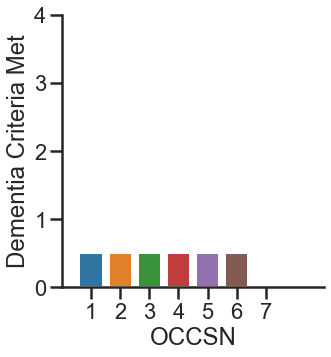

237563


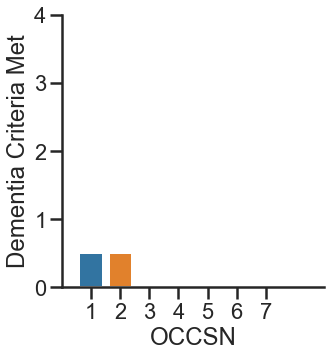

238507


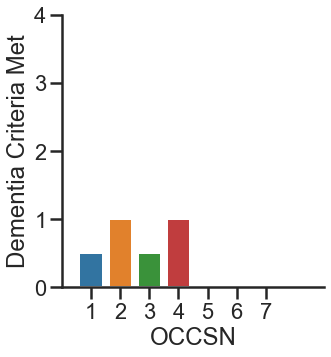

251620


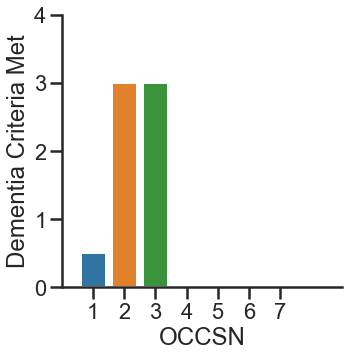

333542


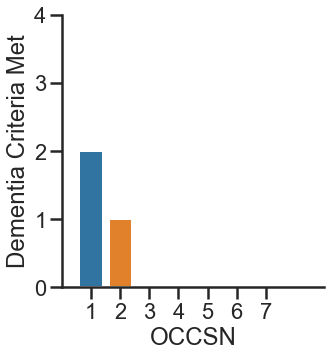

334011


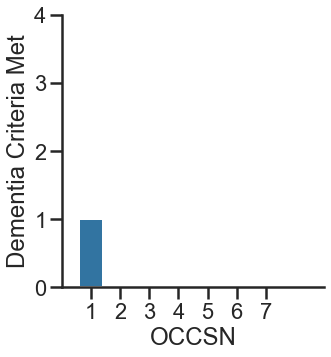

334533


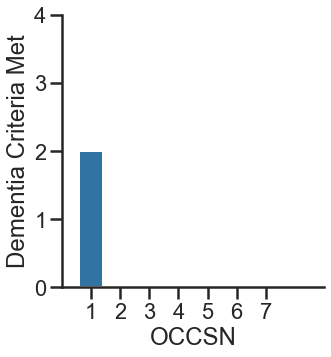

334537


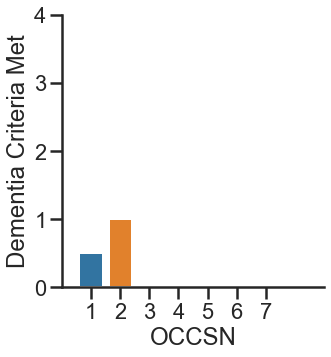

335001


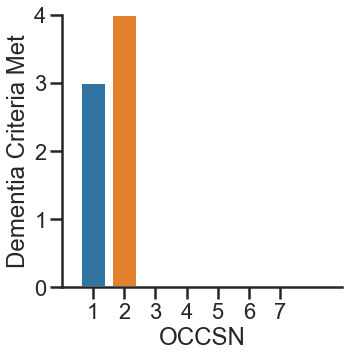

335004


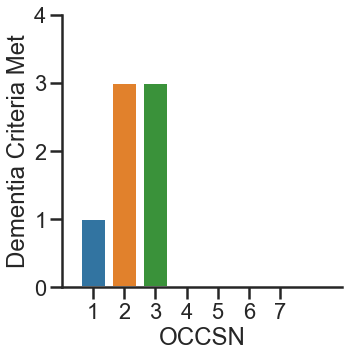

335017


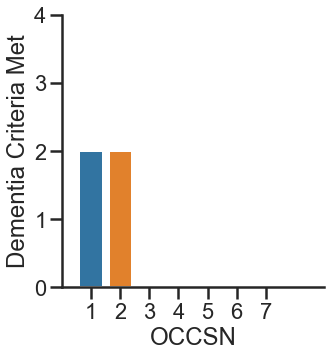

335503


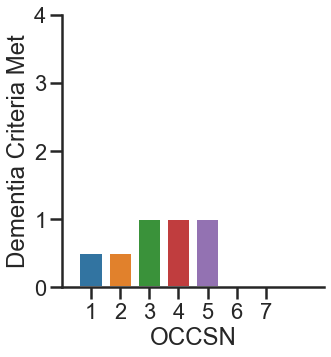

335530


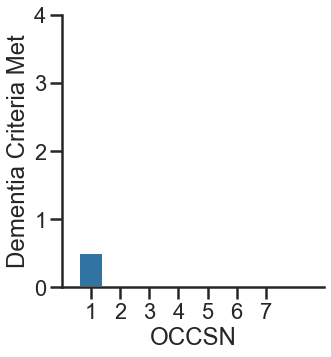

336002


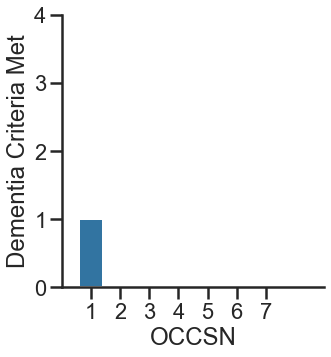

336011


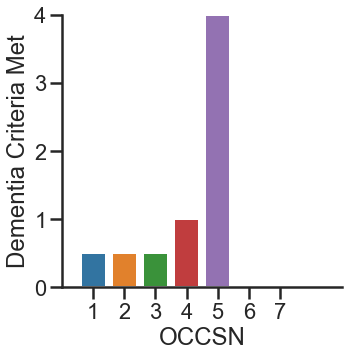

336019


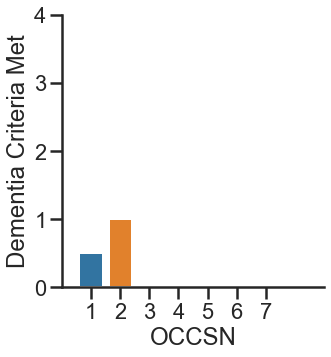

336034


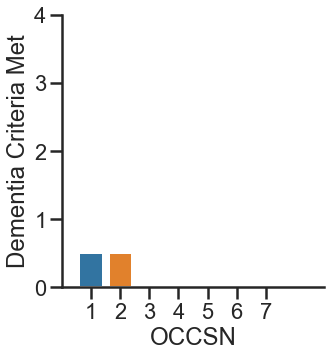

337529


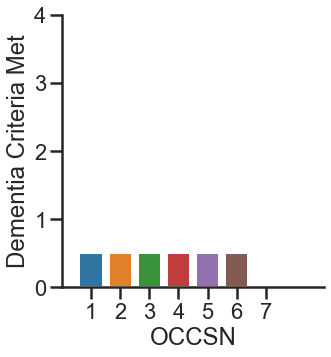

338535


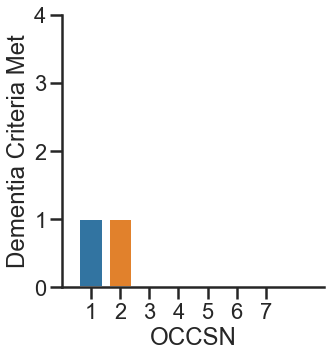

441256


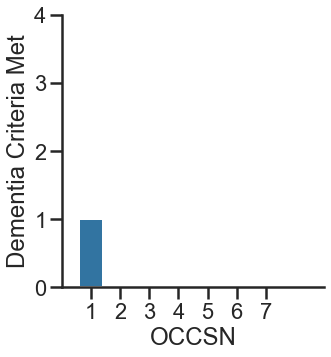

441802


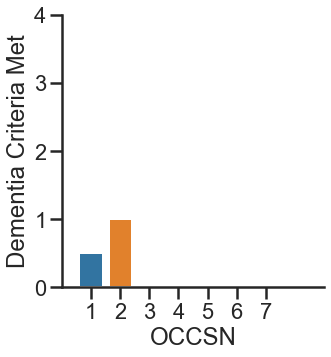

441902


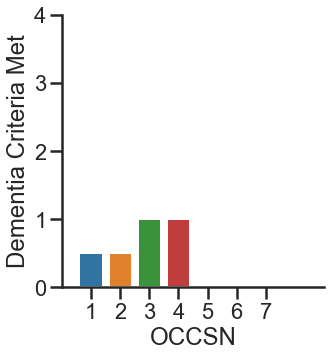

442055


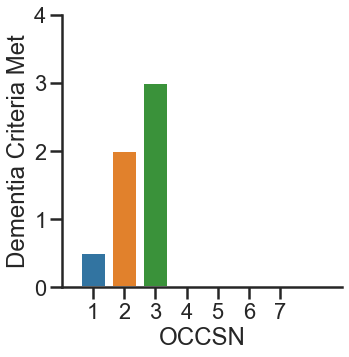

442203


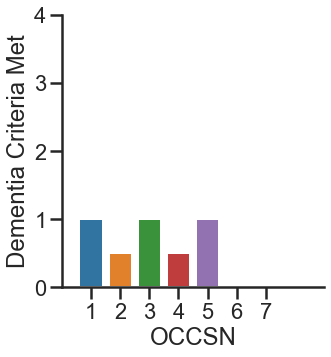

442252


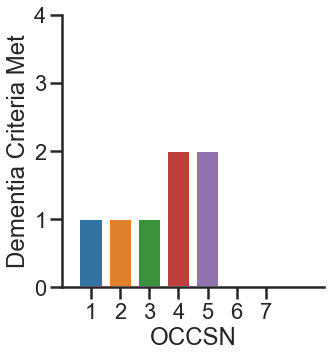

442453


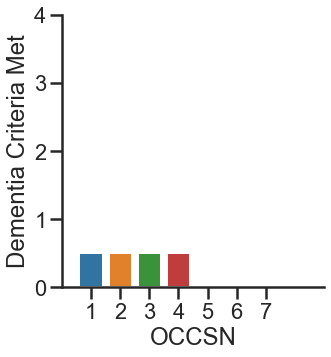

442651


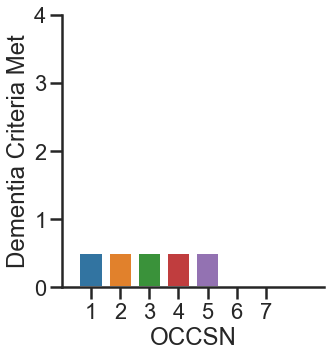

442756


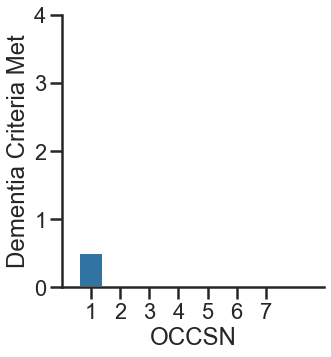

442805


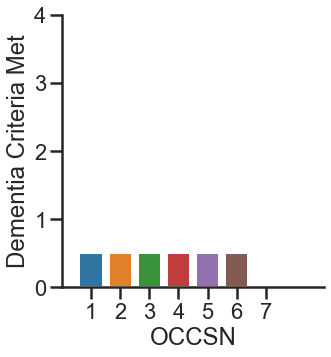

442853


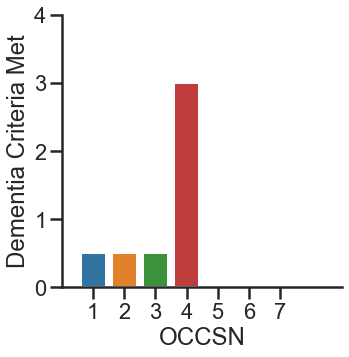

443055


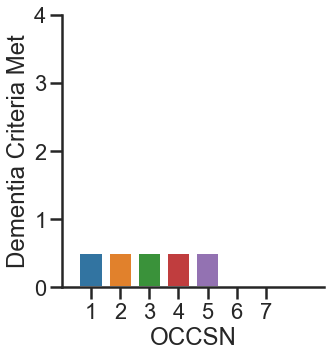

443251


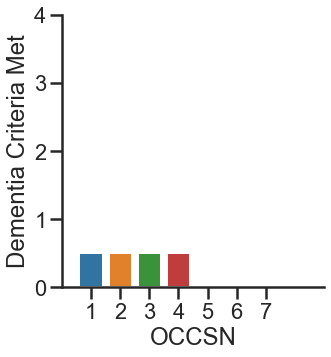

551204


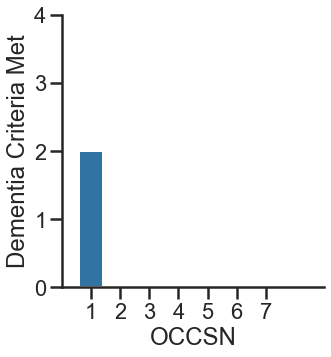

551354


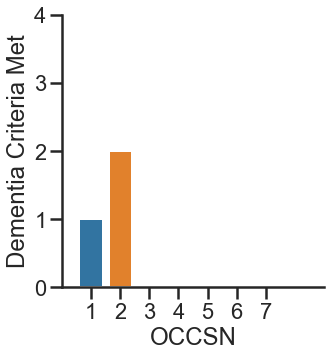

551854


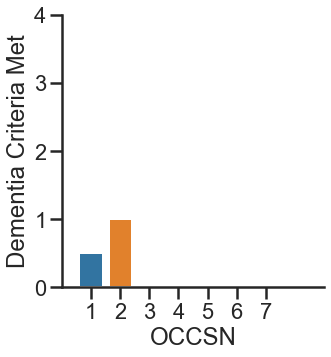

551902


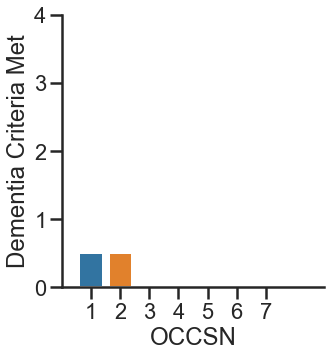

551905


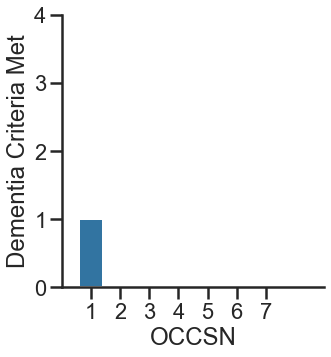

551959


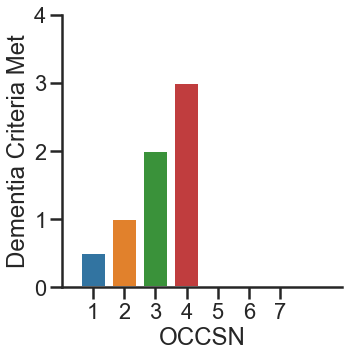

552056


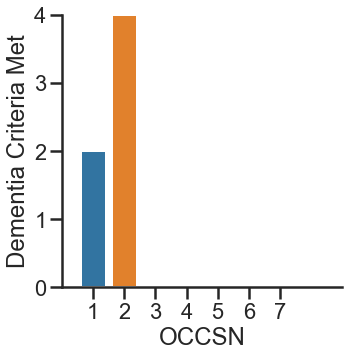

552151


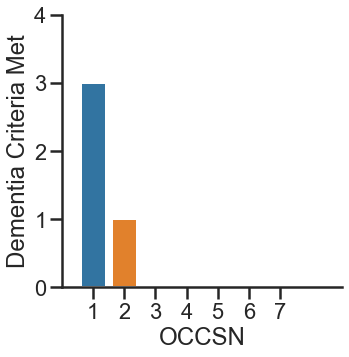

552203


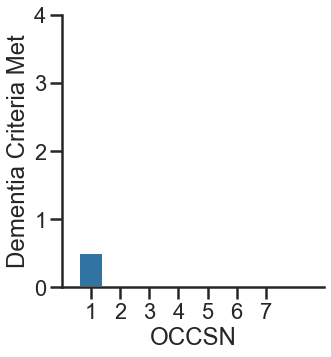

552301


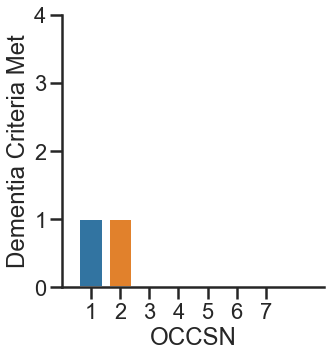

552351


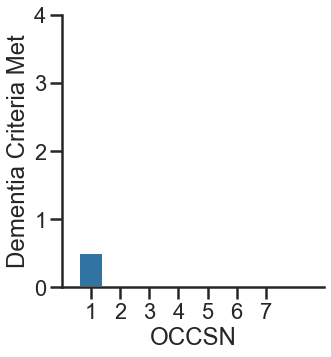

552551


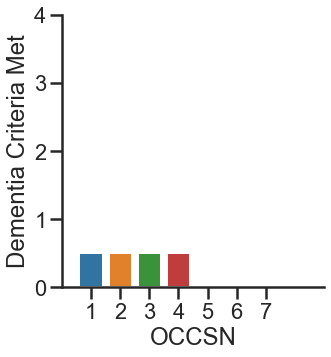

552801


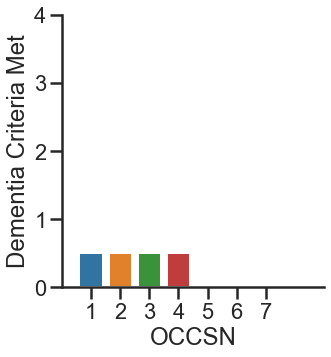

552802


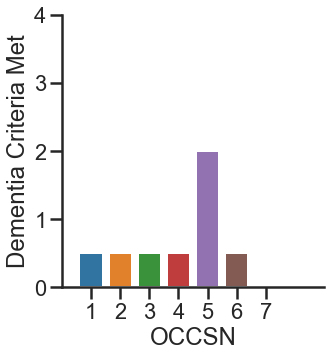

552853


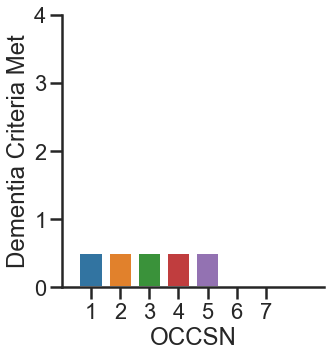

552952


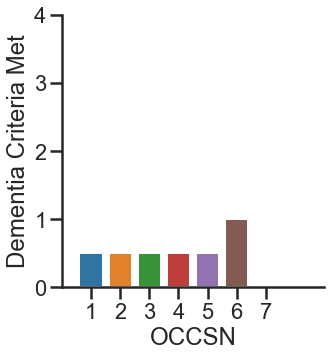

553004


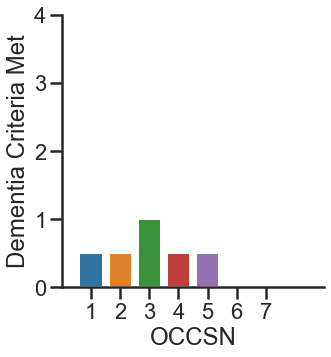

553053


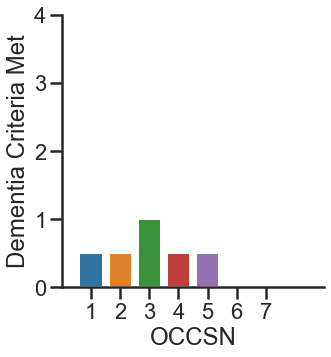

553105


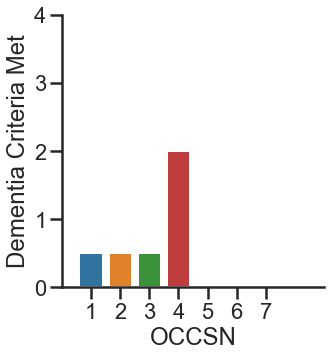

553151


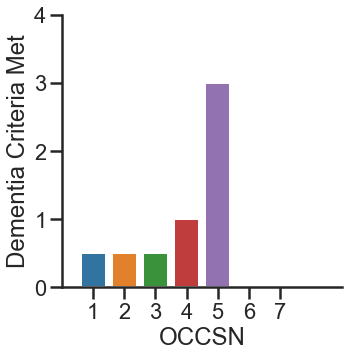

553257


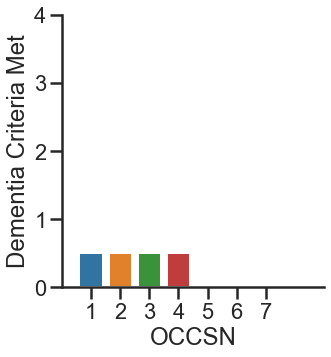

553402


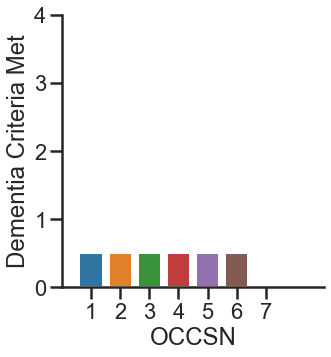

553503


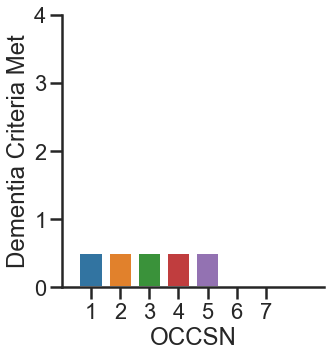

660706


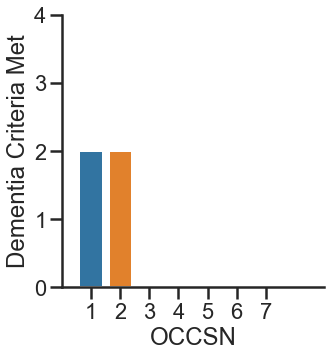

661053


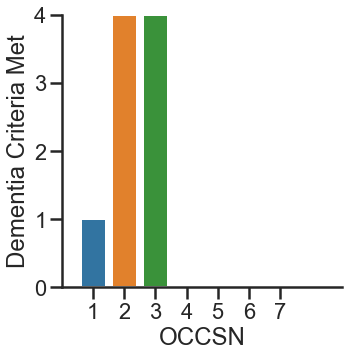

661358


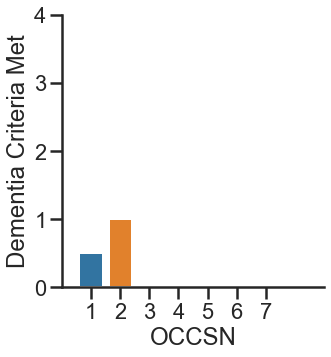

661462


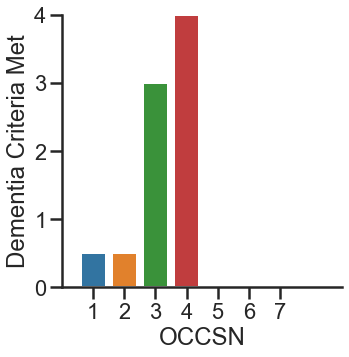

661651


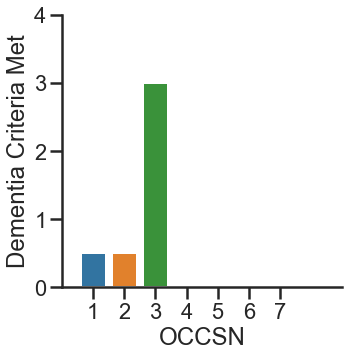

661757


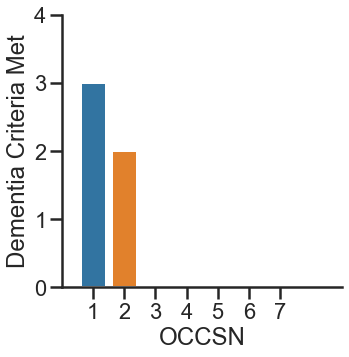

661804


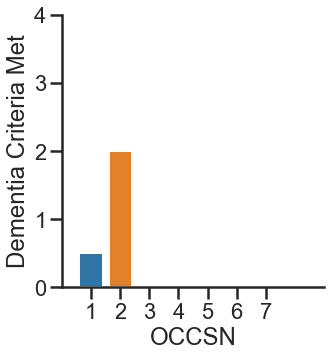

662051


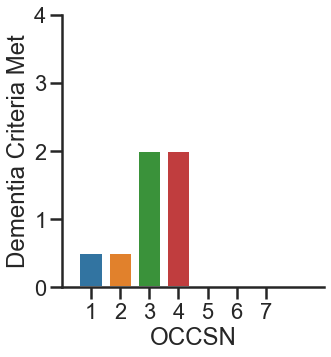

662308


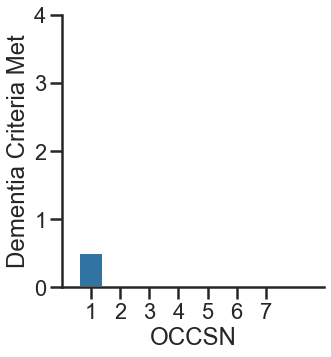

662309


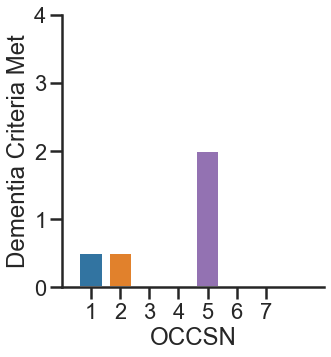

662404


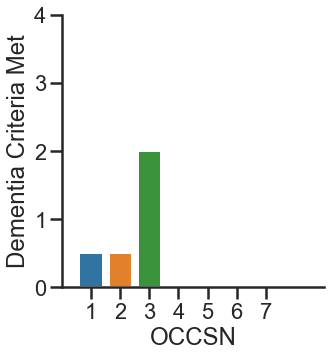

662456


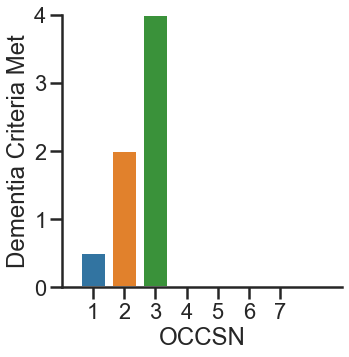

662460


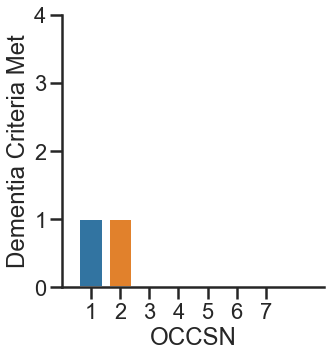

662506


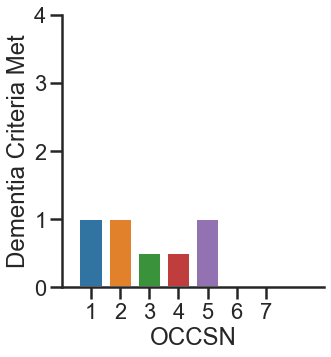

662551


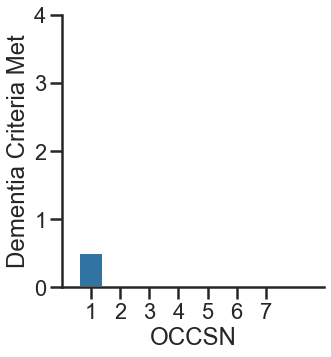

662560


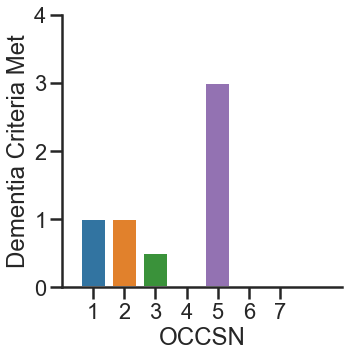

662563


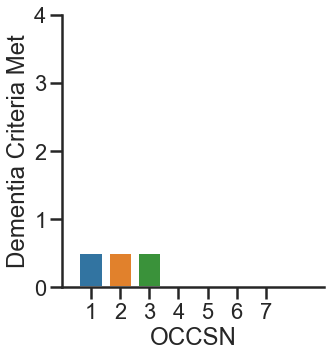

662605


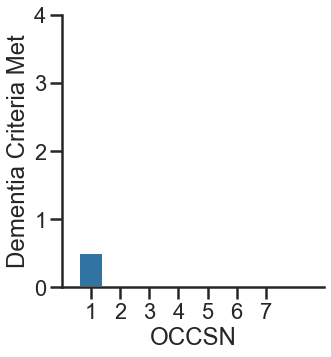

662654


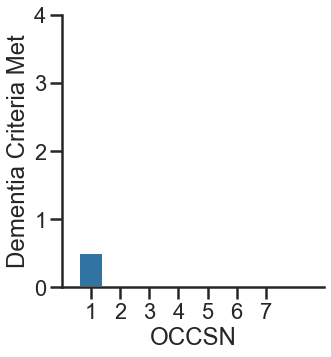

662708


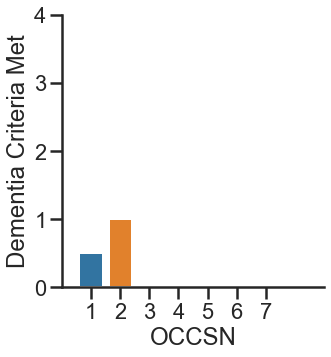

662709


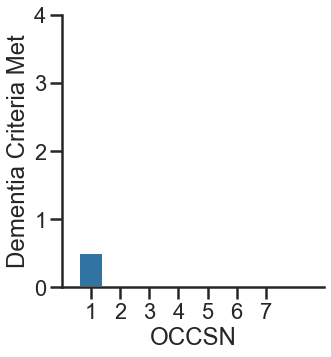

662802


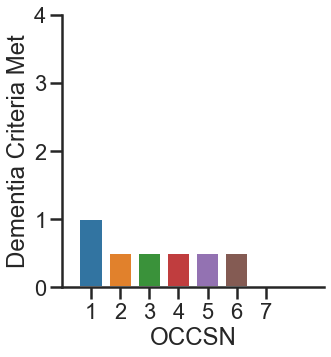

662856


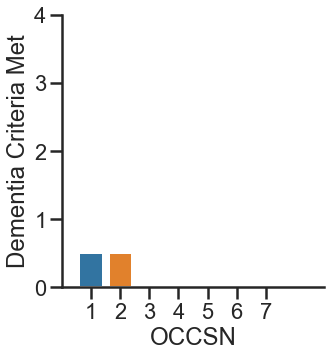

662909


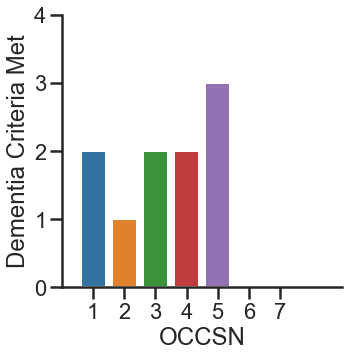

663002


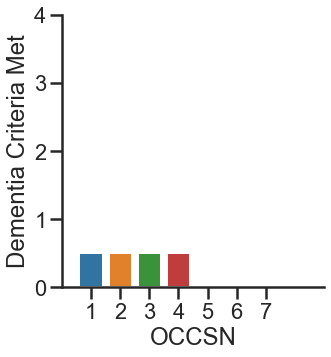

663154


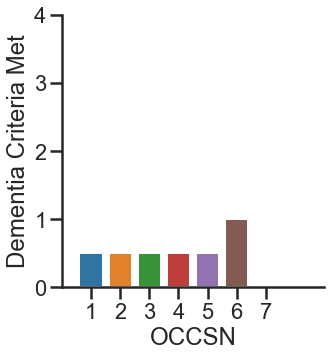

663205


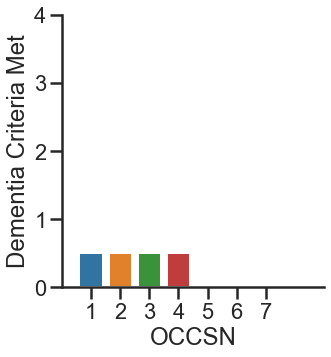

663355


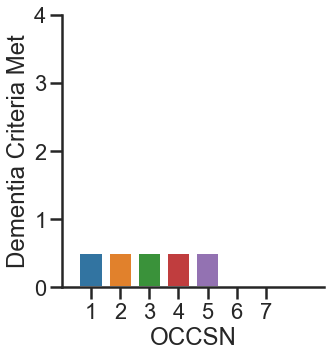

663459


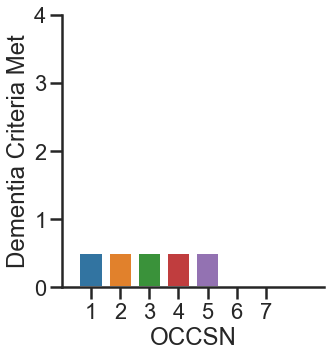

663652


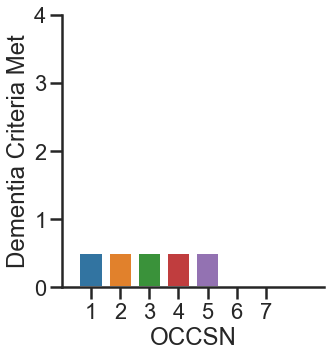

663708


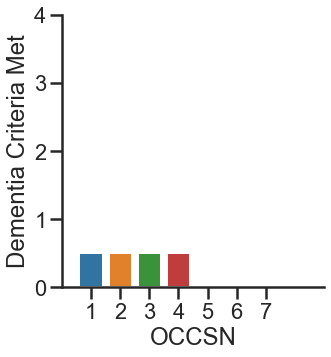

663712


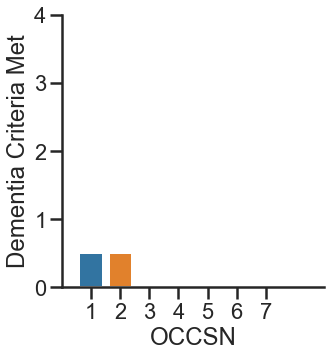

135504


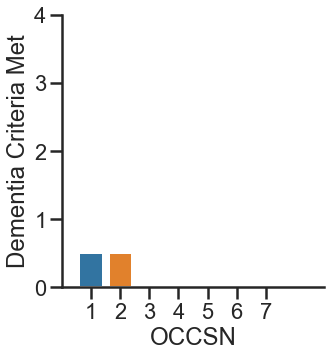

226521


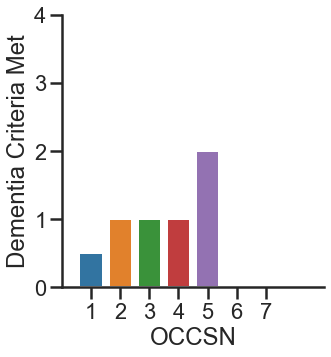

228035


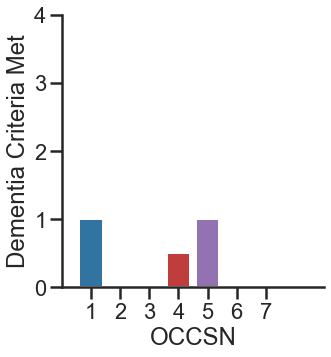

231102


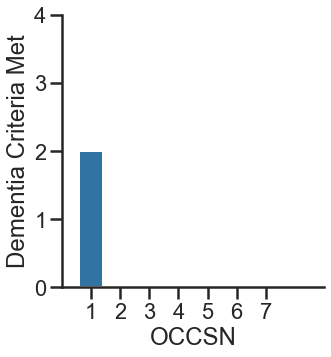

232092


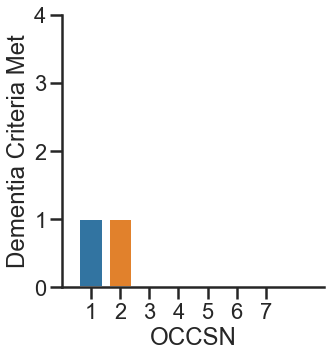

236062


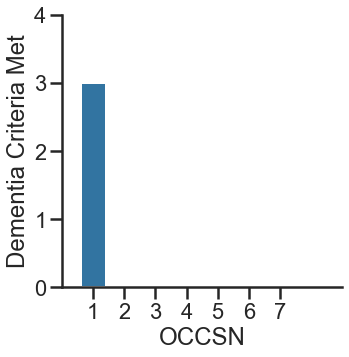

236558


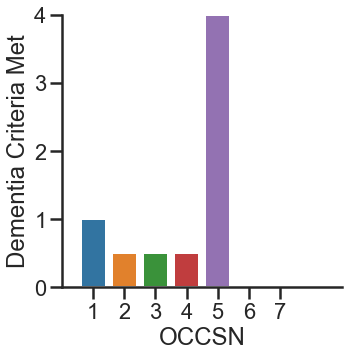

238024


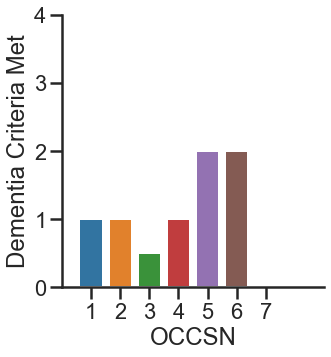

338001


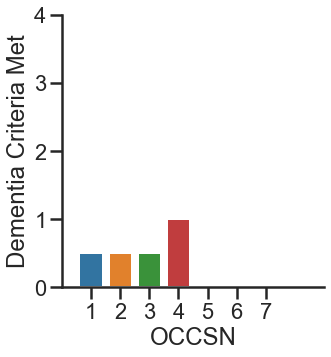

338004


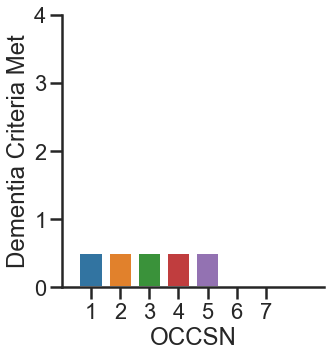

338006


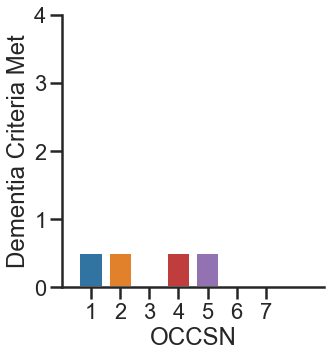

338022


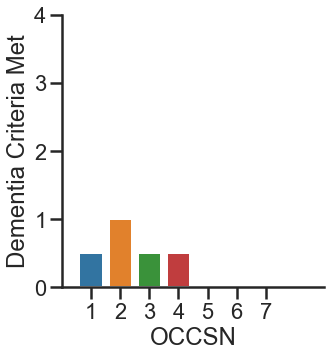

338025


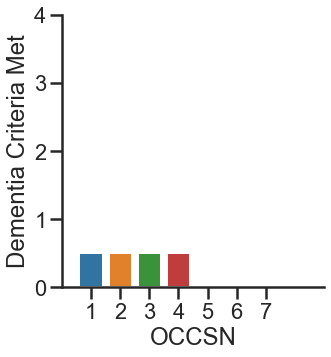

338506


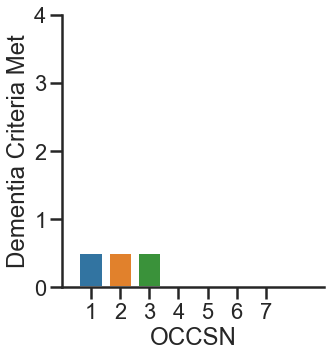

338510


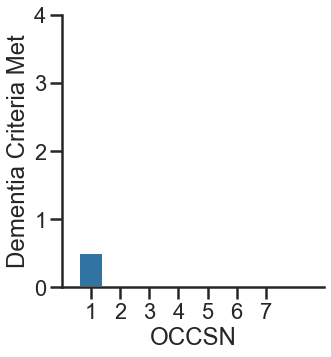

338511


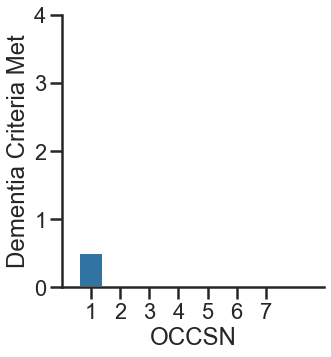

338515


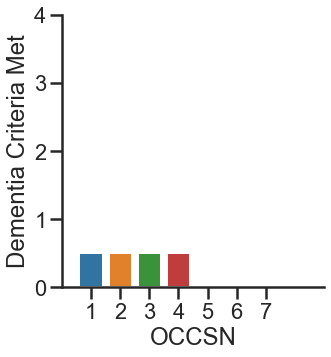

338524


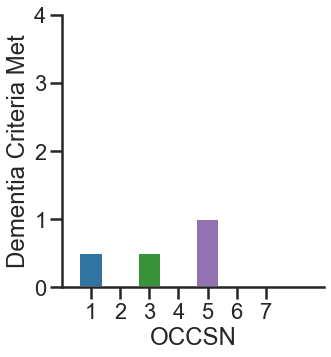

338527


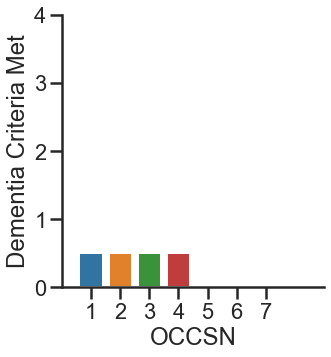

338533


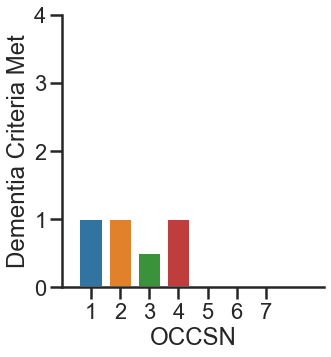

338534


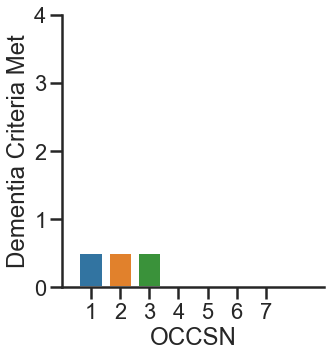

339009


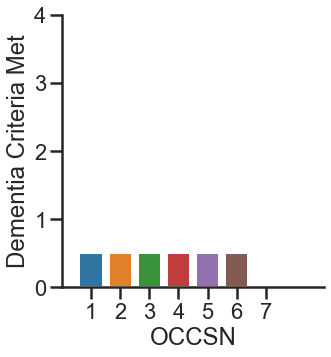

339503


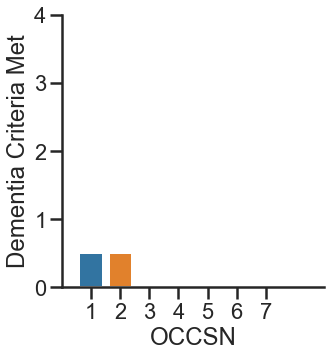

339512


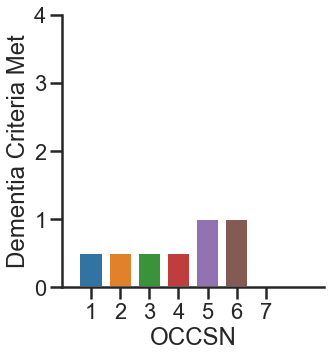

443605


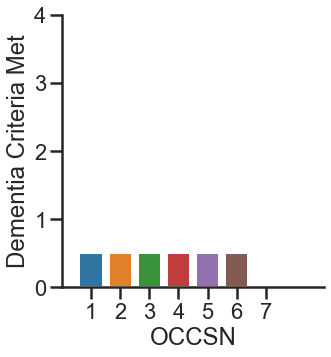

443852


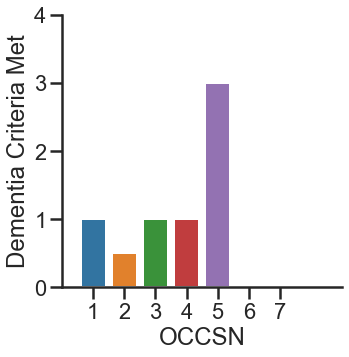

443905


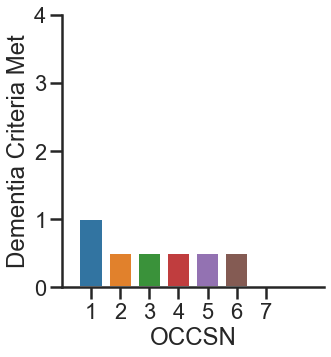

444005


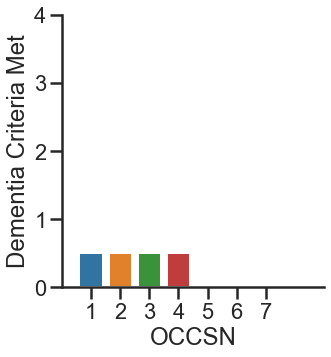

444104


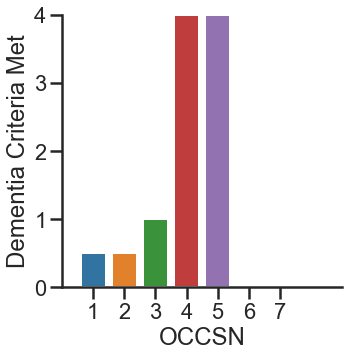

444254


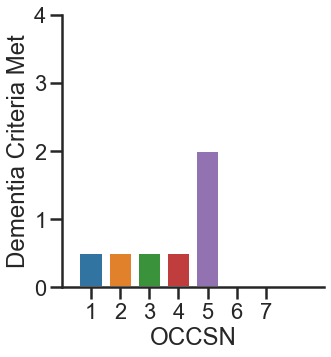

552303


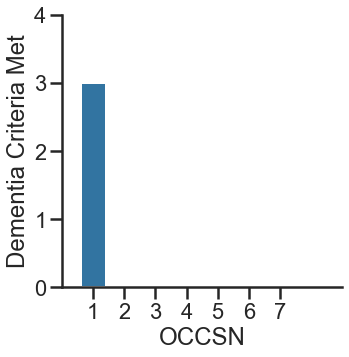

552652


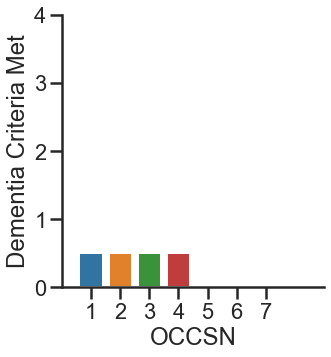

553256


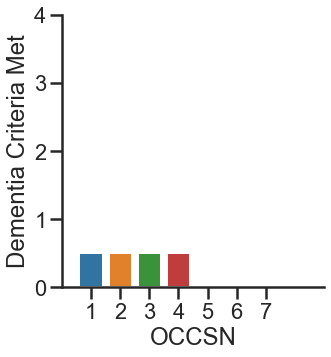

553506


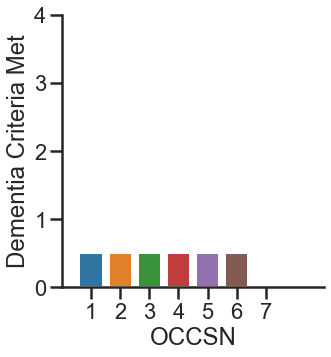

553604


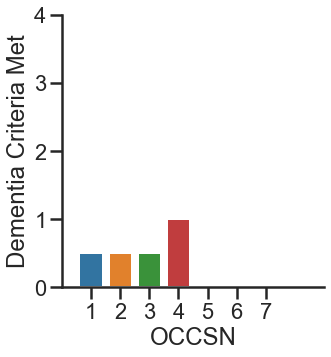

553653


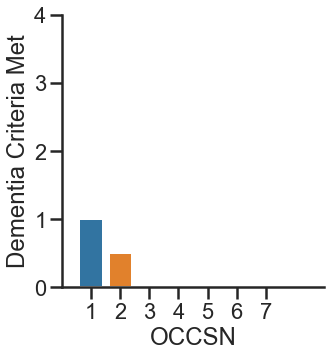

553901


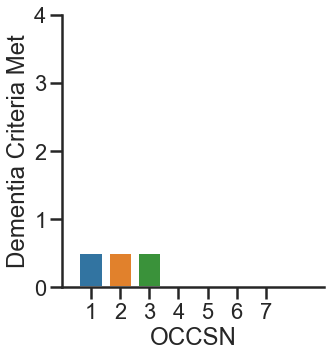

553951


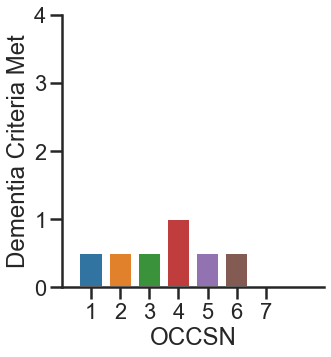

553952


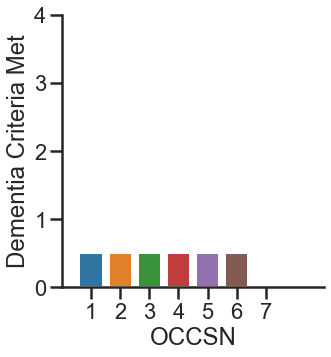

553953


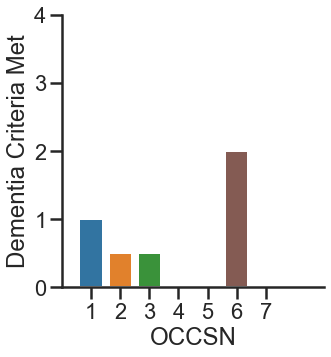

554054


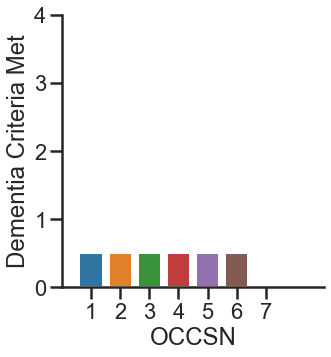

554055


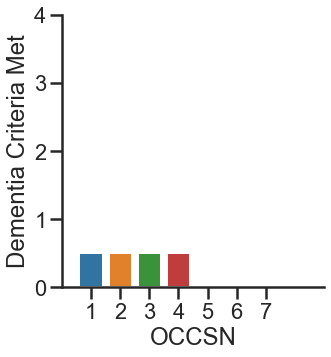

554101


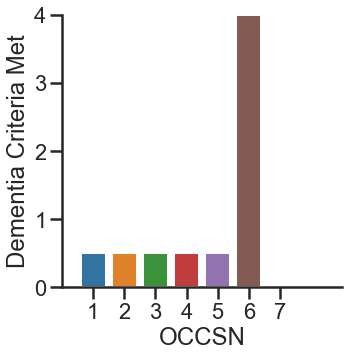

554102


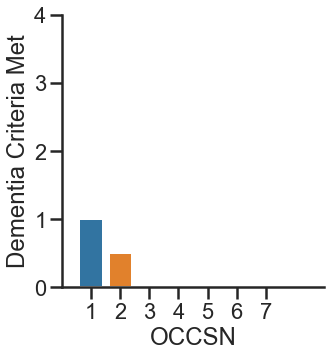

554104


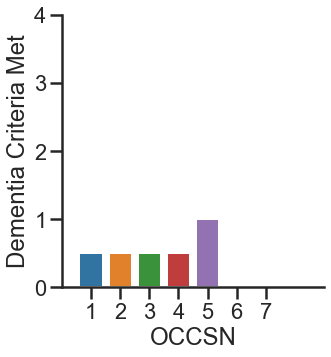

554153


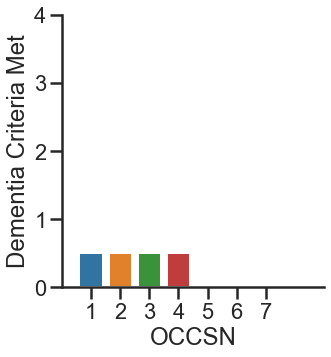

554154


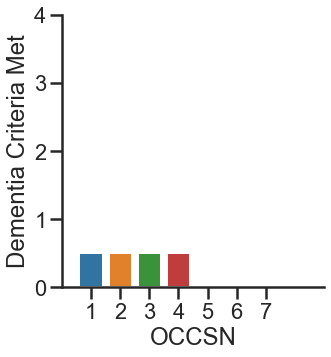

554202


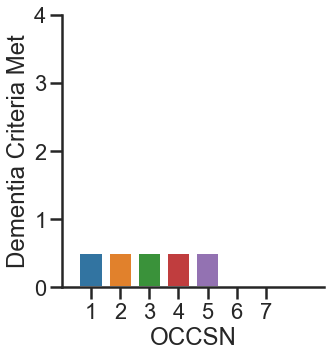

554205


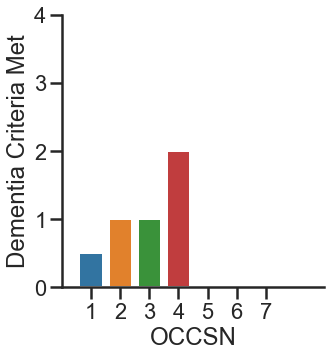

554251


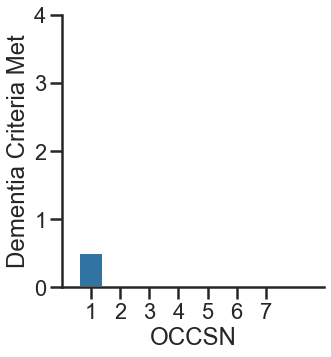

554253


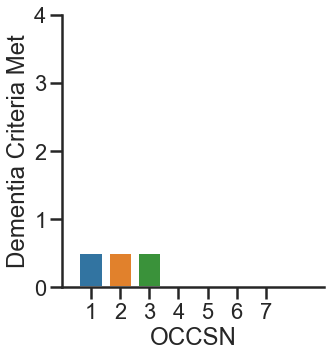

554256


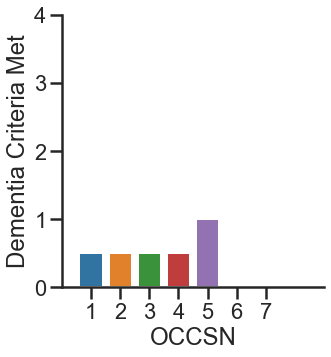

554406


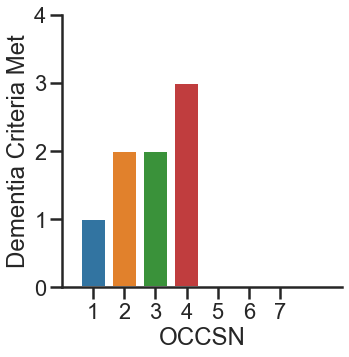

660956


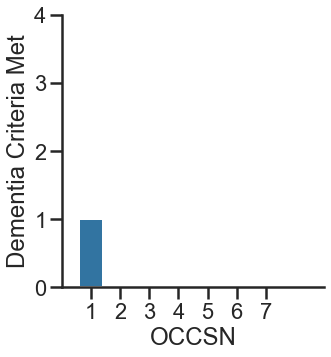

661361


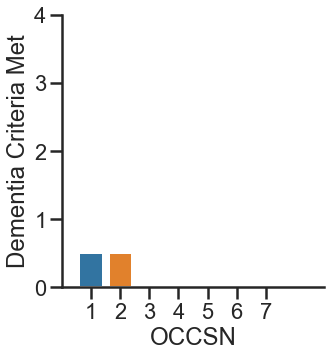

661761


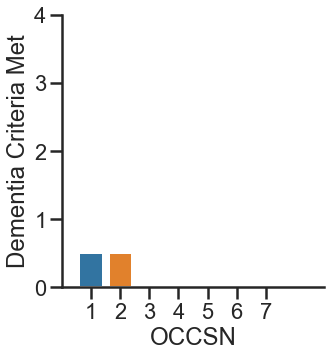

661854


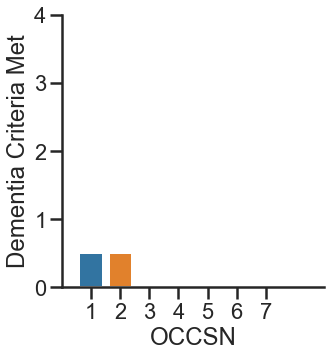

662004


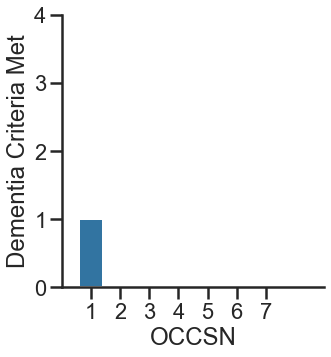

662009


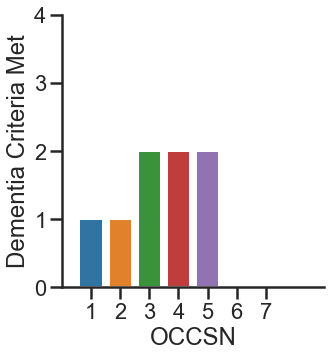

662353


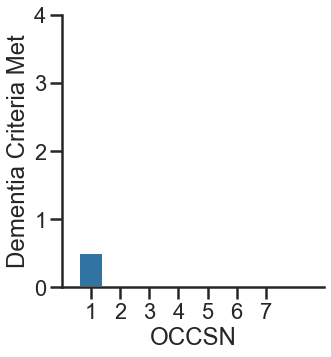

662403


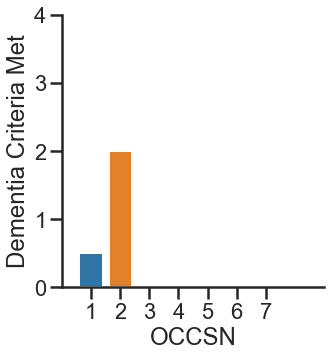

662453


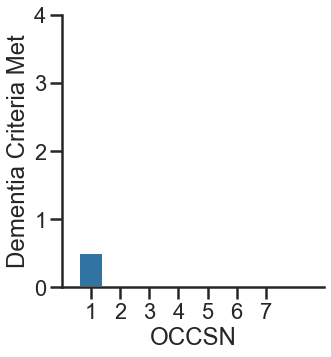

663005


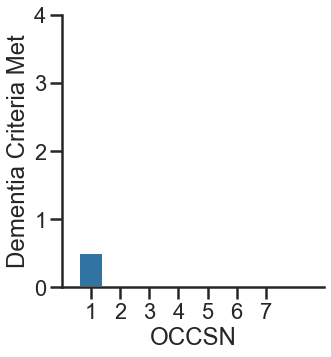

663201


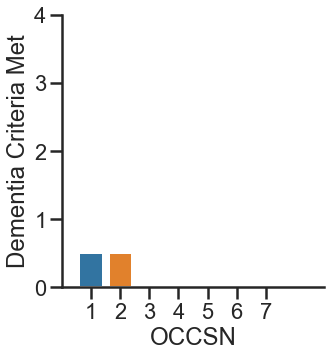

663301


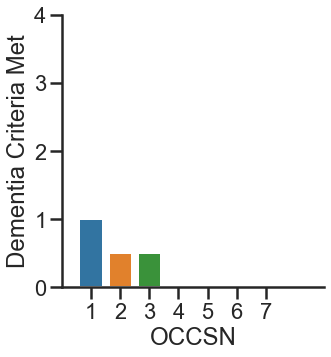

663512


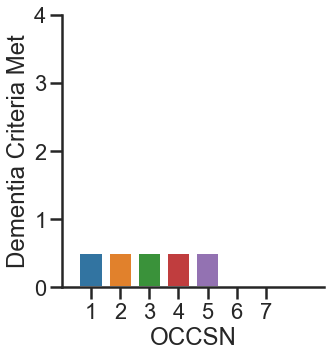

663556


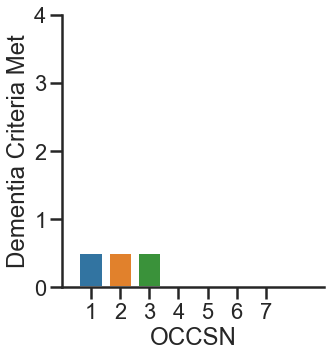

663602


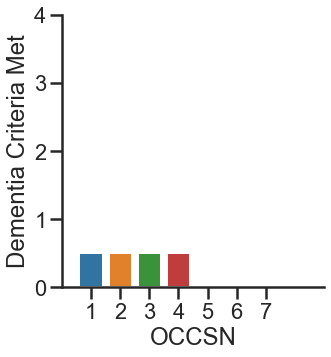

663657


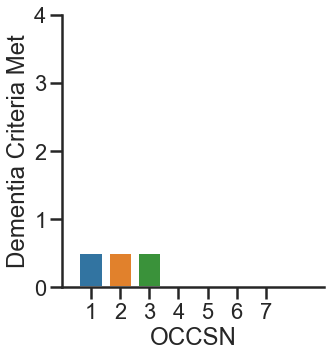

663704


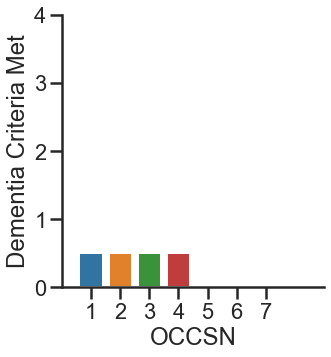

663854


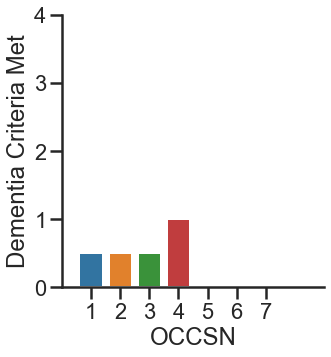

663901


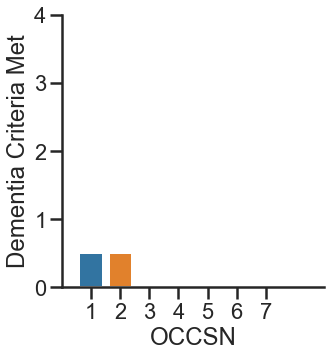

663905


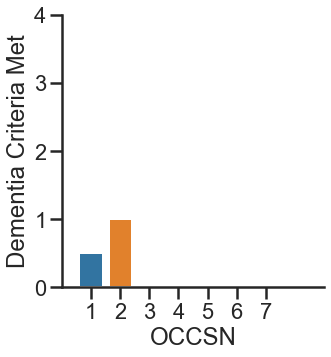

663907


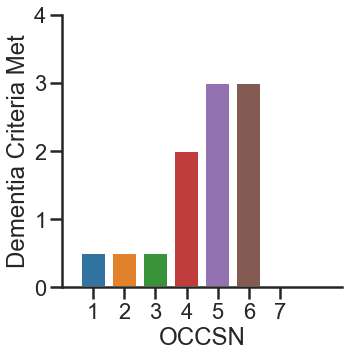

664001


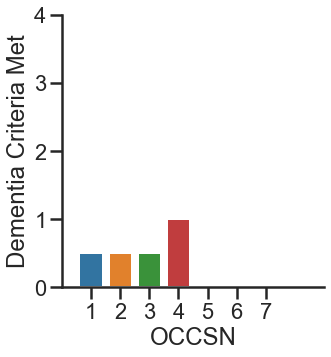

664056


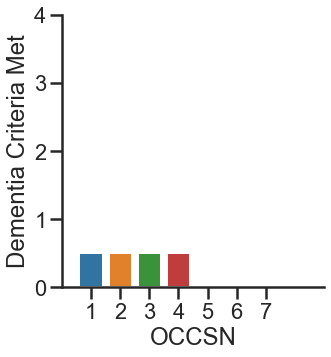

664058


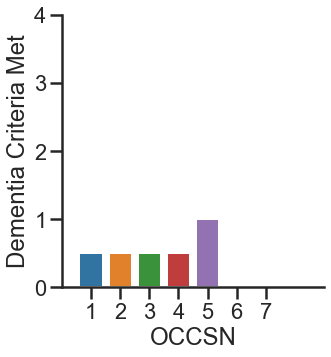

664061


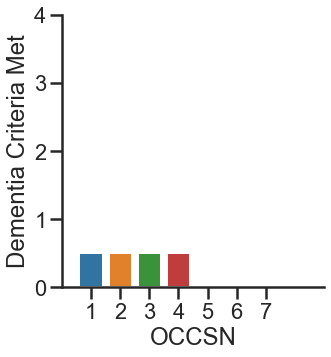

664104


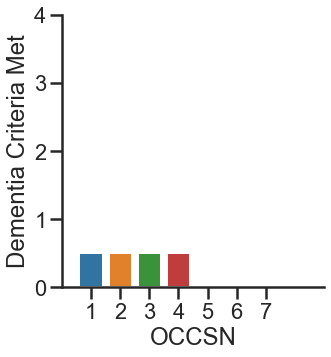

664105


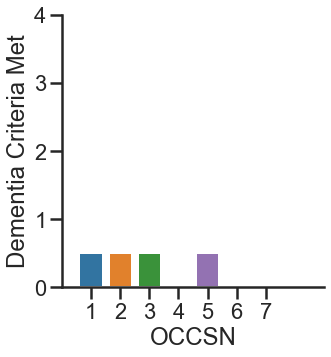

664152


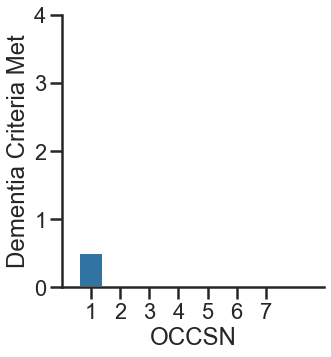

664155


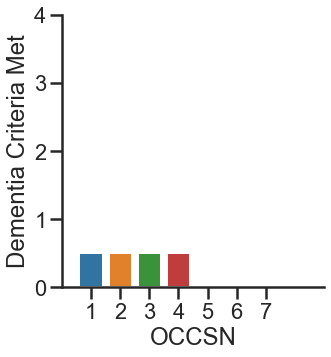

664254


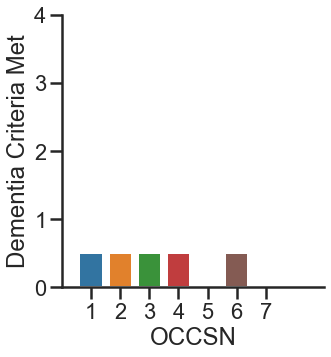

664257


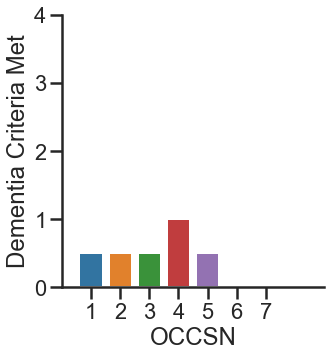

111101


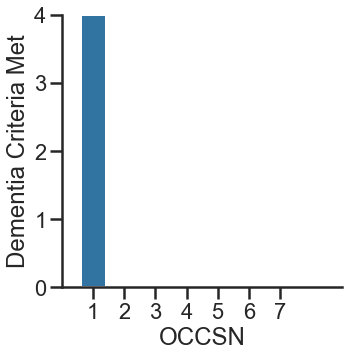

226050


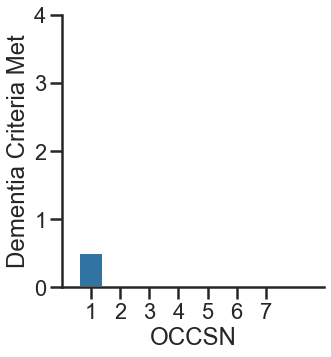

231901


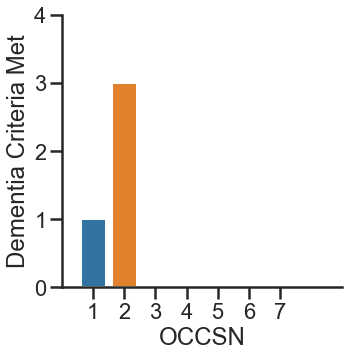

236576


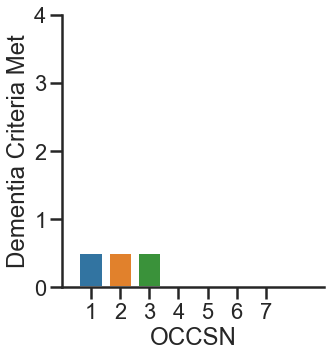

238559


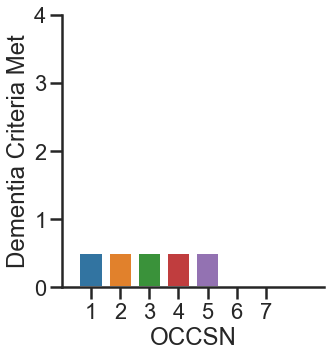

338027


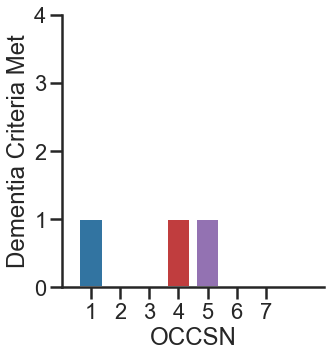

339510


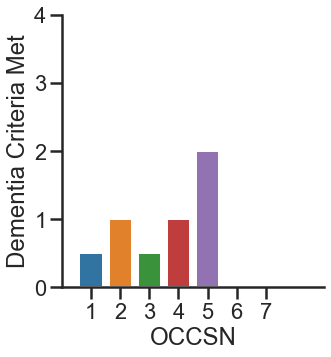

339536


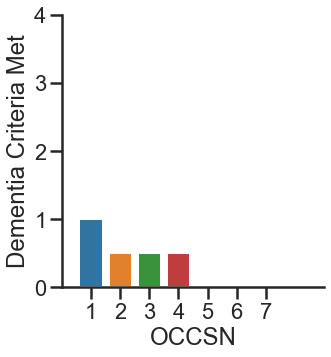

441351


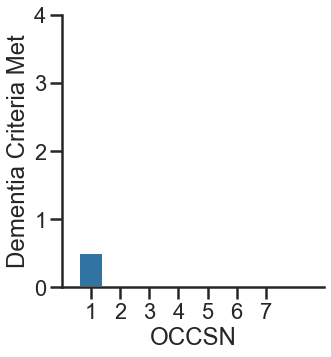

442703


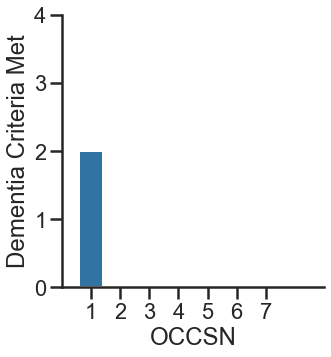

444301


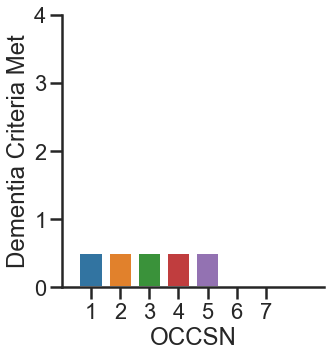

444353


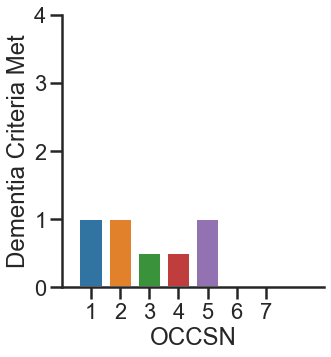

551853


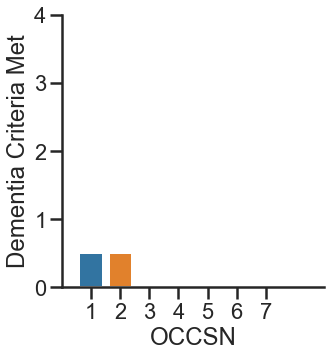

552704


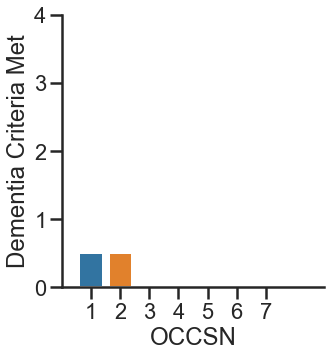

552852


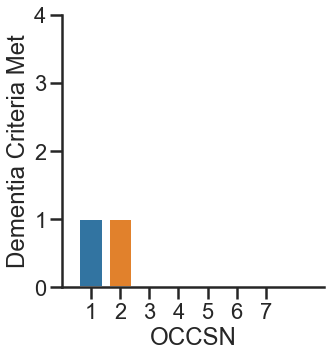

553101


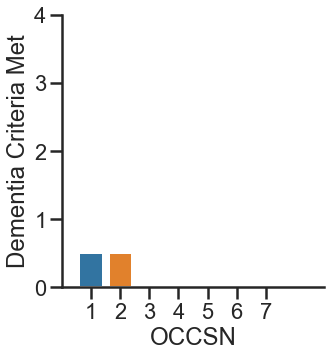

553103


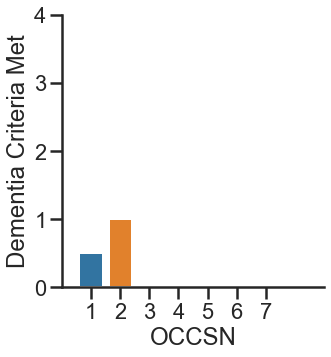

554201


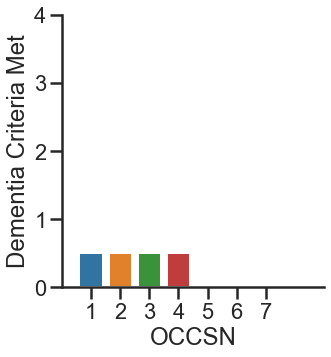

554356


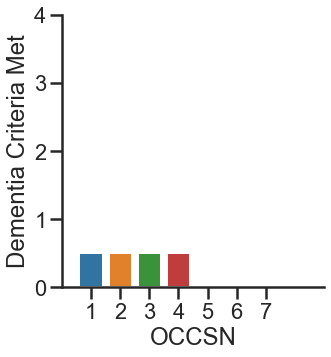

661309


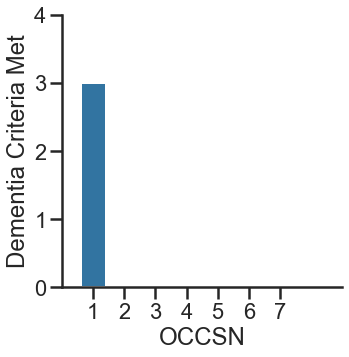

662255


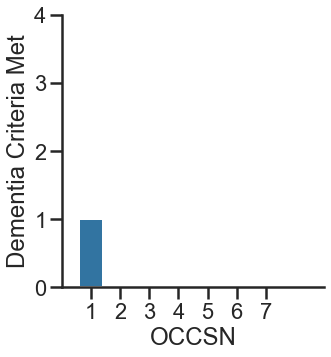

663406


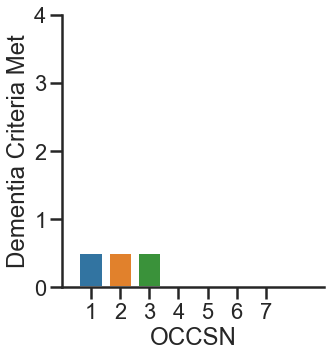

663959


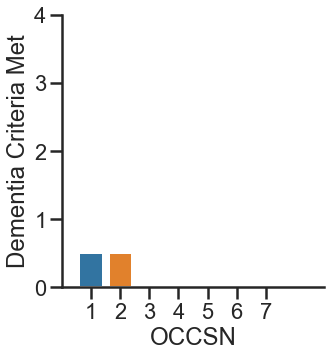

664057


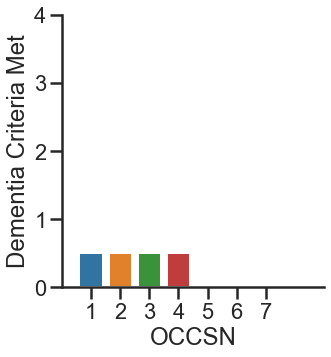

664253


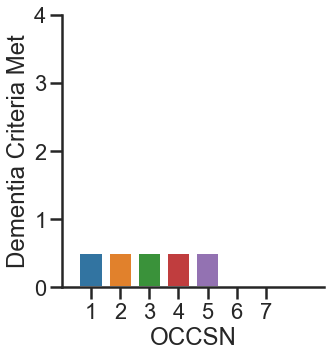

664259


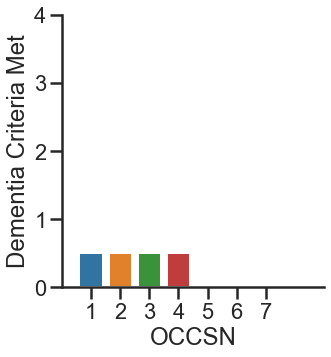

664301


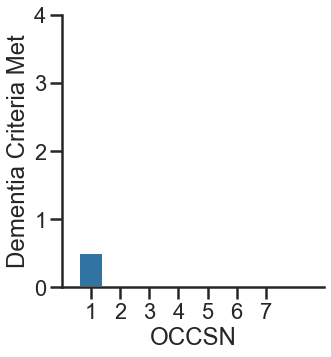

664354


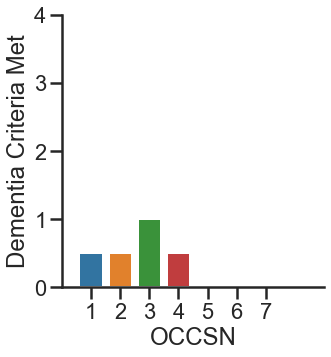

664357


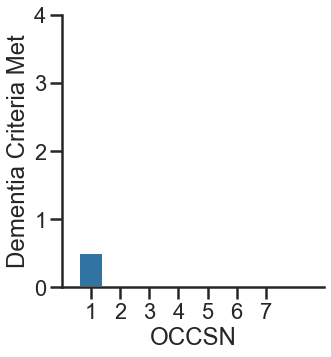

664360


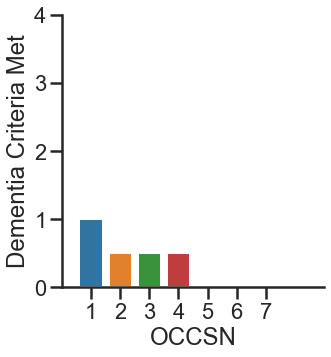

664361


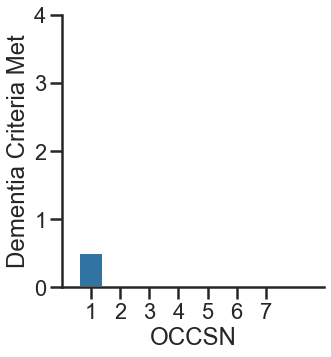

338028


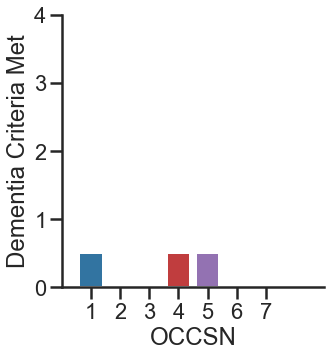

339502


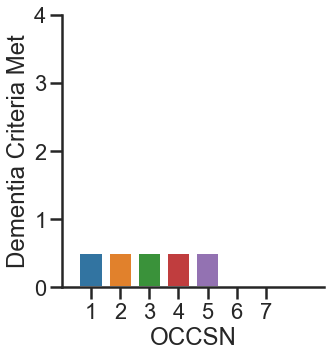

442353


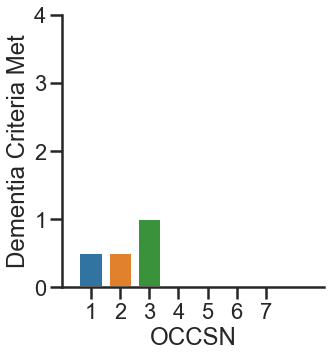

444355


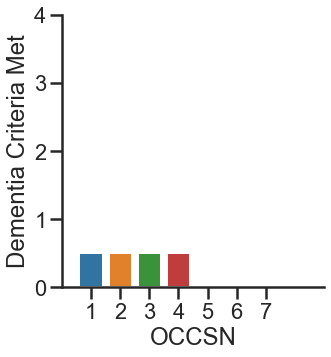

444402


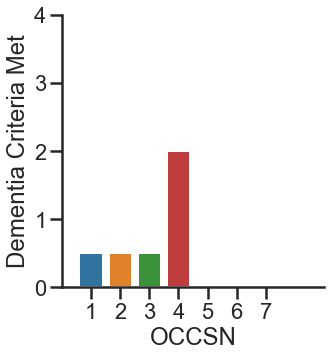

444452


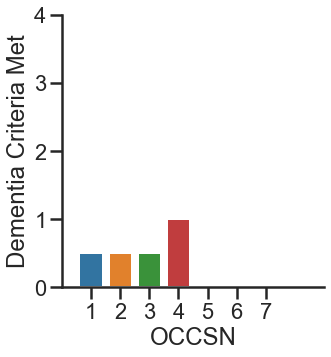

554303


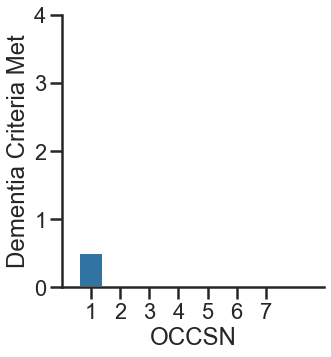

554354


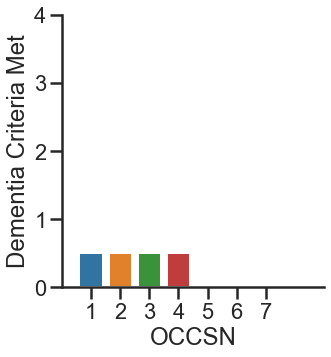

554453


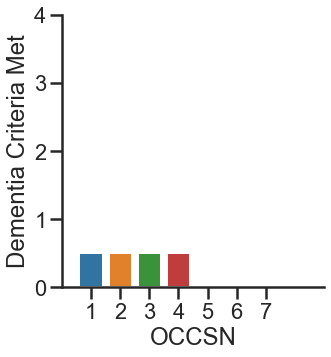

664303


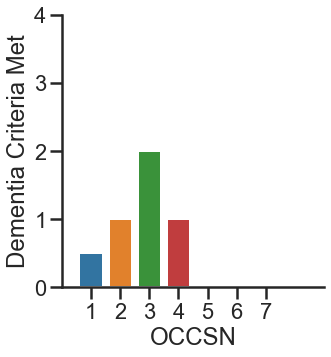

664305


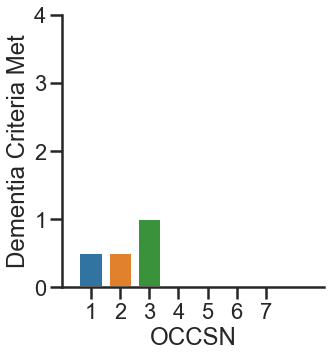

664351


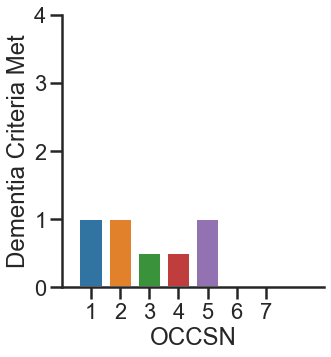

664353


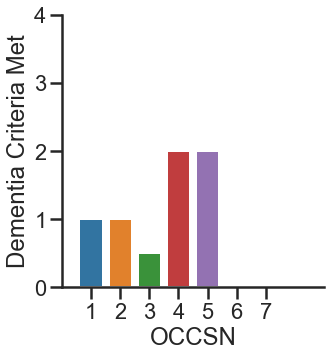

664402


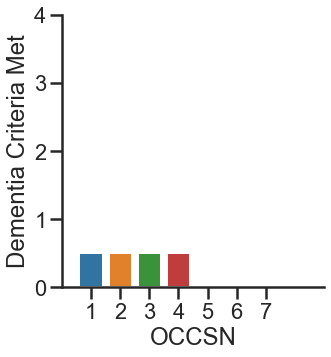

664410


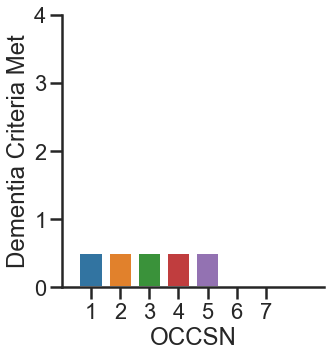

664452


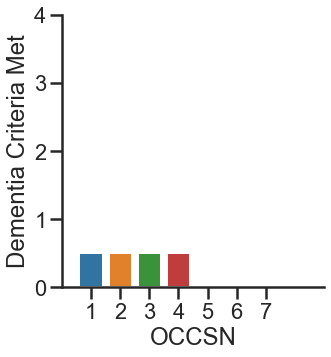

664453


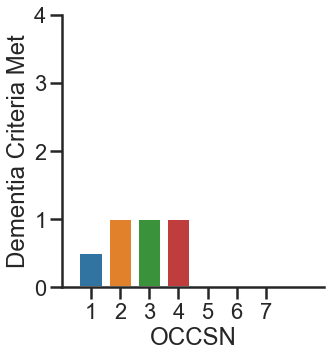

664457


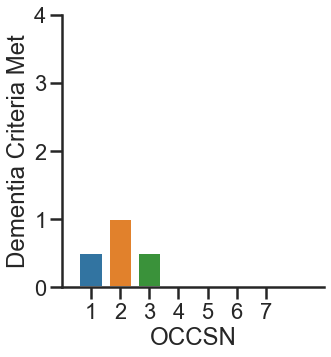

664460


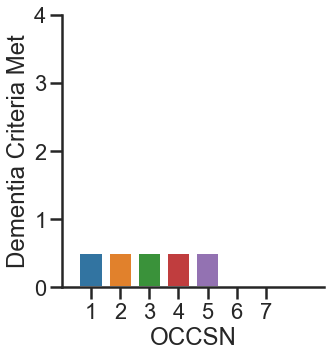

664463


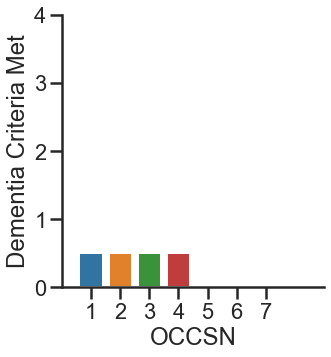

774010


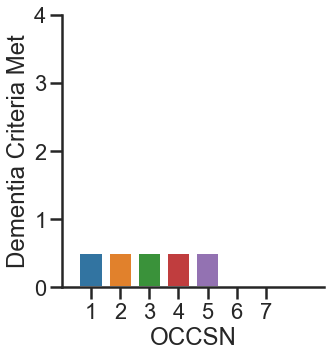

774352


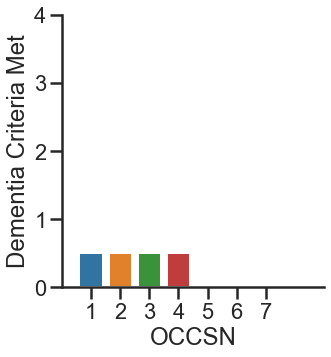

774357


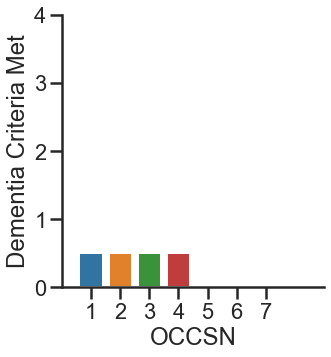

774401


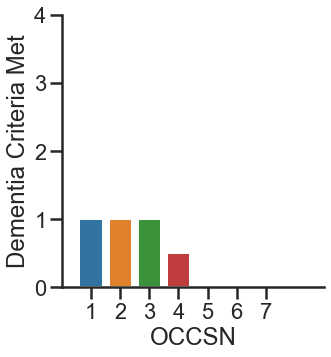

774451


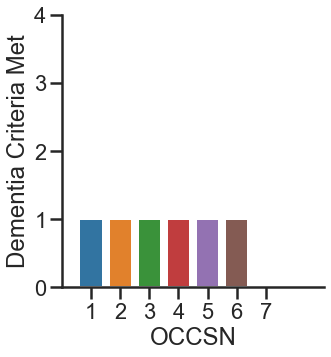

774453


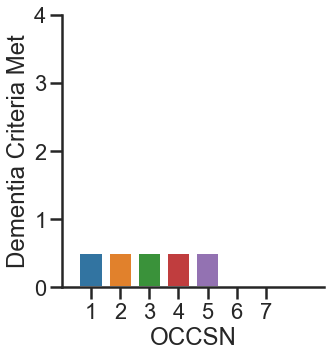

774454


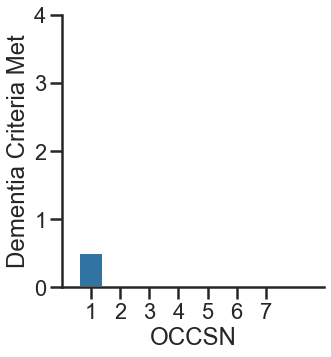

664363


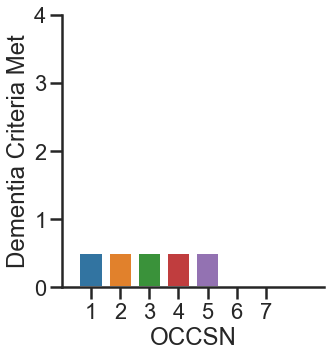

664411


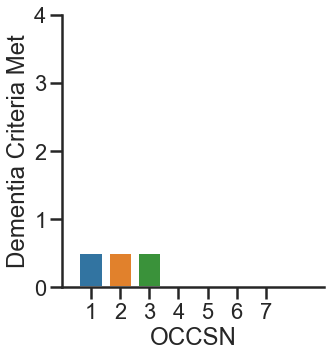

664458


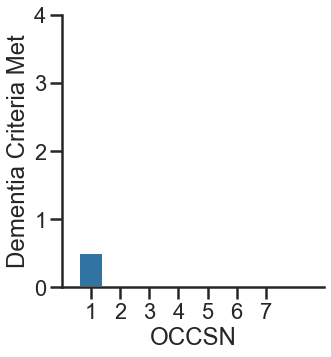

236520


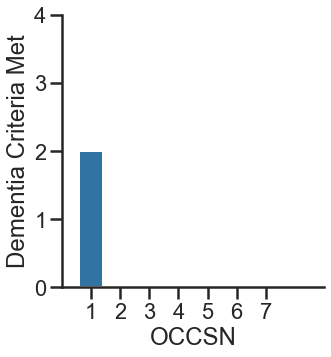

237542


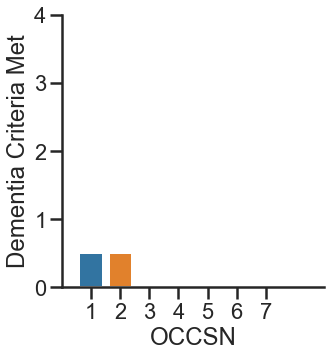

238533


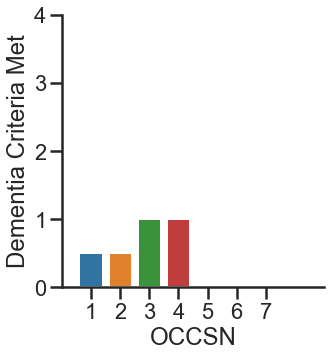

338521


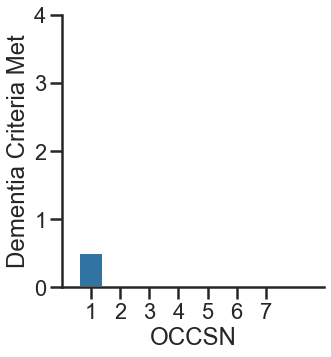

339507


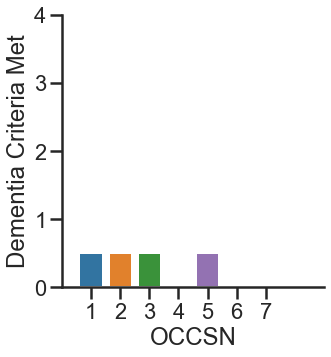

339515


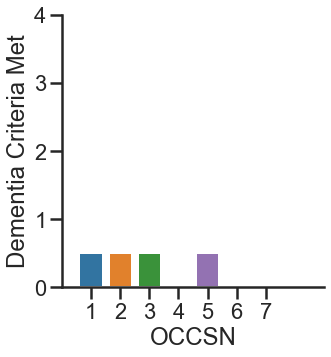

442502


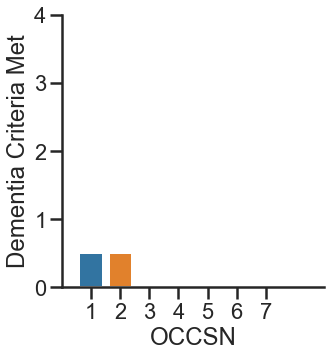

442555


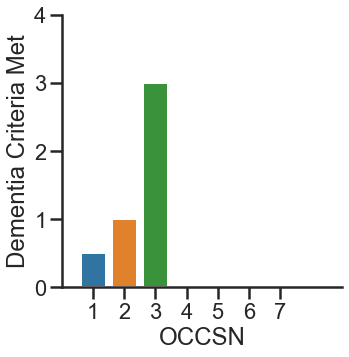

443451


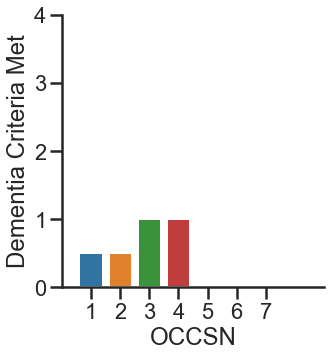

445205


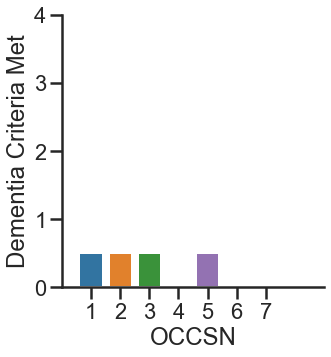

774305


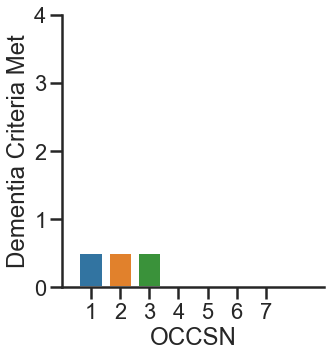

774552


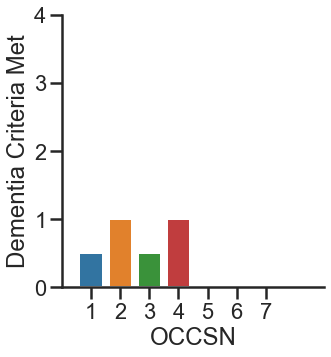

774613


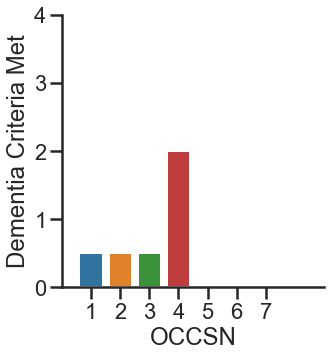

774762


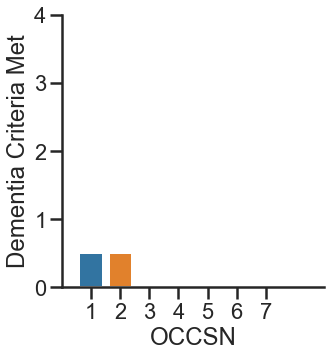

774868


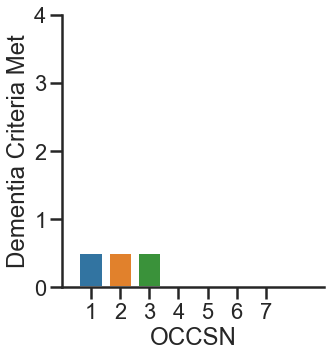

775054


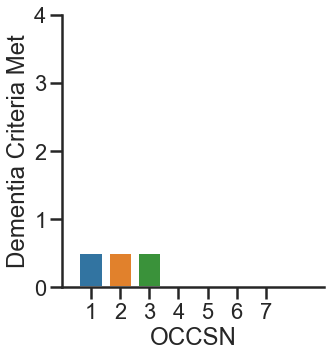

775160


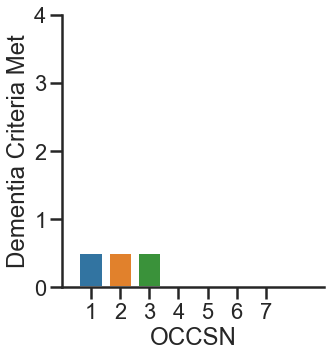

775201


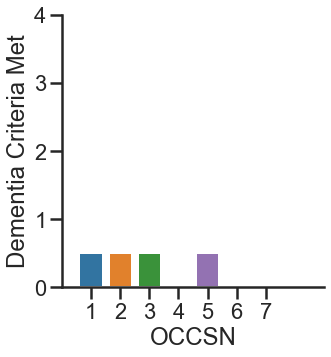

775259


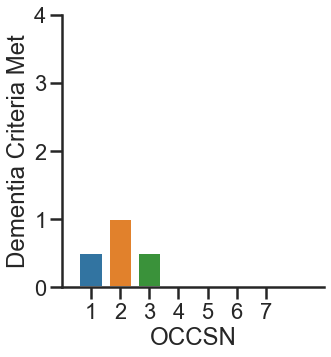

775468


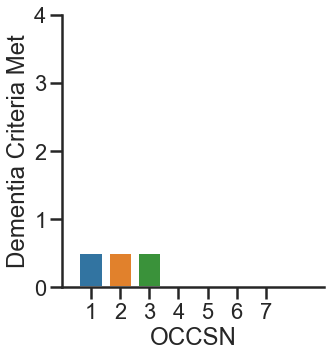

775666


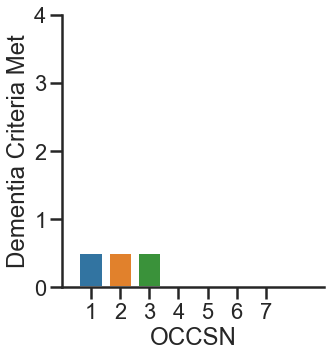

775909


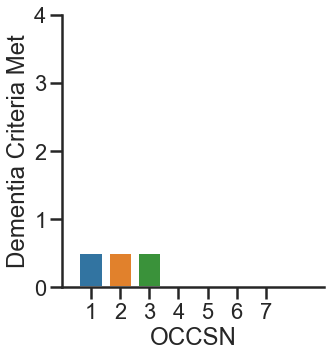

776672


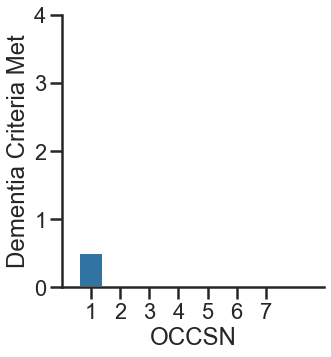

339011


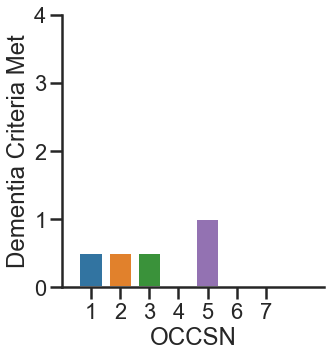

339016


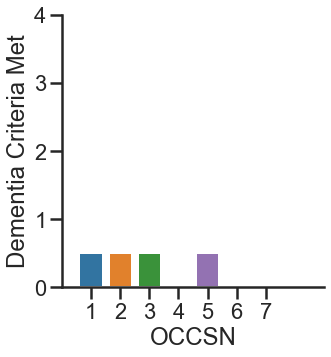

339019


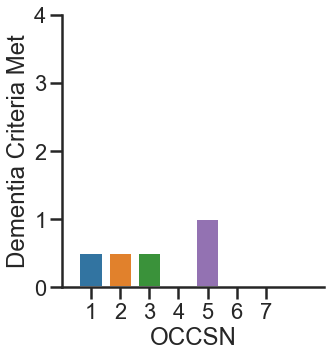

339029


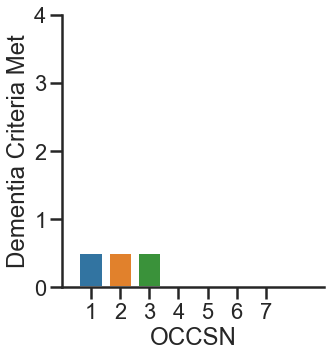

339519


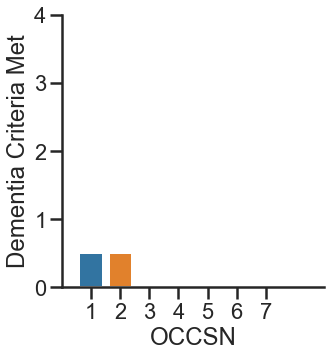

339528


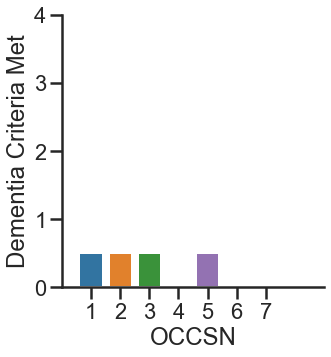

339539


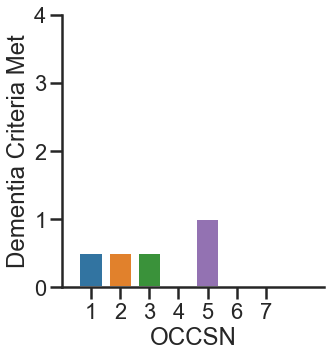

444251


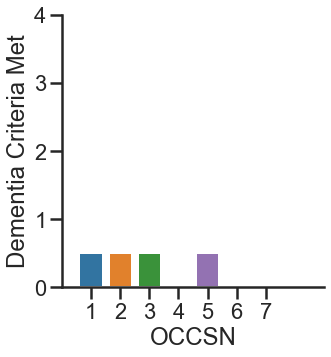

444653


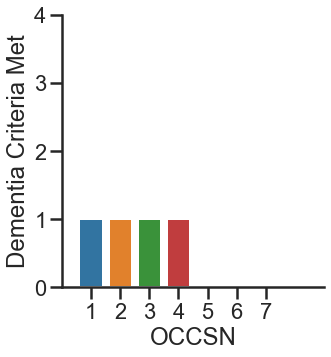

444703


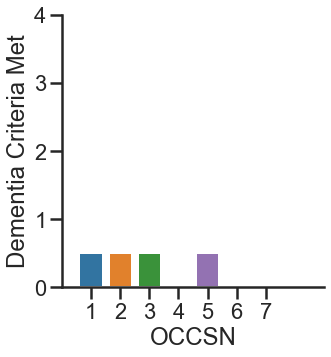

444704


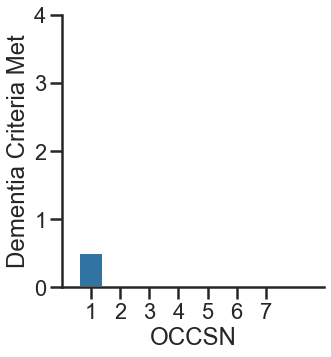

444752


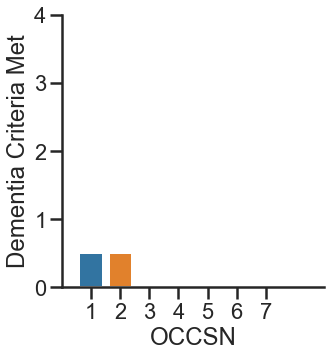

444801


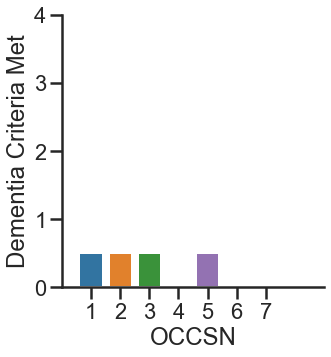

444802


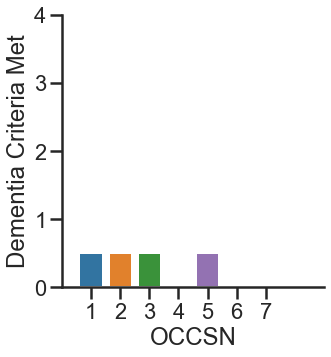

444804


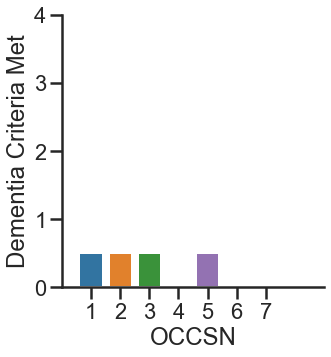

444851


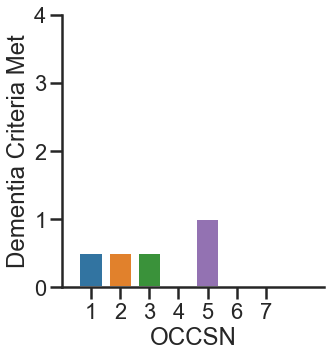

444901


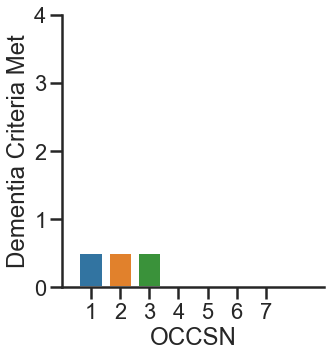

444905


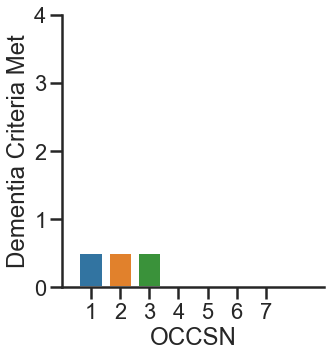

444952


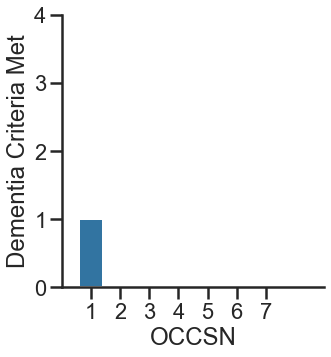

445002


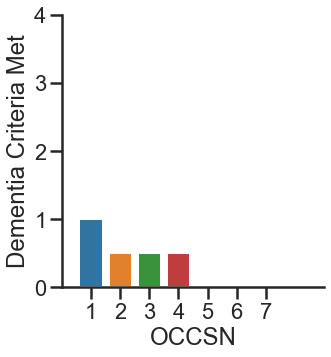

445003


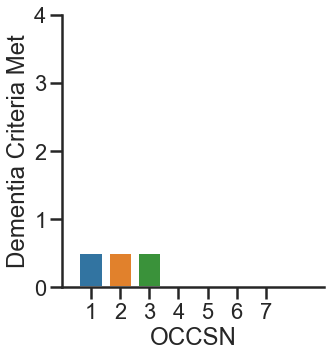

445054


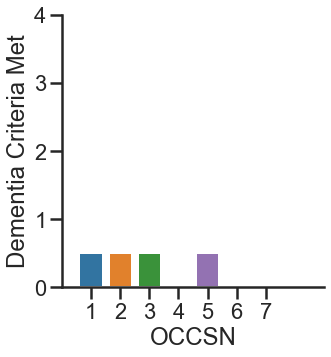

445203


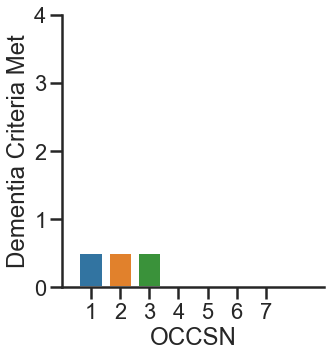

445204


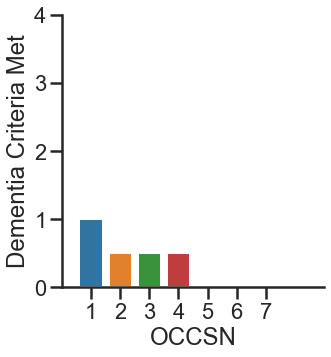

445252


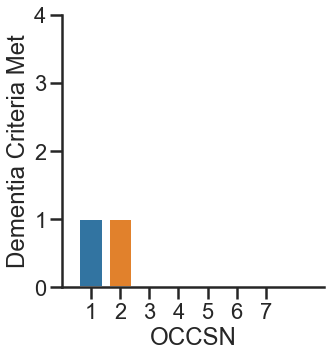

445352


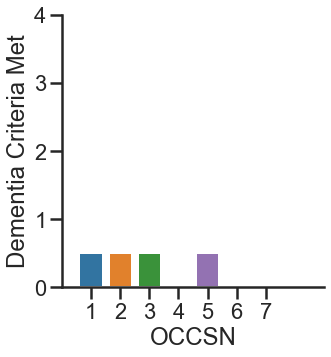

445354


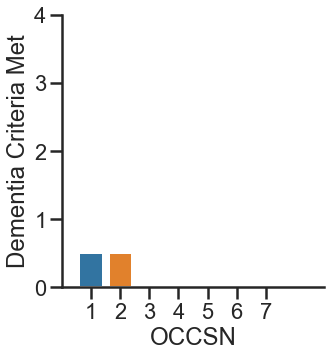

445401


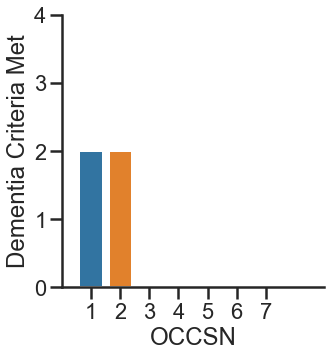

445403


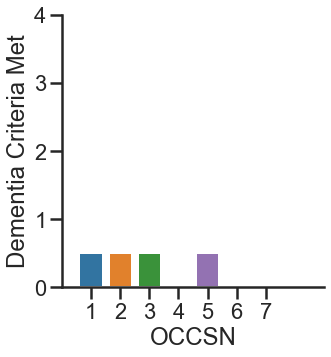

445454


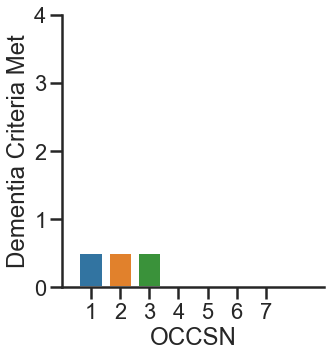

553502


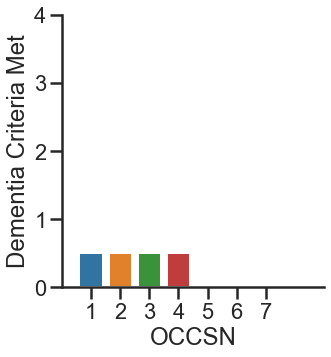

554053


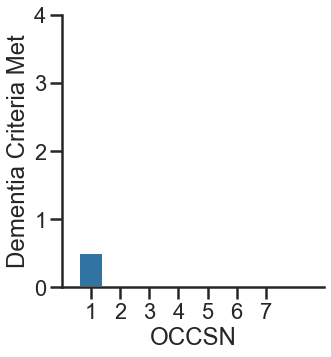

554304


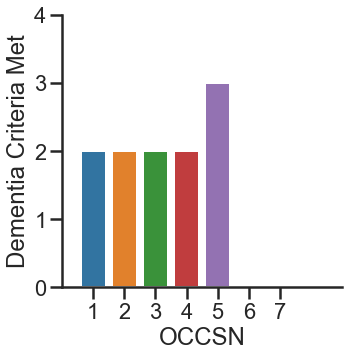

554455


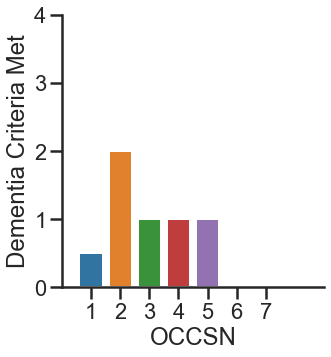

554457


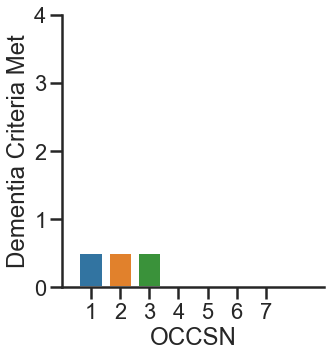

554501


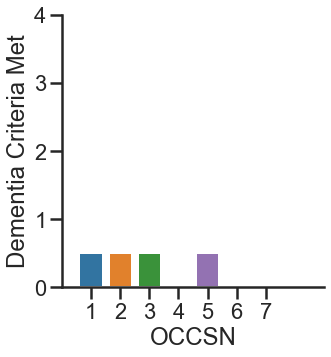

554502


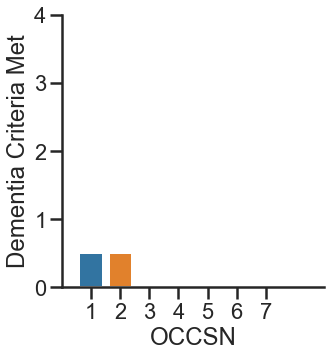

554556


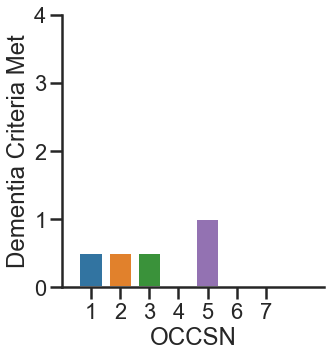

554559


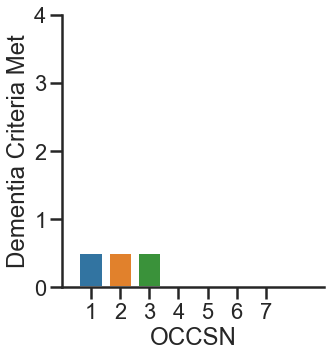

554601


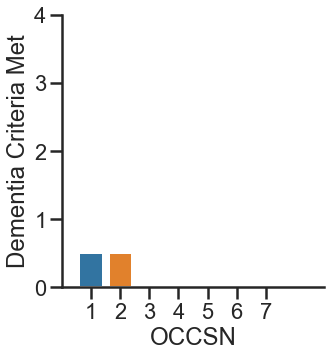

554604


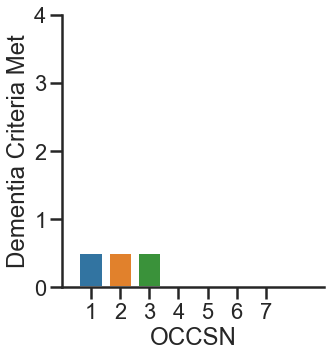

554652


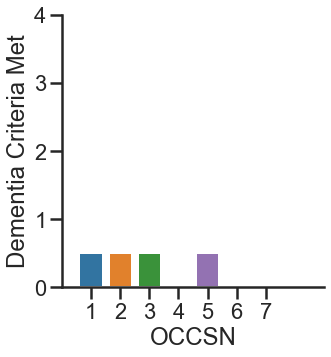

554701


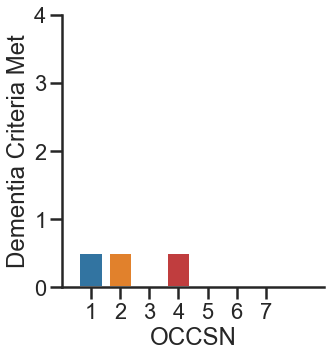

554702


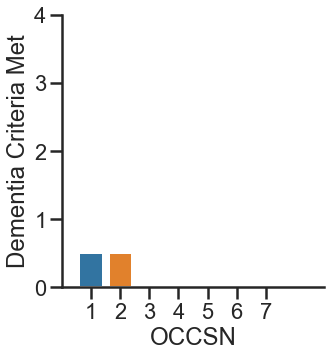

554755


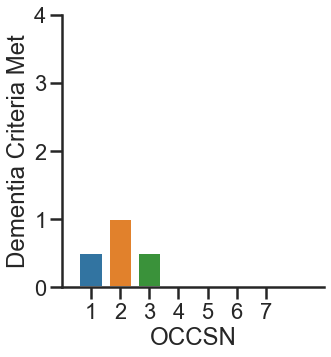

554756


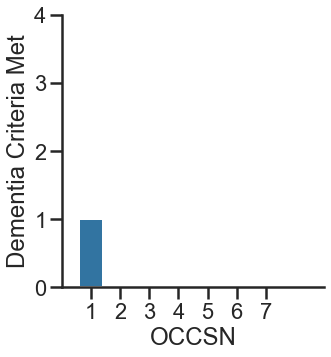

554804


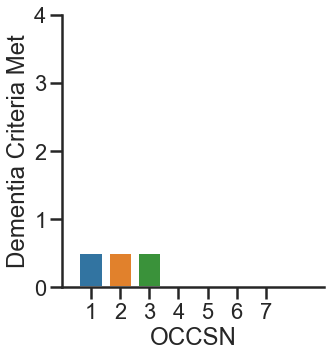

554855


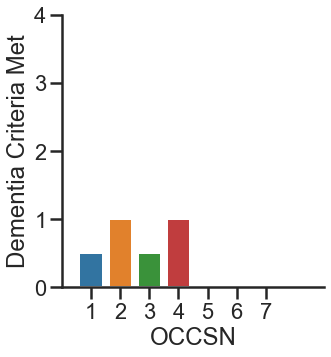

554856


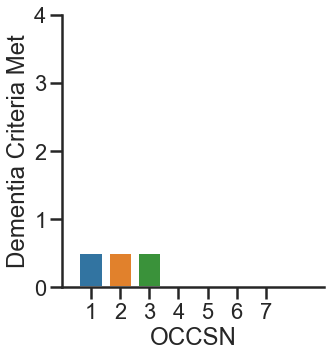

554903


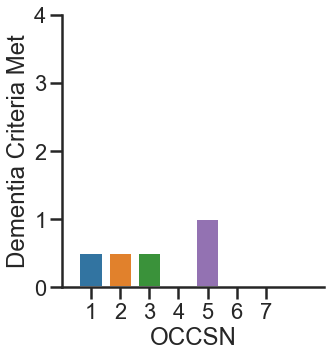

554904


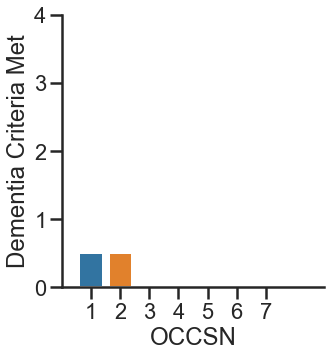

554952


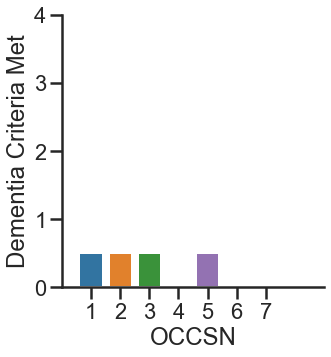

554954


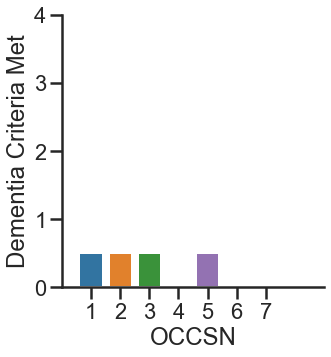

554956


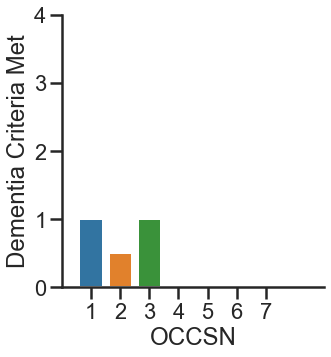

555001


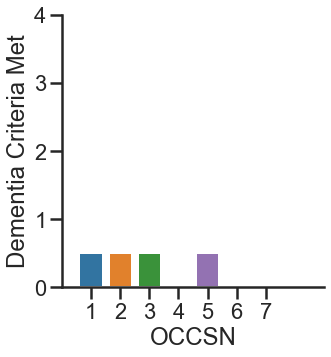

555004


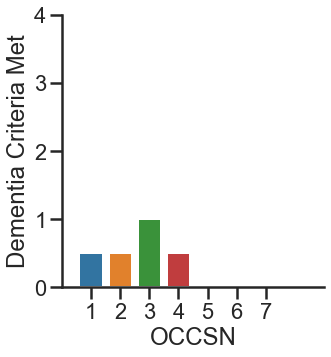

555053


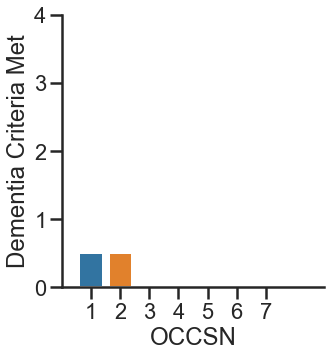

555054


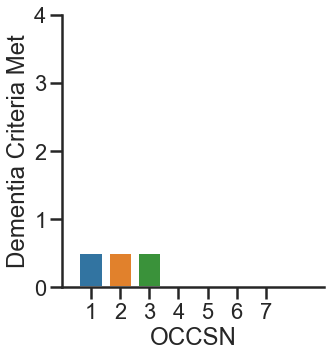

555151


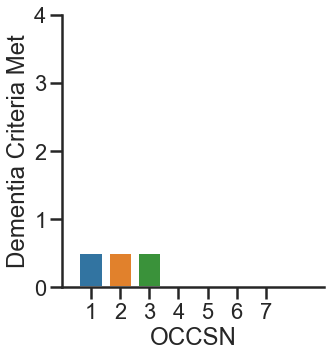

555153


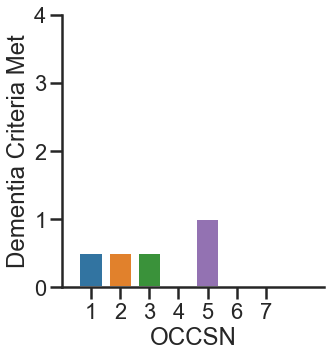

555154


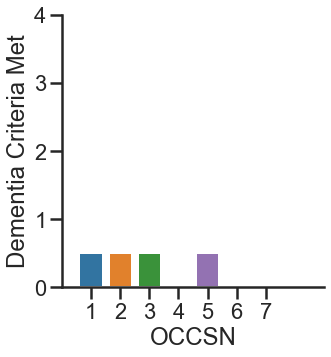

555303


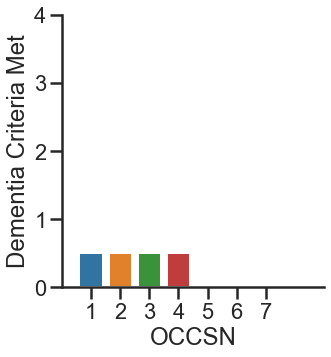

555452


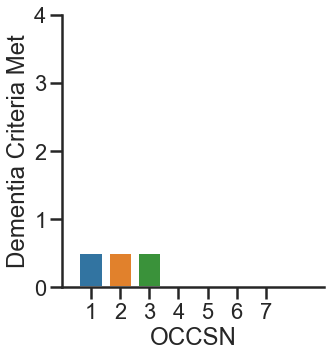

555504


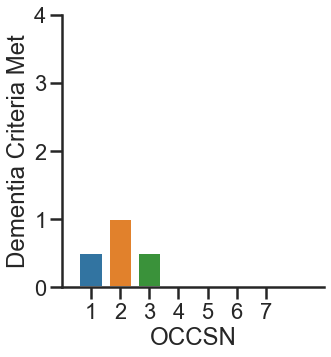

555555


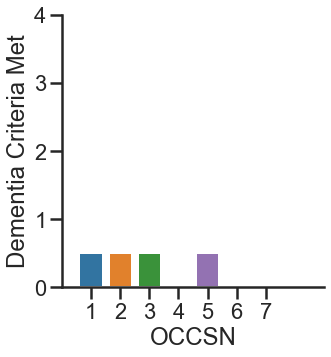

555603


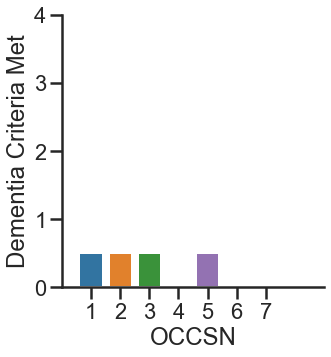

555604


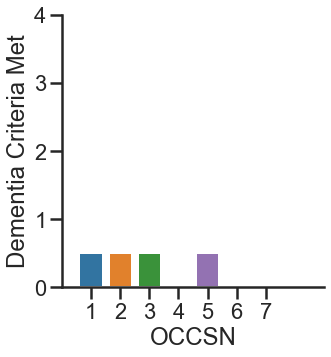

555605


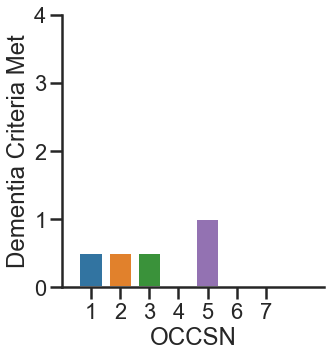

555660


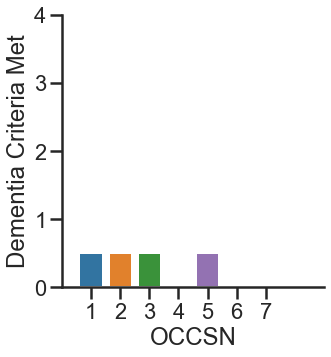

555701


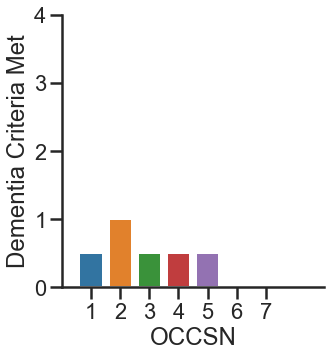

555703


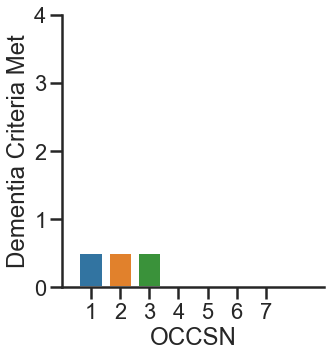

555751


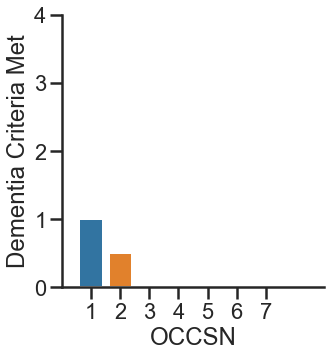

555754


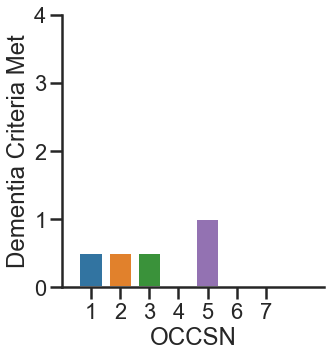

555758


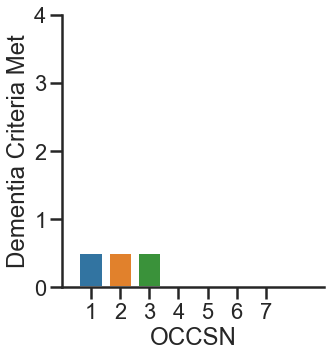

555802


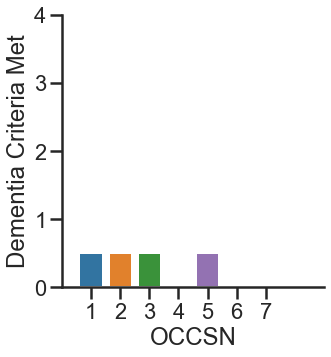

555852


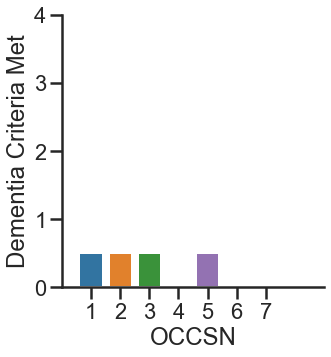

555853


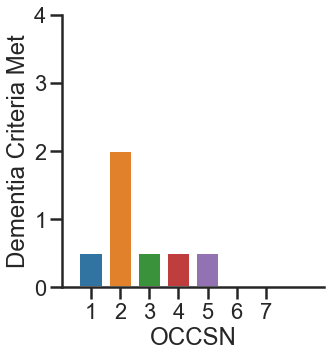

555859


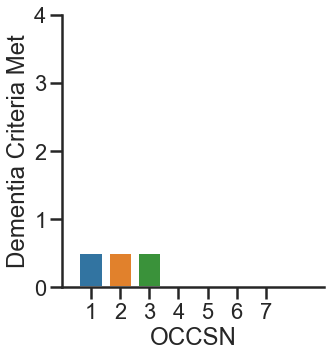

555860


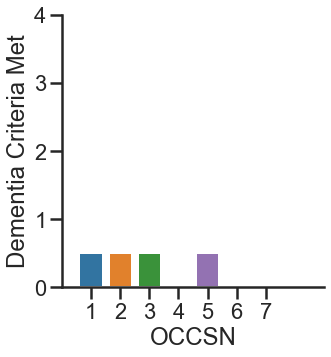

555861


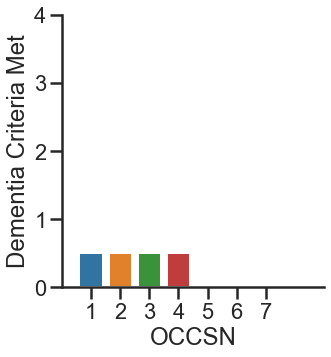

555955


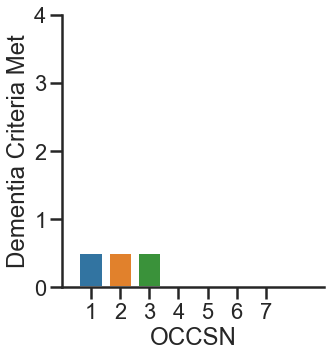

555957


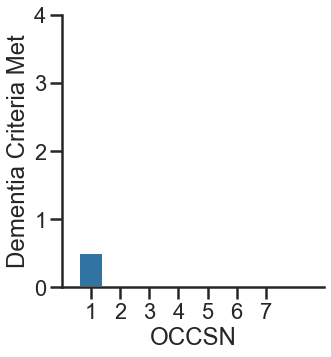

555959


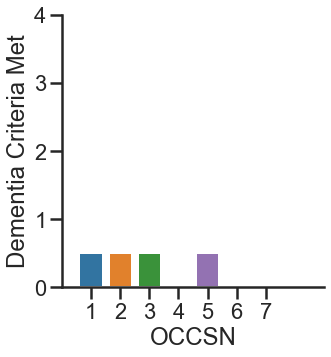

556058


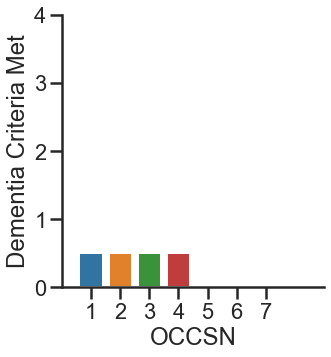

556059


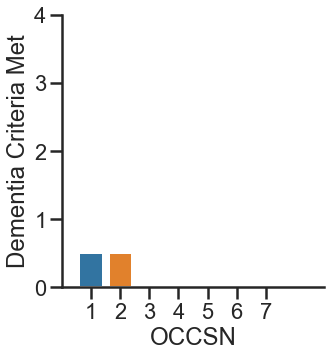

664451


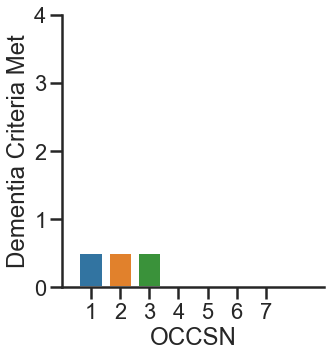

664456


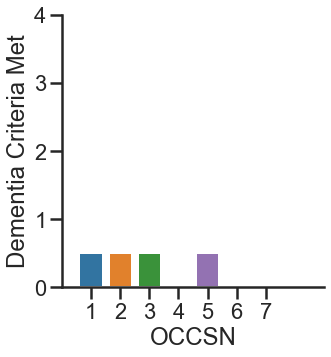

664501


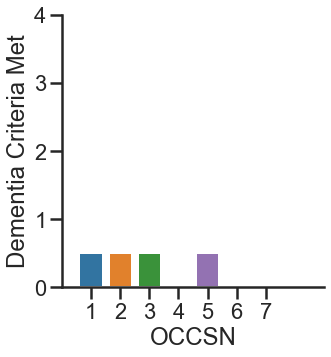

664502


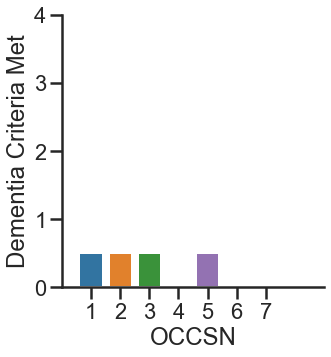

664503


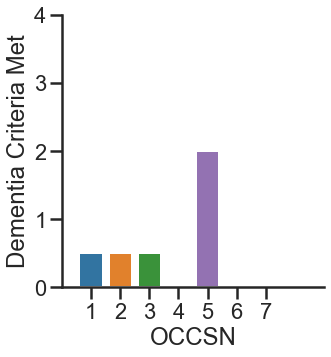

664505


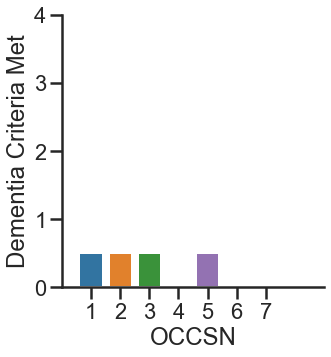

664506


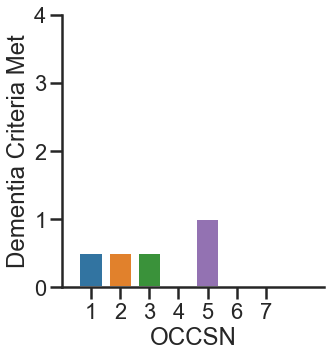

664508


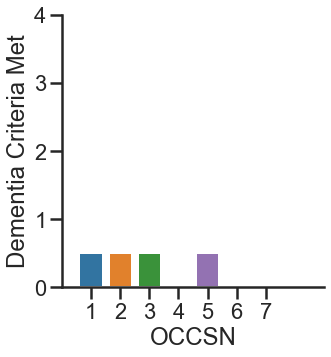

664509


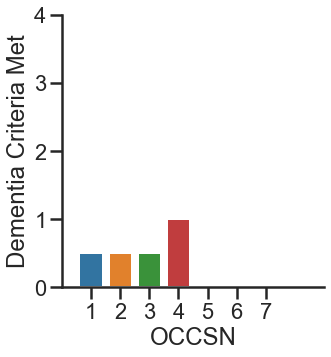

664552


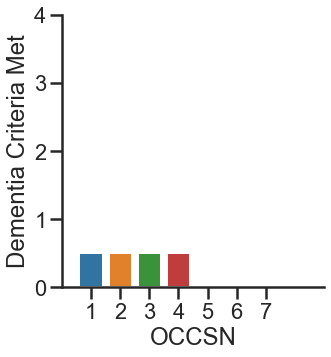

664558


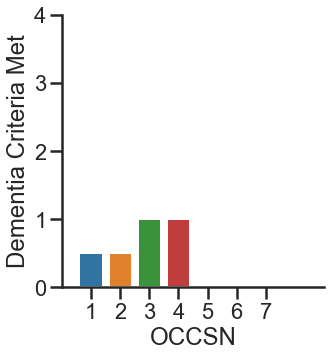

664561


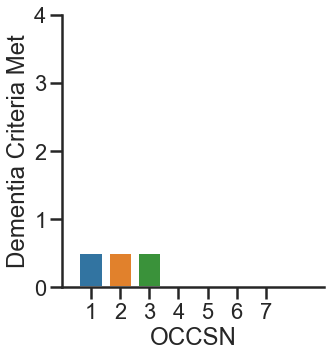

664651


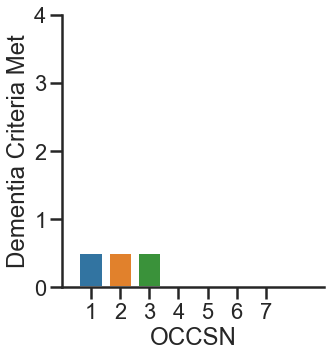

664656


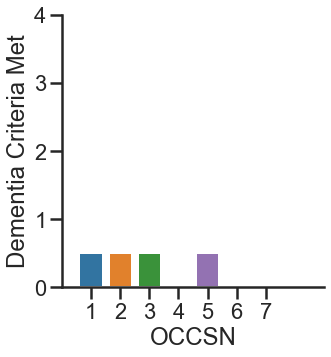

664657


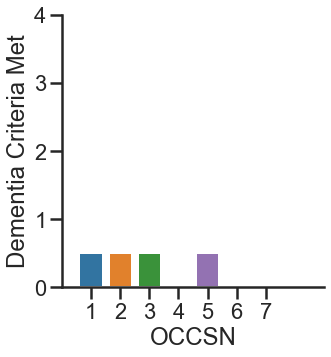

664702


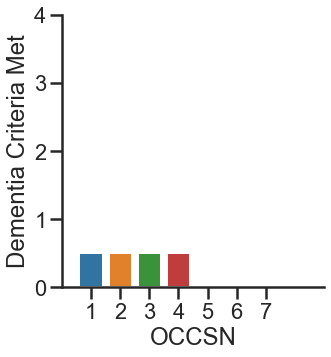

664705


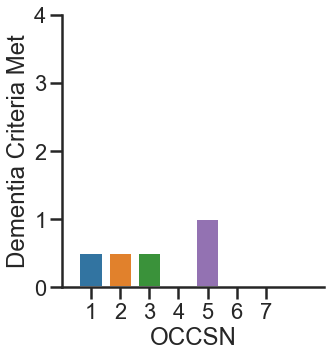

664752


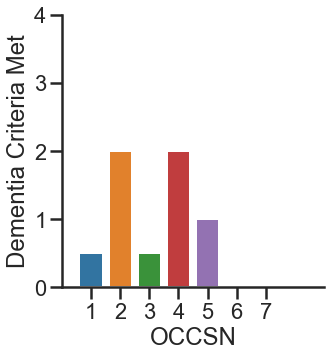

664753


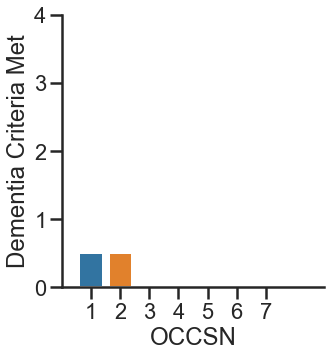

664757


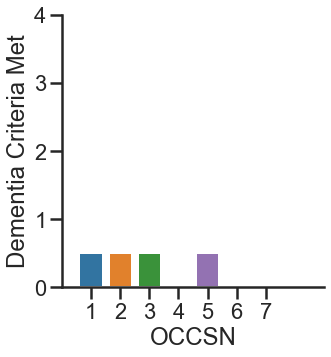

664758


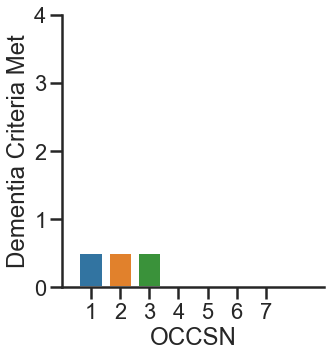

664802


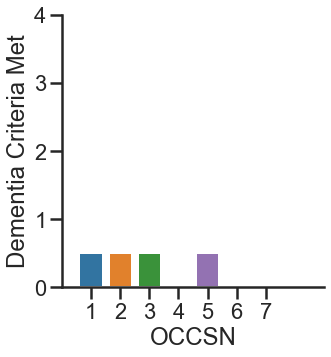

664804


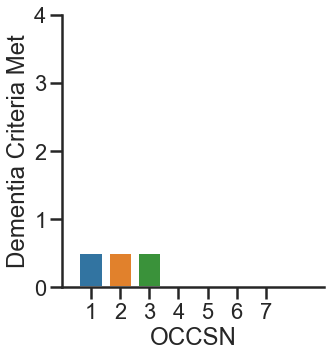

664805


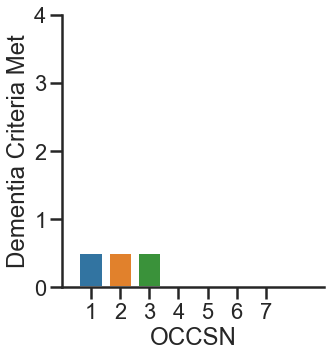

664806


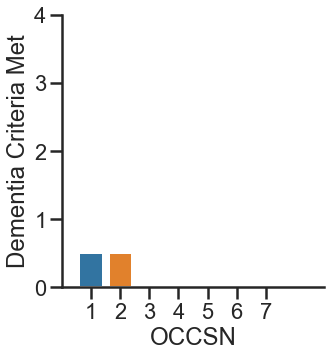

664852


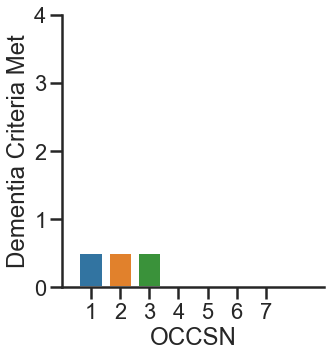

664905


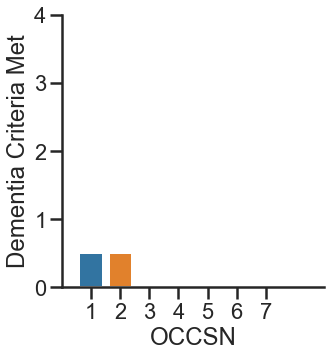

664906


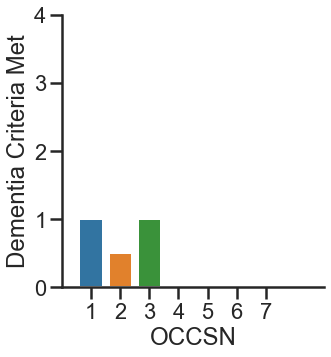

664908


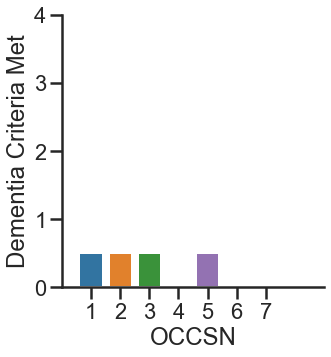

664909


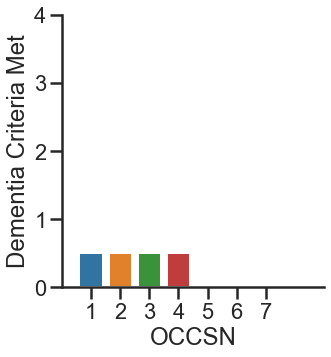

664910


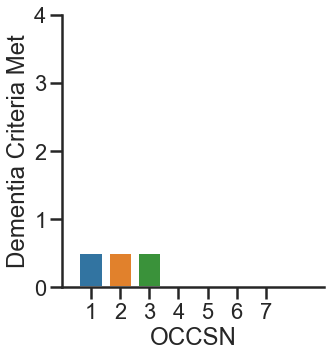

664916


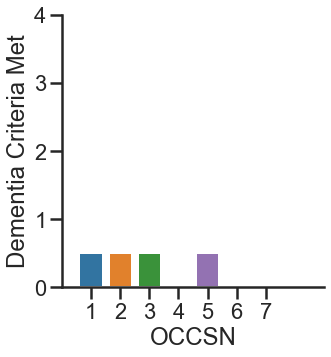

664953


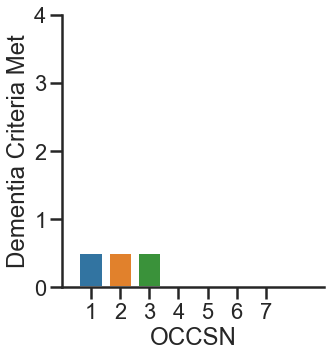

664957


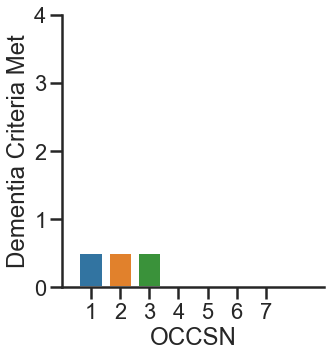

664960


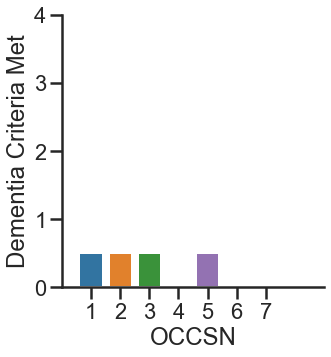

664961


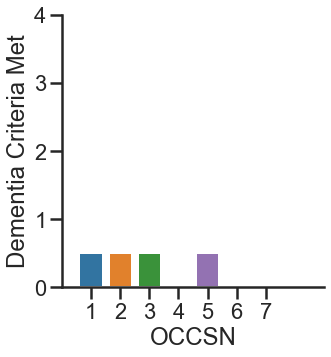

665001


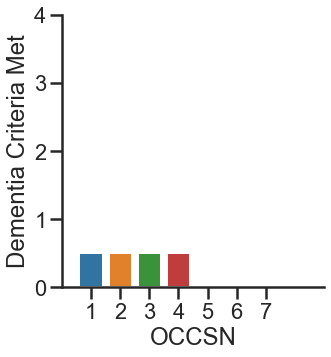

665003


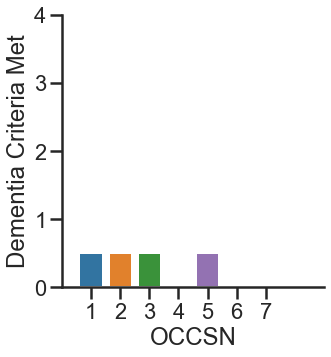

665005


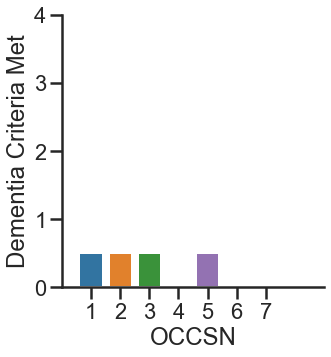

665006


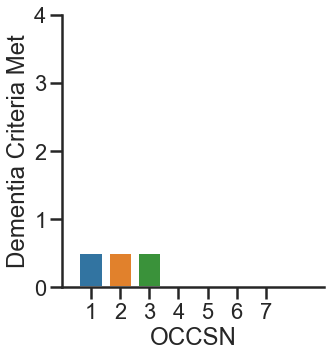

665008


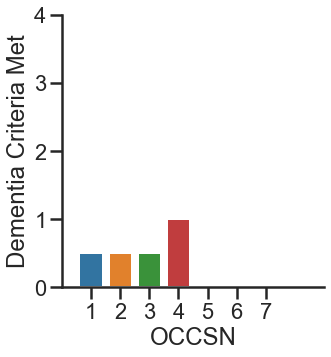

665009


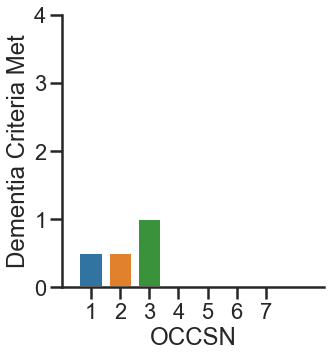

665055


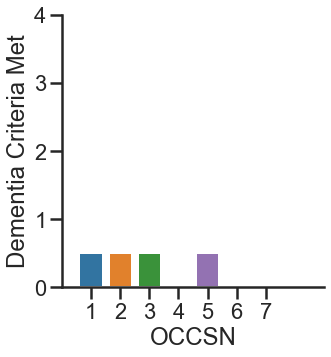

665063


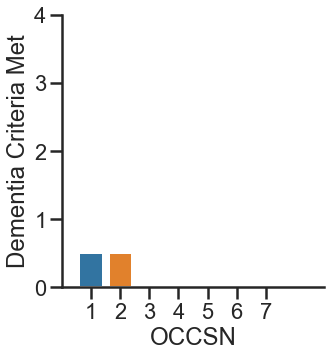

665101


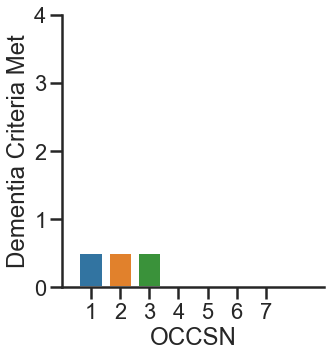

665103


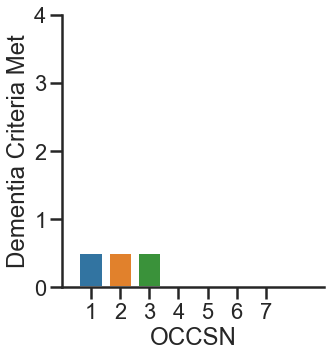

665153


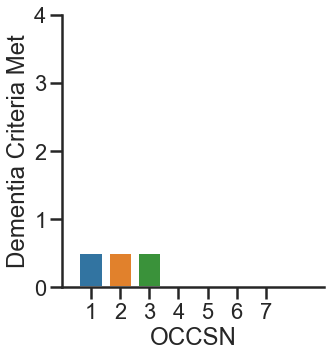

665207


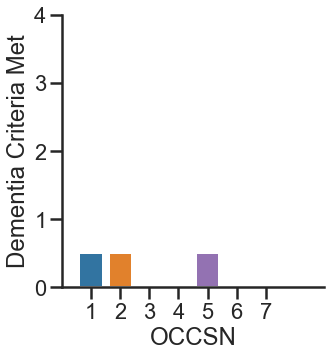

665251


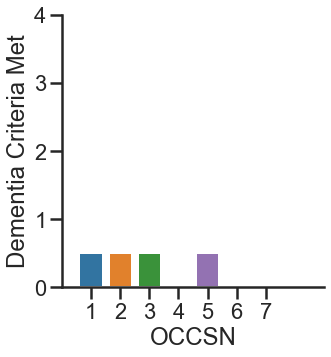

665255


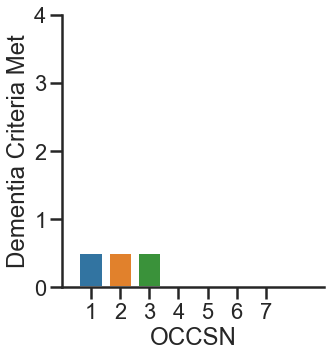

665304


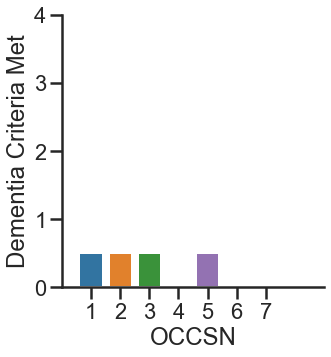

665307


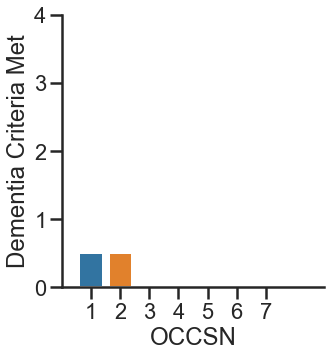

665352


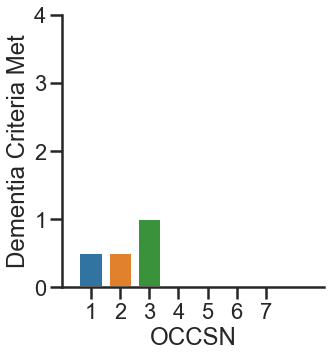

665353


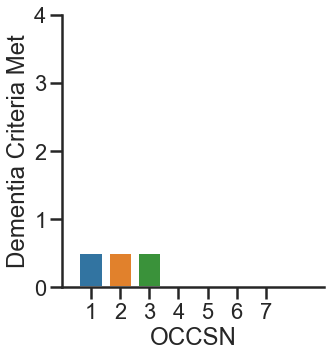

665354


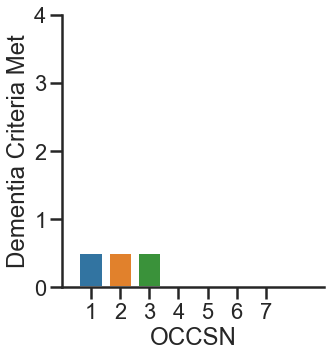

665357


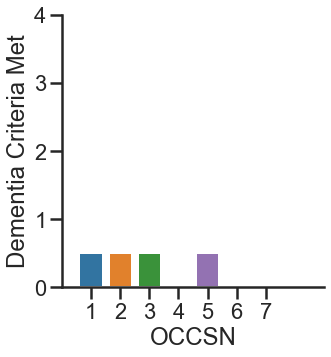

665358


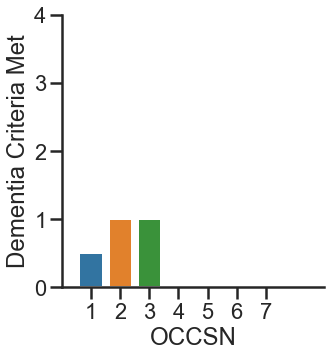

665403


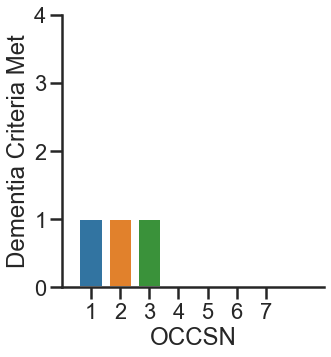

665404


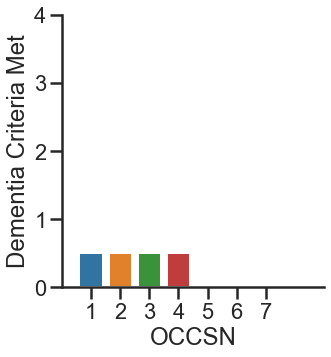

665407


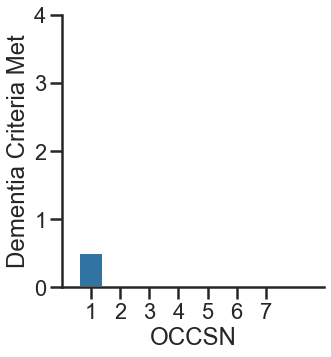

665455


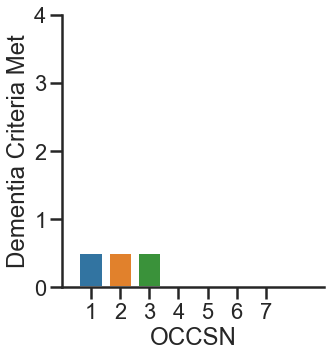

665501


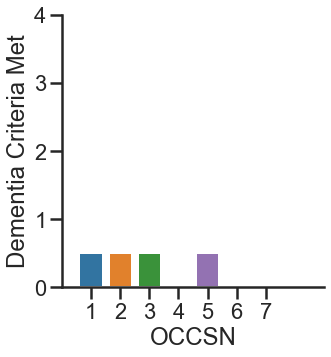

665503


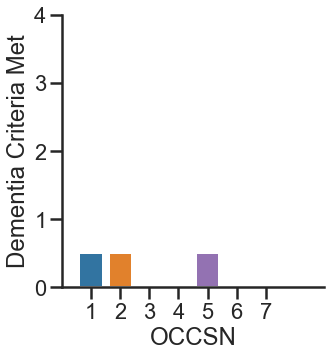

665504


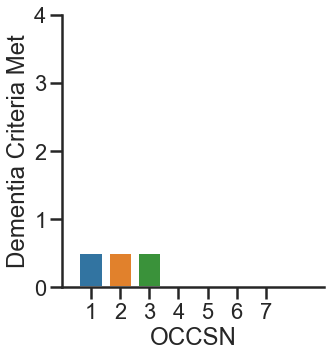

665553


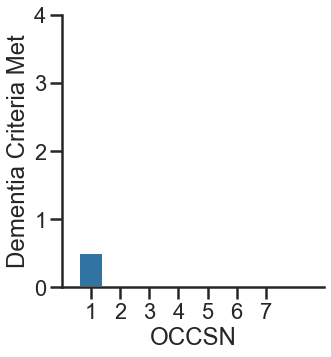

665556


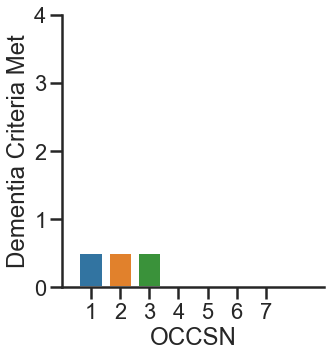

665652


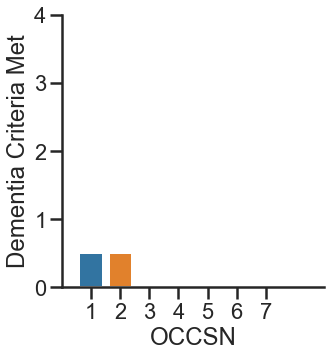

665654


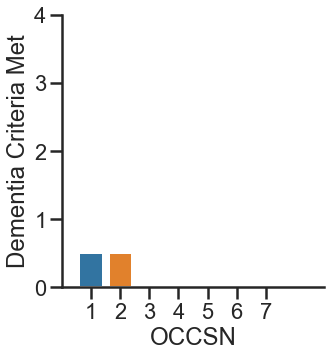

665657


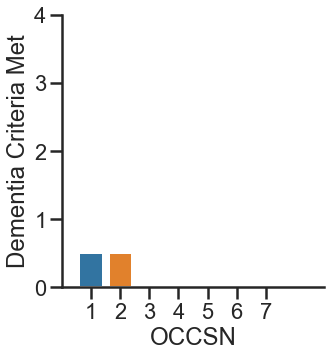

665706


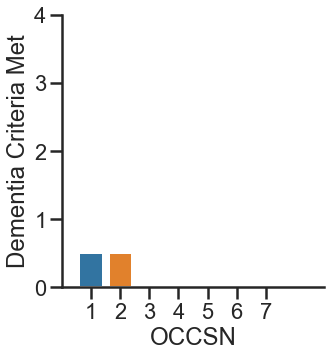

665758


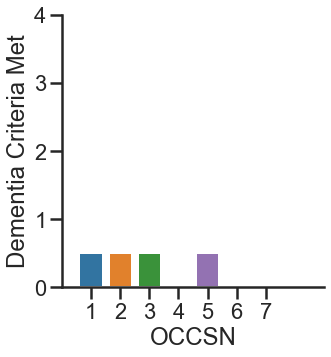

665802


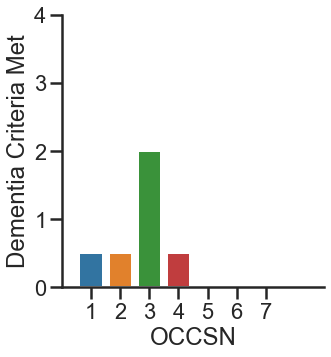

665852


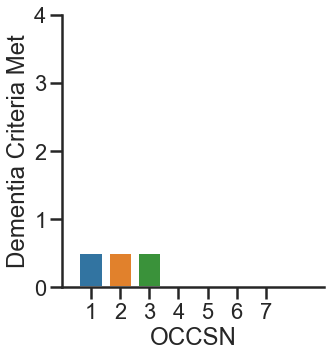

665857


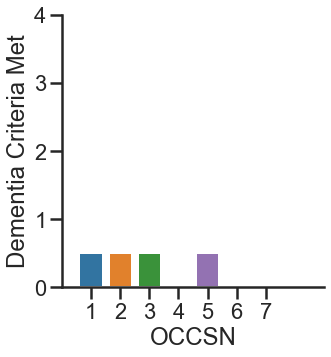

665859


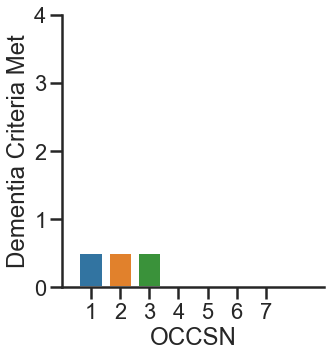

665860


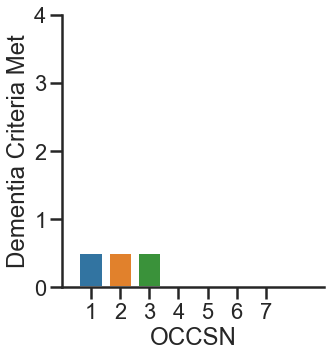

665861


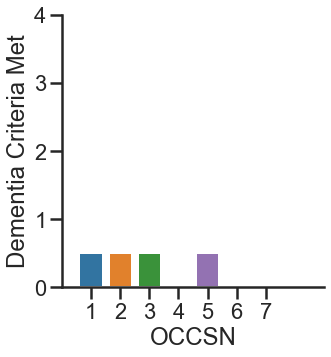

665862


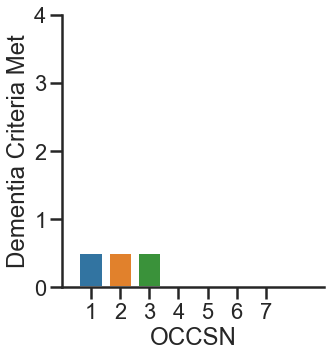

665906


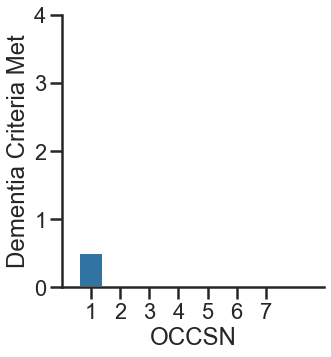

666054


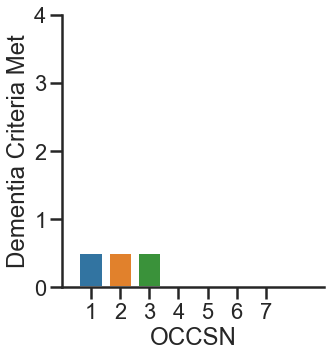

666201


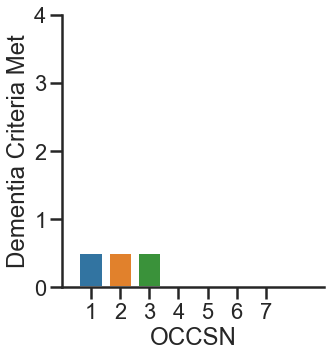

666206


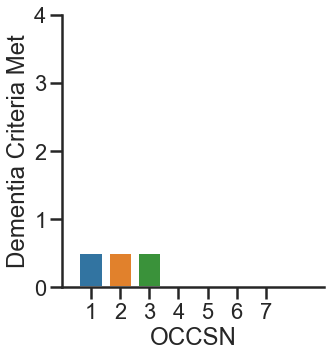

666251


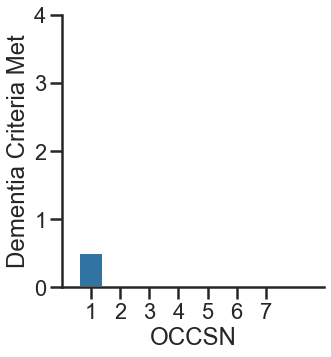

666353


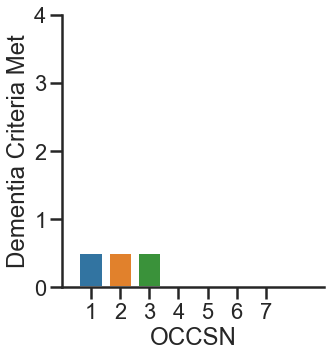

666357


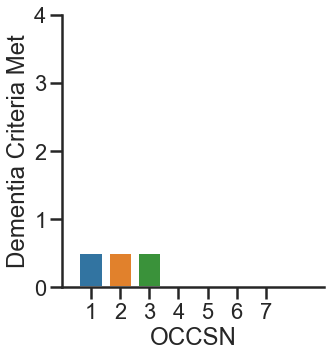

666402


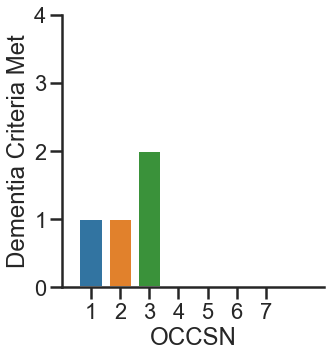

666455


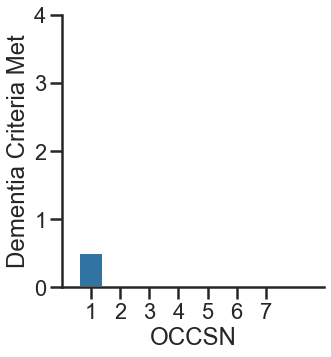

666456


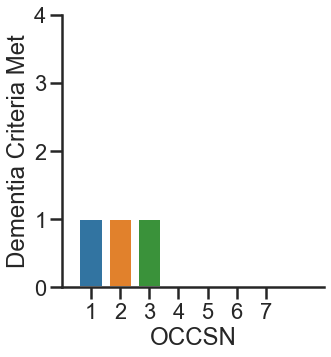

666457


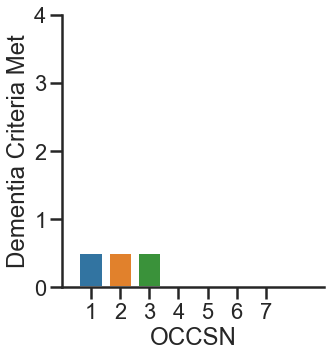

666503


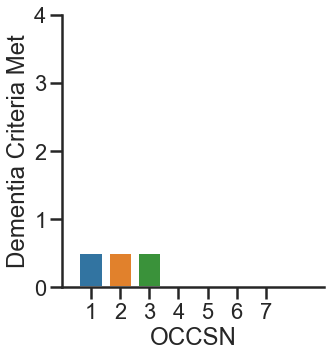

666551


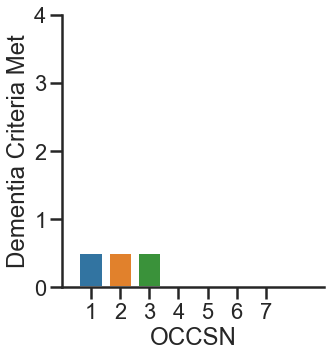

666651


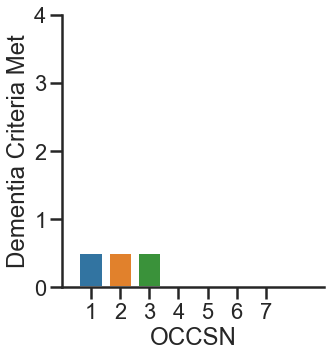

666753


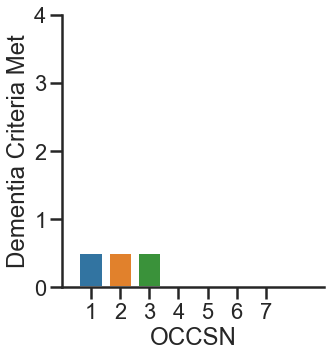

774202


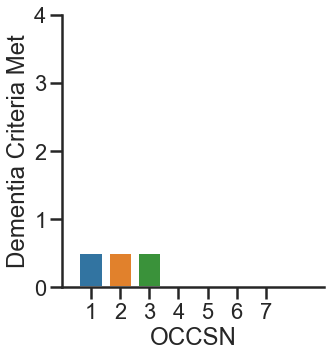

774205


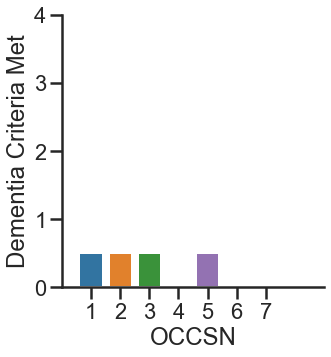

774251


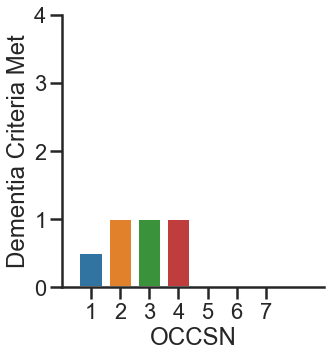

774255


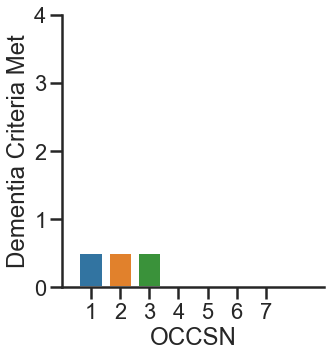

774258


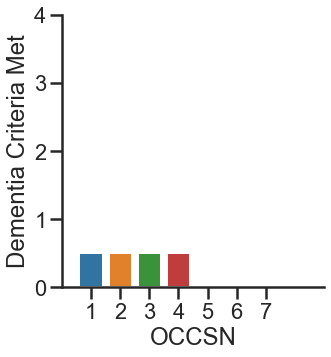

774261


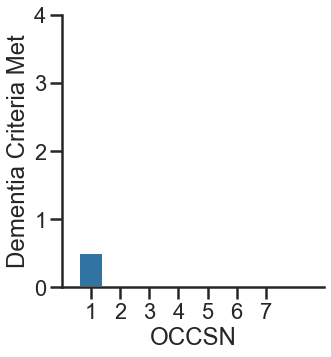

774306


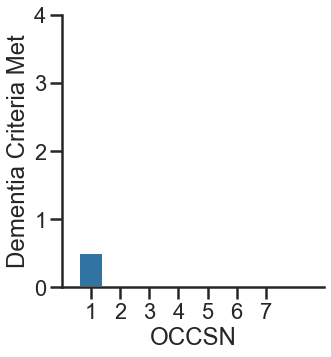

774363


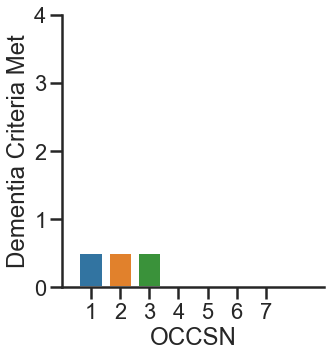

774364


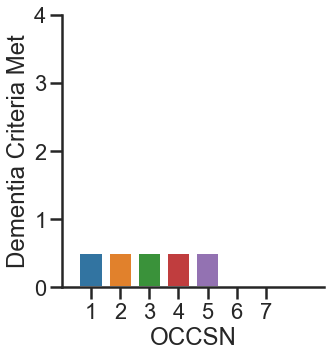

774402


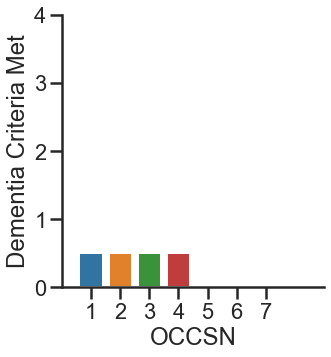

774455


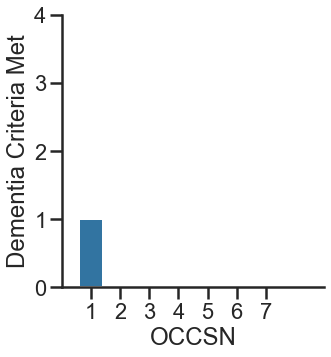

774502


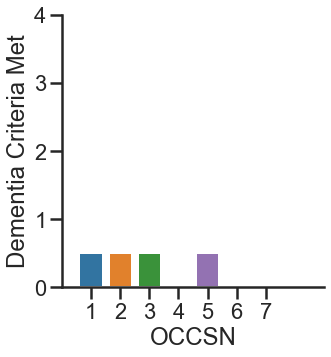

774553


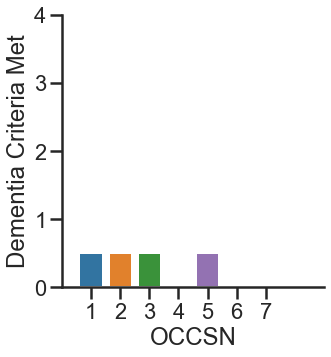

774554


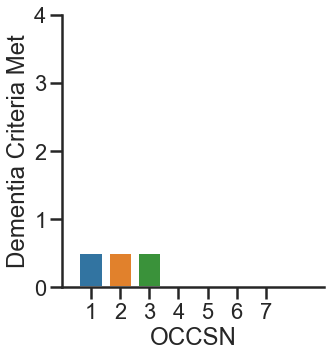

774604


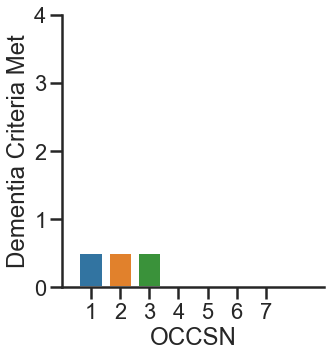

774606


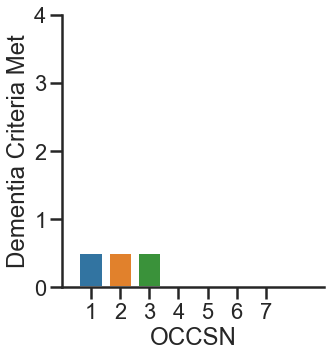

774610


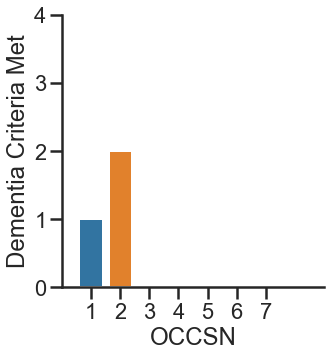

774651


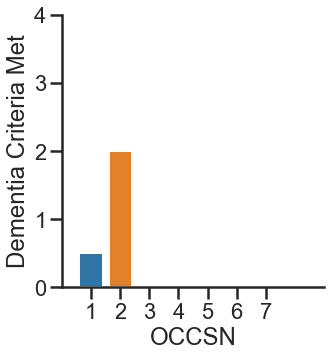

774653


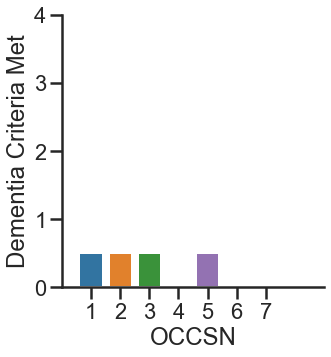

774658


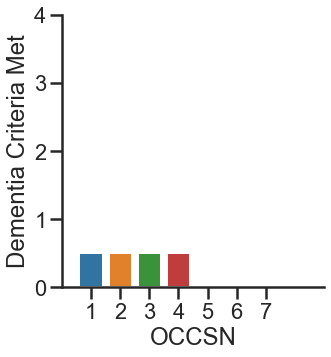

774659


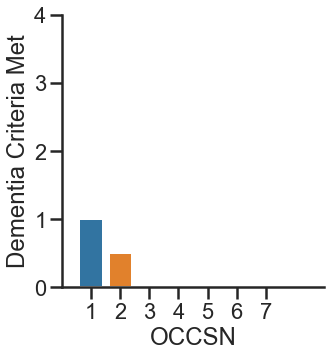

774660


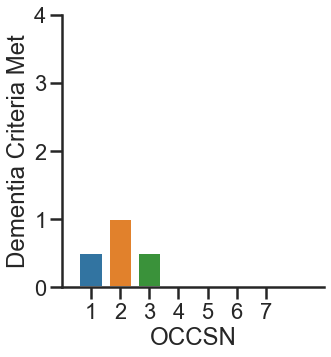

774661


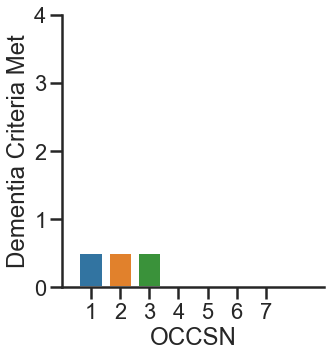

774663


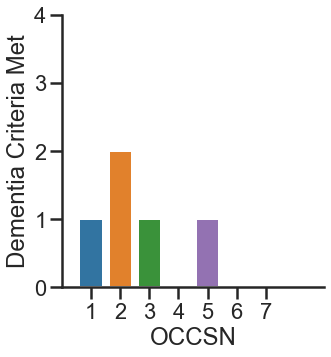

774704


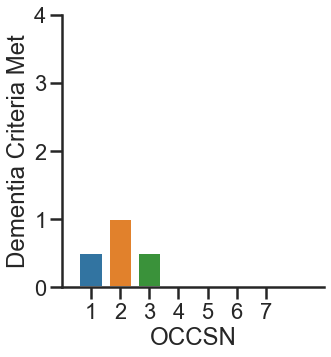

774707


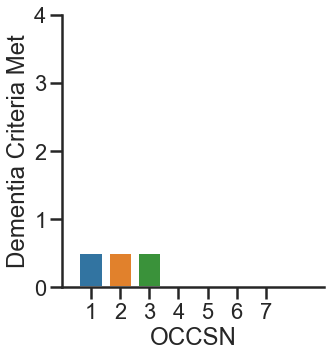

774710


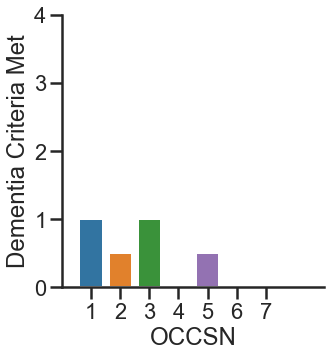

774714


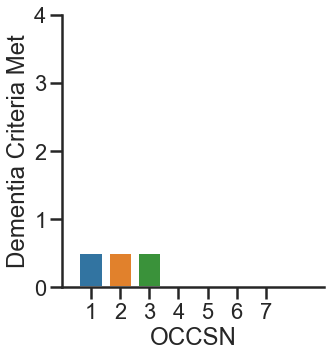

774715


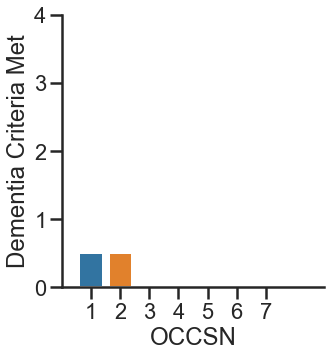

774721


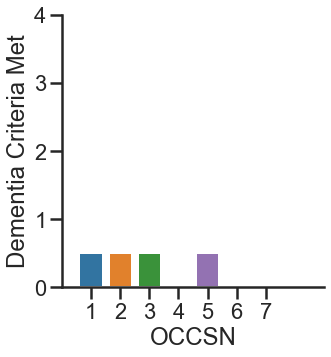

774753


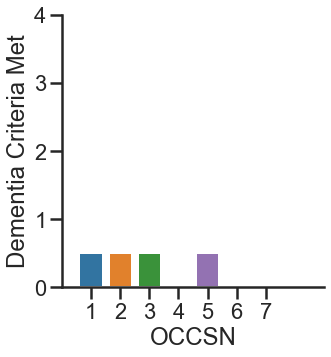

774758


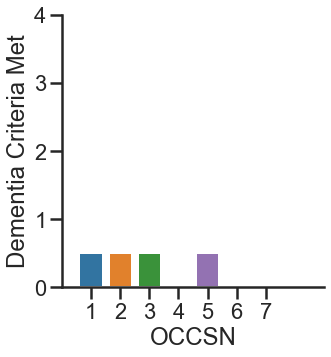

774760


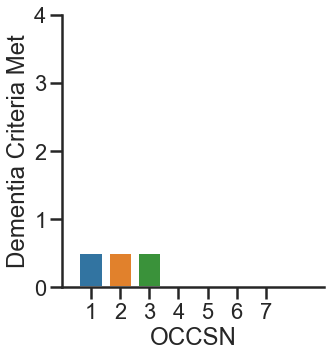

774764


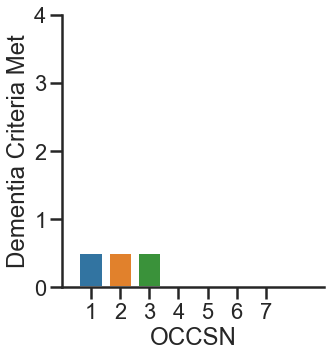

774774


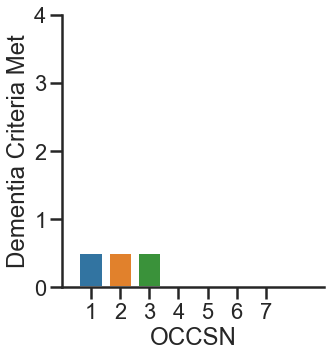

774801


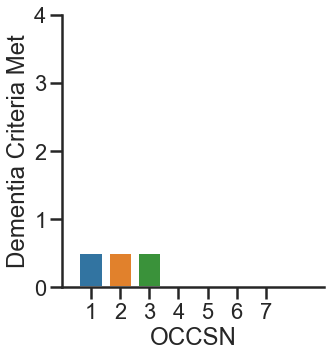

774804


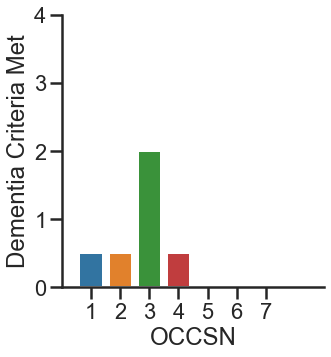

774805


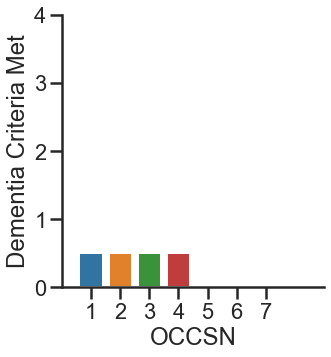

774810


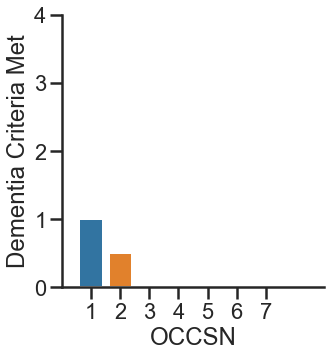

774818


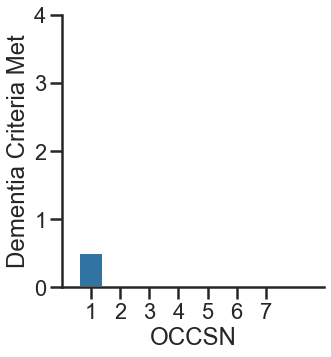

774819


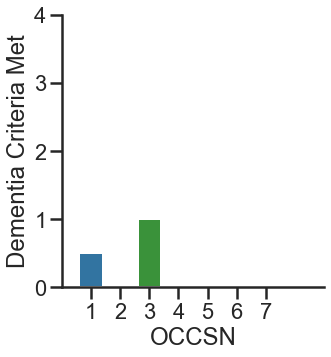

774820


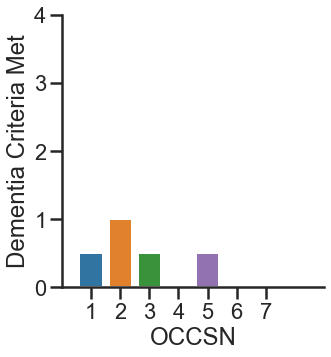

774823


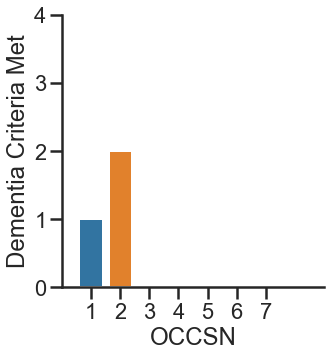

774852


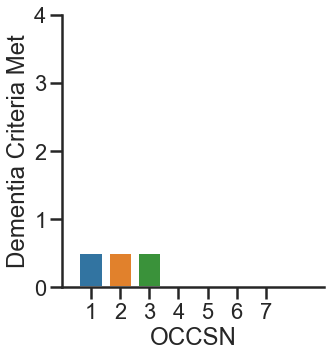

774853


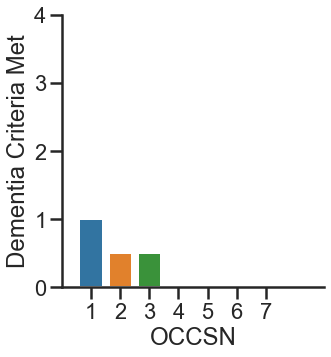

774855


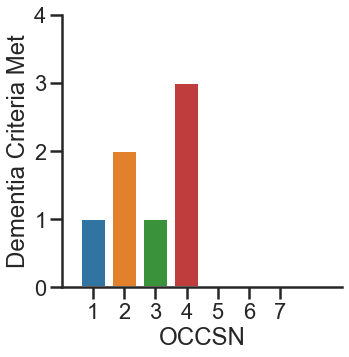

774861


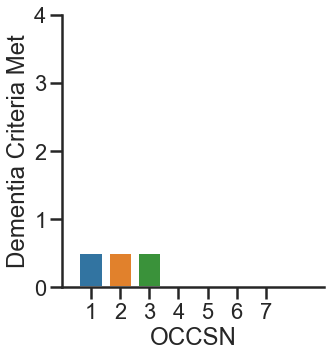

774864


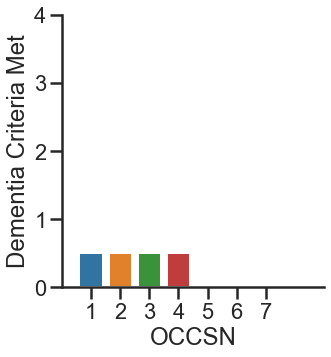

774866


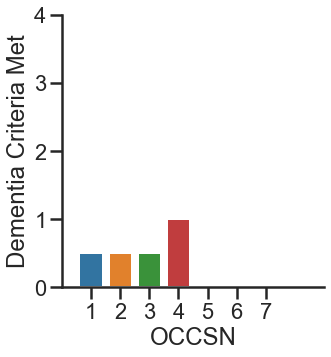

774869


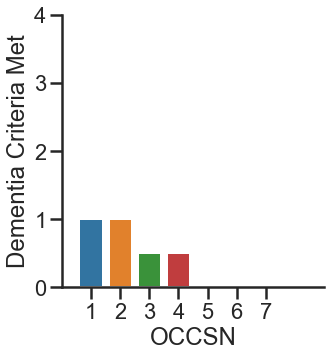

774909


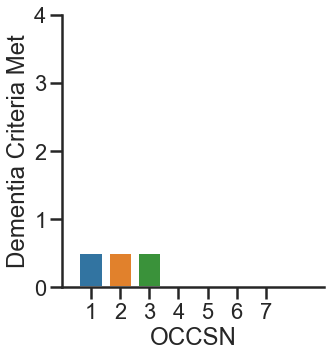

774915


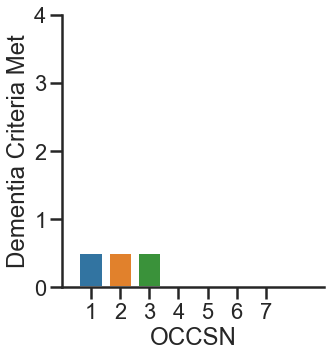

774917


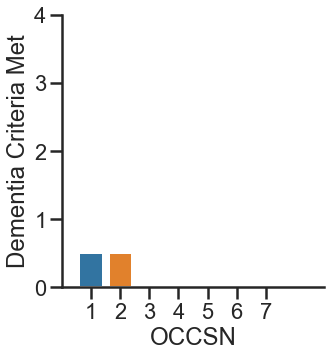

774926


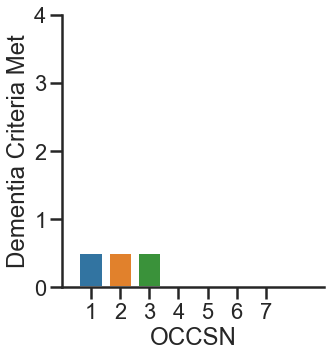

774930


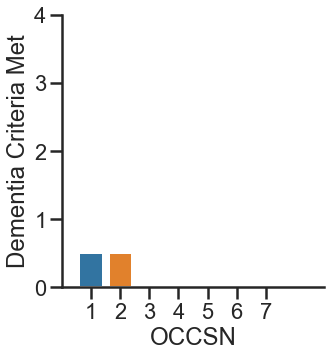

774951


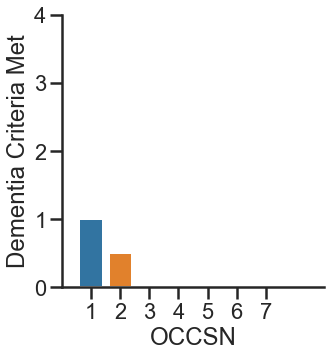

774952


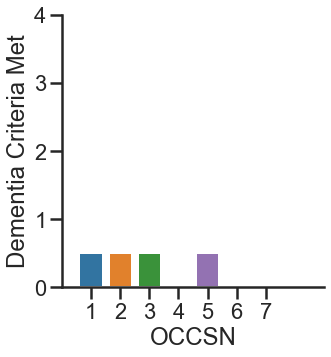

774958


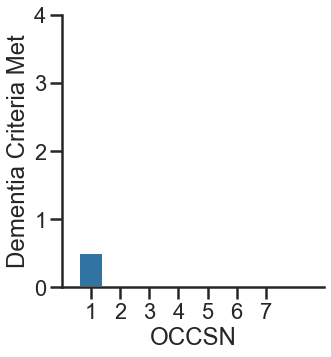

774959


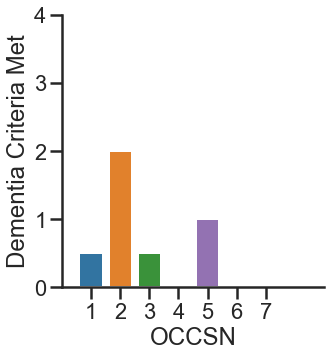

774968


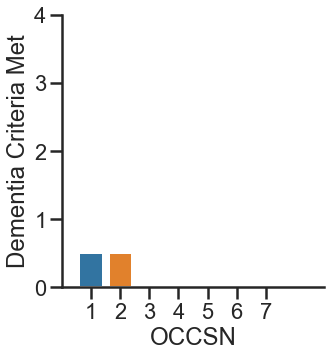

774972


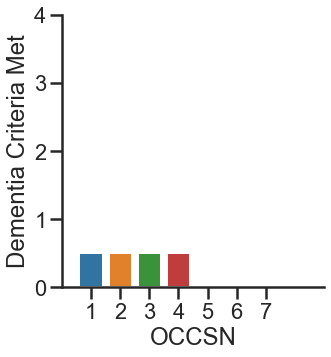

774975


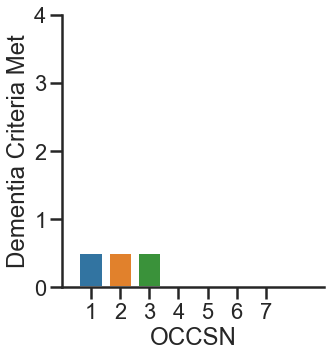

775014


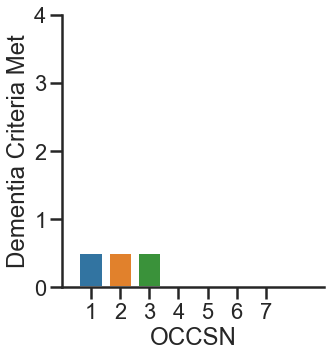

775016


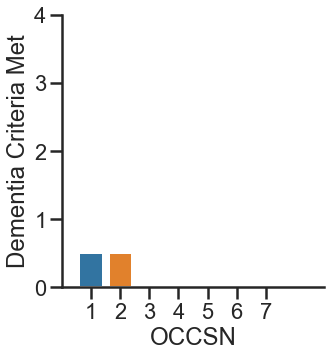

775019


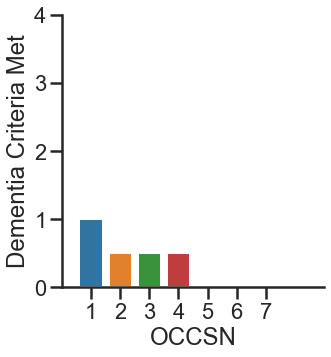

775053


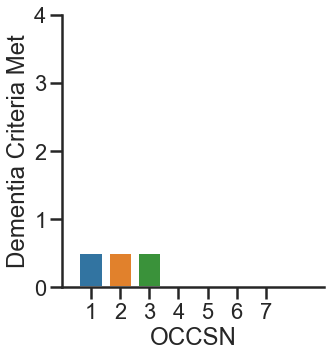

775056


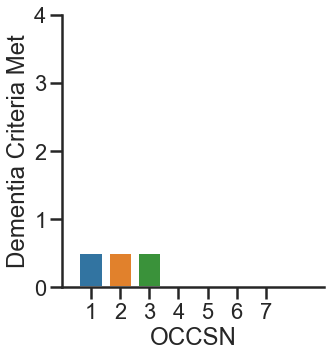

775066


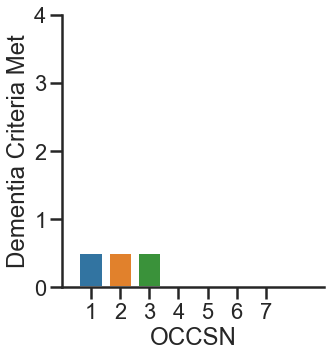

775068


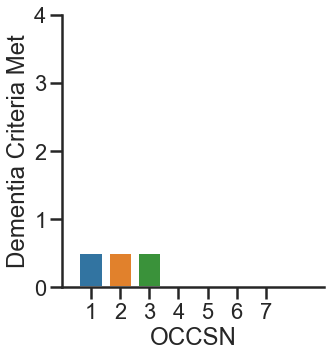

775069


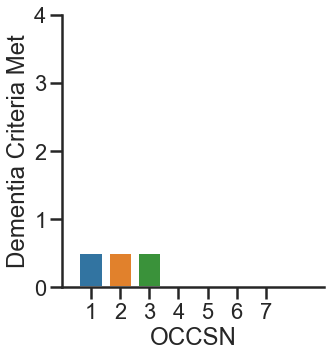

775102


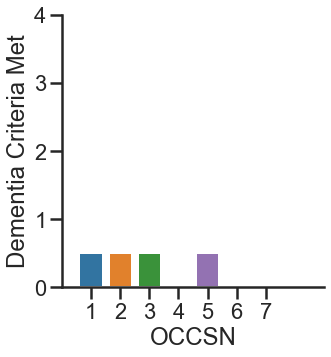

775108


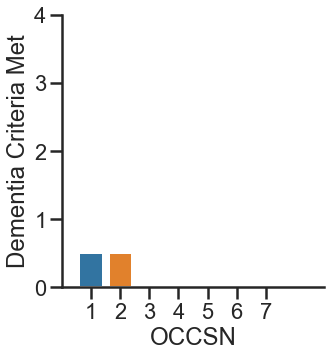

775118


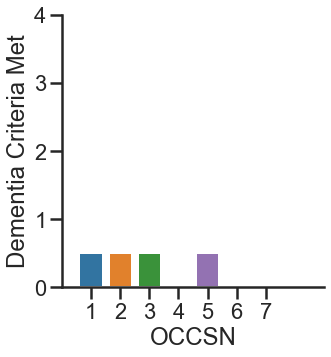

775122


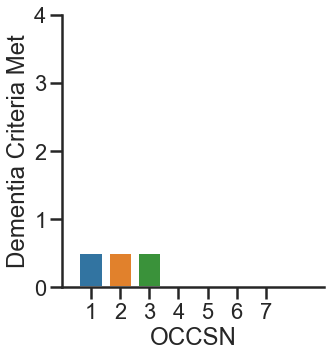

775124


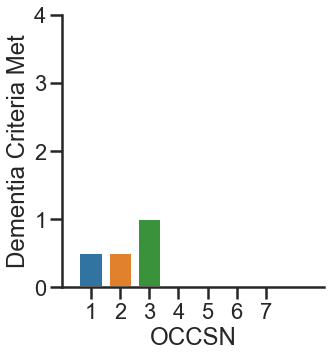

775151


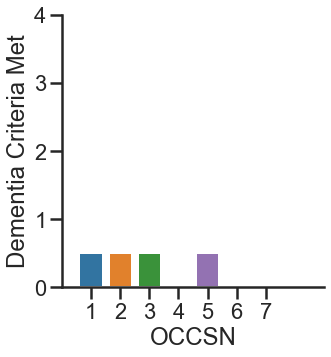

775152


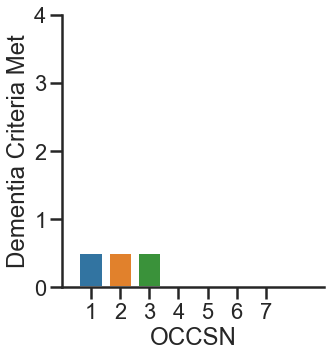

775161


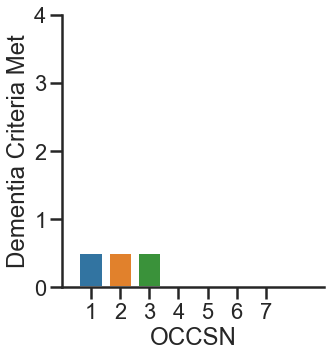

775167


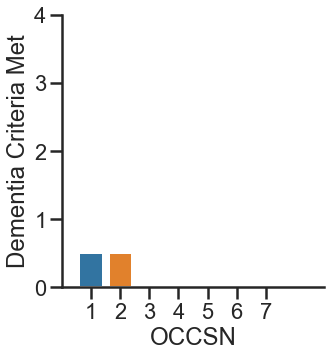

775170


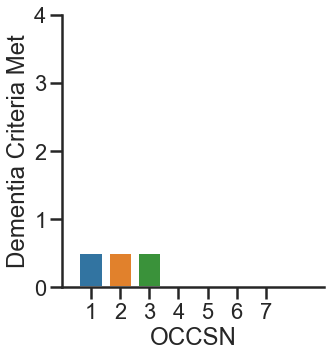

775173


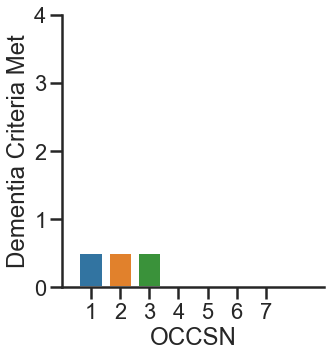

775202


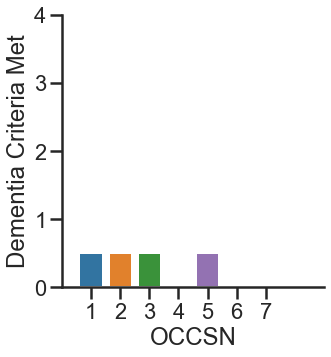

775206


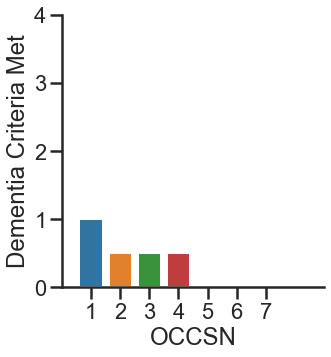

775216


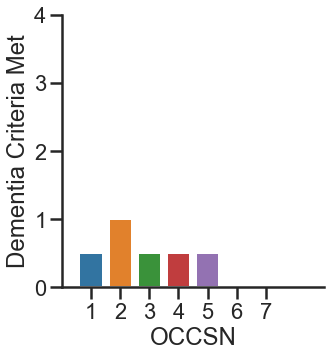

775219


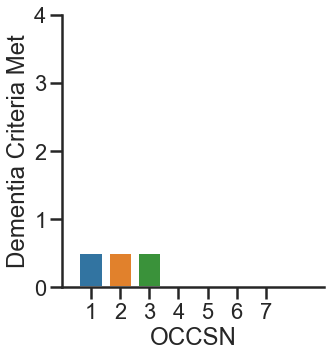

775221


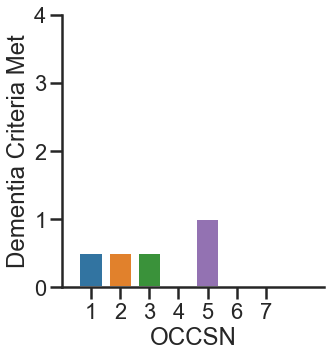

775255


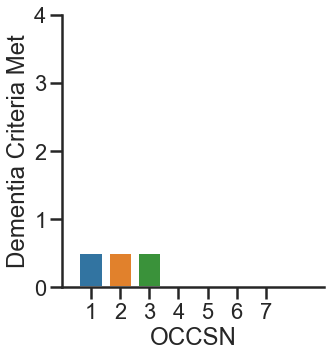

775261


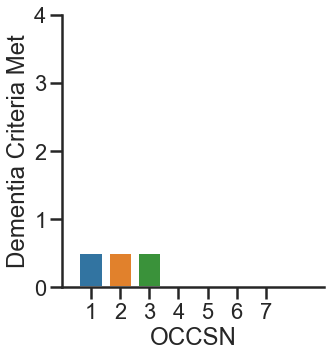

775268


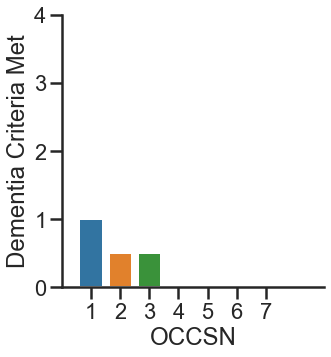

775271


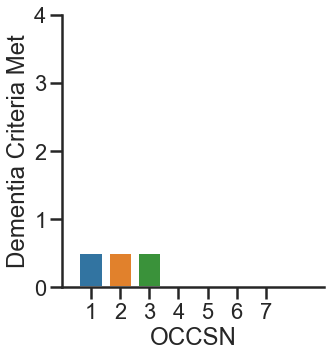

775272


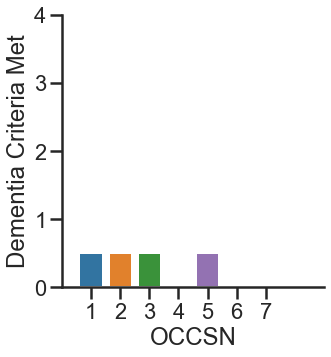

775304


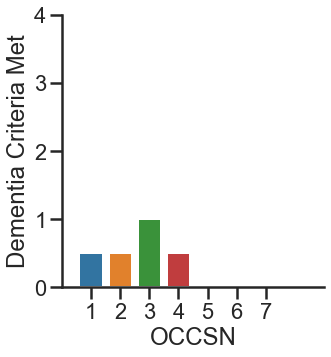

775313


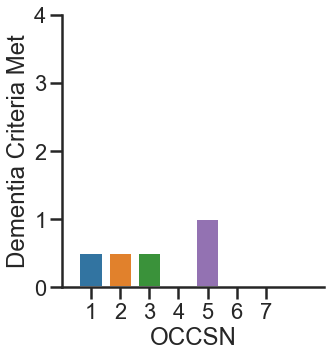

775315


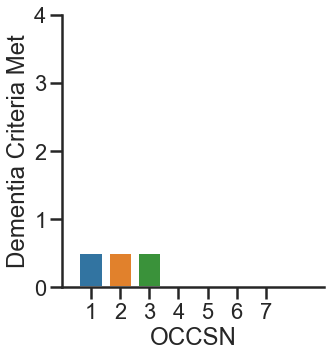

775318


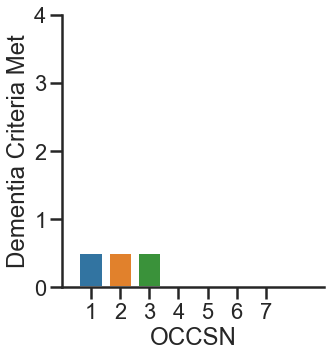

775320


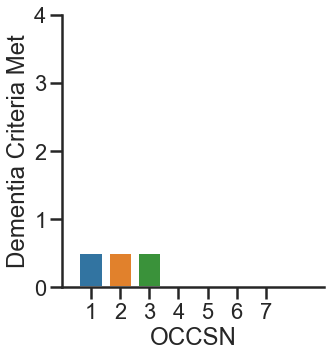

775353


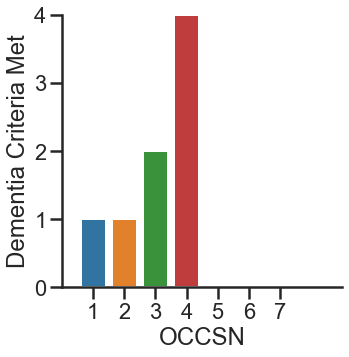

775368


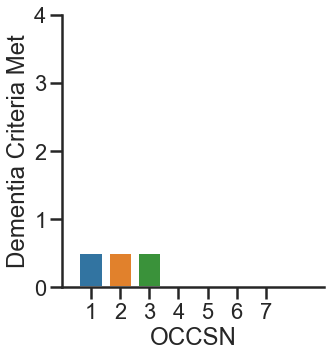

775410


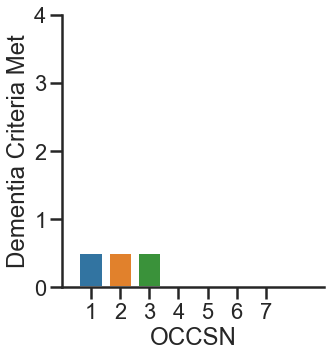

775414


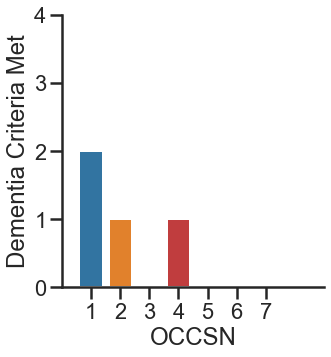

775416


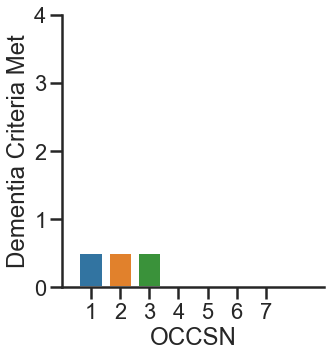

775454


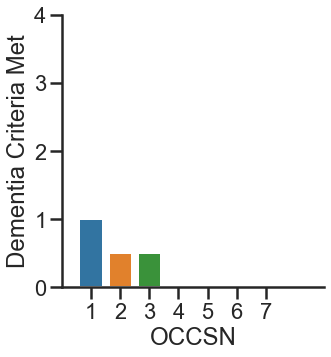

775462


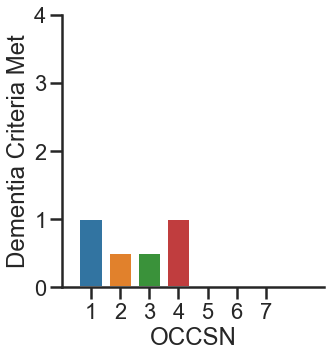

775469


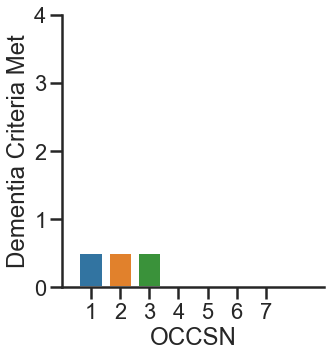

775475


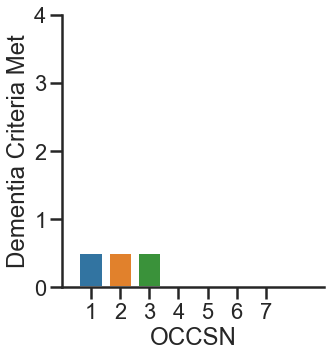

775511


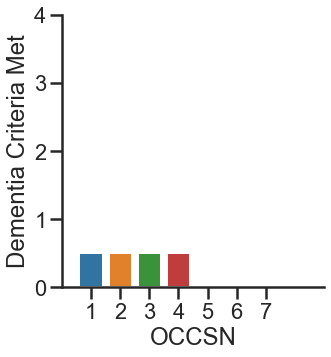

775514


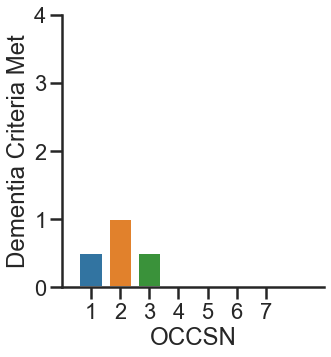

775515


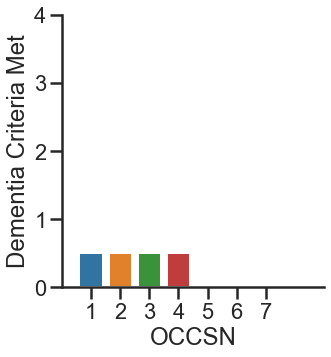

775563


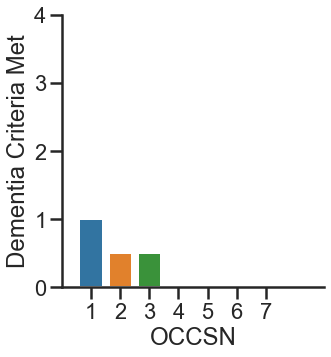

775564


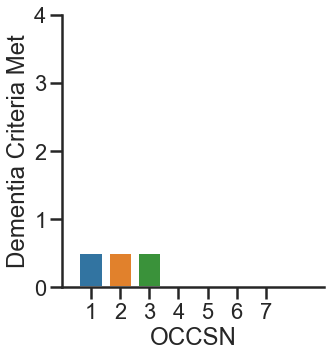

775567


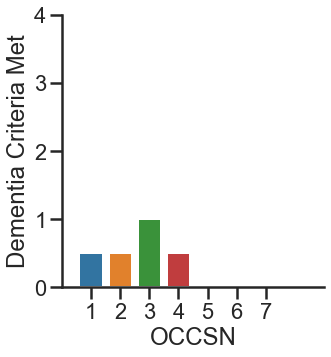

775603


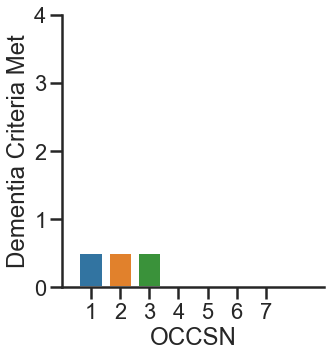

775605


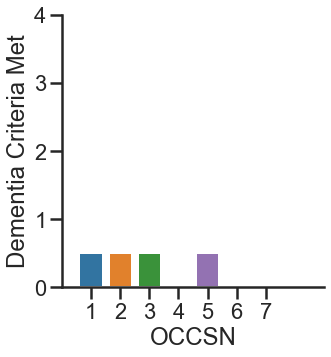

775618


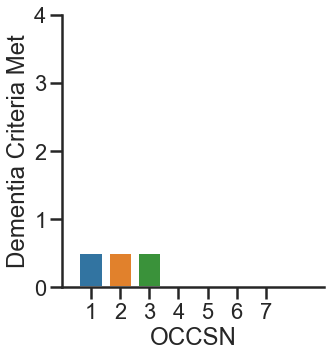

775651


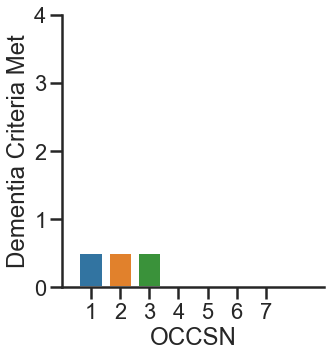

775659


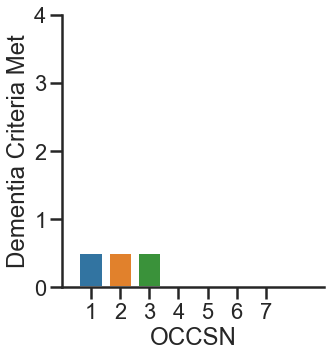

775665


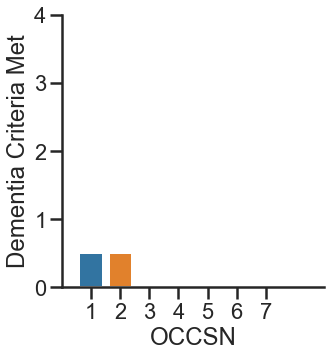

775673


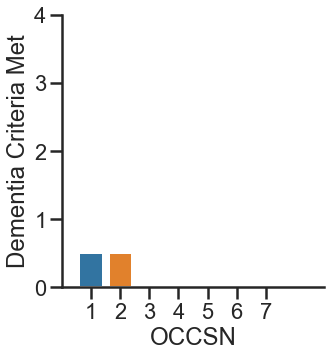

775701


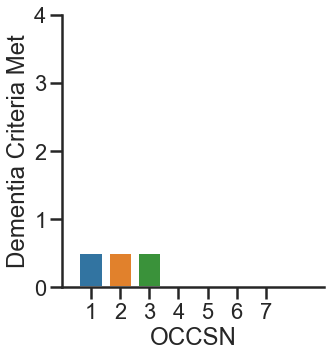

775709


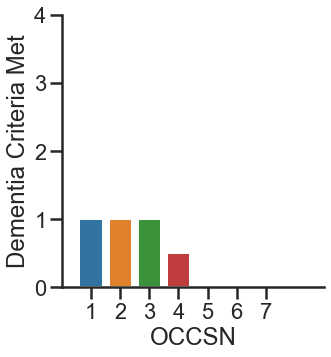

775710


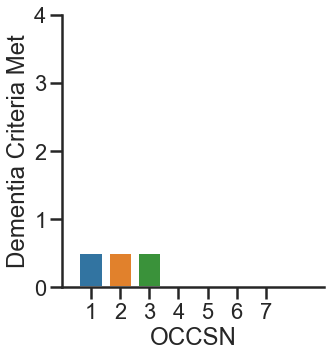

775713


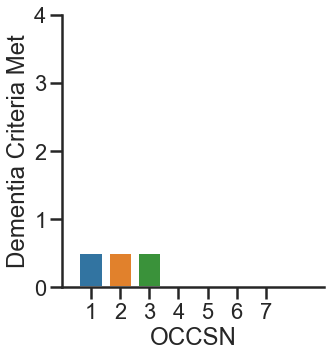

775716


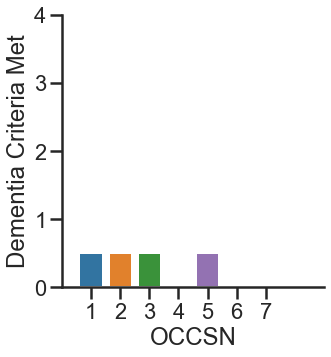

775720


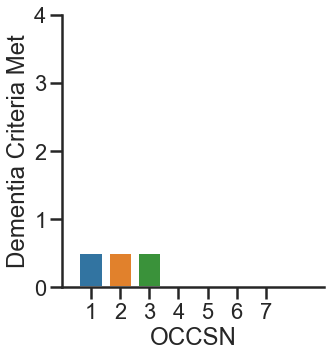

775753


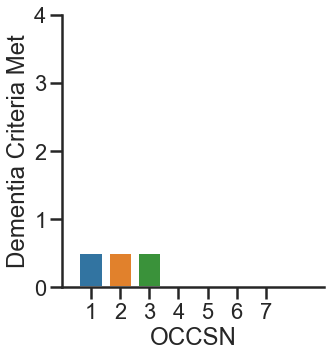

775756


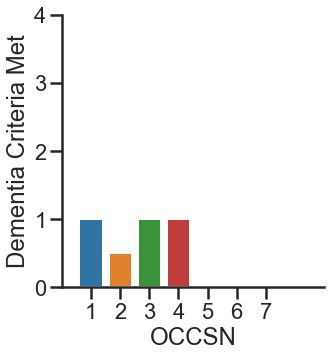

775757


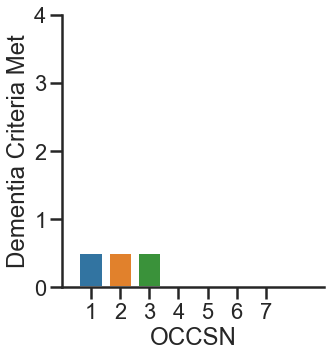

775768


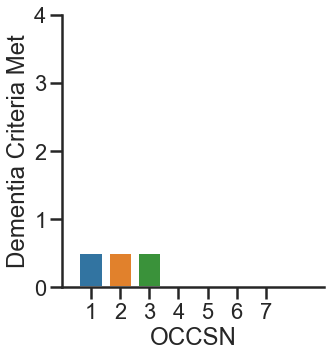

775770


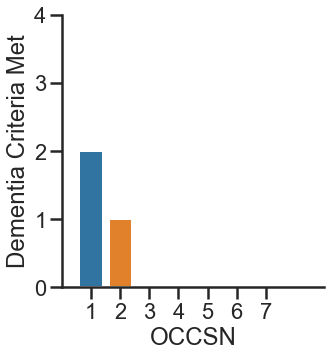

775802


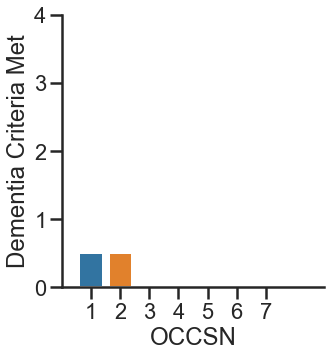

775806


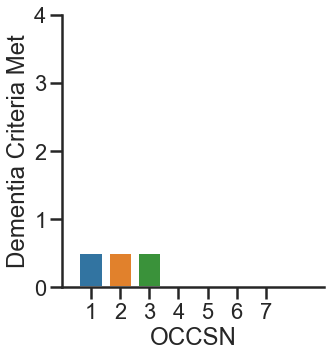

775812


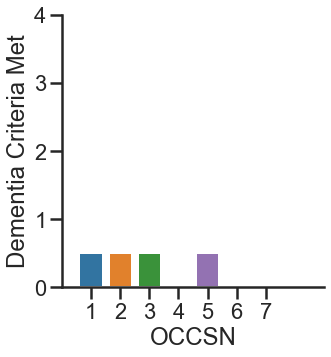

775851


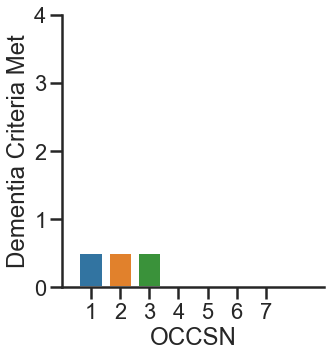

775901


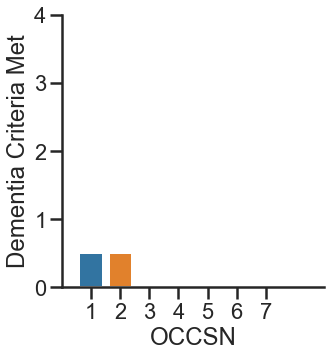

775911


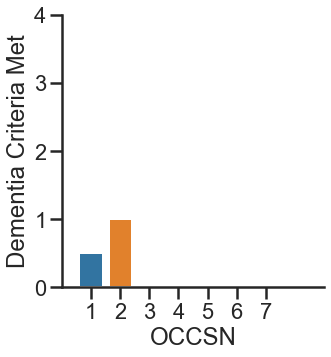

775915


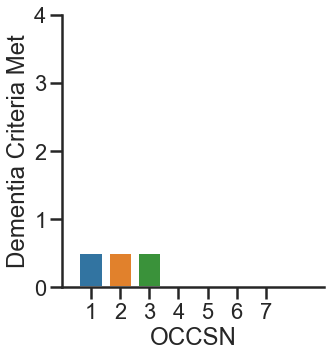

775951


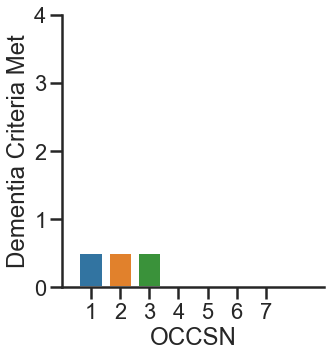

775954


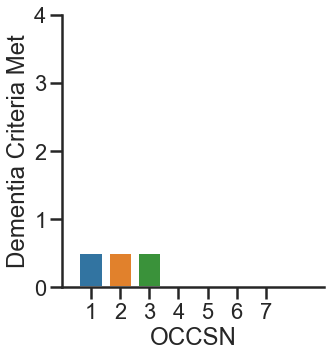

775960


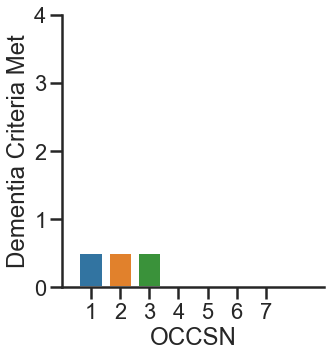

775962


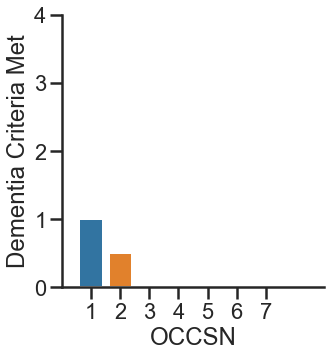

776001


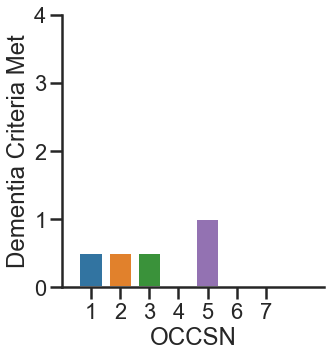

776003


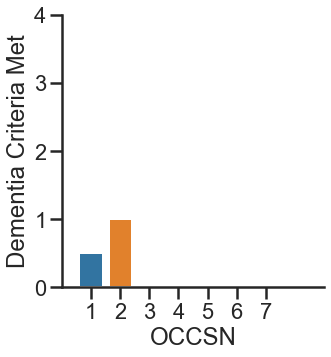

776008


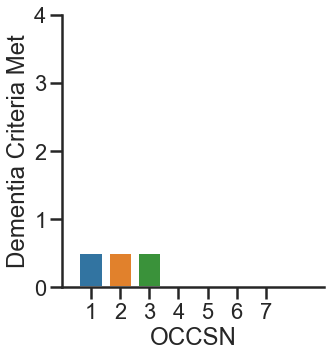

776010


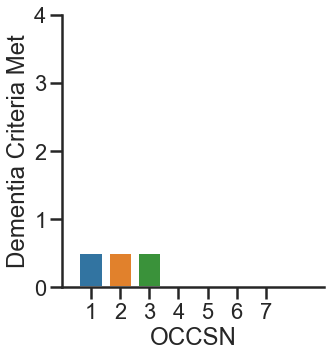

776057


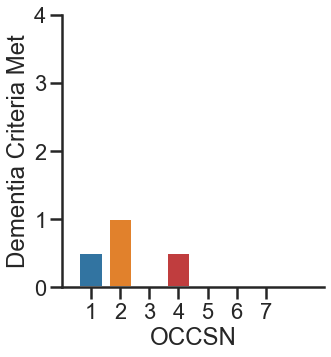

776063


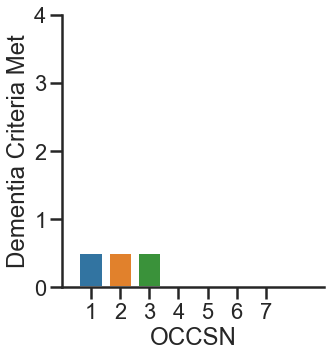

776065


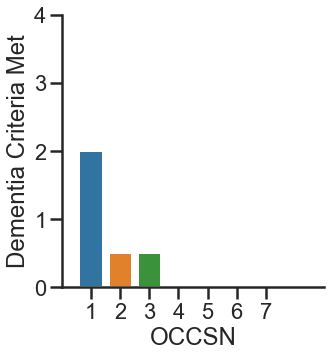

776107


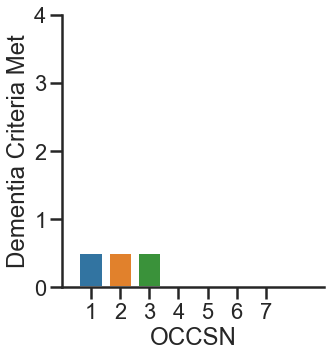

776110


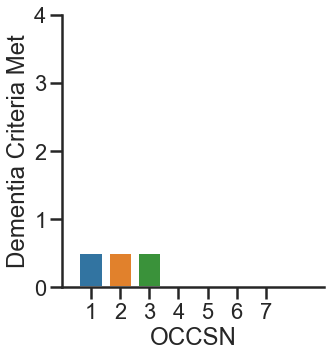

776112


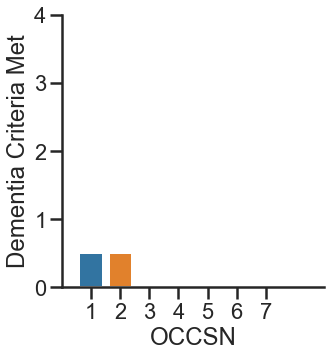

776114


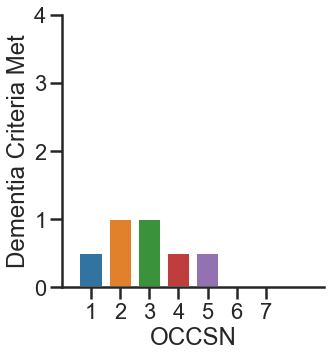

776203


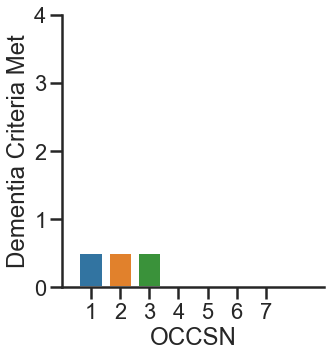

776222


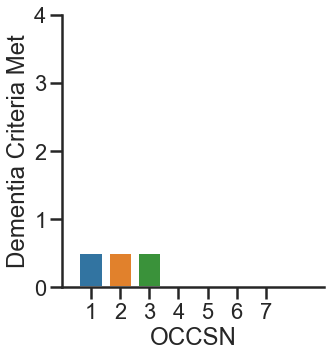

776252


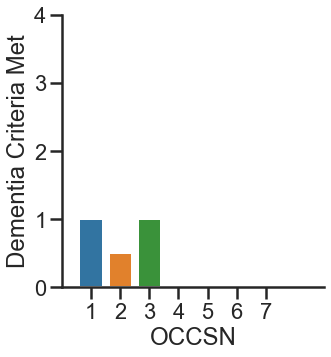

776263


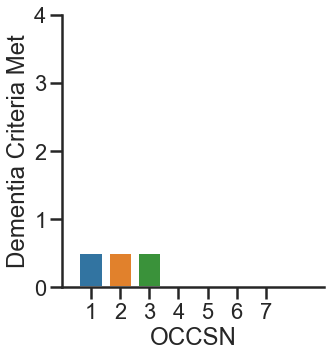

776321


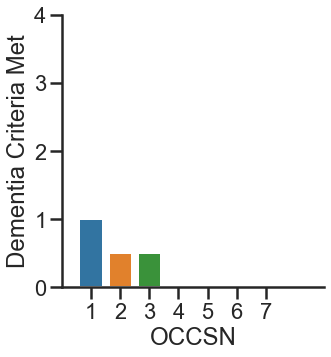

776353


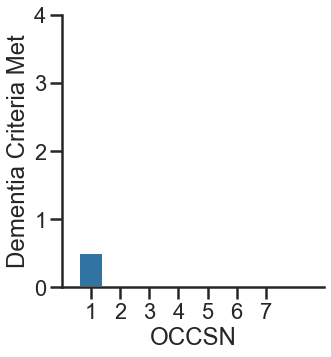

776366


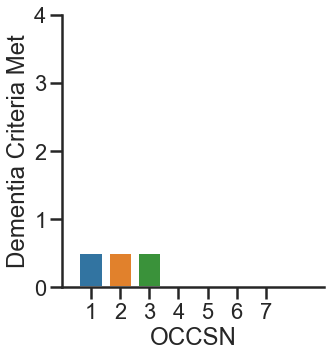

776408


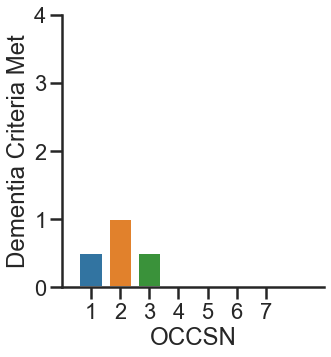

776414


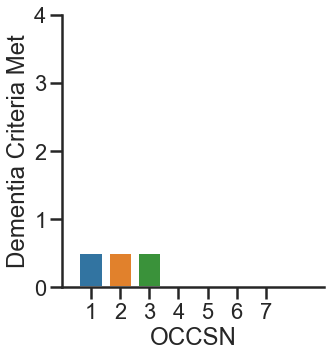

776451


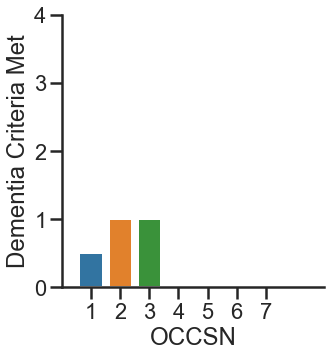

776459


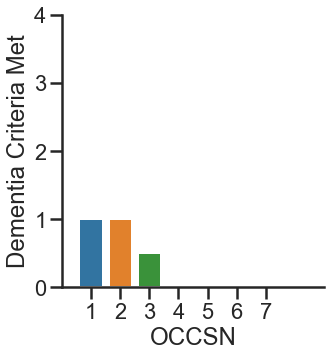

776460


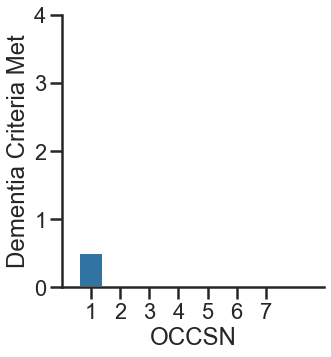

776467


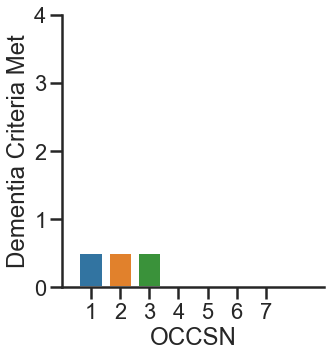

776513


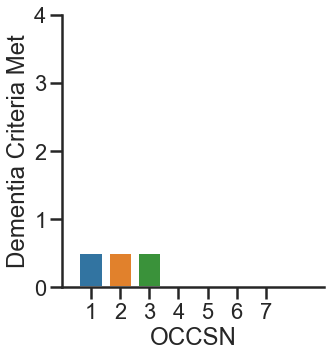

776551


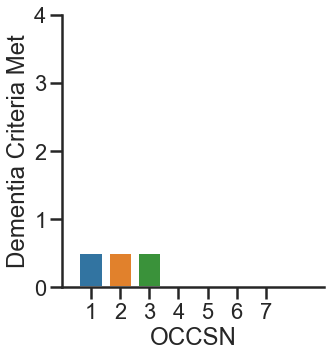

776564


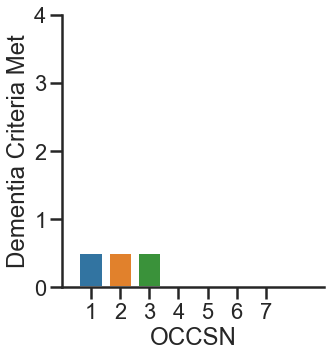

776604


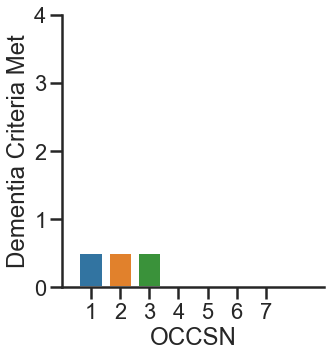

776654


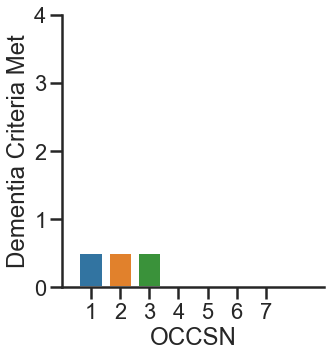

776660


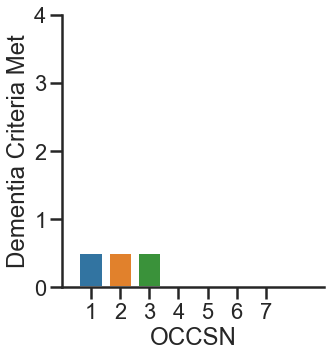

776712


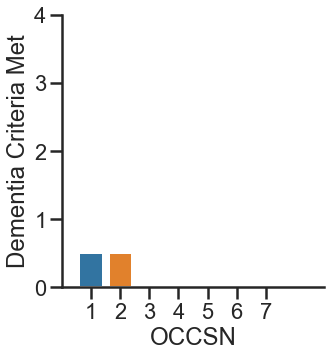

776801


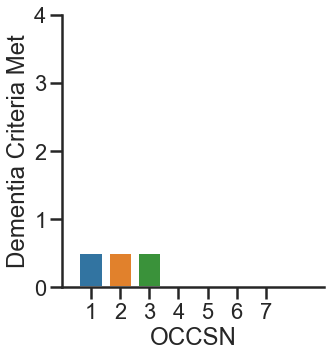

776803


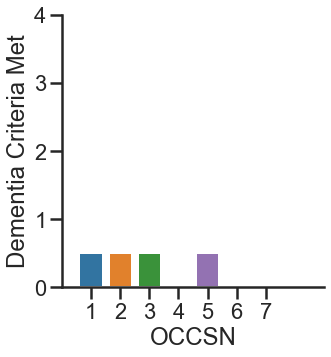

776807


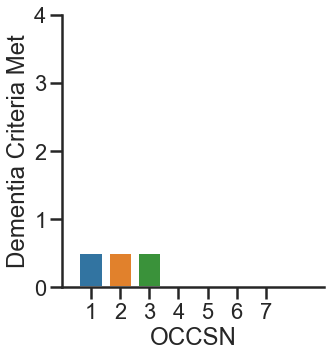

776810


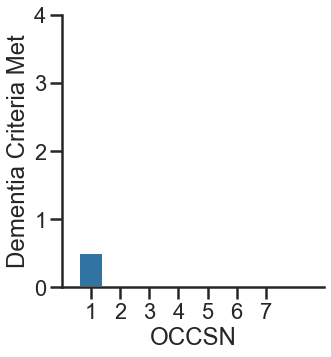

776853


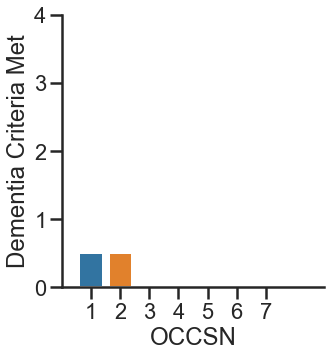

776910


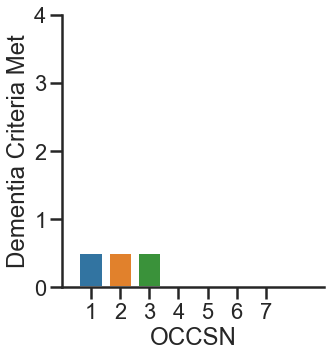

776956


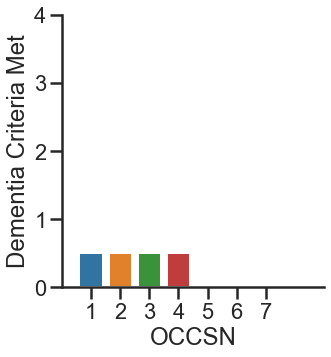

776963


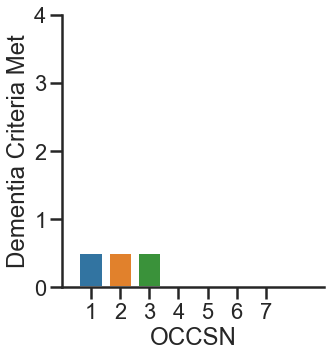

774867


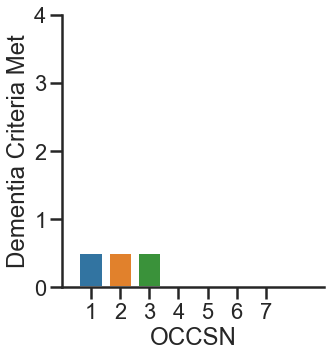

444503


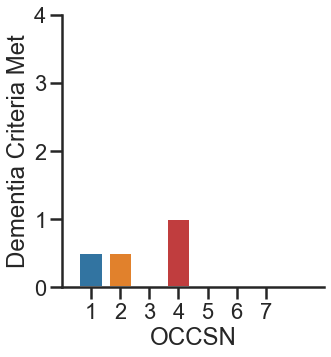

775321


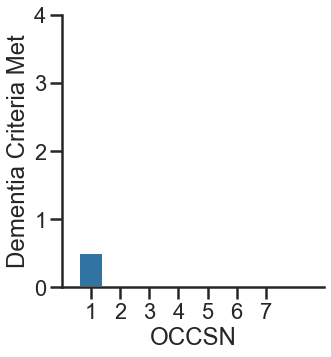

775319


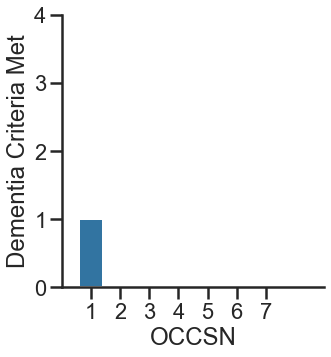

In [180]:
data_int = data.copy()
data_int['Dementia Criteria Met'] = data_int['Dementia Criteria Met'].replace({0:0.5})

for ID in data_int['IDNUM'].unique():
    print(ID)
    d=data_int[data_int['IDNUM'] == ID]
    sns.catplot(x='OCCSN', y='Dementia Criteria Met', data=d, kind='bar', sharex=True, sharey=True)
    plt.xlim([-1,8])
    plt.ylim([0, 4])
    plt.show()

In [9]:
data[data['IDNUM']==775321]
#demogs[demogs['SLS #']==775321]
#sleep[sleep['SLS_ID']==775321]

,IDNUM,OCCSN,OCCSNDT,MMSE TOTAL,MATTIS TOTAL,TRAIL B,WAASV - Vocabulary Age-Scaled Score,WAASC - Comprehension Age-Scaled Score,WAASBD - Block Design Age-Scaled Score,WAASSY Digit-Symbol Age-Scaled Score,Any score ≤ 8 / Lowest Score,Dementia Criteria MMSE ≤ 27,Dementia Criteria MATTIS ≤ 130,Dementia Criteria Trail B ≥ 180,Dementia Criteria WAIS ≤ 8,Dementia Criteria Met,CESD-11 Restlessness,CESD Total Score
3383,775321,1,2014.0,30.0,142.0,65.0,15.0,13.0,14.0,9.0,9.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0
7370,775321,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7371,775321,3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7372,775321,4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7373,775321,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7374,775321,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7375,775321,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## compute age data

In [138]:
#add in birth year from demogs
data_final = data.dropna(subset=['OCCSNDT'], axis=0)
data_final = pd.merge(data_final, demogs[['SLS #', 'BIRTHYR', 'HBQ Median Sleep Duration', 'Average Sleep ', 'COHORT']], left_on=['IDNUM'], right_on=['SLS #'], sort=False)
data_final = data_final.dropna(subset=['OCCSNDT'], axis=0)

#compute age for each occsn 
data_final['test_age'] = data_final['OCCSNDT'] - data_final['BIRTHYR']

print(data.shape)
print(data_final.shape)
data_final.head()

(7728, 18)
(3729, 24)


,IDNUM,OCCSN,OCCSNDT,MMSE TOTAL,MATTIS TOTAL,TRAIL B,WAASV - Vocabulary Age-Scaled Score,WAASC - Comprehension Age-Scaled Score,WAASBD - Block Design Age-Scaled Score,WAASSY Digit-Symbol Age-Scaled Score,Any score ≤ 8 / Lowest Score,Dementia Criteria MMSE ≤ 27,Dementia Criteria MATTIS ≤ 130,Dementia Criteria Trail B ≥ 180,Dementia Criteria WAIS ≤ 8,Dementia Criteria Met,CESD-11 Restlessness,CESD Total Score,SLS #,BIRTHYR,HBQ Median Sleep Duration,Average Sleep,COHORT,test_age
0,111702,1,1997.0,25.0,117.0,121.0,4.0,7.0,10.0,12.0,4.0,1.0,1.0,0.0,1.0,3.0,2.0,17.0,111702,1917,long_sleeper,8.0,5,80.0
1,130596,1,1997.0,29.0,141.0,122.0,11.0,12.0,11.0,9.0,9.0,0.0,0.0,0.0,0.0,0.0,3.0,20.0,130596,1905,short_sleeper,5.0,3,92.0
2,130596,2,2000.0,29.0,140.0,166.0,13.0,10.0,10.0,8.0,8.0,0.0,0.0,0.0,1.0,1.0,3.0,24.0,130596,1905,short_sleeper,5.0,3,95.0
3,134010,1,1997.0,28.0,137.0,104.0,12.0,12.0,10.0,12.0,10.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,134010,1912,medium_sleeper,7.0,4,85.0
4,134016,1,1997.0,28.0,129.0,667.0,10.0,12.0,8.0,6.0,6.0,0.0,1.0,1.0,1.0,3.0,1.0,8.0,134016,1913,medium_sleeper,7.0,4,84.0


## find age where reached dementia criteria (score of 2 and above)


In [183]:
dementia_2 = pd.DataFrame()

for ID in data_final['IDNUM'].unique():
    #print(ID)
    d=data_final[data_final['IDNUM'] == ID].sort_values('OCCSN')
    
    #determine earliest time point when criteria was met
    try:
        dd=d[d['Dementia Criteria Met']>0].sort_values('OCCSN').iloc[0]
        dd['dementia'] = 1
        row = pd.DataFrame(data=dd).T
        
    #if never reached criteria then take age at last visit
    except:
        dd=d.iloc[-1]
        dd['dementia'] = 0
        row = pd.DataFrame(data=dd).T

    if dementia_2.shape[0] < 1:
        dementia_2 = row
    else:
        dementia_2 = pd.concat([dementia_2, row], ignore_index=True)
        
print(dementia_2.shape)
dementia_2.head()

(1104, 25)


,IDNUM,OCCSN,OCCSNDT,MMSE TOTAL,MATTIS TOTAL,TRAIL B,WAASV - Vocabulary Age-Scaled Score,WAASC - Comprehension Age-Scaled Score,WAASBD - Block Design Age-Scaled Score,WAASSY Digit-Symbol Age-Scaled Score,Any score ≤ 8 / Lowest Score,Dementia Criteria MMSE ≤ 27,Dementia Criteria MATTIS ≤ 130,Dementia Criteria Trail B ≥ 180,Dementia Criteria WAIS ≤ 8,Dementia Criteria Met,CESD-11 Restlessness,CESD Total Score,SLS #,BIRTHYR,HBQ Median Sleep Duration,Average Sleep,COHORT,test_age,dementia
0,111702,1,1997,25,117,121,4,7,10,12,4,1,1,0,1,3,2,17,111702,1917,long_sleeper,8,5,80,1
1,130596,2,2000,29,140,166,13,10,10,8,8,0,0,0,1,1,3,24,130596,1905,short_sleeper,5,3,95,1
2,134010,1,1997,28,137,104,12,12,10,12,10,0,0,0,0,0,0,3,134010,1912,medium_sleeper,7,4,85,0
3,134016,1,1997,28,129,667,10,12,8,6,6,0,1,1,1,3,1,8,134016,1913,medium_sleeper,7,4,84,1
4,135003,5,2012,30,138,117,15,16,14,11,11,0,0,0,0,0,1,8,135003,1917,medium_sleeper,7.4,5,95,0


In [184]:
sleep_count = []
sleep_mean = []
sleep_median = []
sleep_std = []
sleep_slope = []

sleep_params = ['1993_sleep', '1998_sleep', '2005_sleep', '2008_sleep', '2012_sleep',]

for index, row in dementia_2.iterrows():
    
    #figure out how many sleep values to keep (only up to/including their dementia yes/no tp)
    if row['OCCSNDT'] >= 2012:
        count = 5
    elif (row['OCCSNDT'] >= 2008) & (row['OCCSNDT'] < 2012):
        count = 4
    elif (row['OCCSNDT'] >= 2005) & (row['OCCSNDT'] < 2008):
        count = 3
    elif (row['OCCSNDT'] >= 1998) & (row['OCCSNDT'] < 2005):
        count = 2
    elif (row['OCCSNDT'] >= 1993) & (row['OCCSNDT'] < 1998):
        count = 1
    elif row['OCCSNDT'] < 1993:
        count = 0
        
    sleep_count.append(count)   

    #compute sleep params 
    d_sleep = sleep[sleep['SLS_ID'] == row['IDNUM']][sleep_params[0:count]].dropna(axis=1)
    sleep_mean.append(d_sleep.mean(axis=1).values[0])
    sleep_median.append(d_sleep.median(axis=1).values[0])
    sleep_std.append(d_sleep.std(axis=1).values[0])
    #sleep_slope.append(stats.linregress(list(d_sleep.values[0]), list(np.arange(0,d_sleep.shape[0])))[0])

    
dementia_2['sleep_count'] = sleep_count
dementia_2['sleep_mean'] = sleep_mean
dementia_2['sleep_median'] = sleep_median
dementia_2['sleep_std'] = sleep_std
#dementia_2['sleep_slope'] = sleep_slope

print(dementia_2.shape)
dementia_2.head()

(1104, 29)


,IDNUM,OCCSN,OCCSNDT,MMSE TOTAL,MATTIS TOTAL,TRAIL B,WAASV - Vocabulary Age-Scaled Score,WAASC - Comprehension Age-Scaled Score,WAASBD - Block Design Age-Scaled Score,WAASSY Digit-Symbol Age-Scaled Score,Any score ≤ 8 / Lowest Score,Dementia Criteria MMSE ≤ 27,Dementia Criteria MATTIS ≤ 130,Dementia Criteria Trail B ≥ 180,Dementia Criteria WAIS ≤ 8,Dementia Criteria Met,CESD-11 Restlessness,CESD Total Score,SLS #,BIRTHYR,HBQ Median Sleep Duration,Average Sleep,COHORT,test_age,dementia,sleep_count,sleep_mean,sleep_median,sleep_std
0,111702,1,1997,25,117,121,4,7,10,12,4,1,1,0,1,3,2,17,111702,1917,long_sleeper,8,5,80,1,1,8.0,8.0,NaN
1,130596,2,2000,29,140,166,13,10,10,8,8,0,0,0,1,1,3,24,130596,1905,short_sleeper,5,3,95,1,2,5.0,5.0,0.000000
2,134010,1,1997,28,137,104,12,12,10,12,10,0,0,0,0,0,0,3,134010,1912,medium_sleeper,7,4,85,0,1,7.0,7.0,NaN
3,134016,1,1997,28,129,667,10,12,8,6,6,0,1,1,1,3,1,8,134016,1913,medium_sleeper,7,4,84,1,1,7.0,7.0,NaN
4,135003,5,2012,30,138,117,15,16,14,11,11,0,0,0,0,0,1,8,135003,1917,medium_sleeper,7.4,5,95,0,5,7.4,7.0,0.547723


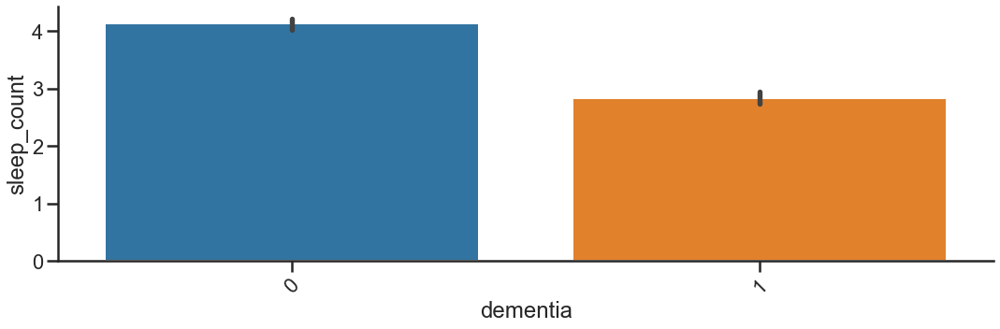

In [185]:
sns.catplot(x='dementia', y='sleep_count', data=dementia_2, kind='bar', height=5, aspect=3)
plt.xticks(rotation = 45)
plt.show()

In [186]:
dementia_2['sleep_group'] = ['short' if x<7 else 'medium' if x==7 else 'long' for x in dementia_2['sleep_median']]

print(dementia_2['HBQ Median Sleep Duration'].value_counts())
print(dementia_2['sleep_group'].value_counts())

medium_sleeper    395
short_sleeper     377
long_sleeper      332
Name: HBQ Median Sleep Duration, dtype: int64
medium    375
short     372
long      357
Name: sleep_group, dtype: int64


In [187]:
dementia_2 = dementia_2.infer_objects()
print(dementia_2.dtypes)

IDNUM                                     int64  
OCCSN                                     int64  
OCCSNDT                                   float64
MMSE TOTAL                                float64
MATTIS TOTAL                              float64
TRAIL B                                   float64
WAASV - Vocabulary Age-Scaled Score       float64
WAASC - Comprehension Age-Scaled Score    float64
WAASBD - Block Design Age-Scaled Score    float64
WAASSY  Digit-Symbol Age-Scaled Score     float64
Any score ≤ 8 / Lowest Score              float64
Dementia Criteria MMSE ≤ 27               float64
Dementia Criteria MATTIS ≤ 130            float64
Dementia Criteria Trail B ≥ 180           float64
Dementia Criteria WAIS ≤ 8                float64
Dementia Criteria Met                     float64
CESD-11 Restlessness                      float64
CESD Total Score                          float64
SLS #                                     int64  
BIRTHYR                                   int64  


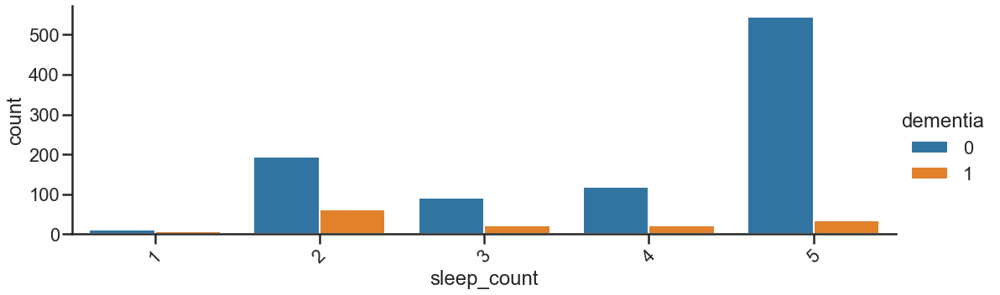

In [128]:
sleep_counts = dementia_2.groupby('sleep_count')['dementia'].value_counts().reset_index(name='count')
sns.catplot(x='sleep_count', y='count', data=sleep_counts, kind='bar', hue='dementia', height=5, aspect=3)
plt.xticks(rotation = 45)
plt.show()

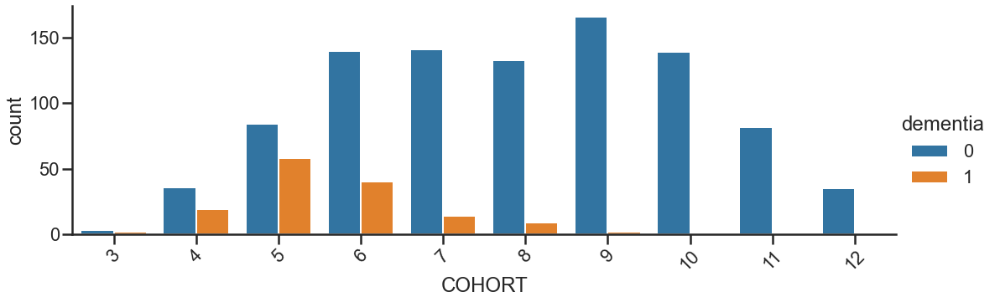

In [129]:
sleep_counts = dementia_2.groupby('COHORT')['dementia'].value_counts().reset_index(name='count')
sns.catplot(x='COHORT', y='count', data=sleep_counts, kind='bar', hue='dementia', height=5, aspect=3)
plt.xticks(rotation = 45)
plt.show()

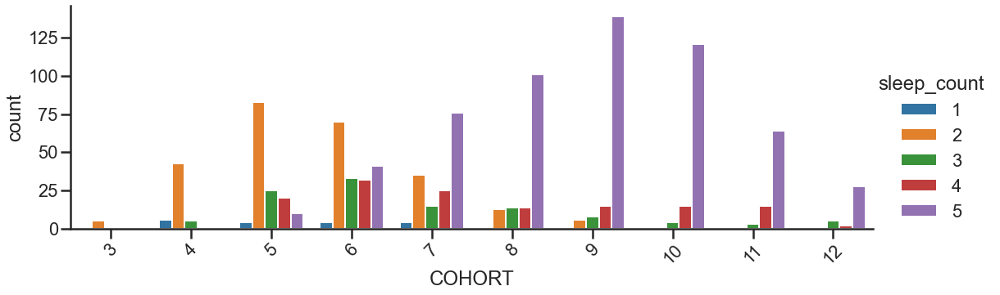

In [130]:
sleep_counts = dementia_2.groupby('COHORT')['sleep_count'].value_counts().reset_index(name='count')
sns.catplot(x='COHORT', y='count', data=sleep_counts, kind='bar', hue='sleep_count', height=5, aspect=3)
plt.xticks(rotation = 45)
plt.show()

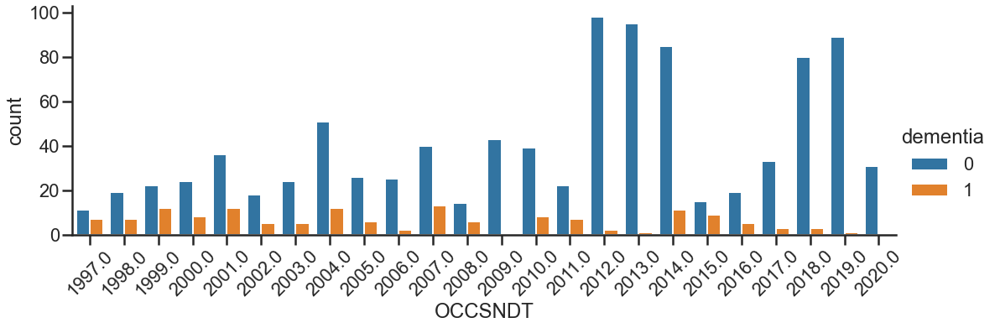

In [131]:
year_counts = dementia_2.groupby('dementia')['OCCSNDT'].value_counts().reset_index(name='count')
sns.catplot(x='OCCSNDT', y='count', data=year_counts, kind='bar', hue='dementia', height=5, aspect=3)
plt.xticks(rotation = 45)
plt.show()

## Survival curves


In [188]:
dementia_2['dementia_bool'] = [True if x == 1 else False for x in dementia_2['dementia']]
dementia_2.head()

,IDNUM,OCCSN,OCCSNDT,MMSE TOTAL,MATTIS TOTAL,TRAIL B,WAASV - Vocabulary Age-Scaled Score,WAASC - Comprehension Age-Scaled Score,WAASBD - Block Design Age-Scaled Score,WAASSY Digit-Symbol Age-Scaled Score,Any score ≤ 8 / Lowest Score,Dementia Criteria MMSE ≤ 27,Dementia Criteria MATTIS ≤ 130,Dementia Criteria Trail B ≥ 180,Dementia Criteria WAIS ≤ 8,Dementia Criteria Met,CESD-11 Restlessness,CESD Total Score,SLS #,BIRTHYR,HBQ Median Sleep Duration,Average Sleep,COHORT,test_age,dementia,sleep_count,sleep_mean,sleep_median,sleep_std,sleep_group,dementia_bool
0,111702,1,1997.0,25.0,117.0,121.0,4.0,7.0,10.0,12.0,4.0,1.0,1.0,0.0,1.0,3.0,2.0,17.0,111702,1917,long_sleeper,8.0,5,80.0,1,1,8.0,8.0,NaN,long,True
1,130596,2,2000.0,29.0,140.0,166.0,13.0,10.0,10.0,8.0,8.0,0.0,0.0,0.0,1.0,1.0,3.0,24.0,130596,1905,short_sleeper,5.0,3,95.0,1,2,5.0,5.0,0.000000,short,True
2,134010,1,1997.0,28.0,137.0,104.0,12.0,12.0,10.0,12.0,10.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,134010,1912,medium_sleeper,7.0,4,85.0,0,1,7.0,7.0,NaN,medium,False
3,134016,1,1997.0,28.0,129.0,667.0,10.0,12.0,8.0,6.0,6.0,0.0,1.0,1.0,1.0,3.0,1.0,8.0,134016,1913,medium_sleeper,7.0,4,84.0,1,1,7.0,7.0,NaN,medium,True
4,135003,5,2012.0,30.0,138.0,117.0,15.0,16.0,14.0,11.0,11.0,0.0,0.0,0.0,0.0,0.0,1.0,8.0,135003,1917,medium_sleeper,7.4,5,95.0,0,5,7.4,7.0,0.547723,medium,False


In [211]:
dementia_22 = dementia_2[dementia_2['sleep_count']>1]
print(dementia_22.shape)

(1071, 31)


Text(0.5, 0, 'Age')

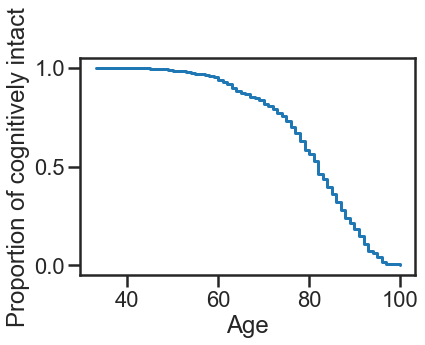

In [212]:
time, survival_prob = kaplan_meier_estimator(dementia_2["dementia_bool"], dementia_2["test_age"])
plt.step(time, survival_prob, where="post")

plt.ylabel("Proportion of cognitively intact")
plt.xlabel("Age")

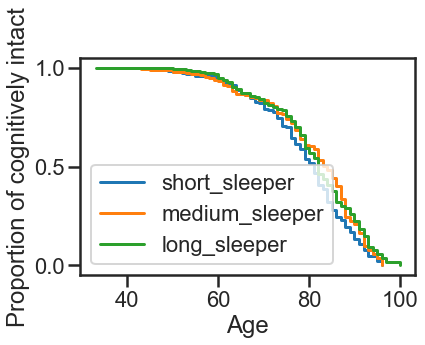

In [213]:
d_int = dementia_22[dementia_22['sleep_group']=='short']
time, survival_prob = kaplan_meier_estimator(d_int["dementia_bool"], d_int["test_age"])
plt.step(time, survival_prob, where="post", label="short_sleeper")

d_int = dementia_22[dementia_22['sleep_group']=='medium']
time, survival_prob = kaplan_meier_estimator(d_int["dementia_bool"], d_int["test_age"])
plt.step(time, survival_prob, where="post", label="medium_sleeper")

d_int = dementia_22[dementia_22['sleep_group']=='long']
time, survival_prob = kaplan_meier_estimator(d_int["dementia_bool"], d_int["test_age"])
plt.step(time, survival_prob, where="post", label="long_sleeper")

plt.ylabel("Proportion of cognitively intact")
plt.xlabel("Age")
plt.legend(loc="best")

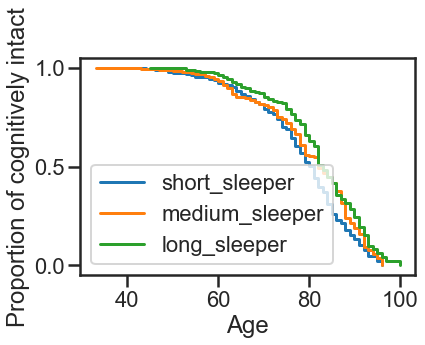

In [214]:
d_int = dementia_22[dementia_22['HBQ Median Sleep Duration']=='short_sleeper']
time, survival_prob = kaplan_meier_estimator(d_int["dementia_bool"], d_int["test_age"])
plt.step(time, survival_prob, where="post", label="short_sleeper")

d_int = dementia_22[dementia_22['HBQ Median Sleep Duration']=='medium_sleeper']
time, survival_prob = kaplan_meier_estimator(d_int["dementia_bool"], d_int["test_age"])
plt.step(time, survival_prob, where="post", label="medium_sleeper")

d_int = dementia_22[dementia_22['HBQ Median Sleep Duration']=='long_sleeper']
time, survival_prob = kaplan_meier_estimator(d_int["dementia_bool"], d_int["test_age"])
plt.step(time, survival_prob, where="post", label="long_sleeper")

plt.ylabel("Proportion of cognitively intact")
plt.xlabel("Age")
plt.legend(loc="best")

In [215]:
y_array = Surv.from_dataframe('dementia_bool', 'test_age', dementia_22)
compare_survival(y=y_array, group_indicator=dementia_22['sleep_group'], return_stats=True)

(5.832926818323346,
 0.05412476636982322,
         counts  observed    expected  statistic
 group                                          
 long    342     192       204.813311 -12.813311
 medium  366     159       169.789945 -10.789945
 short   363     164       140.396744  23.603256,
 array([[113.8139943 , -62.38815571, -51.4258386 ],
        [-62.38815571, 106.47627432, -44.08811862],
        [-51.4258386 , -44.08811862,  95.51395721]]))

In [216]:
y_array = Surv.from_dataframe('dementia_bool', 'test_age', dementia_22)
compare_survival(y=y_array, group_indicator=dementia_22['HBQ Median Sleep Duration'], return_stats=True)

(12.265615000657181,
 0.0021704787788995854,
                 counts  observed    expected  statistic
 group                                                  
 long_sleeper    316     169       200.365061 -31.365061
 medium_sleeper  385     175       173.658046  1.341954 
 short_sleeper   370     171       140.976893  30.023107,
 array([[112.24088277, -62.12779419, -50.11308859],
        [-62.12779419, 107.6910786 , -45.56328442],
        [-50.11308859, -45.56328442,  95.676373  ]]))

In [ ]:
d=data[data['IDNUM'] == 101910]
d=d[d['Dementia Criteria Met']>1].sort_values('OCCSN').iloc[0]
d

In [ ]:
data.dropna(axis=0).groupby('IDNUM')['OCCSN'].count().sort_value

In [ ]:
path_data = '/Users/abbieschindler/Documents/Schindler_Lab/Data/Clinical projects/SLS/SLS_data.xlsx'

whole_file = pd.ExcelFile(path_data)
#get list of sheet names in file
print(whole_file.sheet_names, '\n')

In [ ]:
for sheet in whole_file.sheet_names:
    print(sheet)
    
    data_sheet = pd.DataFrame(data = pd.read_excel(whole_file, sheet))
    print(data_sheet.shape)
    print(data_sheet.columns.values, '\n')

In [ ]:
final_data = pd.DataFrame()

sheets = ['demogs', 'sleep', 'depression', 'bmi_dia', 'blood_pressure', 'cognition', 'smoking', 'alcohol', 'autopsy'] 

for sheet in sheets:
    
    print('Sheet being processed:\n', sheet)
    
    #create intermediate dataframe
    data_sheet = pd.DataFrame(data = pd.read_excel(whole_file, sheet))
    print(data_sheet.shape)

    if final_data.shape[0] < 1:
        final_data = data_sheet
    else:
        final_data = pd.merge(final_data, data_sheet, how='left', on=['SLS_ID'], sort=False)
        
print(final_data.shape)
final_data.head()

In [ ]:
final_data = final_data.replace({-888: np.nan, 'Not Recorded': np.nan, -999: np.nan, ' .': np.nan, '.': np.nan})
final_data.head()

In [ ]:
final_data['WAASV_sum'] = final_data[['WAASV - Vocabulary Age-Scaled Score', 'WAASC - Comprehension Age-Scaled Score',
                              'WAASBD - Block Design Age-Scaled Score', 'WAASSY  Digit-Symbol Age-Scaled Score']].sum(axis=1)
final_data['WAASV_mean'] = final_data[['WAASV - Vocabulary Age-Scaled Score', 'WAASC - Comprehension Age-Scaled Score',
                              'WAASBD - Block Design Age-Scaled Score', 'WAASSY  Digit-Symbol Age-Scaled Score']].mean(axis=1)

In [ ]:
sns.regplot(x='Dementia Criteria Met', y='WAASV_mean', ci=68, data=final_data)

## create moments and update categorical

In [ ]:
final_data['sleep_count'] = final_data[['1993_sleep', '1998_sleep', '2005_sleep', '2008_sleep', '2012_sleep',]].count(axis=1)

In [ ]:
final_data['sleep_count'].value_counts()

In [ ]:
sns.catplot(x='sleep_group', y='sleep_count', kind='bar', ci=68, data=final_data, height=5, aspect=2)

In [ ]:
sns.catplot(x='dementia', y='sleep_count', kind='bar', ci=68, data=final_data, height=5, aspect=2)

In [ ]:
final_data_moments = final_data[final_data['sleep_count']>2]
print(final_data_moments.shape)
final_data_moments.head()

In [ ]:
sleep_first = []
sleep_last = []
mean = []
median = []
std = []
slope = []


sleep_params = ['1993_sleep', '1998_sleep', '2005_sleep', '2008_sleep', '2012_sleep',]

for index, row in final_data_moments.iterrows():

    sleep_first.append(row[sleep_params].dropna()[0])
    sleep_last.append(row[sleep_params].dropna()[-1])
    mean.append(row[sleep_params].dropna().mean())
    std.append(row[sleep_params].dropna().std())
    median.append(row[sleep_params].dropna().median())
    slope.append(stats.linregress(list(row[sleep_params].dropna().values), list(np.arange(0,row[sleep_params].dropna().shape[0])))[0])

final_data_moments['sleep_first'] = sleep_first
final_data_moments['sleep_last'] = sleep_last
final_data_moments['sleep_mean'] = mean
final_data_moments['sleep_median'] = median
final_data_moments['sleep_std'] = std
final_data_moments['sleep_slope'] = slope

final_data_moments['sleep_slope'] = final_data_moments['sleep_slope'].replace({np.nan:0})

print(final_data_moments.shape)
final_data_moments.head()

In [ ]:
sns.pairplot(final_data_moments[['CERAD SCORE', 'BRAAK', 'sleep_first', 'sleep_mean', 'sleep_median', 'sleep_std',
       'sleep_slope', 'sleep_last']], kind="reg")

## cluster 

In [ ]:
final_data_moments[['age_last', 'Dementia Criteria Met', 'Education', 'APOE',  'GENDER', 'Ethnicity', 'dep_med', 'sleep_group',
                              'sleep_first', 'sleep_last', 'sleep_mean', 'sleep_median', 'sleep_std', 'sleep_slope', 
                              'MMSE TOTAL', 'MATTIS TOTAL', 'TRAIL B', 'WAASV_sum', 'WAASV_mean',
                              'WAASV - Vocabulary Age-Scaled Score', 'WAASC - Comprehension Age-Scaled Score',
                              'WAASBD - Block Design Age-Scaled Score', 'WAASSY  Digit-Symbol Age-Scaled Score',
                    'dep11_last', 'dep_last', 'dep11_med', 
                             ]].info()

In [ ]:
cluster = final_data_moments[['age_last', 'Dementia Criteria Met', 'Education', 'APOE',  'GENDER', 'Ethnicity', 'dep_med', 'sleep_group',
                              'sleep_first', 'sleep_last', 'sleep_mean', 'sleep_median', 'sleep_std', 'sleep_slope', 
                              'MMSE TOTAL', 'MATTIS TOTAL', 'TRAIL B', 'WAASV_sum', 'WAASV_mean',
                              'WAASV - Vocabulary Age-Scaled Score', 'WAASC - Comprehension Age-Scaled Score',
                              'WAASBD - Block Design Age-Scaled Score', 'WAASSY  Digit-Symbol Age-Scaled Score',
                    'dep11_last', 'dep_last', 'dep11_med', 
                             ]].dropna(axis=0)

print(cluster.shape)
cluster.head()

In [ ]:
cluster['APOE'] = [1 if '4' in x.split('/') else 0 for x in  cluster['APOE']]
#cluster['dementia'] = [1 if x=='Yes' else 0 for x in  cluster['dementia']]

In [ ]:
sleep_cluster = cluster[['sleep_median', 'sleep_std', 'sleep_slope']]

# center and scale the data
scaler = StandardScaler()
#scaler = RobustScaler()

sleep_cluster_scaled = scaler.fit_transform(sleep_cluster)

In [ ]:
data = sleep_cluster_scaled

#pick cluster number based on silhouette coefficient
k_range = range(2,9)

base_scores = []
sil_scores = []
db_scores = []
ch_scores = []
mse_scores = []

for k in k_range:
    km_ss = KMeans(n_clusters=k, random_state=39)
    km_ss.fit(data)
    
    base_scores.append(-km_ss.score(data))
    sil_scores.append(metrics.silhouette_score(data, km_ss.labels_))
    db_scores.append(metrics.davies_bouldin_score(data, km_ss.labels_))
    ch_scores.append(metrics.calinski_harabasz_score(data, km_ss.labels_))
    mse_scores.append(km_ss.inertia_)
    

# plot the results
plt.plot(k_range, sil_scores)
plt.title('K means clustering')
plt.xlabel('Number of clusters')
plt.ylabel('Silhouette Coefficient')
plt.show()

# plot the results
plt.plot(k_range, db_scores)
plt.title('AUDIT-C Questions K means clustering')
plt.xlabel('Number of clusters')
plt.ylabel('Davies Bouldin Score')
plt.show()

# plot the results
plt.plot(k_range, ch_scores)
plt.title('K means clustering')
plt.xlabel('Number of clusters')
plt.ylabel('Calinski Harabasz Score')
plt.show()
    
# plot the results
plt.plot(k_range, mse_scores)
plt.title('K means clustering')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

In [ ]:
#viz dendrogram to find if three clusters makes sense
plt.figure(figsize=(10, 7))  
plt.title("Sleep Dendrogram")  
plt.ylabel("Distance (dissimilarity)")
plt.xlabel("Participants")
dend = shc.dendrogram(shc.linkage(sleep_cluster_scaled, method='ward'), 
                      distance_sort='ascending',
                      show_leaf_counts=True, leaf_font_size=8)

In [ ]:
#choose k=3 clusters and fit data
km_3 = KMeans(n_clusters=4,random_state=99)
km_3.fit(sleep_cluster_scaled)

cluster['kmeans_cluster'] = ["cluster_" + str(label) for label in km_3.labels_ ]
print(cluster.shape)
cluster.head(1)

In [ ]:
cluster.groupby('kmeans_cluster')['Dementia Criteria Met'].value_counts()

In [ ]:
for col in cluster.columns.values:
    print(col)
    try:
        sns.catplot(x='kmeans_cluster', y=col, kind='bar', ci=68, data=cluster, height=5, aspect=2, order=['cluster_0', 'cluster_1', 'cluster_2', 'cluster_3'])
        plt.show()
    except:
        print('no')

## predict 

In [ ]:
predict = final_data_moments[['dementia', 'Education', 'APOE', 'Age at Death', 'GENDER', 'Ethnicity', 
                    'dep_med', 'sleep_std', 'sleep_slope', 'sleep_ave', 'sleep_first',
                             'sleep_group', 'CERAD SCORE', 'BRAAK',]].dropna(axis=0)

print(predict.shape)
predict.head()

In [ ]:
predict['GENDER'].value_counts()

## dementia binary

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold, StratifiedKFold, GroupKFold, train_test_split, cross_val_score, cross_val_predict, GridSearchCV, RandomizedSearchCV
from sklearn import metrics
from sklearn.metrics import auc, accuracy_score, confusion_matrix, roc_auc_score

from sklearn.dummy import DummyClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.svm import SVC, LinearSVC 
from sklearn.neighbors import KNeighborsClassifier 
import xgboost as xgb

from sklearn.feature_selection import RFECV

import shap
# load JS visualization code to notebook
shap.initjs()

In [ ]:
predict['APOE'] = [1 if '4' in x.split('/') else 0 for x in  predict['APOE']]
predict['dementia'] = [1 if x=='Yes' else 0 for x in  predict['dementia']]


In [ ]:
#split data
train, test = train_test_split(predict, test_size = .3, random_state=39, stratify = predict['dementia'])

Y_train = train['dementia']
Y_test = test['dementia']

#create feature sets
features = ['Education', 'APOE', 'Age at Death', 'GENDER', 'Ethnicity', 
                    'dep_med', 'sleep_std', 'sleep_slope', 'sleep_ave', 'sleep_first']

X_train = train[features]
X_test = test[features]

#scale data algo
scaler = StandardScaler()

#k fold algo
strat_k_fold = StratifiedKFold(n_splits=10)


In [ ]:
#scale data 
train_scaled = scaler.fit_transform(X_train)
test_scaled = scaler.fit_transform(X_test)

#classifier algos
dm = DummyClassifier(strategy='stratified', random_state=39)
lr = LogisticRegression(random_state=39, class_weight='balanced')
rf = RandomForestClassifier(random_state=39, class_weight='balanced')
svm = SVC(kernel='rbf', probability=True, class_weight='balanced') 
knn = KNeighborsClassifier(n_neighbors=5)
gb = GradientBoostingClassifier(random_state=39)
ab = AdaBoostClassifier(random_state=39)

model = knn 

#generate cross-val sets
cv = list(strat_k_fold.split(train_scaled, Y_train))
    
#predict class and predict probability 
y_pred = cross_val_predict(model, train_scaled, Y_train, cv=cv, method='predict')
y_pred_prob = cross_val_predict(model, train_scaled, Y_train, cv=cv, method='predict_proba')

#generate ROC_AUC
ROC_AUC = metrics.roc_auc_score(Y_train, y_pred)
print("ROC_AUC: ", ROC_AUC)    

#generate confusion matrix
conf_mat = confusion_matrix(Y_train, y_pred)
print('Confusion matrix:\n', conf_mat)

# generate additional metrics
recall = metrics.recall_score(Y_train,y_pred, average='weighted')
precision = metrics.precision_score(Y_train,y_pred, average='weighted')
accuracy = metrics.accuracy_score(Y_train,y_pred)
F1 = metrics.f1_score(Y_train,y_pred, average='weighted')
print("Sensitivity/Recall (TPR): ",recall)
print("Precision (PPV): ", precision)
print("Accuracy: ", accuracy)
print("F1:", F1)
    
model.fit(train_scaled, Y_train)

In [ ]:
#scale data for grid search
explainer = shap.KernelExplainer(model.predict, train_scaled)
shap_values = explainer.shap_values(train_scaled)

In [ ]:
shap.summary_plot(shap_values, X_train)

## predict CERAD regression

In [ ]:
#split data
train, test = train_test_split(predict, test_size = .3, random_state=39, stratify = predict['BRAAK'])

Y_train = train['BRAAK']
Y_test = test['BRAAK']

#create feature sets
features = ['Education', 'APOE', 'Age at Death', 'GENDER', 'Ethnicity', 
                    'dep_med', 'sleep_std', 'sleep_slope', 'sleep_ave', 'sleep_first']

X_train = train[features]
X_test = test[features]

#scale data algo
scaler = StandardScaler()

#k fold algo
strat_k_fold = StratifiedKFold(n_splits=10)

#scale data 
train_scaled = scaler.fit_transform(X_train)
test_scaled = scaler.fit_transform(X_test)


In [ ]:

# evaluate random forest algorithm for classification
from sklearn.dummy import DummyRegressor
from sklearn.model_selection import RepeatedKFold
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.neighbors import KNeighborsRegressor

# define the model
model = DummyRegressor()
model = RandomForestRegressor()
#model = AdaBoostRegressor()
#model = KNeighborsRegressor(n_neighbors=5)

# evaluate the model
cv = RepeatedKFold(n_splits=10, n_repeats=3, random_state=39)
n_scores = cross_val_score(model, train_scaled, Y_train, scoring='neg_mean_absolute_error', cv=cv, n_jobs=-1, error_score='raise')
# report performance
print('MAE = %.3f (%.3f)' % (mean(n_scores), std(n_scores)))

reg = model.fit(train_scaled, Y_train)
print('R2 = ', reg.score(train_scaled, Y_train))

In [ ]:
#scale data for grid search
explainer = shap.KernelExplainer(model.predict, train_scaled)
shap_values = explainer.shap_values(train_scaled)

In [ ]:
shap.summary_plot(shap_values, X_train)